# Forecasting Dashbaord - Dharmik Sanjaybhai Bhagat 
## Experimental notebook and trying between methods, understanding data and then finally implementing in the python .py file for dashboard

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Data Overview

In [3]:
data = pd.read_csv('Sample_Data.csv')

In [4]:
data.head(20)

,Date,SKU_ID,Weekly_Sales
0,2019-01-06,1,85.157568
1,2019-01-13,1,82.503232
2,2019-01-20,1,83.586541
3,2019-01-27,1,104.922007
4,2019-02-03,1,98.773827
5,2019-02-10,1,99.760376
6,2019-02-17,1,104.982416
7,2019-02-24,1,111.929122
8,2019-03-03,1,115.491311
9,2019-03-10,1,121.766375


In [5]:
data.tail()

,Date,SKU_ID,Weekly_Sales
2865,2024-06-02,10,16.912411
2866,2024-06-09,10,20.130923
2867,2024-06-16,10,0.000000
2868,2024-06-23,10,56.388314
2869,2024-06-30,10,0.000000


In [6]:
data.describe()

,SKU_ID,Weekly_Sales
count,2870.000000,2870.000000
mean,5.500000,120.845535
std,2.872782,58.719098
min,1.000000,0.000000
25%,3.000000,80.853061
50%,5.500000,127.984077
75%,8.000000,165.146003
max,10.000000,253.757075


In [7]:
latest_sales = data.loc[data.groupby('SKU_ID')['Date'].idxmax(), ['SKU_ID', 'Date', 'Weekly_Sales']].reset_index(drop=True)


### Checking the last dates for the sales by SKU_ID

In [8]:
print(latest_sales)

   SKU_ID        Date  Weekly_Sales
0       1  2024-06-30    184.498242
1       2  2024-06-30    200.321068
2       3  2024-06-30    179.334353
3       4  2024-06-30    166.930022
4       5  2024-06-30    198.807333
5       6  2024-06-30      0.000000
6       7  2024-06-30      0.000000
7       8  2024-06-30    228.447397
8       9  2024-06-30    161.681589
9      10  2024-06-30      0.000000


In [9]:
data['Date'].astype

<bound method NDFrame.astype of 0       2019-01-06
1       2019-01-13
2       2019-01-20
3       2019-01-27
4       2019-02-03
           ...    
2865    2024-06-02
2866    2024-06-09
2867    2024-06-16
2868    2024-06-23
2869    2024-06-30
Name: Date, Length: 2870, dtype: object>

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2870 entries, 0 to 2869
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          2870 non-null   object 
 1   SKU_ID        2870 non-null   int64  
 2   Weekly_Sales  2870 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 67.4+ KB


In [11]:
data['Date'] = pd.to_datetime(data['Date'])


In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2870 entries, 0 to 2869
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Date          2870 non-null   datetime64[ns]
 1   SKU_ID        2870 non-null   int64         
 2   Weekly_Sales  2870 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 67.4 KB


In [13]:
data.head()

,Date,SKU_ID,Weekly_Sales
0,2019-01-06,1,85.157568
1,2019-01-13,1,82.503232
2,2019-01-20,1,83.586541
3,2019-01-27,1,104.922007
4,2019-02-03,1,98.773827


### Visualising data trends weekly

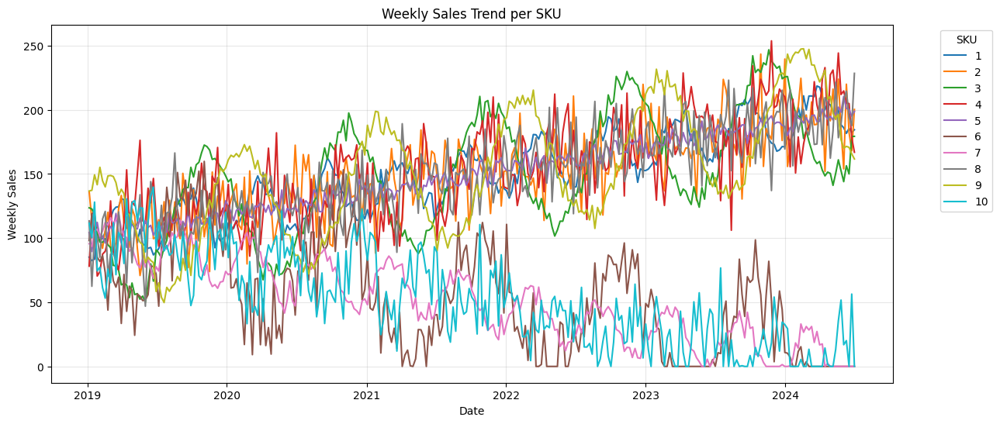

In [14]:
plt.figure(figsize=(14, 6))
sns.lineplot(data=data, x='Date', y='Weekly_Sales', hue='SKU_ID', palette='tab10')
plt.title('Weekly Sales Trend per SKU')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend(title='SKU', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.show()


### Checking the disitribution for the Weekly Sales, to know the underlying distribution of data 
#### It's important to have some type of mathematical disitirbution to correctly feed into model and make relevant predicitons

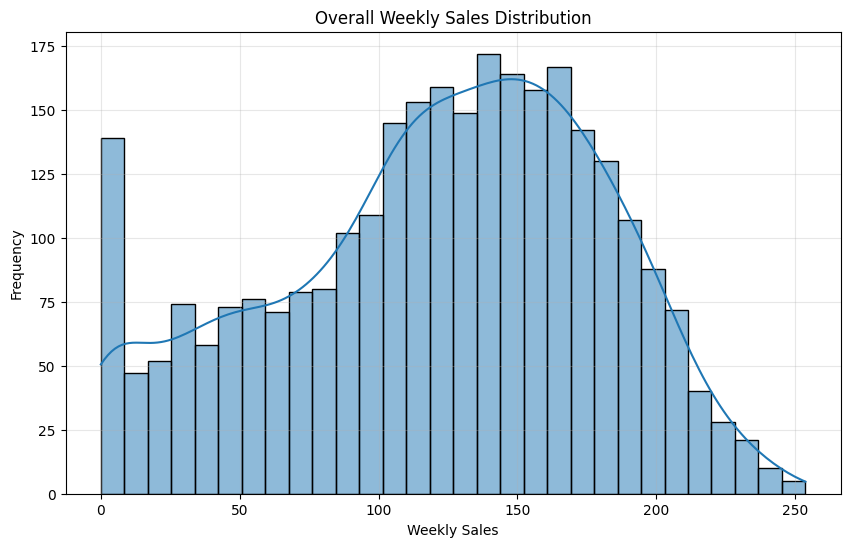

In [15]:
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='Weekly_Sales', kde=True, bins=30)
plt.title('Overall Weekly Sales Distribution')
plt.xlabel('Weekly Sales')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)
plt.show()


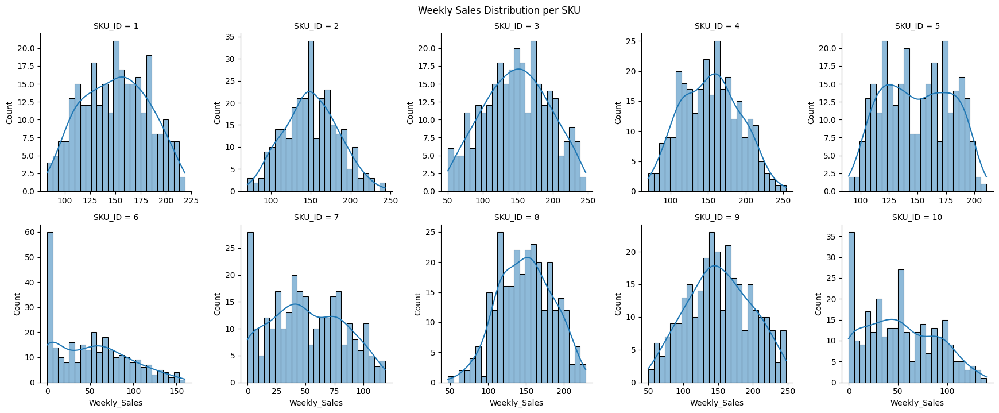

In [16]:
g = sns.FacetGrid(data, col="SKU_ID", col_wrap=5, height=3.5, sharex=False, sharey=False)
g.map(sns.histplot, "Weekly_Sales", bins=25, kde=True)
g.fig.suptitle("Weekly Sales Distribution per SKU", y=1.02)
plt.show()


### we see that SKU_ID 6,7 and 10 have zero sale weeks

In [224]:
#we can see that there are some 0 sales for SKU 6,7 and 10
#sku 5 is tricky - shows bimodal distribution, relevant if there are more feeatures and can know if it can belong to different groups
## its like mixture of two diff. groups mixed in one, means maybe there was change in some strategy that affected it

In [18]:
data['Year'] = data['Date'].dt.year
data['Month'] = data['Date'].dt.month

In [19]:
data

,Date,SKU_ID,Weekly_Sales,Year,Month
0,2019-01-06,1,85.157568,2019,1
1,2019-01-13,1,82.503232,2019,1
2,2019-01-20,1,83.586541,2019,1
3,2019-01-27,1,104.922007,2019,1
4,2019-02-03,1,98.773827,2019,2
...,...,...,...,...,...
2865,2024-06-02,10,16.912411,2024,6
2866,2024-06-09,10,20.130923,2024,6
2867,2024-06-16,10,0.000000,2024,6
2868,2024-06-23,10,56.388314,2024,6


## Visualising Monthly Trends

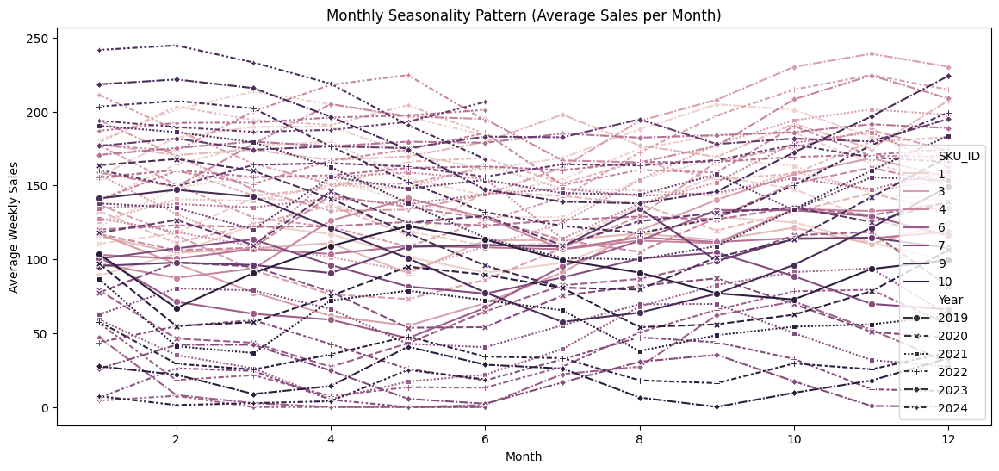

In [20]:
monthly_avg = data.groupby(['Year', 'Month', 'SKU_ID'])['Weekly_Sales'].mean().reset_index()

plt.figure(figsize=(14, 6))
sns.lineplot(data=monthly_avg, x='Month', y='Weekly_Sales', hue='SKU_ID', style='Year', markers=True)
plt.title('Monthly Seasonality Pattern (Average Sales per Month)')
plt.xlabel('Month')
plt.ylabel('Average Weekly Sales')
plt.show()

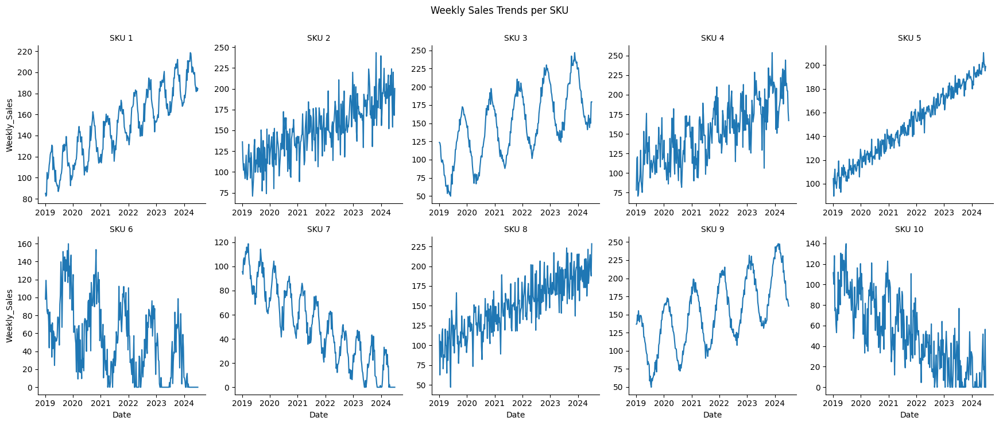

In [21]:
import seaborn as sns
g = sns.FacetGrid(data, col="SKU_ID", col_wrap=5, height=3.5, sharex=False, sharey=False)
g.map_dataframe(sns.lineplot, x="Date", y="Weekly_Sales", color="tab:blue")
g.set_titles("SKU {col_name}")
g.fig.suptitle("Weekly Sales Trends per SKU", y=1.05)
plt.show()


# SKU 6,7, and 20 are declining SKUs and other are increasing, we see similarity between SKU 3 and 9 ; 1,2 and 4 8 are slightly different
## but visual inspection tells these series are not stationary. There is clear trend, and seasonality.

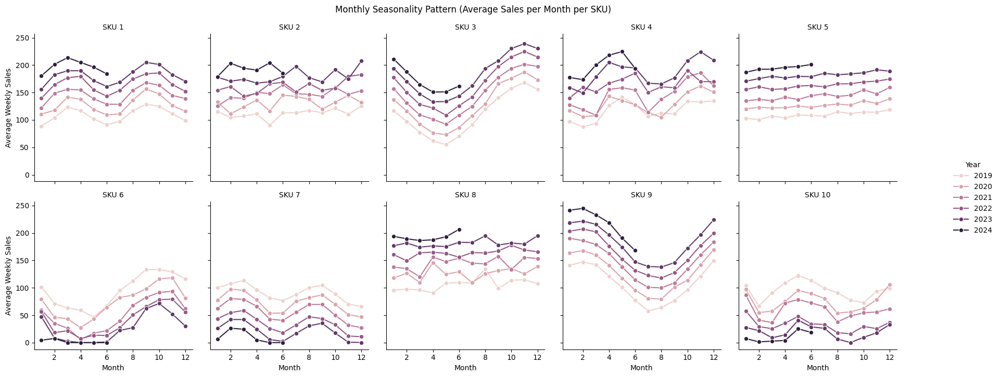

In [22]:
g = sns.FacetGrid(monthly_avg, col="SKU_ID", col_wrap=5, height=3.5, sharex=True, sharey=True)
g.map_dataframe(sns.lineplot, x="Month", y="Weekly_Sales", hue="Year", marker="o")
g.add_legend(title="Year", bbox_to_anchor=(1.05, 0.5))
g.set_titles("SKU {col_name}")
g.fig.suptitle("Monthly Seasonality Pattern (Average Sales per Month per SKU)", y=1.03)
g.set_axis_labels("Month", "Average Weekly Sales")


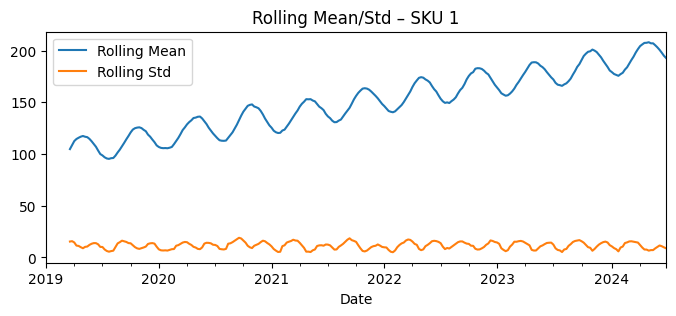

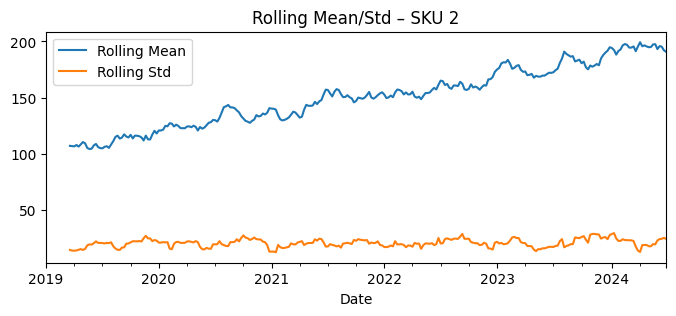

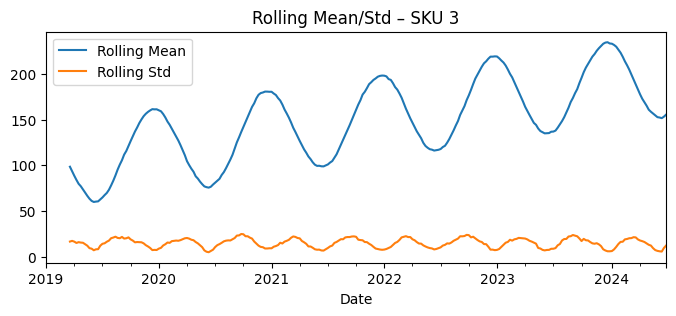

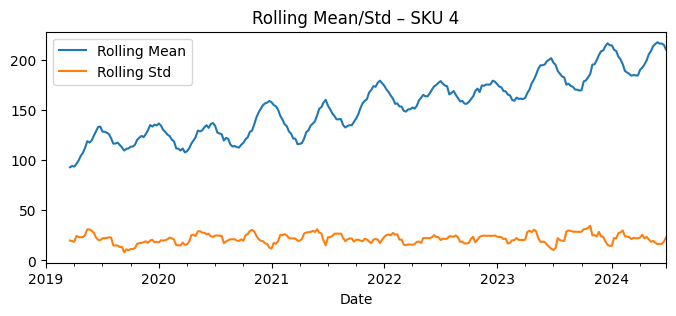

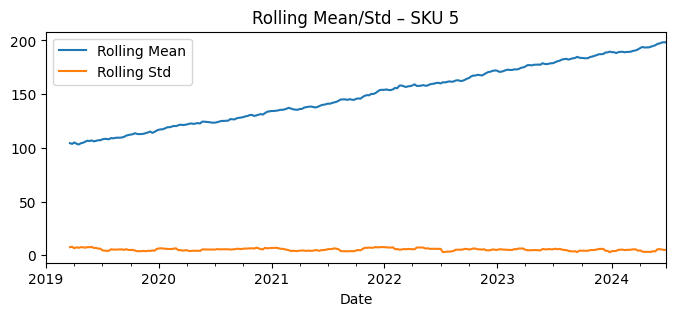

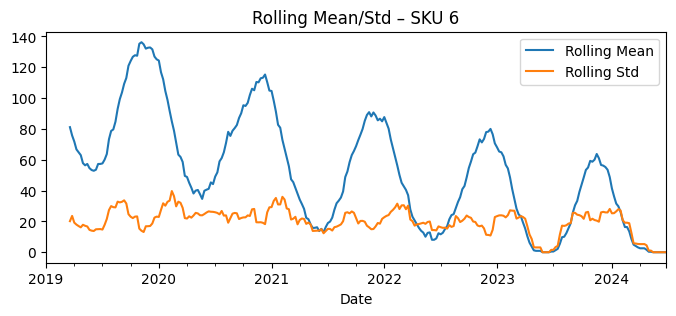

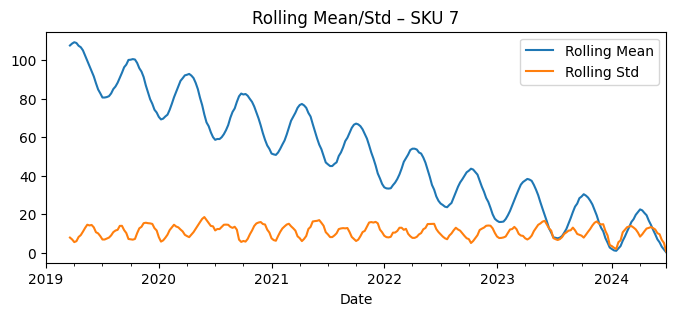

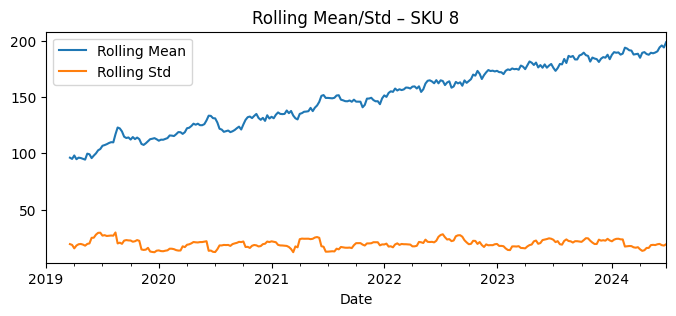

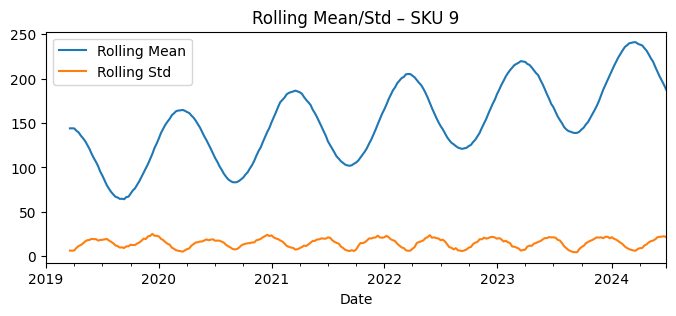

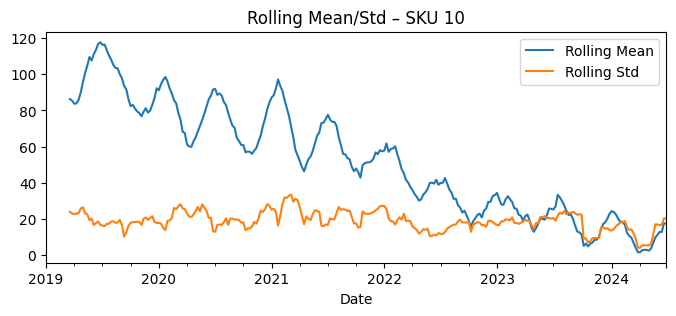

In [23]:
for sku in sorted(data['SKU_ID'].unique()):
    plt.figure(figsize=(8,3))
    temp = data[data['SKU_ID']==sku].set_index('Date')['Weekly_Sales']
    temp.rolling(window=12).mean().plot(label='Rolling Mean')
    temp.rolling(window=12).std().plot(label='Rolling Std')
    plt.title(f'Rolling Mean/Std – SKU {sku}')
    plt.legend()
    plt.show()


In [24]:
#it is non stationary for all SKUs

In [25]:
q1 = data.groupby('SKU_ID')['Weekly_Sales'].quantile(0.25)
q3 = data.groupby('SKU_ID')['Weekly_Sales'].quantile(0.75)
iqr = q3 - q1

def is_outlier(x, sku):
    return (x < q1[sku] - 1.5*iqr[sku]) or (x > q3[sku] + 1.5*iqr[sku])

data['is_outlier'] = data.apply(lambda row: is_outlier(row['Weekly_Sales'], row['SKU_ID']), axis=1)
print("Outlier percentage:", round(100 * data['is_outlier'].mean(), 2), "%")


Outlier percentage: 0.07 %


In [26]:
data[data['is_outlier'] == True].sum

<bound method DataFrame.sum of           Date  SKU_ID  Weekly_Sales  Year  Month  is_outlier
538 2023-10-29       2    243.437786  2023     10        True
547 2023-12-31       2    239.586052  2023     12        True>

In [27]:
#only 2  so no extereme outliers

# Cleaning the data

In [29]:
# now lets clean the data

In [30]:
data

,Date,SKU_ID,Weekly_Sales,Year,Month,is_outlier
0,2019-01-06,1,85.157568,2019,1,False
1,2019-01-13,1,82.503232,2019,1,False
2,2019-01-20,1,83.586541,2019,1,False
3,2019-01-27,1,104.922007,2019,1,False
4,2019-02-03,1,98.773827,2019,2,False
...,...,...,...,...,...,...
2865,2024-06-02,10,16.912411,2024,6,False
2866,2024-06-09,10,20.130923,2024,6,False
2867,2024-06-16,10,0.000000,2024,6,False
2868,2024-06-23,10,56.388314,2024,6,False


In [31]:
total_zero_count = (data['Weekly_Sales'] == 0).sum()
total_rows = len(data)

In [32]:
print(f"Total zero sales: {total_zero_count}")


Total zero sales: 101


In [33]:
sku_zero_counts = data.groupby('SKU_ID')['Weekly_Sales'].apply(lambda x: (x==0).sum()).reset_index()
sku_zero_counts.columns = ['SKU_ID', 'Zero_Count']


In [34]:
sku_zero_counts

,SKU_ID,Zero_Count
0,1,0
1,2,0
2,3,0
3,4,0
4,5,0
5,6,50
6,7,22
7,8,0
8,9,0
9,10,29


In [35]:
sku_zero_counts.columns = ['SKU_ID', 'Zero_Count']

# Add percentage per SKU
sku_zero_counts['Zero_%'] = sku_zero_counts.apply(
    lambda row: 100 * row['Zero_Count'] / len(data[data['SKU_ID'] == row['SKU_ID']]),
    axis=1
)

print("\nZero sales per SKU:")
print(sku_zero_counts.sort_values('Zero_%', ascending=False))


Zero sales per SKU:
   SKU_ID  Zero_Count     Zero_%
5       6          50  17.421603
9      10          29  10.104530
6       7          22   7.665505
0       1           0   0.000000
1       2           0   0.000000
2       3           0   0.000000
3       4           0   0.000000
4       5           0   0.000000
7       8           0   0.000000
8       9           0   0.000000


I can see declining trends in SKU 6, 7 and 10 and they are the one with zero sales, so do we interpoalte those sales or just make it count as actual sales. can be due to product discontnuation at those specific end 

Lets do monthly aggregaration first

### I am assuming that zero week sales are there and are actually there due to dseclining performance

In [37]:
data

,Date,SKU_ID,Weekly_Sales,Year,Month,is_outlier
0,2019-01-06,1,85.157568,2019,1,False
1,2019-01-13,1,82.503232,2019,1,False
2,2019-01-20,1,83.586541,2019,1,False
3,2019-01-27,1,104.922007,2019,1,False
4,2019-02-03,1,98.773827,2019,2,False
...,...,...,...,...,...,...
2865,2024-06-02,10,16.912411,2024,6,False
2866,2024-06-09,10,20.130923,2024,6,False
2867,2024-06-16,10,0.000000,2024,6,False
2868,2024-06-23,10,56.388314,2024,6,False


In [38]:
data['Date'] = pd.to_datetime(data['Date'])

# Aggregate weekly data into monthly totals
data_monthly = (
    data.groupby(['SKU_ID', pd.Grouper(key='Date', freq='M')])['Weekly_Sales']
    .sum()
    .reset_index()
)


data_monthly.rename(columns={'Weekly_Sales': 'Monthly_Sales'}, inplace=True)


print(data_monthly.head())

   SKU_ID       Date  Monthly_Sales
0       1 2019-01-31     356.169348
1       1 2019-02-28     415.445741
2       1 2019-03-31     616.705411
3       1 2019-04-30     468.330555
4       1 2019-05-31     406.271277


/var/folders/z2/fm7clqhj5855cx6jvwxrpyc00000gn/T/ipykernel_41963/910252591.py:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  data.groupby(['SKU_ID', pd.Grouper(key='Date', freq='M')])['Weekly_Sales']


In [39]:
data_monthly

,SKU_ID,Date,Monthly_Sales
0,1,2019-01-31,356.169348
1,1,2019-02-28,415.445741
2,1,2019-03-31,616.705411
3,1,2019-04-30,468.330555
4,1,2019-05-31,406.271277
...,...,...,...
655,10,2024-02-29,5.453175
656,10,2024-03-31,13.362990
657,10,2024-04-30,15.935134
658,10,2024-05-31,100.467238


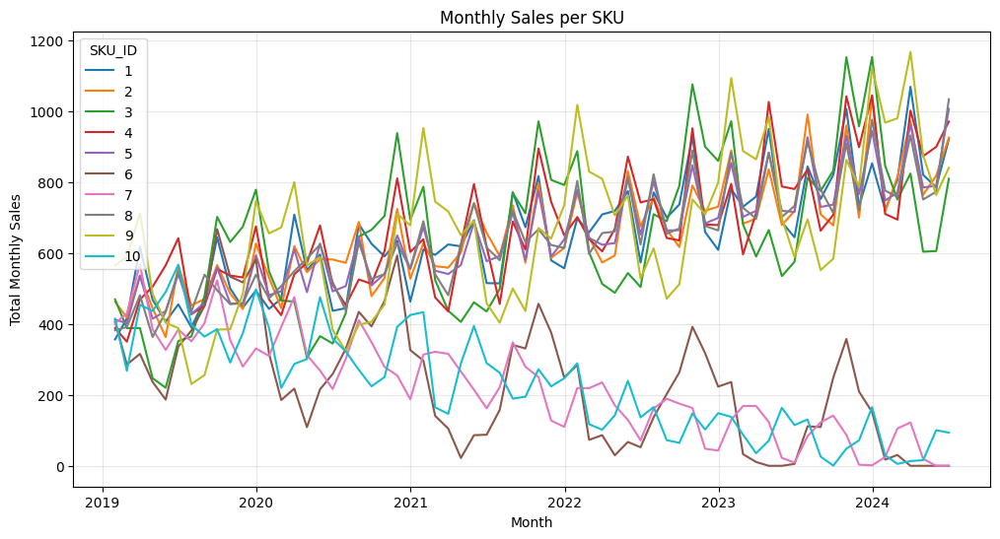

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12,6))
sns.lineplot(data=data_monthly, x='Date', y='Monthly_Sales', hue='SKU_ID', palette='tab10')
plt.title('Monthly Sales per SKU')
plt.xlabel('Month')
plt.ylabel('Total Monthly Sales')
plt.grid(alpha=0.3)
plt.show()


In [41]:
months_per_sku = (
    data_monthly.groupby('SKU_ID')['Date']
    .agg(['min', 'max', 'count'])
    .reset_index()
)
print(months_per_sku)

   SKU_ID        min        max  count
0       1 2019-01-31 2024-06-30     66
1       2 2019-01-31 2024-06-30     66
2       3 2019-01-31 2024-06-30     66
3       4 2019-01-31 2024-06-30     66
4       5 2019-01-31 2024-06-30     66
5       6 2019-01-31 2024-06-30     66
6       7 2019-01-31 2024-06-30     66
7       8 2019-01-31 2024-06-30     66
8       9 2019-01-31 2024-06-30     66
9      10 2019-01-31 2024-06-30     66


In [42]:
#all months are there

In [43]:
data

,Date,SKU_ID,Weekly_Sales,Year,Month,is_outlier
0,2019-01-06,1,85.157568,2019,1,False
1,2019-01-13,1,82.503232,2019,1,False
2,2019-01-20,1,83.586541,2019,1,False
3,2019-01-27,1,104.922007,2019,1,False
4,2019-02-03,1,98.773827,2019,2,False
...,...,...,...,...,...,...
2865,2024-06-02,10,16.912411,2024,6,False
2866,2024-06-09,10,20.130923,2024,6,False
2867,2024-06-16,10,0.000000,2024,6,False
2868,2024-06-23,10,56.388314,2024,6,False


In [44]:
# Overall zero count
total_zero_months = (data_monthly['Monthly_Sales'] == 0).sum()
total_rows = len(data_monthly)
zero_percentage = (total_zero_months / total_rows) * 100

print(f"Total zero months: {total_zero_months}")
print(f"Percentage of zeros: {zero_percentage:.2f}%")

# Per SKU breakdown
sku_zero_months = (
    data_monthly.groupby('SKU_ID')['Monthly_Sales']
    .apply(lambda x: (x == 0).sum())
    .reset_index(name='Zero_Months')
)

sku_zero_months['Zero_%'] = sku_zero_months.apply(
    lambda row: 100 * row['Zero_Months'] / len(data_monthly[data_monthly['SKU_ID'] == row['SKU_ID']]),
    axis=1
)

print("\nZero monthly sales per SKU:")
print(sku_zero_months.sort_values('Zero_%', ascending=False))


Total zero months: 8
Percentage of zeros: 1.21%

Zero monthly sales per SKU:
   SKU_ID  Zero_Months    Zero_%
5       6            6  9.090909
6       7            2  3.030303
0       1            0  0.000000
1       2            0  0.000000
2       3            0  0.000000
3       4            0  0.000000
4       5            0  0.000000
7       8            0  0.000000
8       9            0  0.000000
9      10            0  0.000000


Those zeros carry meaning — they show demand collapse or discontinued SKUs, which your forecasting model should learn.

Interpolating them would falsely assume future demand still exists when, in reality, the SKU might be dying out.

Keeping zeros helps the model forecast continued decline or flat-zero trends accurately.

In [45]:
#Intitial train test split -> last 6 months Jan 2024 to Jun 2024 as test data

In [46]:
data_monthly['Month_Year'] = data_monthly['Date'].dt.strftime('%Y-%m')


In [47]:
split_date = '2023-12-31'

train = data_monthly[data_monthly['Date'] <= split_date]
test = data_monthly[data_monthly['Date'] > split_date]

print(f"Train range: {train['Date'].min().date()} → {train['Date'].max().date()}")
print(f"Test range: {test['Date'].min().date()} → {test['Date'].max().date()}")


Train range: 2019-01-31 → 2023-12-31
Test range: 2024-01-31 → 2024-06-30


In [48]:
train

,SKU_ID,Date,Monthly_Sales,Month_Year
0,1,2019-01-31,356.169348,2019-01
1,1,2019-02-28,415.445741,2019-02
2,1,2019-03-31,616.705411,2019-03
3,1,2019-04-30,468.330555,2019-04
4,1,2019-05-31,406.271277,2019-05
...,...,...,...,...
649,10,2023-08-31,25.840539,2023-08
650,10,2023-09-30,0.557039,2023-09
651,10,2023-10-31,48.410381,2023-10
652,10,2023-11-30,71.717980,2023-11


In [49]:
train.shape

(600, 4)

In [50]:
test.shape

(60, 4)

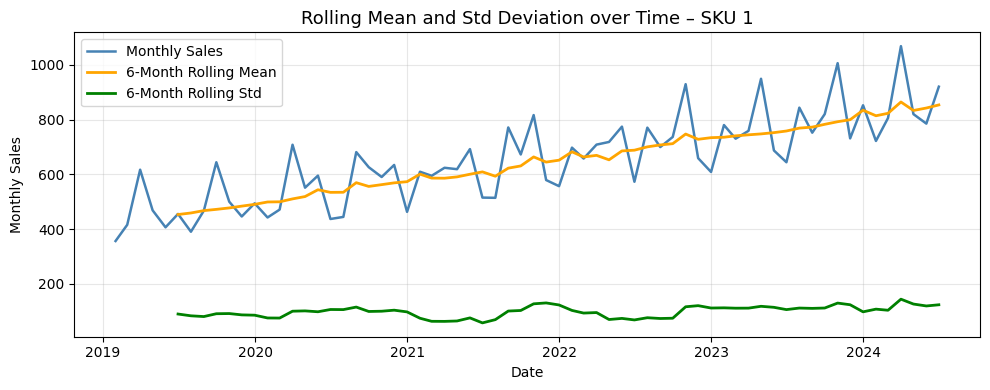

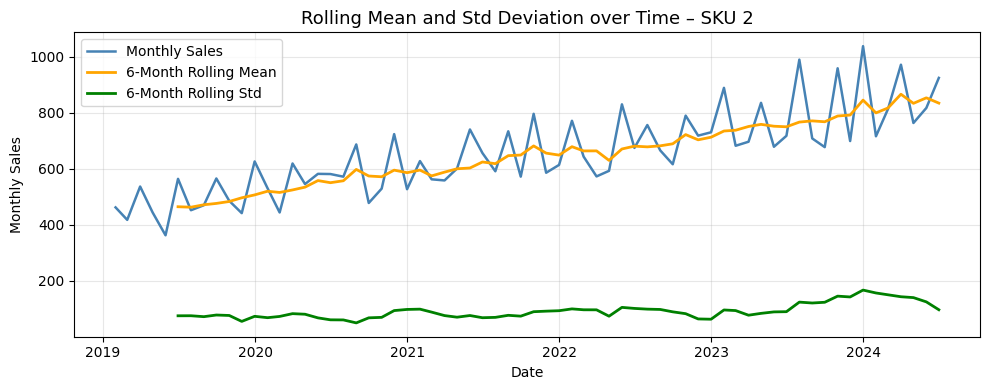

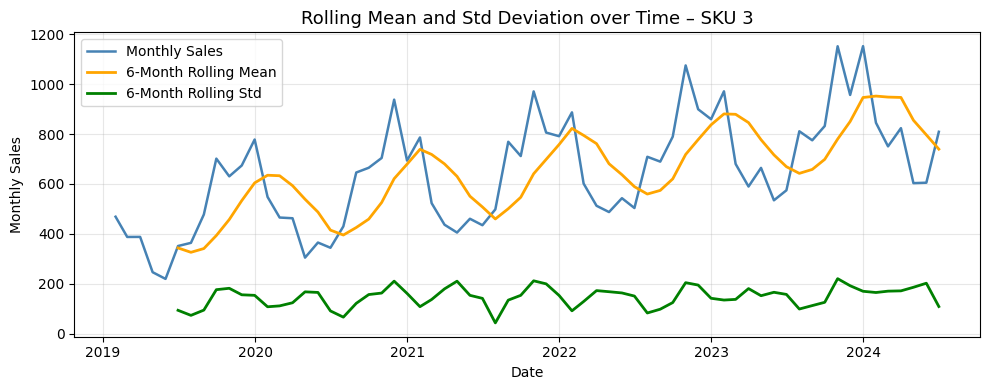

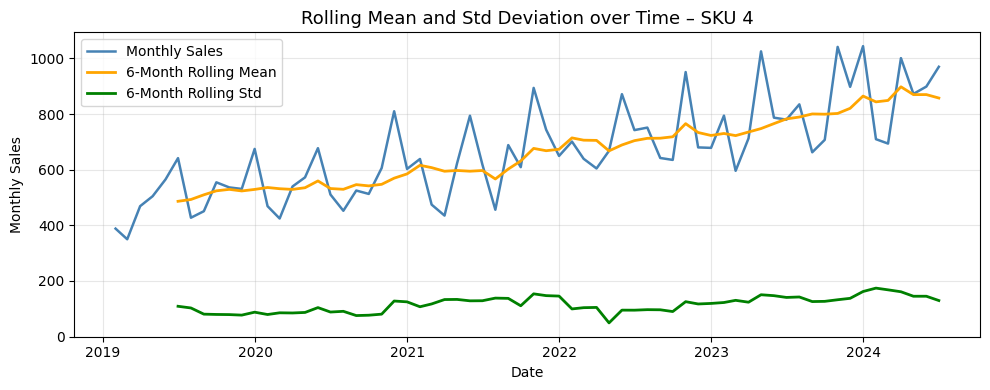

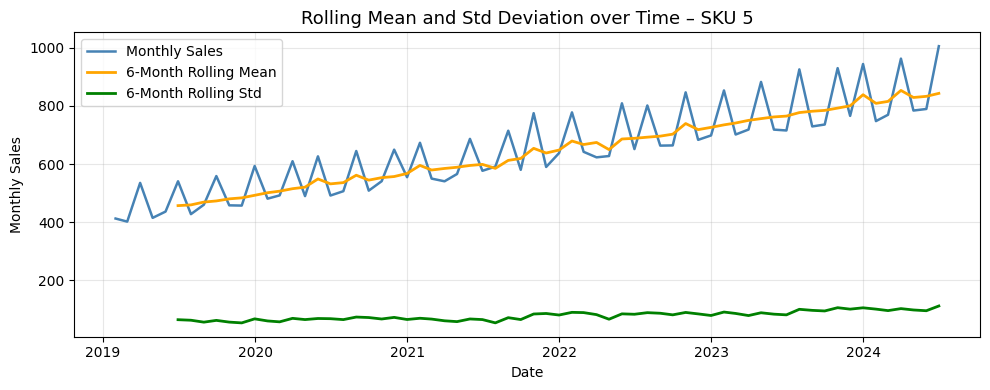

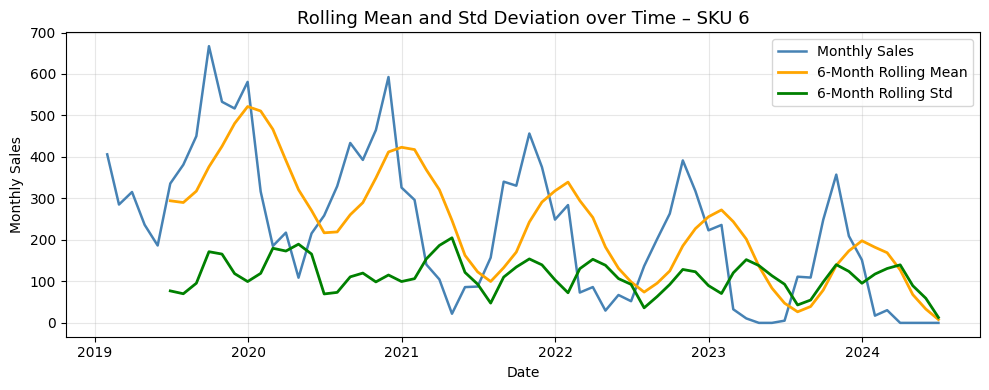

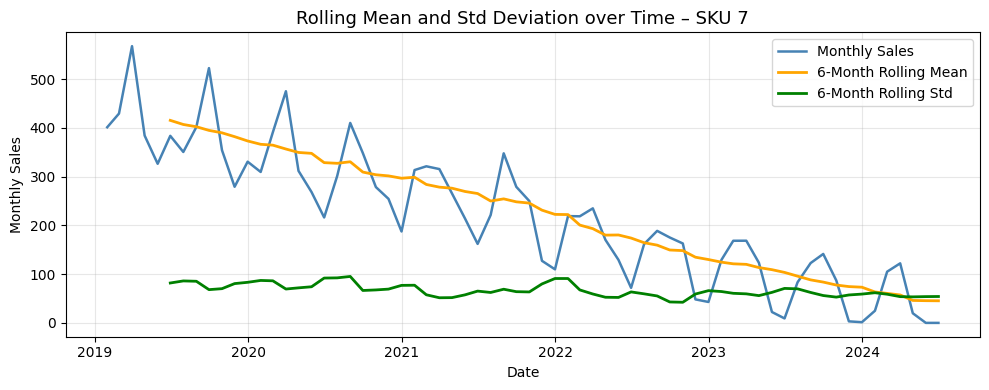

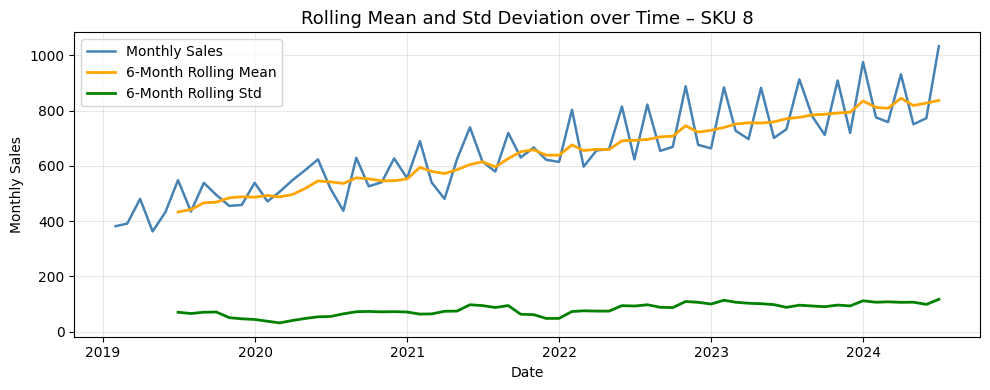

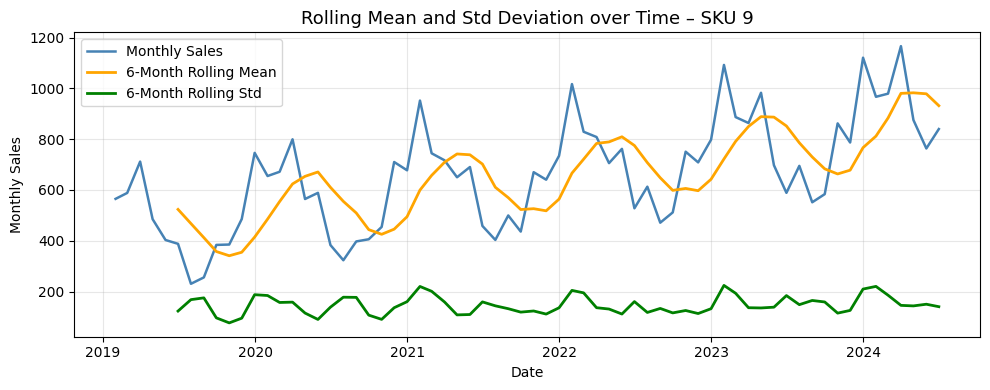

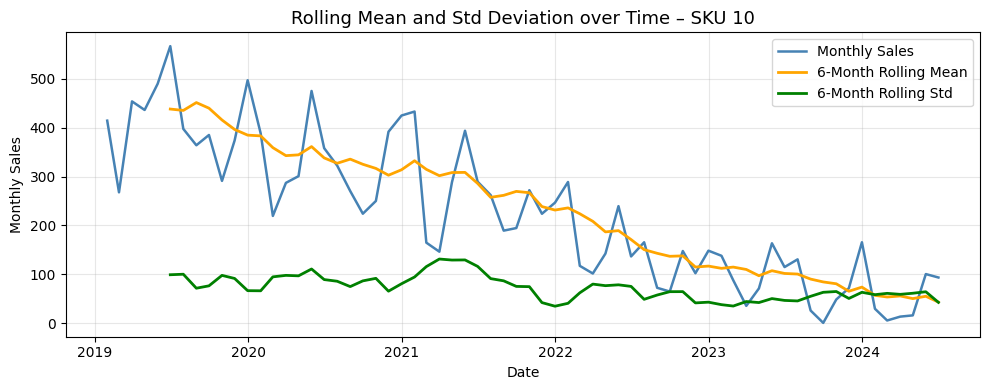

In [51]:
import pandas as pd
import matplotlib.pyplot as plt

# Set rolling window (e.g., 6 months to capture half-year patterns)
window = 6

for sku in sorted(data_monthly['SKU_ID'].unique()):
    temp = data_monthly[data_monthly['SKU_ID'] == sku].copy()
    temp = temp.sort_values('Date')
    temp['Rolling_Mean'] = temp['Monthly_Sales'].rolling(window=window).mean()
    temp['Rolling_Std'] = temp['Monthly_Sales'].rolling(window=window).std()

    plt.figure(figsize=(10,4))
    plt.plot(temp['Date'], temp['Monthly_Sales'], label='Monthly Sales', color='steelblue', linewidth=1.8)
    plt.plot(temp['Date'], temp['Rolling_Mean'], label=f'{window}-Month Rolling Mean', color='orange', linewidth=2)
    plt.plot(temp['Date'], temp['Rolling_Std'], label=f'{window}-Month Rolling Std', color='green', linewidth=2)
    plt.title(f'Rolling Mean and Std Deviation over Time – SKU {sku}', fontsize=13)
    plt.xlabel('Date')
    plt.ylabel('Monthly Sales')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()


### seems non stattioanry according  to visual inspection, there is no constant mean
### Let's confirm with statistical tests, important in time series analysis

In [53]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

results = []

for sku in sorted(data_monthly['SKU_ID'].unique()):
    ts = data_monthly[data_monthly['SKU_ID'] == sku]['Monthly_Sales']
    adf_result = adfuller(ts, autolag='AIC')
    
    results.append({
        'SKU_ID': sku,
        'ADF Statistic': round(adf_result[0], 4),
        'p-value': round(adf_result[1], 4),
        'Stationary': adf_result[1] < 0.05
    })

adf_df = pd.DataFrame(results)
print(adf_df)


   SKU_ID  ADF Statistic  p-value  Stationary
0       1         0.0048   0.9589       False
1       2        -0.1381   0.9455       False
2       3         0.0646   0.9636       False
3       4         1.0428   0.9947       False
4       5         0.1476   0.9692       False
5       6        -2.1846   0.2119       False
6       7        -1.3199   0.6200       False
7       8        -0.6563   0.8577       False
8       9         0.0619   0.9634       False
9      10        -0.7357   0.8373       False


In [54]:
from statsmodels.tsa.stattools import kpss
import pandas as pd

kpss_results = []

for sku in sorted(data_monthly['SKU_ID'].unique()):
    ts = data_monthly[data_monthly['SKU_ID'] == sku]['Monthly_Sales']
    try:
        kpss_stat, p_value, lags, crit = kpss(ts, regression='c', nlags='auto')
    except ValueError:
        kpss_stat, p_value = None, None  # fallback for very short series
    kpss_results.append({'SKU_ID': sku, 'KPSS p-value': round(p_value, 4) if p_value is not None else None})

kpss_df = pd.DataFrame(kpss_results)
print(kpss_df)


   SKU_ID  KPSS p-value
0       1          0.01
1       2          0.01
2       3          0.01
3       4          0.01
4       5          0.01
5       6          0.01
6       7          0.01
7       8          0.01
8       9          0.01
9      10          0.01


/var/folders/z2/fm7clqhj5855cx6jvwxrpyc00000gn/T/ipykernel_41963/3760995434.py:9: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat, p_value, lags, crit = kpss(ts, regression='c', nlags='auto')
/var/folders/z2/fm7clqhj5855cx6jvwxrpyc00000gn/T/ipykernel_41963/3760995434.py:9: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat, p_value, lags, crit = kpss(ts, regression='c', nlags='auto')
/var/folders/z2/fm7clqhj5855cx6jvwxrpyc00000gn/T/ipykernel_41963/3760995434.py:9: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat, p_value, lags, crit = kpss(ts, regression='c', nlags='auto')
/var/folders/z2/fm7clqhj5855cx6

## both test concludes the series are non stationary and we will need differencing -> its not just trend stationary so

# Model Experimentation

In [ ]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error
import numpy as np

sku = 1  # example SKU
train_sku = train[train['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
test_sku = test[test['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']

# Fit Holt-Winters model
model = ExponentialSmoothing(
    train_sku,
    trend='add',           # additive trend
    seasonal='add',        # additive seasonality
    seasonal_periods=12    # monthly data - 12 months per year
).fit(optimized=True)

# Forecast for test period
forecast = model.forecast(len(test_sku))

# Evaluation
mape = mean_absolute_percentage_error(test_sku, forecast)
rmse = np.sqrt(mean_squared_error(test_sku, forecast))

print(f"SKU {sku} → MAPE: {mape:.3f}, RMSE: {rmse:.3f}")


SKU 1 → MAPE: 0.110, RMSE: 106.578


/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


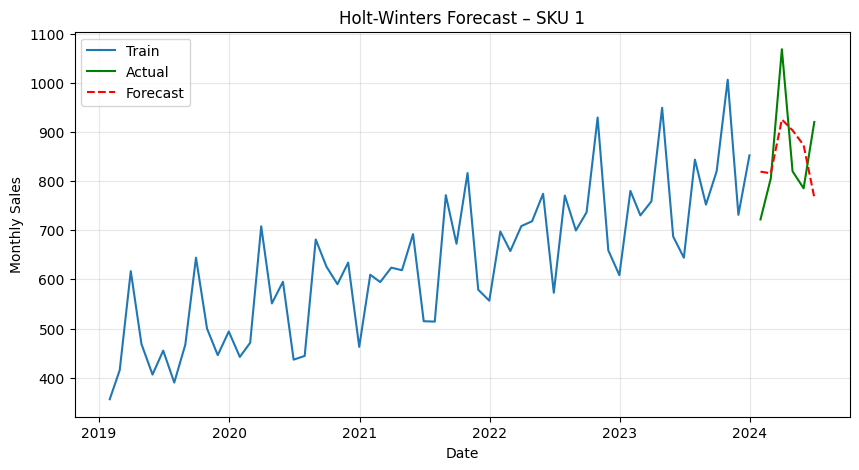

In [57]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
plt.plot(train_sku.index, train_sku, label='Train')
plt.plot(test_sku.index, test_sku, label='Actual', color='green')
plt.plot(forecast.index, forecast, label='Forecast', color='red', linestyle='--')
plt.title(f"Holt-Winters Forecast – SKU {sku}")
plt.xlabel('Date')
plt.ylabel('Monthly Sales')
plt.legend()
plt.grid(alpha=0.3)
plt.show()


/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


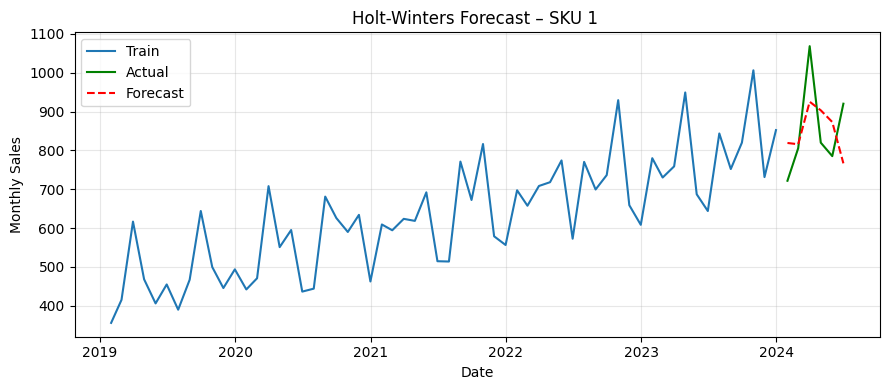

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


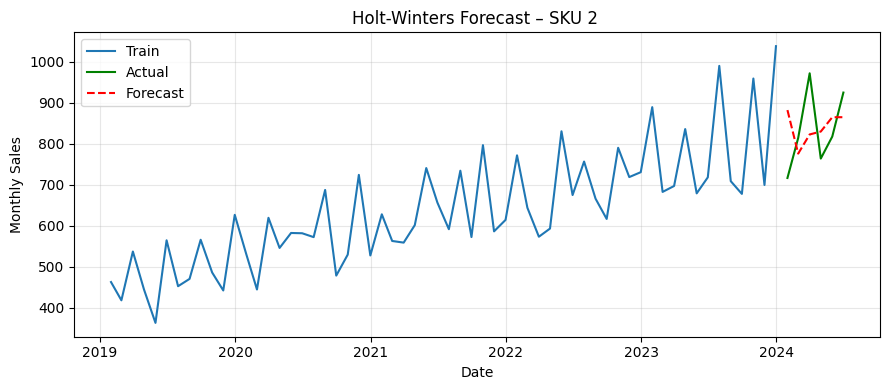

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


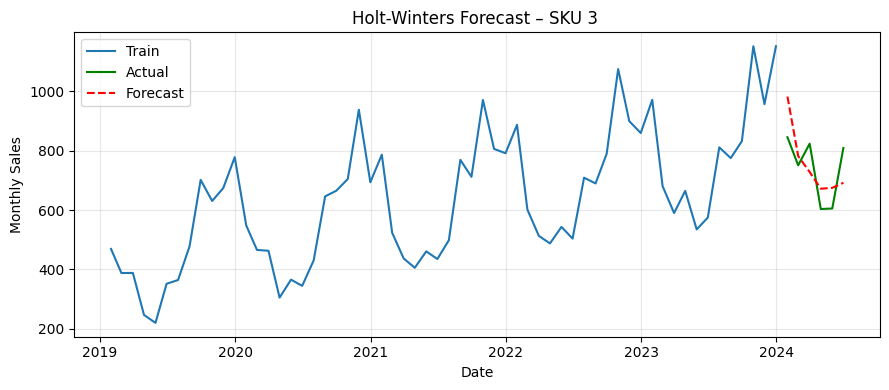

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


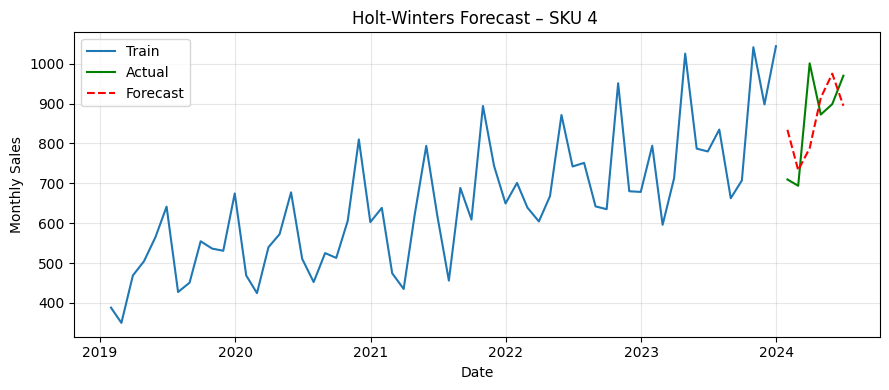

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


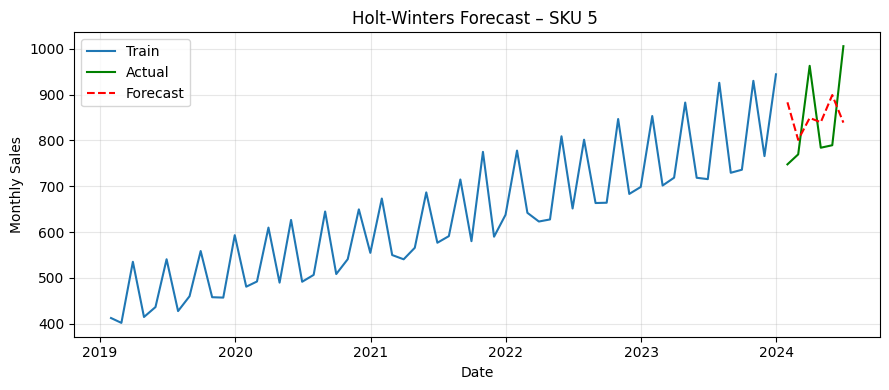

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


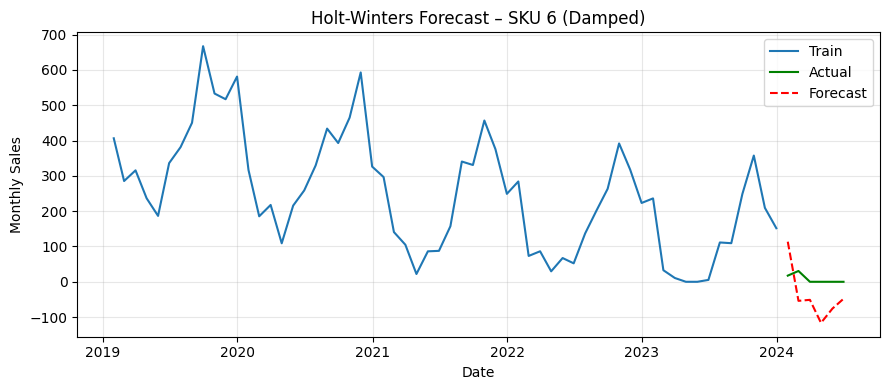

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


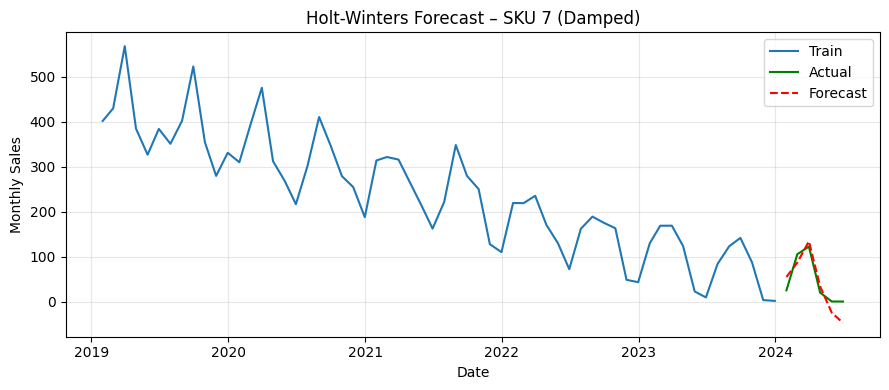

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


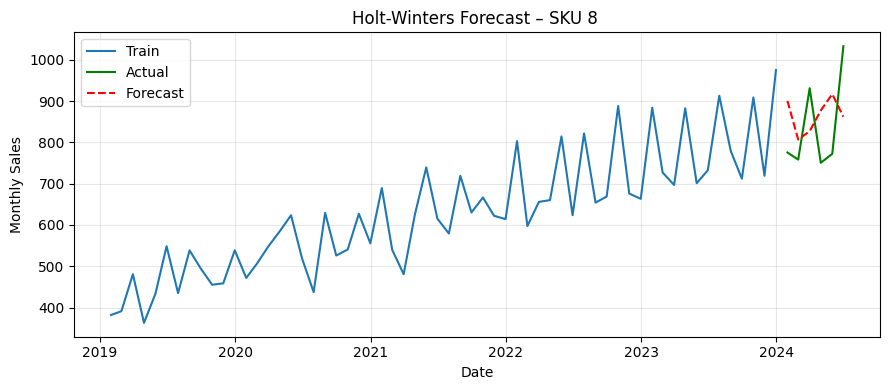

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


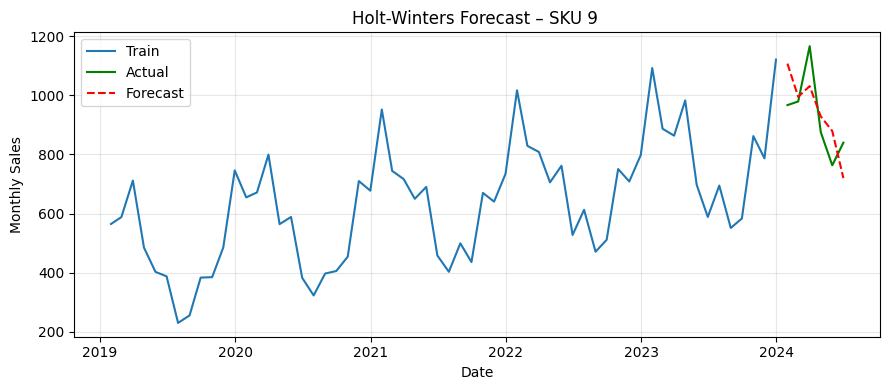

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency ME will be used.
  self._init_dates(dates, freq)


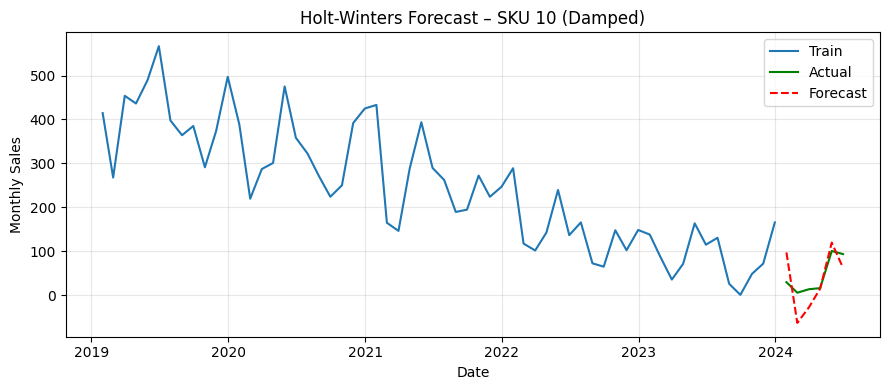


Model Performance Summary:
   SKU_ID          MAPE     RMSE      MAE  Damped
8       9  1.050000e-01  107.100   96.708   False
1       2  1.070000e-01  101.157   87.746   False
3       4  1.090000e-01  112.285   95.062   False
0       1  1.100000e-01  106.578   95.781   False
2       3  1.150000e-01   93.217   86.462   False
4       5  1.190000e-01  111.999  102.155   False
7       8  1.430000e-01  125.824  119.982   False
9      10  3.098000e+00   45.406   38.203    True
6       7  5.429862e+16   27.148   24.314    True
5       6  2.187799e+17   82.254   78.676    True


In [73]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

results = []

# identified downward SKUs (for damping)
decline_skus = [6, 7, 10]

for sku in sorted(data_monthly['SKU_ID'].unique()):
    train_sku = train[train['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
    test_sku = test[test['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']

    try:
        # damped trend for declining SKUs
        trend_type = 'add'
        seasonal_type = 'add'
        damped = sku in decline_skus

        model = ExponentialSmoothing(
            train_sku,
            trend=trend_type,
            damped_trend=damped,
            seasonal=seasonal_type,
            seasonal_periods=12
        ).fit(optimized=True)

        forecast = model.forecast(len(test_sku))
        # Store forecasts for later visualization
        if 'hw_forecasts' not in locals():
            hw_forecasts = {}

        hw_forecasts[sku] = pd.DataFrame({
            'Date': test_sku.index,
            'Actual': test_sku.values,
            'Forecast': forecast.values
})


        mape = mean_absolute_percentage_error(test_sku, forecast)
        rmse = np.sqrt(mean_squared_error(test_sku, forecast))
        mae = mean_absolute_error(test_sku, forecast)

        results.append({
            'SKU_ID': sku,
            'MAPE': round(mape, 3),
            'RMSE': round(rmse, 3),
            'MAE': round(mae,3),
            'Damped': damped
        })

        # quick plot
        plt.figure(figsize=(9,4))
        plt.plot(train_sku.index, train_sku, label='Train')
        plt.plot(test_sku.index, test_sku, label='Actual', color='green')
        plt.plot(forecast.index, forecast, '--', label='Forecast', color='red')
        plt.title(f"Holt-Winters Forecast – SKU {sku} {'(Damped)' if damped else ''}")
        plt.xlabel('Date'); plt.ylabel('Monthly Sales')
        plt.legend(); plt.grid(alpha=0.3); plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"SKU {sku} failed: {e}")

# summary
summary_df = pd.DataFrame(results)
print("\nModel Performance Summary:")
print(summary_df.sort_values('MAPE'))


## not bad 

### Let's do ARIMA model, we use Pmdautoarima , which saves effort to determine order of our series, and not do ACF and PACF plots and determine p,d,q values in ARIMA

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

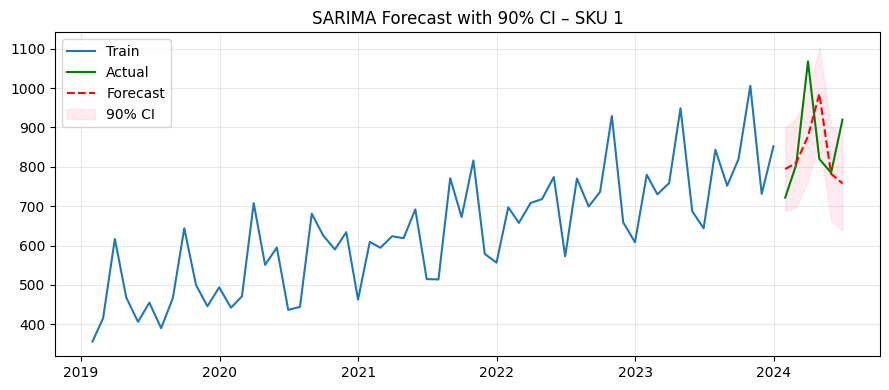

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

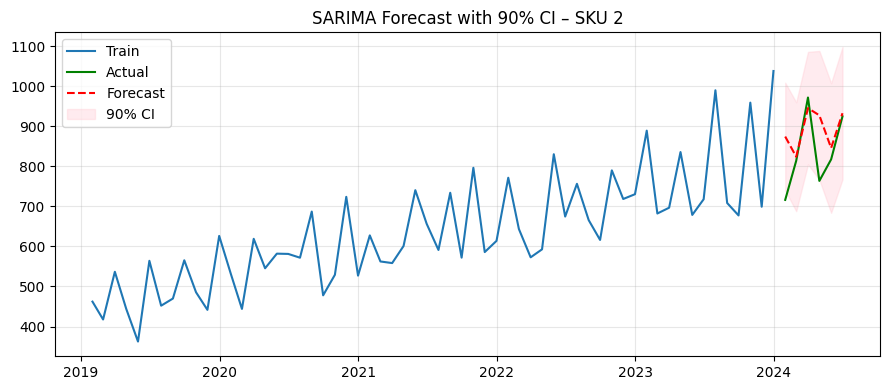

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

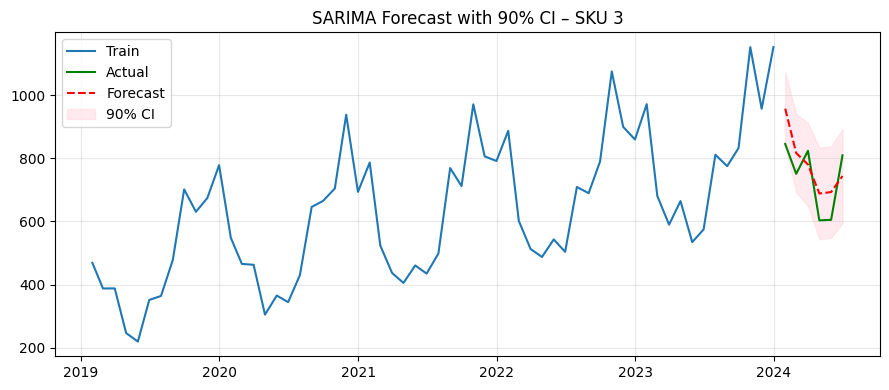

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

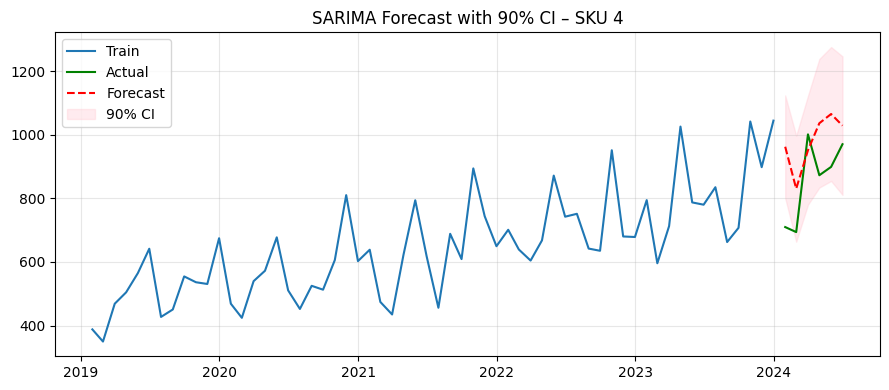

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

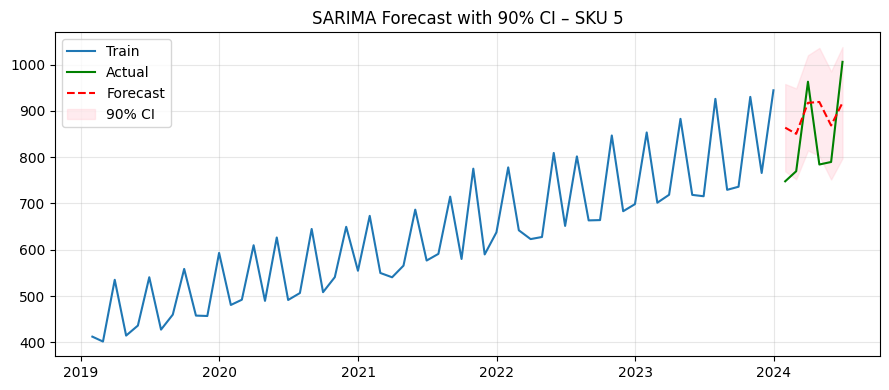

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

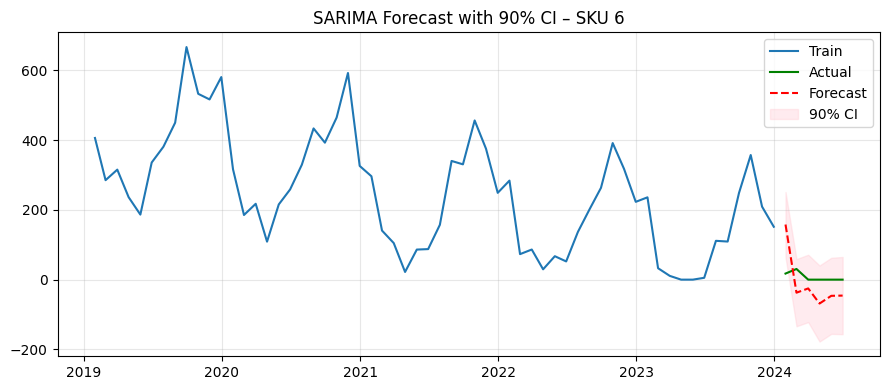

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

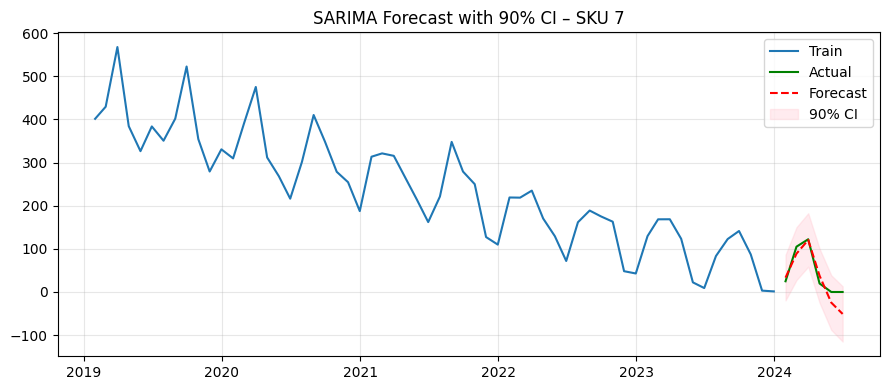

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

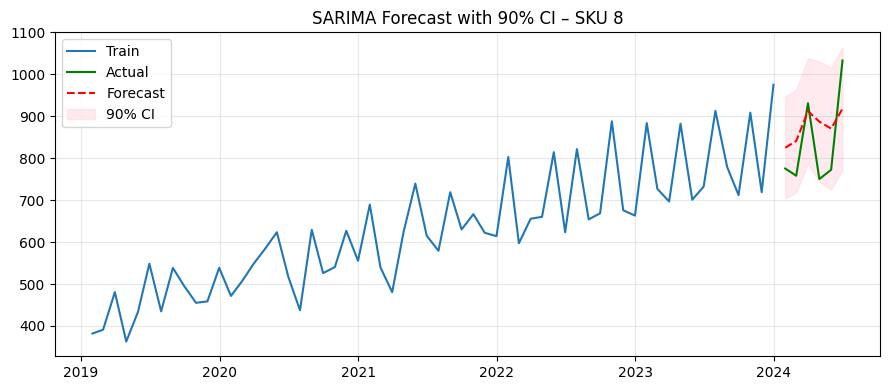

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

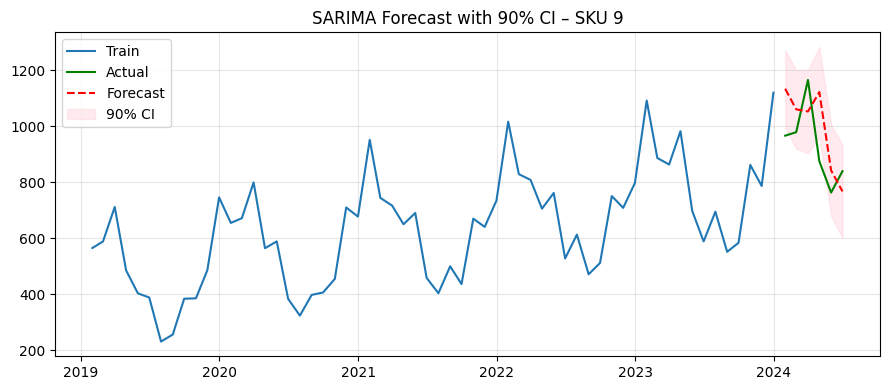

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

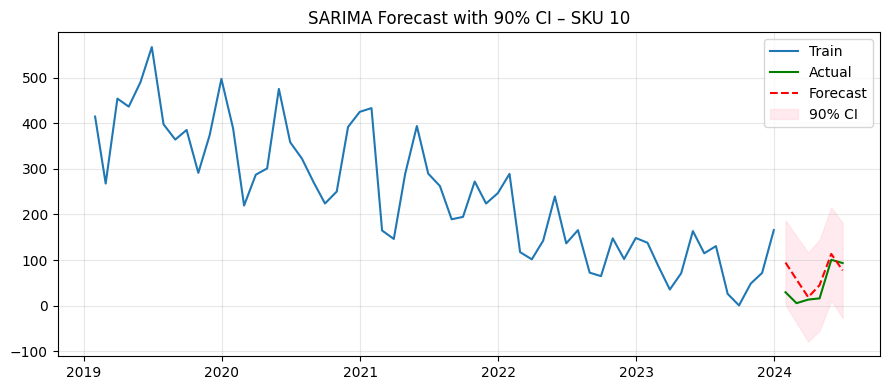

   SKU_ID          MAPE     RMSE      MAE      Order Seasonal_Order
1       2  8.600000e-02   94.391   65.747  (3, 1, 0)  (0, 0, 1, 12)
7       8  1.020000e-01   92.418   83.541  (3, 1, 0)  (0, 0, 0, 12)
2       3  1.070000e-01   79.517   76.557  (3, 1, 0)  (0, 1, 1, 12)
0       1  1.110000e-01  126.118   99.826  (2, 1, 1)  (1, 0, 0, 12)
4       5  1.110000e-01   95.122   90.745  (3, 1, 0)  (0, 0, 1, 12)
8       9  1.380000e-01  141.599  126.909  (3, 1, 0)  (0, 1, 0, 12)
3       4  1.720000e-01  154.149  137.814  (2, 1, 0)  (1, 0, 1, 12)
9      10  2.373000e+00   37.003   30.034  (0, 1, 1)  (1, 0, 0, 12)
6       7  5.668340e+16   25.347   19.960  (0, 1, 2)  (1, 0, 1, 12)
5       6  1.394829e+17   75.241   65.742  (3, 1, 2)  (2, 0, 0, 12)


In [ ]:
from pmdarima import auto_arima
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error , mean_absolute_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

results_arima = []

for sku in sorted(data_monthly['SKU_ID'].unique()):
    train_sku = train[train['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
    test_sku = test[test['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
    
    try:
        model = auto_arima(
            train_sku,
            start_p=0, start_q=0,
            max_p=3, max_q=3,
            d=1,
            seasonal=True, m=12,
            trace=False,
            error_action='ignore',
            suppress_warnings=True,
            stepwise=True
        )

        forecast, conf_int = model.predict(n_periods=len(test_sku), return_conf_int=True, alpha=0.10)
        if 'sarima_forecasts' not in locals():
            sarima_forecasts = {}
            sarima_conf = {}

        sarima_forecasts[sku] = pd.DataFrame({
            'Date': test_sku.index,
            'Actual': test_sku.values,
            'Forecast': forecast
        })
        sarima_conf[sku] = conf_int
        
        mape = mean_absolute_percentage_error(test_sku, forecast)
        rmse = np.sqrt(mean_squared_error(test_sku, forecast))
        mae = mean_absolute_error(test_sku,forecast)
        
        results_arima.append({
            'SKU_ID': sku,
            'MAPE': round(mape, 3),
            'RMSE': round(rmse, 3),
            'MAE': round(mae,3),
            'Order': model.order,
            'Seasonal_Order': model.seasonal_order
        })

        # Visualize with 90% CI
        plt.figure(figsize=(9,4))
        plt.plot(train_sku, label='Train')
        plt.plot(test_sku, label='Actual', color='green')
        plt.plot(test_sku.index, forecast, '--', color='red', label='Forecast')
        plt.fill_between(test_sku.index, conf_int[:,0], conf_int[:,1],
                         color='pink', alpha=0.3, label='90% CI')
        plt.title(f"SARIMA Forecast with 90% CI – SKU {sku}")
        plt.legend(); plt.grid(alpha=0.3); plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"SKU {sku} failed: {e}")

results_arima_df = pd.DataFrame(results_arima)
print(results_arima_df.sort_values('MAPE'))


In [69]:
results_arima_df

,SKU_ID,MAPE,RMSE,MAE,Order,Seasonal_Order
0,1,1.110000e-01,126.118,99.826,"(2, 1, 1)","(1, 0, 0, 12)"
1,2,8.600000e-02,94.391,65.747,"(3, 1, 0)","(0, 0, 1, 12)"
2,3,1.070000e-01,79.517,76.557,"(3, 1, 0)","(0, 1, 1, 12)"
3,4,1.720000e-01,154.149,137.814,"(2, 1, 0)","(1, 0, 1, 12)"
4,5,1.110000e-01,95.122,90.745,"(3, 1, 0)","(0, 0, 1, 12)"
5,6,1.394829e+17,75.241,65.742,"(3, 1, 2)","(2, 0, 0, 12)"
6,7,5.668340e+16,25.347,19.960,"(0, 1, 2)","(1, 0, 1, 12)"
7,8,1.020000e-01,92.418,83.541,"(3, 1, 0)","(0, 0, 0, 12)"
8,9,1.380000e-01,141.599,126.909,"(3, 1, 0)","(0, 1, 0, 12)"
9,10,2.373000e+00,37.003,30.034,"(0, 1, 1)","(1, 0, 0, 12)"


In [72]:
summary_df

,SKU_ID,MAPE,RMSE,MAE,Damped
0,1,1.100000e-01,106.578,95.781,False
1,2,1.070000e-01,101.157,87.746,False
2,3,1.150000e-01,93.217,86.462,False
3,4,1.090000e-01,112.285,95.062,False
4,5,1.190000e-01,111.999,102.155,False
5,6,2.187799e+17,82.254,78.676,True
6,7,5.429862e+16,27.148,24.314,True
7,8,1.430000e-01,125.824,119.982,False
8,9,1.050000e-01,107.100,96.708,False
9,10,3.098000e+00,45.406,38.203,True


### mape can be ignored for 6,7 and 10 as they have zero and near zero values, which explodes MAPE and see other, ARIMA performs better

In [90]:
print(hw_forecasts)

{1:         Date       Actual    Forecast
0 2024-01-31   721.780045  819.030497
1 2024-02-29   805.629628  815.745765
2 2024-03-31  1068.084289  925.160452
3 2024-04-30   819.798171  903.019780
4 2024-05-31   785.156106  872.900582
5 2024-06-30   920.069591  766.638693, 2:         Date      Actual    Forecast
0 2024-01-31  716.257886  882.003425
1 2024-02-29  813.968407  775.775087
2 2024-03-31  971.771425  822.534911
3 2024-04-30  763.662475  829.601009
4 2024-05-31  817.351766  864.571697
5 2024-06-30  924.773890  864.631082, 3:         Date      Actual    Forecast
0 2024-01-31  845.108142  982.138796
1 2024-02-29  750.598480  781.553408
2 2024-03-31  823.514486  727.914998
3 2024-04-30  603.362026  671.753946
4 2024-05-31  605.121396  674.653327
5 2024-06-30  809.036970  691.776681, 4:         Date       Actual    Forecast
0 2024-01-31   709.626460  834.259564
1 2024-02-29   693.858472  732.848559
2 2024-03-31  1001.020306  788.182419
3 2024-04-30   872.496576  914.629796
4 2024-05-

In [92]:
sarima_forecasts

{1:                  Date       Actual    Forecast
 2024-01-31 2024-01-31   721.780045  794.417063
 2024-02-29 2024-02-29   805.629628  810.368362
 2024-03-31 2024-03-31  1068.084289  877.220684
 2024-04-30 2024-04-30   819.798171  985.463209
 2024-05-31 2024-05-31   785.156106  782.134807
 2024-06-30 2024-06-30   920.069591  758.040905,
 2:                  Date      Actual    Forecast
 2024-01-31 2024-01-31  716.257886  874.383978
 2024-02-29 2024-02-29  813.968407  823.986614
 2024-03-31 2024-03-31  971.771425  945.398418
 2024-04-30 2024-04-30  763.662475  927.334144
 2024-05-31 2024-05-31  817.351766  845.780886
 2024-06-30 2024-06-30  924.773890  932.637361,
 3:                  Date      Actual    Forecast
 2024-01-31 2024-01-31  845.108142  956.934361
 2024-02-29 2024-02-29  750.598480  816.527062
 2024-03-31 2024-03-31  823.514486  780.007483
 2024-04-30 2024-04-30  603.362026  688.412461
 2024-05-31 2024-05-31  605.121396  692.831610
 2024-06-30 2024-06-30  809.036970  743.71

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

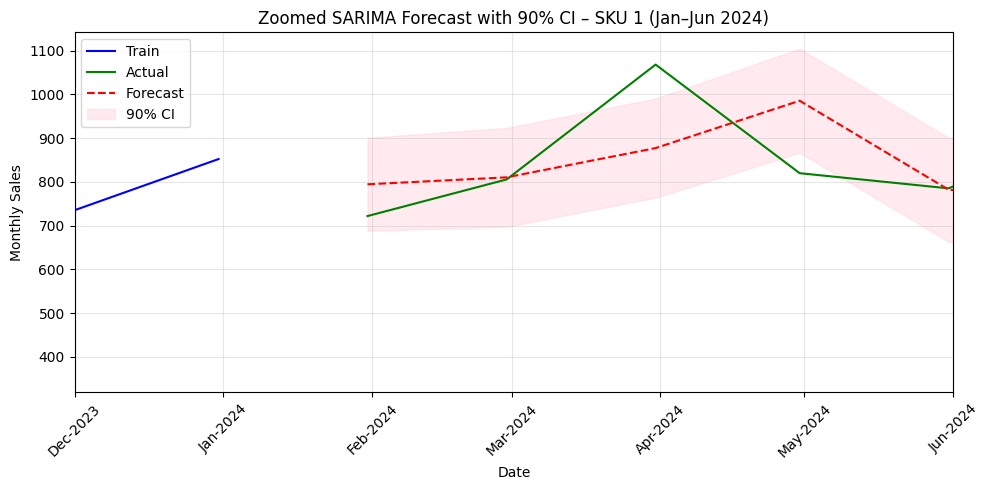

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

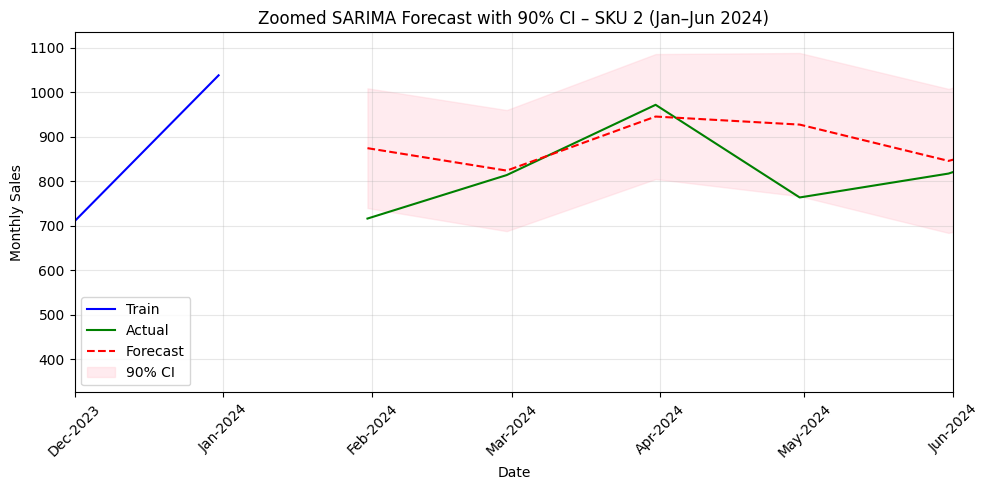

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

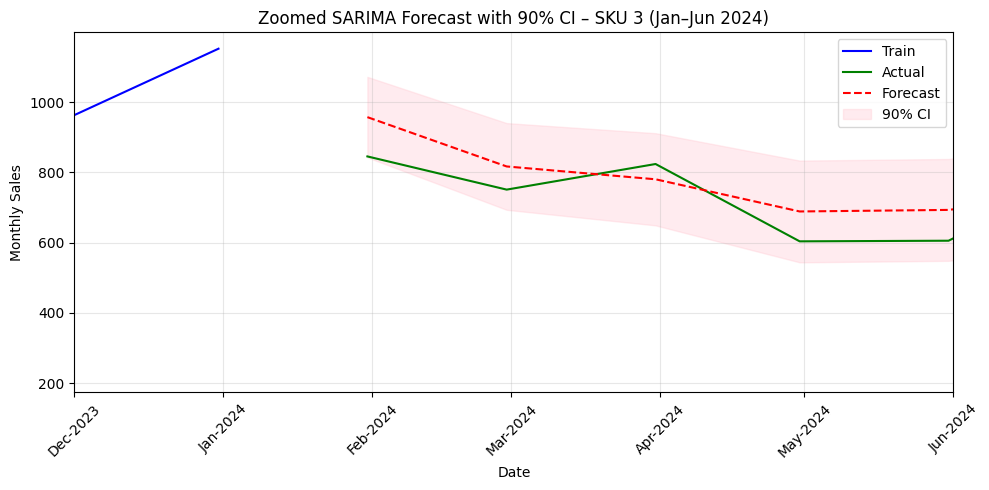

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

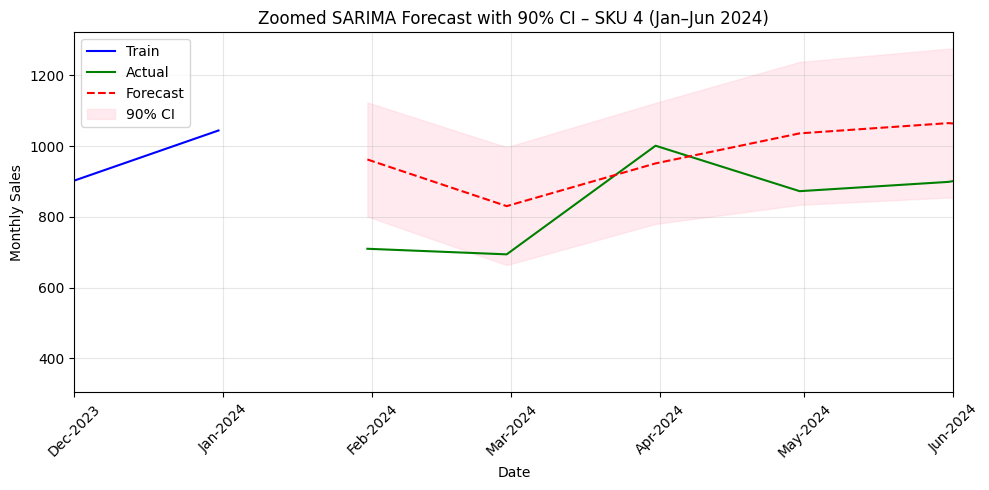

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

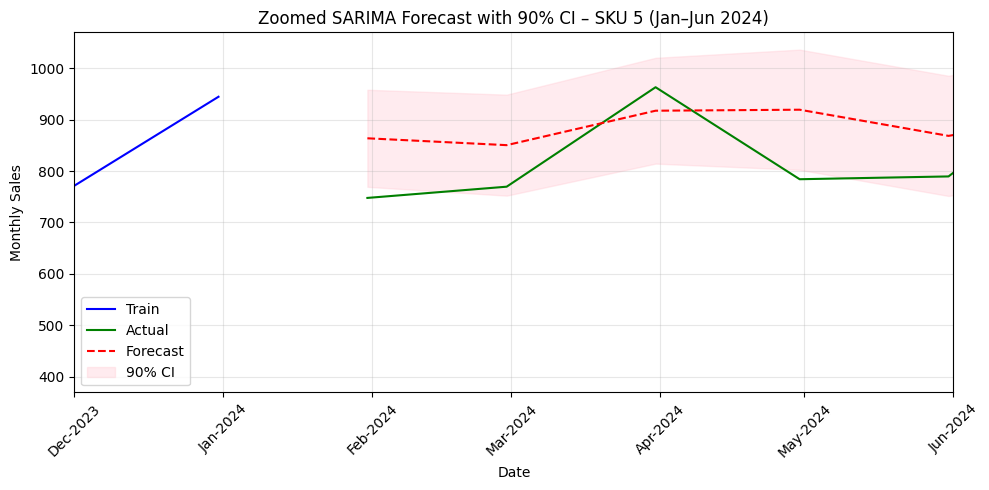

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

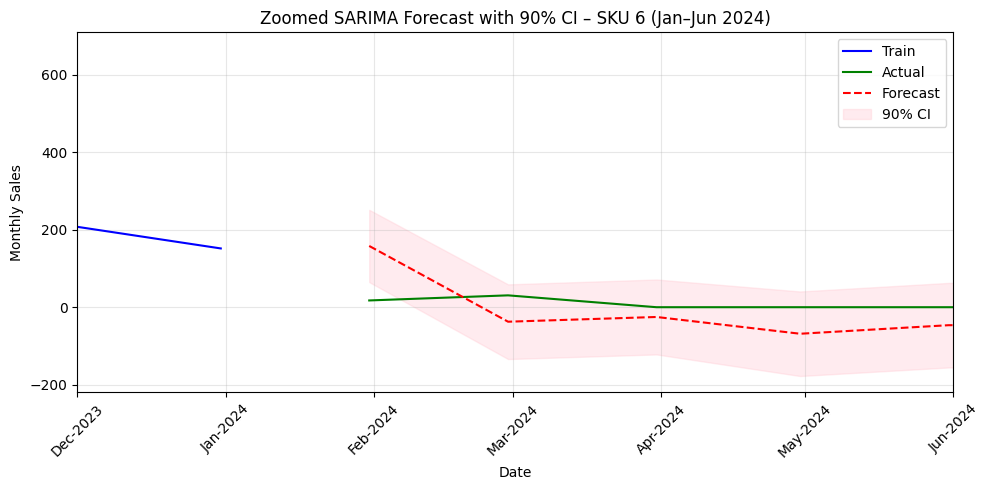

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

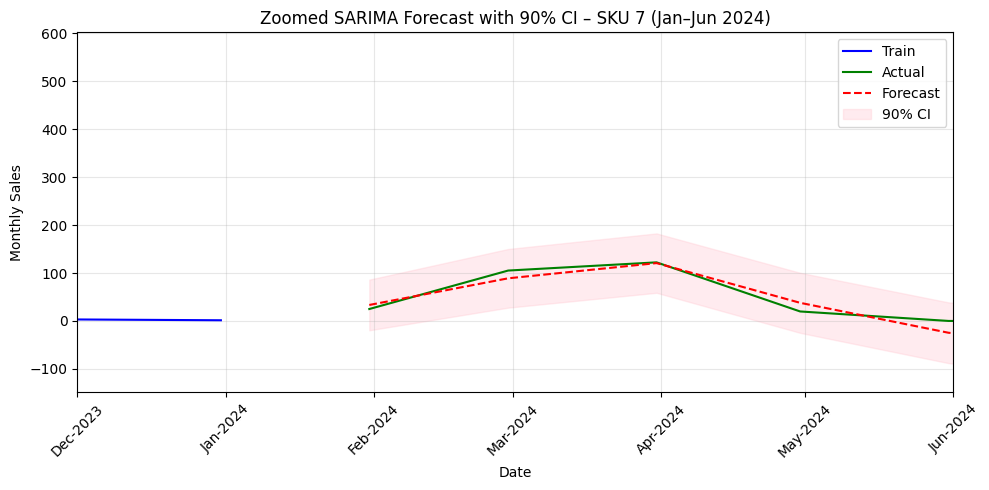

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

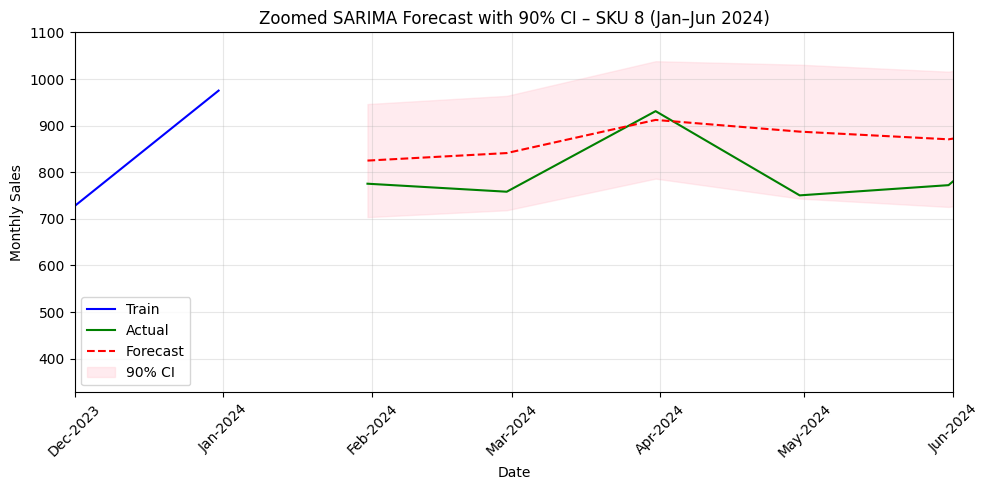

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

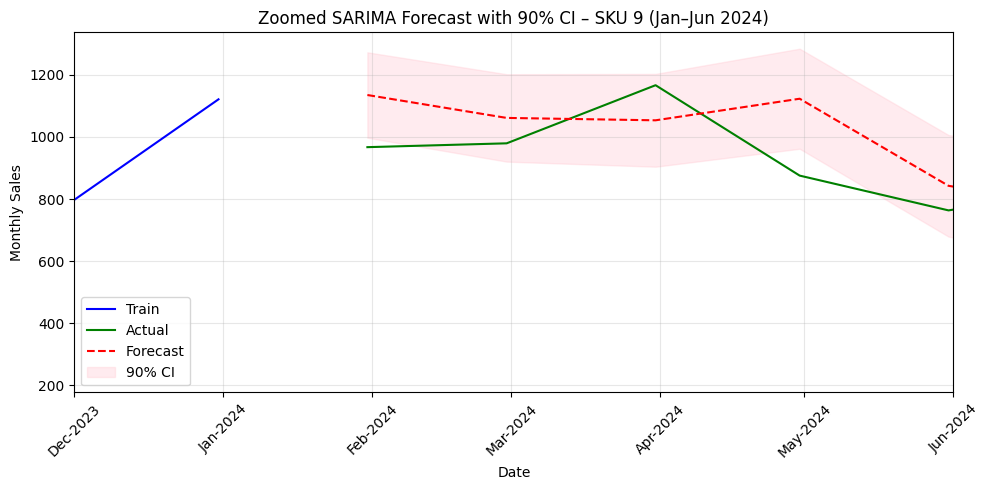

/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: F

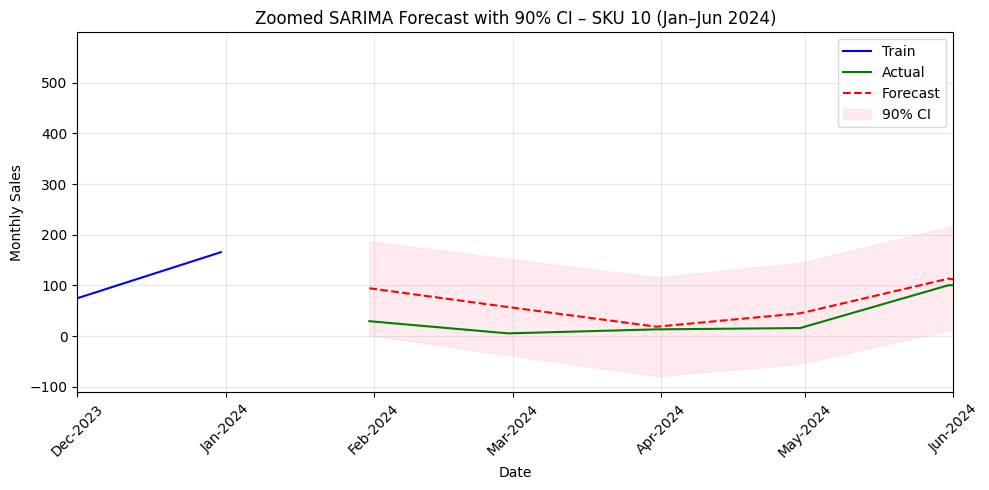

In [ ]:
from pmdarima import auto_arima
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error , mean_absolute_error
import numpy as np
import pandas as pd
import matplotlib.dates as mdates

import matplotlib.pyplot as plt

results_arima = []

for sku in sorted(data_monthly['SKU_ID'].unique()):
    train_sku = train[train['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
    test_sku = test[test['SKU_ID'] == sku].set_index('Date')['Monthly_Sales']
    
    try:
        model = auto_arima(
            train_sku,
            start_p=0, start_q=0,
            max_p=3, max_q=3,
            d=1,
            seasonal=True, m=12,
            trace=False,
            error_action='ignore',
            suppress_warnings=True,
            stepwise=True
        )

        forecast, conf_int = model.predict(n_periods=len(test_sku), return_conf_int=True, alpha=0.10)
        
        
        mape = mean_absolute_percentage_error(test_sku, forecast)
        rmse = np.sqrt(mean_squared_error(test_sku, forecast))
        mae = mean_absolute_error(test_sku,forecast)
        
        results_arima.append({
            'SKU_ID': sku,
            'MAPE': round(mape, 3),
            'RMSE': round(rmse, 3),
            'MAE': round(mae,3),
            'Order': model.order,
            'Seasonal_Order': model.seasonal_order
        })

        plt.figure(figsize=(10,5))
        plt.plot(train_sku, label='Train', color='blue')
        plt.plot(test_sku, label='Actual', color='green')
        plt.plot(test_sku.index, forecast, '--', color='red', label='Forecast')
        plt.fill_between(test_sku.index, conf_int[:,0], conf_int[:,1],
                        color='pink', alpha=0.3, label='90% CI')

        # set zoom window (adjust if your test starts earlier/later)
        plt.xlim(pd.to_datetime('2023-11-01'), pd.to_datetime('2024-07-01'))

        # month tick marks and rotation
        plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=1))
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b-%Y'))
        plt.xticks(rotation=45)

        plt.title(f"Zoomed SARIMA Forecast with 90% CI – SKU {sku} (Jan–Jun 2024)")
        plt.xlabel("Date")
        plt.ylabel("Monthly Sales")
        plt.legend()
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()


    except Exception as e:
        print(f"SKU {sku} failed: {e}")



# ML Models
1) We add more features like lag_1, lag_2, lag_3, rolling_mean_3, std_dev_3, month_sin and month_cos 
This helps the models to better feed more features as we dont really have features and can help understand and model predict

In [96]:
# for Ml models we will need some more features, and frame it in supervised problem

In [123]:
train_ml = data_monthly[data_monthly['Date'] < '2024-01-01']
test_ml  = data_monthly[data_monthly['Date'] >= '2024-01-01']


In [124]:
def add_features(df):
    df = df.sort_values(['SKU_ID', 'Date']).copy()
    for lag in range(1, 4):
        df[f'lag_{lag}'] = df.groupby('SKU_ID')['Monthly_Sales'].shift(lag)
    df['rolling_mean_3'] = df.groupby('SKU_ID')['Monthly_Sales'].transform(lambda x: x.rolling(3).mean())
    df['rolling_std_3'] = df.groupby('SKU_ID')['Monthly_Sales'].transform(lambda x: x.rolling(3).std())
    df['month'] = df['Date'].dt.month
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)
    return df

train_ml = add_features(train_ml)
train_ml = train_ml.dropna()


In [125]:
# figured that only features of lag to be included in test not train, it will lead to data leakage

In [126]:
train_ml

,SKU_ID,Date,Monthly_Sales,Month_Year,lag_1,lag_2,lag_3,rolling_mean_3,rolling_std_3,month,month_sin,month_cos
3,1,2019-04-30,468.330555,2019-04,616.705411,415.445741,356.169348,500.160569,104.337079,4,8.660254e-01,-5.000000e-01
4,1,2019-05-31,406.271277,2019-05,468.330555,616.705411,415.445741,497.102415,108.127222,5,5.000000e-01,-8.660254e-01
5,1,2019-06-30,455.061357,2019-06,406.271277,468.330555,616.705411,443.221063,32.680008,6,1.224647e-16,-1.000000e+00
6,1,2019-07-31,390.104918,2019-07,455.061357,406.271277,468.330555,417.145851,33.816076,7,-5.000000e-01,-8.660254e-01
7,1,2019-08-31,467.136946,2019-08,390.104918,455.061357,406.271277,437.434407,41.430851,8,-8.660254e-01,-5.000000e-01
...,...,...,...,...,...,...,...,...,...,...,...,...
649,10,2023-08-31,25.840539,2023-08,130.567162,114.784654,163.490709,90.397452,56.462095,8,-8.660254e-01,-5.000000e-01
650,10,2023-09-30,0.557039,2023-09,25.840539,130.567162,114.784654,52.321580,68.931794,9,-1.000000e+00,-1.836970e-16
651,10,2023-10-31,48.410381,2023-10,0.557039,25.840539,130.567162,24.935986,23.939491,10,-8.660254e-01,5.000000e-01
652,10,2023-11-30,71.717980,2023-11,48.410381,0.557039,25.840539,40.228467,36.279163,11,-5.000000e-01,8.660254e-01


#as we introduced lag_3 means it need 3 months prior data, that means 10 SKUS' * 3 = 30 rows less from orignal train_0df used in ARIMA or Exponentital Smoothening model

#The thing is as we have date and monthly sales as key features and monthly sales as dependent variable , it will be ahrd to use Linear regression unless some other features are given. 

In [128]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
import numpy as np
import pandas as pd

rf_results = []
rf_forecasts = {}

feature_cols = ['lag_1', 'lag_2', 'lag_3', 'rolling_mean_3', 'rolling_std_3', 'month_sin', 'month_cos']
target_col = 'Monthly_Sales'

for sku in sorted(train_ml['SKU_ID'].unique()):
    sku_train = train_ml[train_ml['SKU_ID'] == sku].copy()
    sku_test = test_ml[test_ml['SKU_ID'] == sku].copy()
    if sku_train.empty or sku_test.empty:
        continue

    # Fit model on train
    rf = RandomForestRegressor(n_estimators=300, random_state=42)
    rf.fit(sku_train[feature_cols], sku_train[target_col])
    
    # Initialize rolling window with last 3 train months
    history = sku_train[['Date', 'Monthly_Sales']].copy()
    preds = []
    
    for d in sku_test['Date']:
        # Build feature row dynamically from last 3 known months
        hist = history.tail(3)
        lag_1, lag_2, lag_3 = hist['Monthly_Sales'].iloc[-1], hist['Monthly_Sales'].iloc[-2], hist['Monthly_Sales'].iloc[-3]
        roll_mean = hist['Monthly_Sales'].mean()
        roll_std = hist['Monthly_Sales'].std()
        
        month = d.month
        month_sin = np.sin(2 * np.pi * month / 12)
        month_cos = np.cos(2 * np.pi * month / 12)
        
        X_pred = pd.DataFrame([{
            'lag_1': lag_1,
            'lag_2': lag_2,
            'lag_3': lag_3,
            'rolling_mean_3': roll_mean,
            'rolling_std_3': roll_std,
            'month_sin': month_sin,
            'month_cos': month_cos
        }])
        
        y_pred = rf.predict(X_pred)[0]
        preds.append(y_pred)
        
        # Append to history for next month’s lag computation
        history = pd.concat([history, pd.DataFrame({'Date': [d], 'Monthly_Sales': [y_pred]})])

    # Store predictions
    rf_forecasts[sku] = pd.DataFrame({
        'Date': sku_test['Date'],
        'Actual': sku_test['Monthly_Sales'].values,
        'Predicted': preds
    })

    # Evaluate
    y_true = sku_test['Monthly_Sales'].values
    mape = mean_absolute_percentage_error(y_true, preds)
    rmse = np.sqrt(mean_squared_error(y_true, preds))
    mae = mean_absolute_error(y_true, preds)

    rf_results.append({
        'SKU_ID': sku,
        'Model': 'RandomForest',
        'MAPE': round(mape, 3),
        'RMSE': round(rmse, 3),
        'MAE': round(mae, 3)
    })

rf_results_df = pd.DataFrame(rf_results)
print("\nRecursive Random Forest Performance by SKU:")
print(rf_results_df.sort_values('MAPE'))



Recursive Random Forest Performance by SKU:
   SKU_ID         Model          MAPE     RMSE      MAE
8       9  RandomForest  9.300000e-02  128.846   90.520
4       5  RandomForest  1.120000e-01  122.660   98.756
1       2  RandomForest  1.130000e-01  109.955   88.010
7       8  RandomForest  1.130000e-01  105.432   95.951
0       1  RandomForest  1.210000e-01  120.277  101.291
3       4  RandomForest  1.580000e-01  145.788  125.793
2       3  RandomForest  3.100000e-01  227.987  213.402
9      10  RandomForest  6.238000e+00   86.542   78.546
6       7  RandomForest  1.251734e+17   59.748   53.078
5       6  RandomForest  6.344876e+17  204.824  203.125


In [129]:
# as we want lag1 , lag_2 and other features we created in Xtest, it can reduce actual test size, and so predict month by month and then run

In [131]:
rf_results_df

,SKU_ID,Model,MAPE,RMSE,MAE
0,1,RandomForest,1.210000e-01,120.277,101.291
1,2,RandomForest,1.130000e-01,109.955,88.010
2,3,RandomForest,3.100000e-01,227.987,213.402
3,4,RandomForest,1.580000e-01,145.788,125.793
4,5,RandomForest,1.120000e-01,122.660,98.756
5,6,RandomForest,6.344876e+17,204.824,203.125
6,7,RandomForest,1.251734e+17,59.748,53.078
7,8,RandomForest,1.130000e-01,105.432,95.951
8,9,RandomForest,9.300000e-02,128.846,90.520
9,10,RandomForest,6.238000e+00,86.542,78.546


In [132]:
results_arima_df

,SKU_ID,MAPE,RMSE,MAE,Order,Seasonal_Order
0,1,1.110000e-01,126.118,99.826,"(2, 1, 1)","(1, 0, 0, 12)"
1,2,8.600000e-02,94.391,65.747,"(3, 1, 0)","(0, 0, 1, 12)"
2,3,1.070000e-01,79.517,76.557,"(3, 1, 0)","(0, 1, 1, 12)"
3,4,1.720000e-01,154.149,137.814,"(2, 1, 0)","(1, 0, 1, 12)"
4,5,1.110000e-01,95.122,90.745,"(3, 1, 0)","(0, 0, 1, 12)"
5,6,1.394829e+17,75.241,65.742,"(3, 1, 2)","(2, 0, 0, 12)"
6,7,5.668340e+16,25.347,19.960,"(0, 1, 2)","(1, 0, 1, 12)"
7,8,1.020000e-01,92.418,83.541,"(3, 1, 0)","(0, 0, 0, 12)"
8,9,1.380000e-01,141.599,126.909,"(3, 1, 0)","(0, 1, 0, 12)"
9,10,2.373000e+00,37.003,30.034,"(0, 1, 1)","(1, 0, 0, 12)"


### arima is still better

In [134]:
test_ml = add_features(test_ml)
test_ml = test_ml.dropna()

In [135]:
test_ml

,SKU_ID,Date,Monthly_Sales,Month_Year,lag_1,lag_2,lag_3,rolling_mean_3,rolling_std_3,month,month_sin,month_cos
63,1,2024-04-30,819.798171,2024-04,1068.084289,805.629628,721.780045,897.837363,147.608261,4,8.660254e-01,-0.500000
64,1,2024-05-31,785.156106,2024-05,819.798171,1068.084289,805.629628,891.012855,154.323484,5,5.000000e-01,-0.866025
65,1,2024-06-30,920.069591,2024-06,785.156106,819.798171,1068.084289,841.674623,70.066729,6,1.224647e-16,-1.000000
129,2,2024-04-30,763.662475,2024-04,971.771425,813.968407,716.257886,849.800769,108.583159,4,8.660254e-01,-0.500000
130,2,2024-05-31,817.351766,2024-05,763.662475,971.771425,813.968407,850.928555,108.041124,5,5.000000e-01,-0.866025
131,2,2024-06-30,924.773890,2024-06,817.351766,763.662475,971.771425,835.262710,82.035501,6,1.224647e-16,-1.000000
195,3,2024-04-30,603.362026,2024-04,823.514486,750.598480,845.108142,725.824997,112.147539,4,8.660254e-01,-0.500000
196,3,2024-05-31,605.121396,2024-05,603.362026,823.514486,750.598480,677.332636,126.600252,5,5.000000e-01,-0.866025
197,3,2024-06-30,809.036970,2024-06,605.121396,603.362026,823.514486,672.506797,118.241870,6,1.224647e-16,-1.000000
261,4,2024-04-30,872.496576,2024-04,1001.020306,693.858472,709.626460,855.791785,154.260772,4,8.660254e-01,-0.500000


1) XGBOOST 

In [137]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
import numpy as np
import pandas as pd

xgb_results = []
xgb_forecasts = {}

for sku in sorted(train_ml['SKU_ID'].unique()):
    train_sku = train_ml[train_ml['SKU_ID'] == sku]
    test_sku = test_ml[test_ml['SKU_ID'] == sku]
    
    if train_sku.empty or test_sku.empty:
        continue

    X_train = train_sku[feature_cols]
    y_train = train_sku[target_col]
    X_test = test_sku[feature_cols]
    y_test = test_sku[target_col]
    
    # Fit XGBoost
    xgb = XGBRegressor(
        n_estimators=400,
        learning_rate=0.05,
        max_depth=5,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )
    xgb.fit(X_train, y_train)
    preds = xgb.predict(X_test)
    
    # Store predictions for visualisation
    xgb_forecasts[sku] = pd.DataFrame({
        'Date': test_sku['Date'],
        'Actual': y_test.values,
        'Predicted': preds
    })
    
    # Metrics
    mape = mean_absolute_percentage_error(y_test, preds)
    rmse = np.sqrt(mean_squared_error(y_test, preds))
    mae = mean_absolute_error(y_test, preds)
    
    xgb_results.append({
        'SKU_ID': sku,
        'Model': 'XGBoost',
        'MAPE': round(mape, 3),
        'RMSE': round(rmse, 3),
        'MAE': round(mae, 3)
    })

xgb_results_df = pd.DataFrame(xgb_results)
print("\nXGBoost Performance by SKU:")
print(xgb_results_df.sort_values('MAPE'))



XGBoost Performance by SKU:
   SKU_ID    Model          MAPE     RMSE     MAE
1       2  XGBoost  6.200000e-02   68.905  54.653
0       1  XGBoost  6.900000e-02   61.992  56.836
7       8  XGBoost  7.600000e-02   98.450  72.720
2       3  XGBoost  8.900000e-02   88.906  66.121
4       5  XGBoost  1.000000e-01  126.637  93.924
3       4  XGBoost  1.040000e-01  105.553  96.824
8       9  XGBoost  1.150000e-01   95.113  95.036
9      10  XGBoost  1.496000e+00   40.810  34.159
5       6  XGBoost  2.518860e+16    6.174   5.593
6       7  XGBoost  1.554522e+17   66.014  57.803


2. LightGBM

In [138]:
from lightgbm import LGBMRegressor

lgb_results = []
lgb_forecasts = {}

for sku in sorted(train_ml['SKU_ID'].unique()):
    train_sku = train_ml[train_ml['SKU_ID'] == sku]
    test_sku = test_ml[test_ml['SKU_ID'] == sku]
    
    if train_sku.empty or test_sku.empty:
        continue

    X_train = train_sku[feature_cols]
    y_train = train_sku[target_col]
    X_test = test_sku[feature_cols]
    y_test = test_sku[target_col]
    
    # Fit LightGBM
    lgb = LGBMRegressor(
        n_estimators=400,
        learning_rate=0.05,
        max_depth=-1,
        num_leaves=31,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )
    lgb.fit(X_train, y_train)
    preds = lgb.predict(X_test)
    
    # Store forecasts
    lgb_forecasts[sku] = pd.DataFrame({
        'Date': test_sku['Date'],
        'Actual': y_test.values,
        'Predicted': preds
    })
    
    # Metrics
    mape = mean_absolute_percentage_error(y_test, preds)
    rmse = np.sqrt(mean_squared_error(y_test, preds))
    mae = mean_absolute_error(y_test, preds)
    
    lgb_results.append({
        'SKU_ID': sku,
        'Model': 'LightGBM',
        'MAPE': round(mape, 3),
        'RMSE': round(rmse, 3),
        'MAE': round(mae, 3)
    })

lgb_results_df = pd.DataFrame(lgb_results)
print("\nLightGBM Performance by SKU:")
print(lgb_results_df.sort_values('MAPE'))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 122
[LightGBM] [Info] Number of data points in the train set: 57, number of used features: 7
[LightGBM] [Info] Start training from score 641.393391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

In [139]:
lgb_results_df

,SKU_ID,Model,MAPE,RMSE,MAE
0,1,LightGBM,9.800000e-02,152.927,90.157
1,2,LightGBM,8.600000e-02,104.895,76.883
2,3,LightGBM,1.730000e-01,140.331,121.031
3,4,LightGBM,1.410000e-01,141.639,130.637
4,5,LightGBM,8.600000e-02,133.411,84.460
5,6,LightGBM,2.385807e+17,56.727,52.976
6,7,LightGBM,2.866875e+17,93.149,92.614
7,8,LightGBM,9.500000e-02,153.579,95.781
8,9,LightGBM,1.310000e-01,120.545,109.346
9,10,LightGBM,2.645000e+00,72.150,57.986


In [140]:
results_arima_df

,SKU_ID,MAPE,RMSE,MAE,Order,Seasonal_Order
0,1,1.110000e-01,126.118,99.826,"(2, 1, 1)","(1, 0, 0, 12)"
1,2,8.600000e-02,94.391,65.747,"(3, 1, 0)","(0, 0, 1, 12)"
2,3,1.070000e-01,79.517,76.557,"(3, 1, 0)","(0, 1, 1, 12)"
3,4,1.720000e-01,154.149,137.814,"(2, 1, 0)","(1, 0, 1, 12)"
4,5,1.110000e-01,95.122,90.745,"(3, 1, 0)","(0, 0, 1, 12)"
5,6,1.394829e+17,75.241,65.742,"(3, 1, 2)","(2, 0, 0, 12)"
6,7,5.668340e+16,25.347,19.960,"(0, 1, 2)","(1, 0, 1, 12)"
7,8,1.020000e-01,92.418,83.541,"(3, 1, 0)","(0, 0, 0, 12)"
8,9,1.380000e-01,141.599,126.909,"(3, 1, 0)","(0, 1, 0, 12)"
9,10,2.373000e+00,37.003,30.034,"(0, 1, 1)","(1, 0, 0, 12)"


# Visualising performance of XGboost and LightGBM

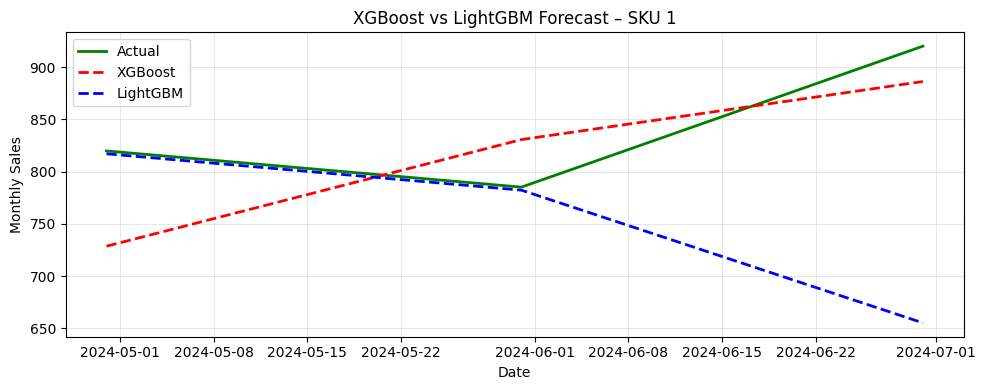

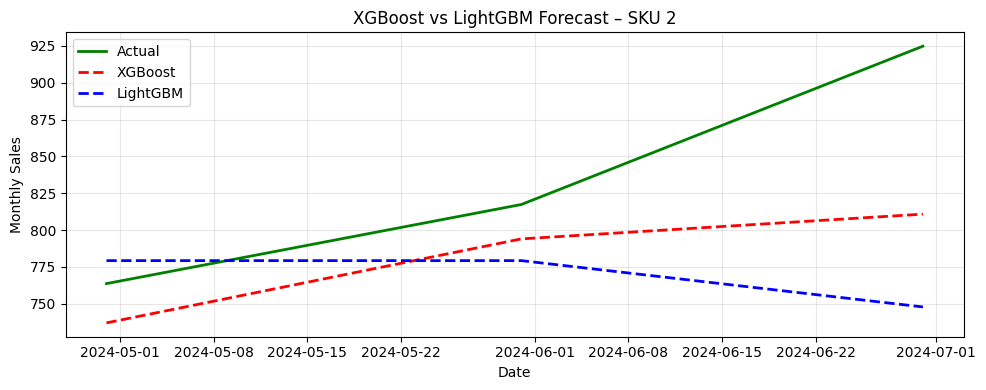

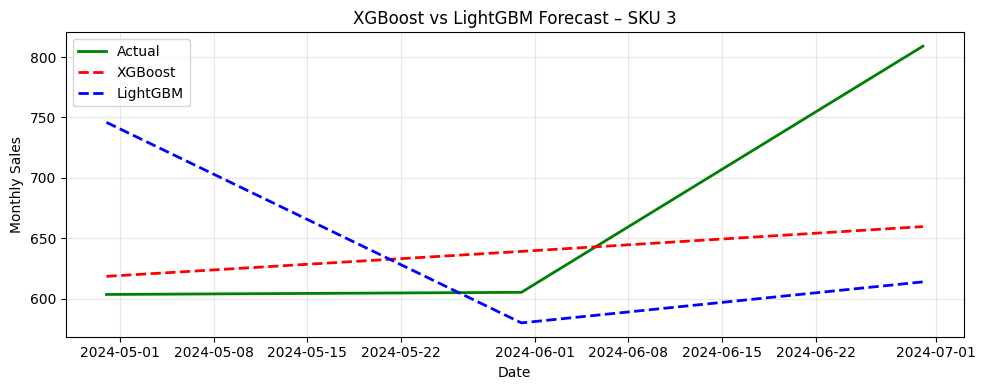

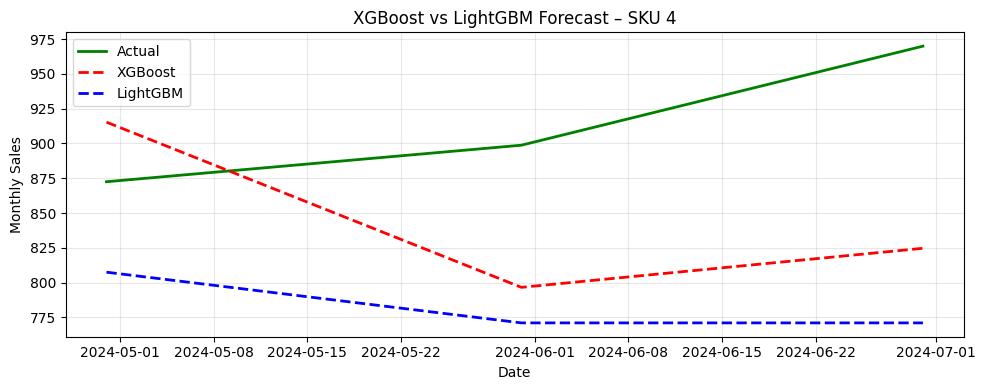

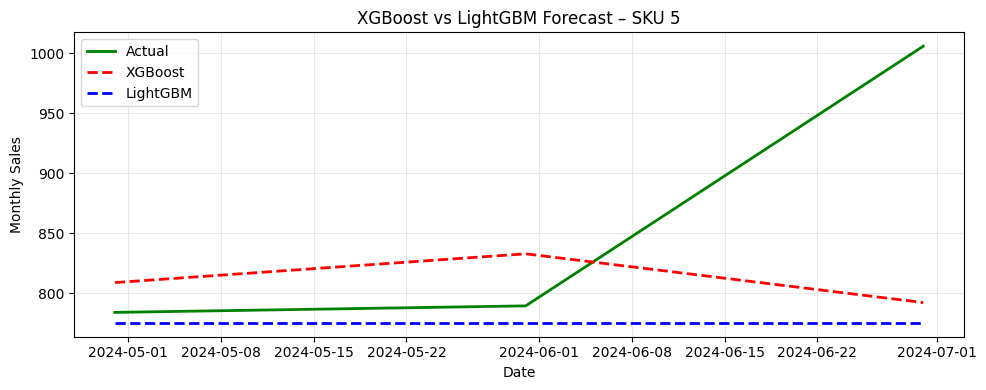

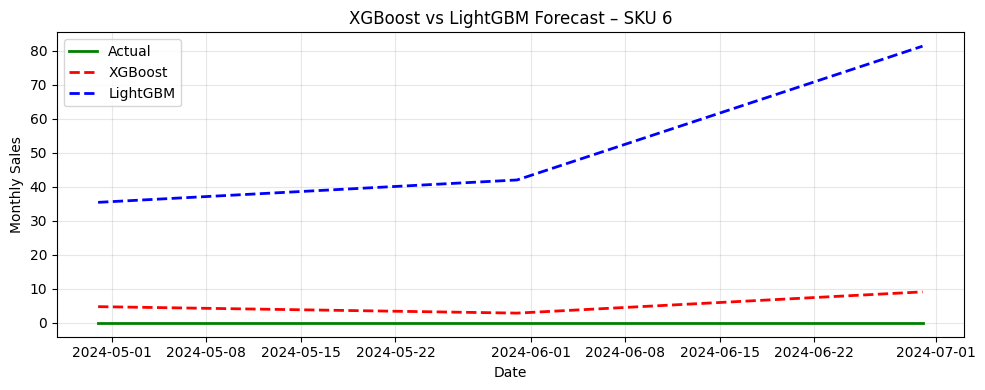

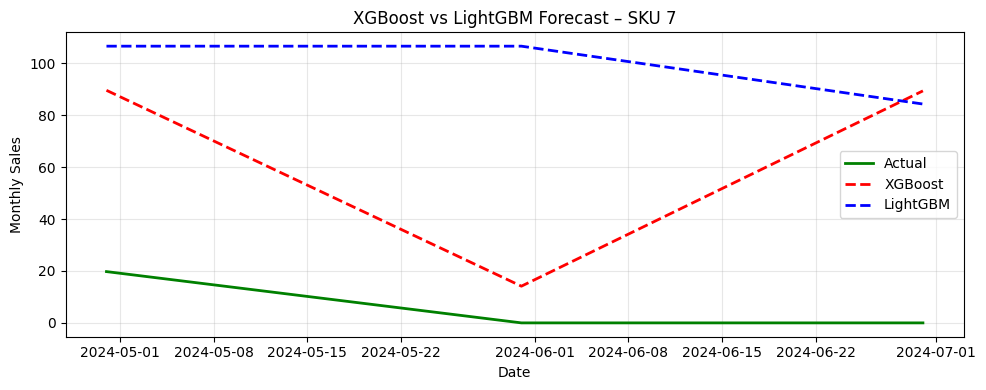

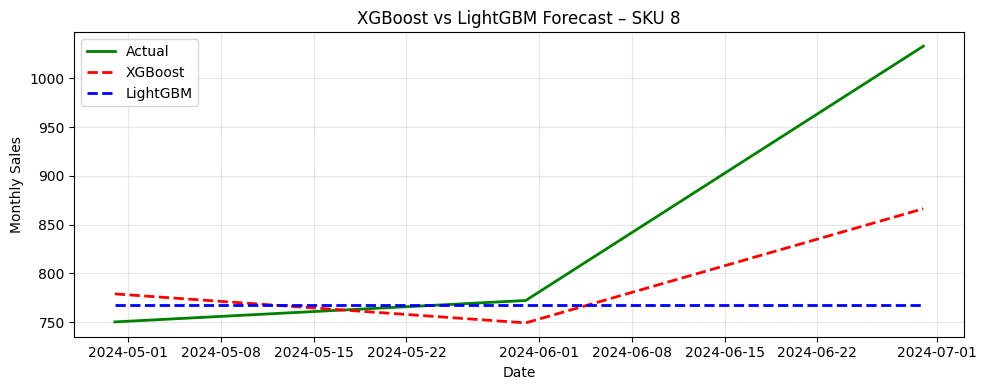

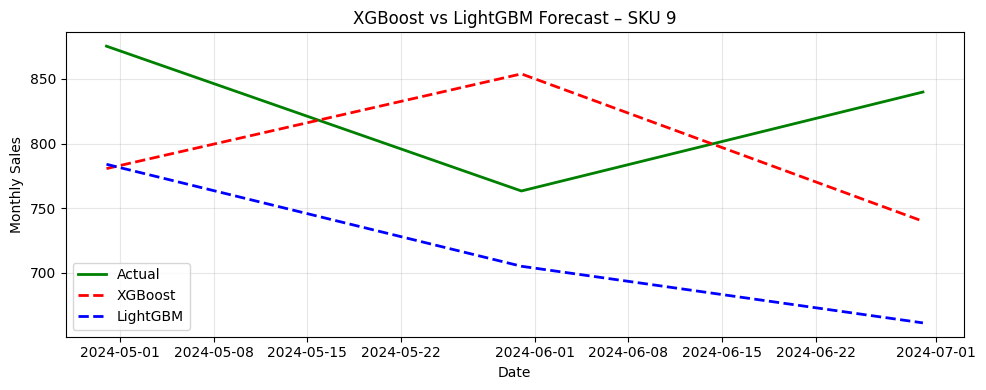

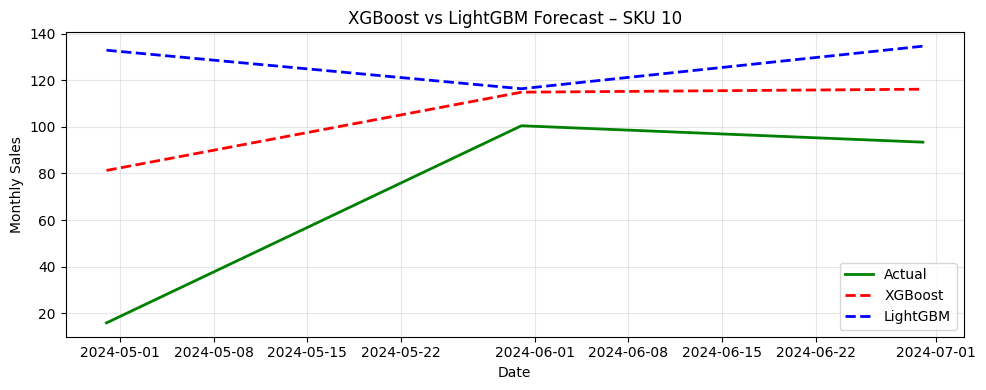

In [141]:
import matplotlib.pyplot as plt

for sku in sorted(xgb_forecasts.keys()):
    df_xgb = xgb_forecasts[sku]
    df_lgb = lgb_forecasts[sku]
    
    plt.figure(figsize=(10, 4))
    plt.plot(df_xgb['Date'], df_xgb['Actual'], label='Actual', color='green', linewidth=2)
    plt.plot(df_xgb['Date'], df_xgb['Predicted'], '--', label='XGBoost', color='red', linewidth=2)
    plt.plot(df_lgb['Date'], df_lgb['Predicted'], '--', label='LightGBM', color='blue', linewidth=2)
    
    plt.title(f"XGBoost vs LightGBM Forecast – SKU {sku}")
    plt.xlabel('Date')
    plt.ylabel('Monthly Sales')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()


In [142]:
#prolly not lgb model, goes so opp

In [143]:
train

,SKU_ID,Date,Monthly_Sales,Month_Year
0,1,2019-01-31,356.169348,2019-01
1,1,2019-02-28,415.445741,2019-02
2,1,2019-03-31,616.705411,2019-03
3,1,2019-04-30,468.330555,2019-04
4,1,2019-05-31,406.271277,2019-05
...,...,...,...,...
649,10,2023-08-31,25.840539,2023-08
650,10,2023-09-30,0.557039,2023-09
651,10,2023-10-31,48.410381,2023-10
652,10,2023-11-30,71.717980,2023-11


# Prophet Model for forecasting - Meta

14:50:19 - cmdstanpy - INFO - Chain [1] start processing
14:50:19 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


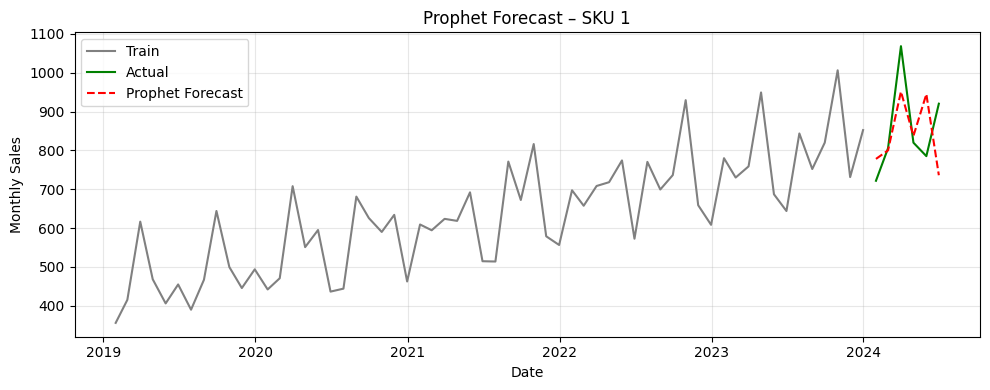

14:50:19 - cmdstanpy - INFO - Chain [1] start processing
14:50:19 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


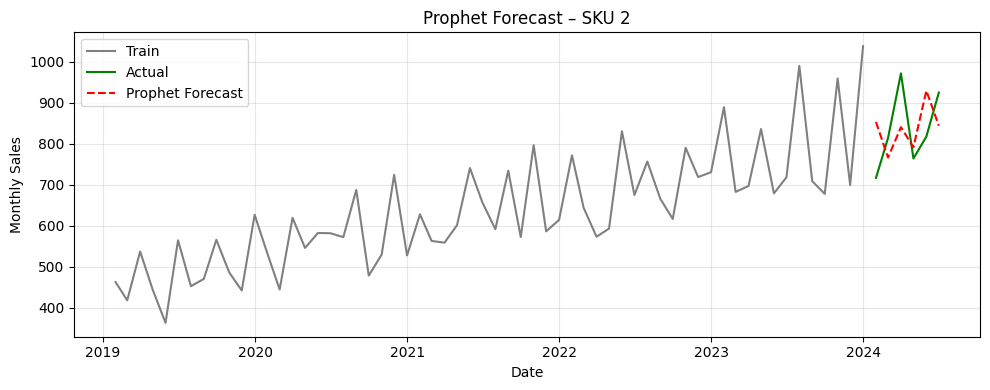

14:50:19 - cmdstanpy - INFO - Chain [1] start processing
14:50:20 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


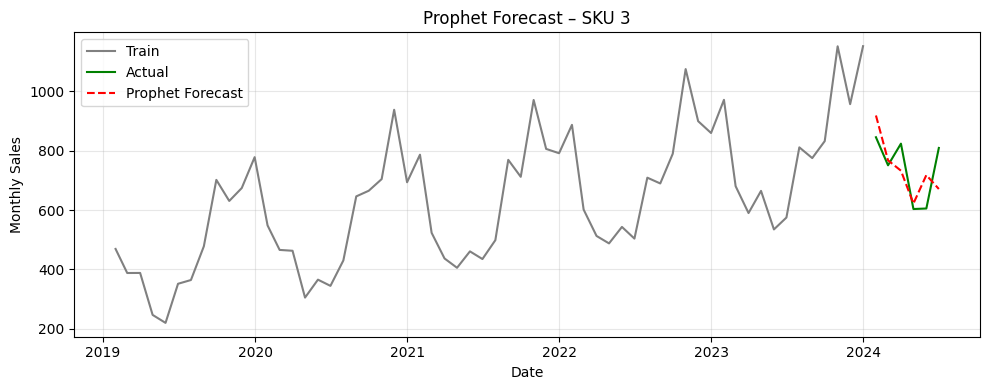

14:50:20 - cmdstanpy - INFO - Chain [1] start processing
14:50:20 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


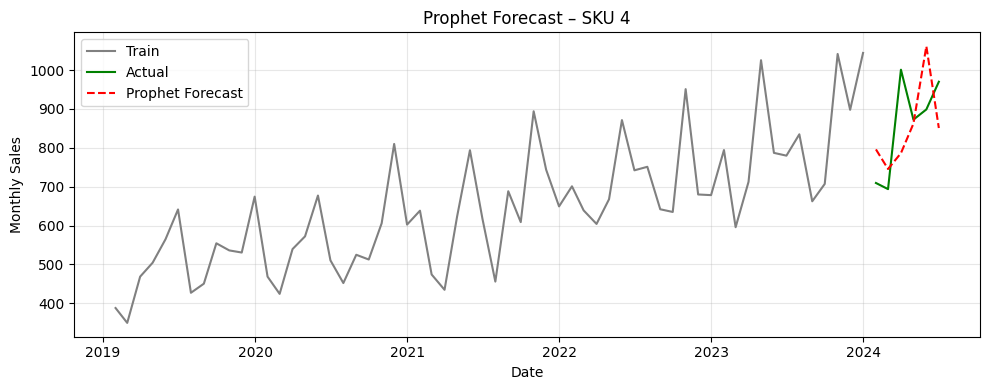

14:50:20 - cmdstanpy - INFO - Chain [1] start processing
14:50:20 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


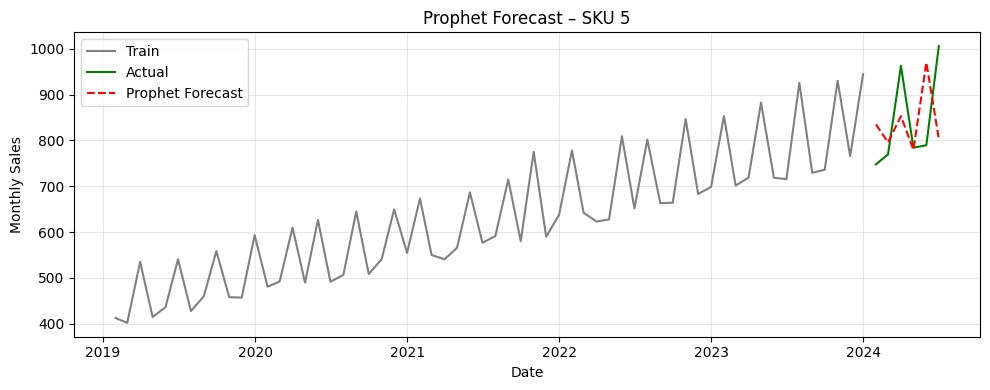

14:50:20 - cmdstanpy - INFO - Chain [1] start processing
14:50:20 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


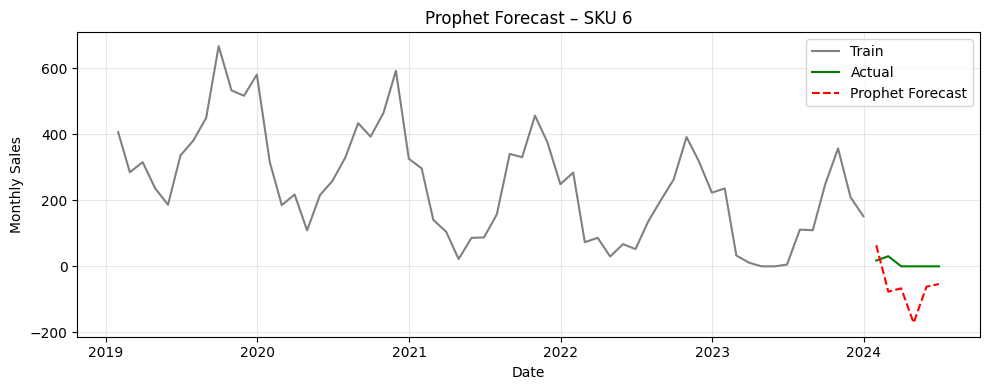

14:50:21 - cmdstanpy - INFO - Chain [1] start processing
14:50:21 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


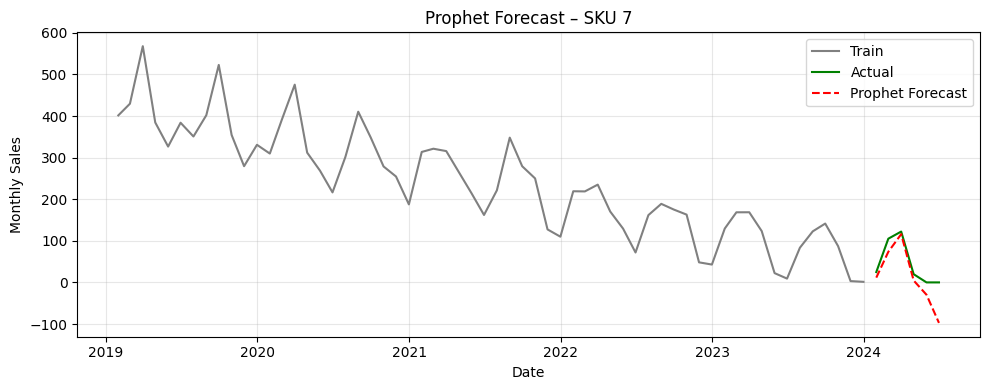

14:50:21 - cmdstanpy - INFO - Chain [1] start processing
14:50:21 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


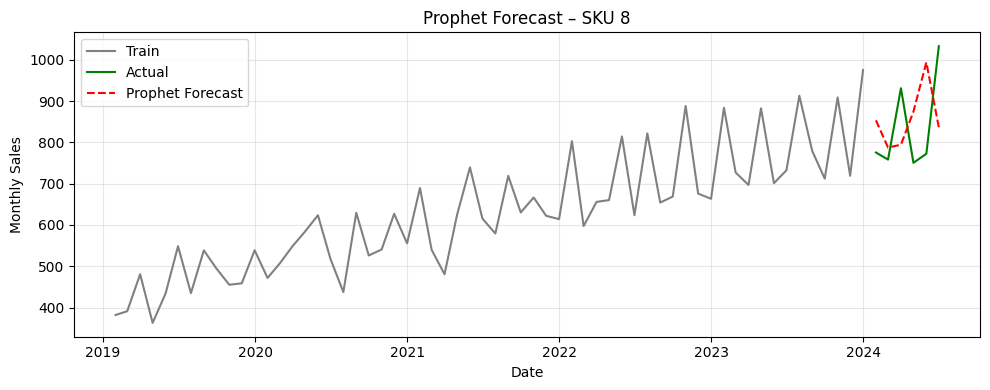

14:50:21 - cmdstanpy - INFO - Chain [1] start processing
14:50:21 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


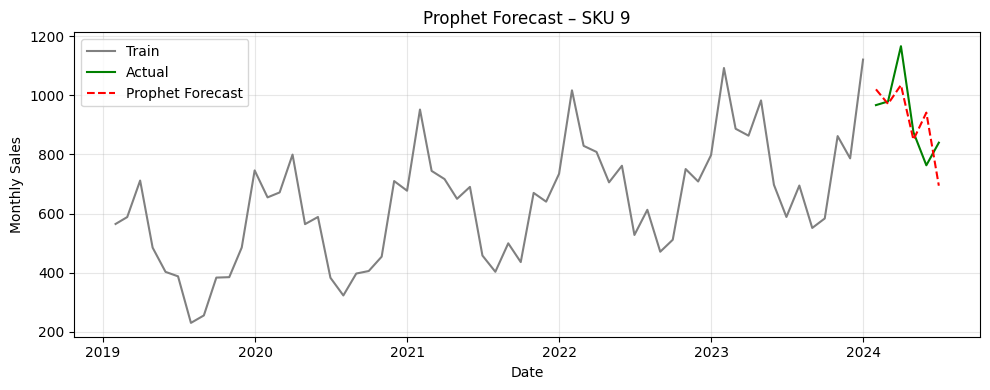

14:50:22 - cmdstanpy - INFO - Chain [1] start processing
14:50:22 - cmdstanpy - INFO - Chain [1] done processing
/Users/dharmikbhagat/kpi_dashboard/venv/lib/python3.10/site-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(


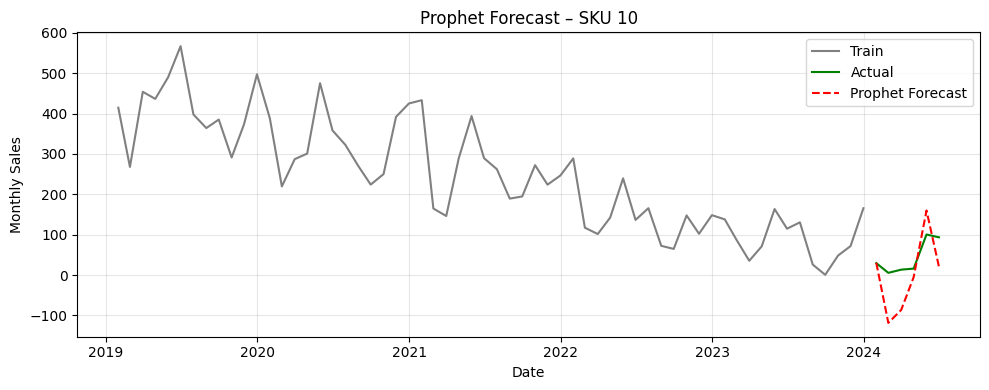

   SKU_ID    Model          MAPE     RMSE      MAE
2       3  Prophet  1.010000e-01   87.599   75.033
8       9  Prophet  1.020000e-01  110.877   90.398
0       1  Prophet  1.030000e-01  112.897   89.970
1       2  Prophet  1.080000e-01   98.471   89.479
4       5  Prophet  1.170000e-01  125.240  101.863
3       4  Prophet  1.210000e-01  127.106  107.442
7       8  Prophet  1.550000e-01  146.454  130.991
9      10  Prophet  5.488000e+00   75.941   63.017
6       7  Prophet  9.532352e+16   44.334   32.227
5       6  Prophet  2.651698e+17   95.014   84.531


In [150]:
from prophet import Prophet
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

prophet_results = []
prophet_forecasts = {}

for sku in sorted(data_monthly['SKU_ID'].unique()):
    train_sku = train[train['SKU_ID'] == sku][['Date', 'Monthly_Sales']].rename(columns={'Date':'ds','Monthly_Sales':'y'})
    test_sku = test[test['SKU_ID'] == sku][['Date', 'Monthly_Sales']].rename(columns={'Date':'ds','Monthly_Sales':'y'})
    
    if train_sku.empty or test_sku.empty:
        continue
    
    # Initialize Prophet model
    m = Prophet(
        yearly_seasonality=True,
        weekly_seasonality=False,
        daily_seasonality=False,
        seasonality_mode='additive',
        changepoint_prior_scale=0.1
    )
    m.fit(train_sku)
    
    # Create future dataframe for test horizon
    future = m.make_future_dataframe(periods=len(test_sku), freq='M')
    forecast = m.predict(future)
    
    # Filter test window
    forecast_test = forecast[forecast['ds'].isin(test_sku['ds'])]
    preds = forecast_test['yhat'].values
    
    # Metrics
    y_true = test_sku['y'].values
    mape = mean_absolute_percentage_error(y_true, preds)
    rmse = np.sqrt(mean_squared_error(y_true, preds))
    mae = mean_absolute_error(y_true, preds)
    
    prophet_results.append({
        'SKU_ID': sku,
        'Model': 'Prophet',
        'MAPE': round(mape, 3),
        'RMSE': round(rmse, 3),
        'MAE': round(mae, 3)
    })
    
    prophet_forecasts[sku] = pd.DataFrame({
        'Date': test_sku['ds'],
        'Actual': y_true,
        'Predicted': preds
    })
    
    # Plot
    plt.figure(figsize=(10,4))
    plt.plot(train_sku['ds'], train_sku['y'], label='Train', color='gray')
    plt.plot(test_sku['ds'], test_sku['y'], label='Actual', color='green')
    plt.plot(test_sku['ds'], preds, '--', label='Prophet Forecast', color='red')
    plt.title(f"Prophet Forecast – SKU {sku}")
    plt.xlabel('Date'); plt.ylabel('Monthly Sales')
    plt.legend(); plt.grid(alpha=0.3); plt.tight_layout()
    plt.show()

prophet_results_df = pd.DataFrame(prophet_results)
print(prophet_results_df.sort_values('MAPE'))


In [149]:
results_arima_df

,SKU_ID,MAPE,RMSE,MAE,Order,Seasonal_Order
0,1,1.110000e-01,126.118,99.826,"(2, 1, 1)","(1, 0, 0, 12)"
1,2,8.600000e-02,94.391,65.747,"(3, 1, 0)","(0, 0, 1, 12)"
2,3,1.070000e-01,79.517,76.557,"(3, 1, 0)","(0, 1, 1, 12)"
3,4,1.720000e-01,154.149,137.814,"(2, 1, 0)","(1, 0, 1, 12)"
4,5,1.110000e-01,95.122,90.745,"(3, 1, 0)","(0, 0, 1, 12)"
5,6,1.394829e+17,75.241,65.742,"(3, 1, 2)","(2, 0, 0, 12)"
6,7,5.668340e+16,25.347,19.960,"(0, 1, 2)","(1, 0, 1, 12)"
7,8,1.020000e-01,92.418,83.541,"(3, 1, 0)","(0, 0, 0, 12)"
8,9,1.380000e-01,141.599,126.909,"(3, 1, 0)","(0, 1, 0, 12)"
9,10,2.373000e+00,37.003,30.034,"(0, 1, 1)","(1, 0, 0, 12)"


In [153]:
data_monthly

,SKU_ID,Date,Monthly_Sales,Month_Year
0,1,2019-01-31,356.169348,2019-01
1,1,2019-02-28,415.445741,2019-02
2,1,2019-03-31,616.705411,2019-03
3,1,2019-04-30,468.330555,2019-04
4,1,2019-05-31,406.271277,2019-05
...,...,...,...,...
655,10,2024-02-29,5.453175,2024-02
656,10,2024-03-31,13.362990,2024-03
657,10,2024-04-30,15.935134,2024-04
658,10,2024-05-31,100.467238,2024-05


In [161]:
from typing import Dict, Union


In [ ]:
#Function for KPI calculation

import numpy as np
import pandas as pd
from typing import Dict, Union

def calculate_forecast_kpis(
    actual: Union[np.ndarray, pd.Series, list],
    predicted: Union[np.ndarray, pd.Series, list],
    zero_threshold: float = 0.01
) -> Dict[str, float]:
    """
    Calculate comprehensive KPIs for demand forecasting.
    
    Parameters:
    actual : array-like
        Actual/observed values
    predicted : array-like
        Predicted/forecasted values
    zero_threshold : float, default=0.01
        Values below this are considered zero
    
    Returns:
    dict : Dictionary with all KPI metrics
    
    KPIs Included:

    Core Metrics:
        - MAE: Mean Absolute Error
        - RMSE: Root Mean Squared Error  
        - Bias_%: Percentage bias (systematic over/under forecasting)
        - Service_Level_%: % of periods where forecast >= actual
        
    Traditional Metrics:
        - SMAPE: Symmetric Mean Absolute Percentage Error
        - Tracking_Signal: CFE / MAD (detects drift)
        
    Context Metrics:
        - Zero_Sales_Count, Zero_Sales_%
        - Mean_Actual, Mean_Forecast
        - Total_Periods
    """
    
    # Convert to numpy arrays
    actual = np.array(actual, dtype=float)
    predicted = np.array(predicted, dtype=float)
    
    # Validate
    if len(actual) != len(predicted):
        raise ValueError(f"Length mismatch: actual={len(actual)}, predicted={len(predicted)}")
    
    if len(actual) == 0:
        raise ValueError("Empty arrays provided")
    
    kpis = {}
    
    #  CONTEXT METRICS
    total_periods = len(actual)
    zero_mask = np.abs(actual) < zero_threshold
    non_zero_mask = ~zero_mask
    zero_count = np.sum(zero_mask)
    zero_percentage = (zero_count / total_periods) * 100
    
    kpis['Total_Periods'] = int(total_periods)
    kpis['Zero_Sales_Count'] = int(zero_count)
    kpis['Zero_Sales_%'] = round(zero_percentage, 2)
    kpis['Mean_Actual'] = round(np.mean(actual), 2)
    kpis['Mean_Forecast'] = round(np.mean(predicted), 2)
    
    #  CORE METRICS 
    
    # 1. MAE - Mean Absolute Error
    mae = np.mean(np.abs(actual - predicted))
    kpis['MAE'] = round(mae, 3)
    
    # 2. RMSE - Root Mean Squared Error
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))
    kpis['RMSE'] = round(rmse, 3)
    
    # 3. Bias % - Only on non-zero actuals to avoid division issues
    if np.sum(non_zero_mask) > 0 and np.sum(actual[non_zero_mask]) != 0:
        bias_pct = (np.sum(predicted[non_zero_mask] - actual[non_zero_mask]) / 
                    np.sum(actual[non_zero_mask])) * 100
        kpis['Bias_%'] = round(bias_pct, 3)
    else:
        kpis['Bias_%'] = np.nan
    
    # 4. Service Level % - How often forecast met demand
    service_level = (np.sum(predicted >= actual) / total_periods) * 100
    kpis['Service_Level_%'] = round(service_level, 2)
    
    # TRADITIONAL METRICS 
    
    # 5. SMAPE - Only on non-zero periods to avoid inflation
    if np.sum(non_zero_mask) > 0:
        smape_denominator = np.abs(actual[non_zero_mask]) + np.abs(predicted[non_zero_mask])
        smape_mask = smape_denominator != 0
        if np.sum(smape_mask) > 0:
            smape = np.mean(200 * np.abs(actual[non_zero_mask][smape_mask] - 
                                         predicted[non_zero_mask][smape_mask]) / 
                           smape_denominator[smape_mask])
            kpis['SMAPE'] = round(smape, 3)
        else:
            kpis['SMAPE'] = np.nan
    else:
        kpis['SMAPE'] = np.nan
    
    # 6. Tracking Signal - Detects forecast drift
    mad = np.mean(np.abs(predicted - actual))
    cfe = np.sum(predicted - actual)
    if mad != 0:
        tracking_signal = cfe / mad
        kpis['Tracking_Signal'] = round(tracking_signal, 3)
    else:
        kpis['Tracking_Signal'] = np.nan
    
    return kpis
# display KPIs with rounded values for better understanding than cramming on decimal points

def display_kpis(kpis_dict: Dict, title: str = "Forecast KPIs") -> None:
    """
    Pretty print KPIs in notebook.
    
    Parameters:
    -----------
    kpis_dict : dict
        Output from calculate_forecast_kpis()
    title : str
        Title for display
    """
    print("=" * 60)
    print(f"📊 {title}")
    print("=" * 60)
    
    print("\n🎯 CORE METRICS:")
    print(f"   MAE:              {kpis_dict['MAE']:.3f}")
    print(f"   RMSE:             {kpis_dict['RMSE']:.3f}")
    bias = kpis_dict['Bias_%']
    print(f"   Bias %:           {bias:.3f}%" if not np.isnan(bias) else "   Bias %:           N/A")
    print(f"   Service Level:    {kpis_dict['Service_Level_%']:.2f}%")
    
    print("\n📈 TRADITIONAL METRICS:")
    smape = kpis_dict['SMAPE']
    print(f"   SMAPE:            {smape:.3f}%" if not np.isnan(smape) else "   SMAPE:            N/A")
    ts = kpis_dict['Tracking_Signal']
    print(f"   Tracking Signal:  {ts:.3f}" if not np.isnan(ts) else "   Tracking Signal:  N/A")
    
    print("\nℹ️  CONTEXT:")
    print(f"   Total Periods:    {kpis_dict['Total_Periods']}")
    print(f"   Zero Sales:       {kpis_dict['Zero_Sales_Count']} ({kpis_dict['Zero_Sales_%']:.1f}%)")
    print(f"   Mean Actual:      {kpis_dict['Mean_Actual']:.2f}")
    print(f"   Mean Forecast:    {kpis_dict['Mean_Forecast']:.2f}")
    print("=" * 60)


In [165]:
data_monthly

,SKU_ID,Date,Monthly_Sales,Month_Year
0,1,2019-01-31,356.169348,2019-01
1,1,2019-02-28,415.445741,2019-02
2,1,2019-03-31,616.705411,2019-03
3,1,2019-04-30,468.330555,2019-04
4,1,2019-05-31,406.271277,2019-05
...,...,...,...,...
655,10,2024-02-29,5.453175,2024-02
656,10,2024-03-31,13.362990,2024-03
657,10,2024-04-30,15.935134,2024-04
658,10,2024-05-31,100.467238,2024-05


# Now saving all the KPIs for all our models experimented, in a dataframe then into CSV, and feed that to dashboard

In [ ]:


from statsmodels.tsa.holtwinters import ExponentialSmoothing
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

def evaluate_holt_winters_lags(
    data_monthly,
    lag_periods=[1, 3, 6, 12],
    decline_skus=[6, 7],  # Updated: only 6 and 7 have issues
    plot_forecasts=True,
    save_results=True
):
    """

    
    Parameters:
    -----------
    data_monthly : pd.DataFrame
        Must have columns: SKU_ID, Date, Monthly_Sales
    lag_periods : list
        Lag periods to evaluate (months)
    decline_skus : list
        SKUs with declining trend (will use damped trend)
    plot_forecasts : bool
        Whether to create plots
    save_results : bool
        Whether to save CSV files
    
    Returns:

    tuple: (detailed_forecasts_df, kpi_summary_df)
    """
    
    all_detailed_results = []
    all_kpi_summaries = []
    
    # Get max date
    max_date = data_monthly['Date'].max()
    print(f"Maximum Date in Dataset: {max_date.strftime('%Y-%m')}")
    print(f"Total SKUs: {data_monthly['SKU_ID'].nunique()}")
    print(f"Lag Periods: {lag_periods}")
    print("=" * 80)
    
    for lag in lag_periods:
        print(f"\n{'='*80}")
        print(f"🔍 EVALUATING LAG PERIOD: {lag} MONTHS")
        print(f"{'='*80}")
        
        # Calculate cutoff dates
        train_end_date = max_date - pd.DateOffset(months=lag)
        forecast_start = train_end_date + pd.DateOffset(months=1)
        
        print(f"Training ends: {train_end_date.strftime('%Y-%m')}")
        print(f"Forecasting: {forecast_start.strftime('%Y-%m')} to {max_date.strftime('%Y-%m')} ({lag} months)")
        print()
        
        for sku in sorted(data_monthly['SKU_ID'].unique()):
            print(f"  SKU {sku}...", end=" ")
            
            # Filter data for this SKU
            sku_data = data_monthly[data_monthly['SKU_ID'] == sku].copy()
            sku_data = sku_data.sort_values('Date')
            
            # Split train/test
            train_data = sku_data[sku_data['Date'] <= train_end_date]
            test_data = sku_data[sku_data['Date'] > train_end_date]
            
            # Take exactly 'lag' months for test
            test_data = test_data.head(lag)
            
            # Validation
            if len(train_data) < 24:
                print(f"Need 24+ months, have {len(train_data)}")
                continue
            
            if len(test_data) != lag:
                print(f"Expected {lag} test months, have {len(test_data)}")
                continue
            
            # Prepare time series
            train_series = train_data.set_index('Date')['Monthly_Sales']
            test_series = test_data.set_index('Date')['Monthly_Sales']
            
            # Check if damped trend needed
            use_damped = sku in decline_skus
            
            try:
                # Fit Holt-Winters model
                model = ExponentialSmoothing(
                    train_series,
                    trend='add',
                    damped_trend=use_damped,
                    seasonal='add',
                    seasonal_periods=12
                ).fit(optimized=True)
                
                # Forecast exactly 'lag' months
                forecast = model.forecast(steps=lag)
                
                # Calculate 90% confidence intervals
                resid_std = np.std(model.resid)
                ci_lower = forecast - 1.645 * resid_std
                ci_upper = forecast + 1.645 * resid_std
                
                # Ensure non-negative (sales can't be negative)
                forecast = np.maximum(forecast.values, 0)
                ci_lower = np.maximum(ci_lower.values, 0)
                ci_upper = np.maximum(ci_upper.values, 0)
                
                # ============ CALCULATE KPIs ============
                kpis = calculate_forecast_kpis(
                    actual=test_series.values,
                    predicted=forecast
                )
                
                # Store detailed results (month-by-month)
                detailed_df = pd.DataFrame({
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'Holt-Winters',
                    'Date': test_series.index,
                    'Actual': test_series.values,
                    'Forecast': forecast,
                    'CI_Lower': ci_lower,
                    'CI_Upper': ci_upper,
                    'Error': test_series.values - forecast,
                    'Abs_Error': np.abs(test_series.values - forecast)
                })
                all_detailed_results.append(detailed_df)
                
                # Store KPI summary (one row per SKU-Lag combination)
                kpi_summary = {
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'Holt-Winters',
                    'Damped': use_damped,
                    'Train_Months': len(train_series),
                    'Test_Months': len(test_series),
                    'Train_End': train_end_date.strftime('%Y-%m'),
                    'Forecast_Start': test_series.index.min().strftime('%Y-%m'),
                    'Forecast_End': test_series.index.max().strftime('%Y-%m'),
                    **kpis  # Unpack all KPI metrics
                }
                all_kpi_summaries.append(kpi_summary)
                
                # Print summary
                damped_tag = "Damped" if use_damped else "Standard"
                print(f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | " +
                      f"SMAPE: {kpis['SMAPE']:.2f} | [{damped_tag}]")
                
                # Plot if requested
                if plot_forecasts:
                    plot_hw_forecast(
                        train_series, test_series, forecast, 
                        ci_lower, ci_upper, sku, lag, kpis, 
                        use_damped, train_end_date
                    )
                
            except Exception as e:
                print(f"Error: {str(e)}")
                continue
    
    # ============ CONSOLIDATE RESULTS ============
    print(f"\n{'='*80}")
    print("📊 CONSOLIDATING RESULTS")
    print(f"{'='*80}")
    
    if len(all_detailed_results) == 0:
        print("⚠️ No successful forecasts!")
        return pd.DataFrame(), pd.DataFrame()
    
    # Create DataFrames
    detailed_df = pd.concat(all_detailed_results, ignore_index=True)
    kpi_summary_df = pd.DataFrame(all_kpi_summaries)
    
    # Save to CSV
    if save_results:
        detailed_df.to_csv('hw_detailed_forecasts.csv', index=False)
        kpi_summary_df.to_csv('hw_kpi_summary.csv', index=False)
        print(f"Saved: hw_detailed_forecasts.csv")
        print(f"Saved: hw_kpi_summary.csv")
    
    # Print summary
    print(f"\nSUMMARY:")
    print(f"   Total forecasts: {len(all_detailed_results)}")
    print(f"   SKUs evaluated: {kpi_summary_df['SKU_ID'].nunique()}")
    print(f"   Lag periods: {sorted(kpi_summary_df['Lag_Period'].unique())}")
    
    # Average performance by lag
    print(f"\nAVERAGE PERFORMANCE BY LAG:")
    avg_by_lag = kpi_summary_df.groupby('Lag_Period')[['MAE', 'RMSE', 'SMAPE', 'Bias_%']].mean()
    print(avg_by_lag.round(2).to_string())
    
    # Best and worst performers
    print(f"\nTOP 5 BEST FORECASTS (by SMAPE):")
    best = kpi_summary_df.nsmallest(5, 'SMAPE')[['SKU_ID', 'Lag_Period', 'SMAPE', 'MAE', 'RMSE']]
    print(best.to_string(index=False))
    
    print(f"\nTOP 5 WORST FORECASTS (by SMAPE):")
    worst = kpi_summary_df.nlargest(5, 'SMAPE')[['SKU_ID', 'Lag_Period', 'SMAPE', 'MAE', 'RMSE']]
    print(worst.to_string(index=False))
    
    return detailed_df, kpi_summary_df


def plot_hw_forecast(train_series, test_series, forecast, ci_lower, ci_upper, 
                     sku, lag, kpis, damped, train_end_date):
    """
    Create visualization for Holt-Winters forecast.
    """
    fig, ax = plt.subplots(figsize=(14, 6))
    
    # Plot training data (lighter)
    ax.plot(train_series.index, train_series.values, 
            label='Training Data', color='#95a5a6', linewidth=1.5, alpha=0.6)
    
    # Plot actual test data (green, bold)
    ax.plot(test_series.index, test_series.values, 
            label='Actual', color='#27ae60', linewidth=2.5, 
            marker='o', markersize=9, markerfacecolor='white', markeredgewidth=2)
    
    # Plot forecast (red, dashed)
    ax.plot(test_series.index, forecast, 
            label='Forecast', color='#e74c3c', linewidth=2.5, 
            linestyle='--', marker='s', markersize=8)
    
    # Plot confidence interval
    ax.fill_between(test_series.index, ci_lower, ci_upper,
                    color='#f39c12', alpha=0.2, label='90% CI')
    
    # Vertical line at split
    ax.axvline(train_end_date, color='#34495e', linestyle=':', 
               linewidth=2, alpha=0.7, label='Train/Test Split')
    
    # Title with KPIs
    model_type = '[Damped Trend]' if damped else '[Standard]'
    title = f"Holt-Winters Forecast: SKU {sku} | {lag}-Month Lag {model_type}\n"
    title += f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | "
    
    smape = kpis['SMAPE']
    if not np.isnan(smape):
        title += f"SMAPE: {smape:.2f}% | "
    
    bias = kpis['Bias_%']
    if not np.isnan(bias):
        title += f"Bias: {bias:.2f}%"
    
    ax.set_title(title, fontsize=13, fontweight='bold', pad=20)
    ax.set_xlabel('Date', fontsize=11, fontweight='bold')
    ax.set_ylabel('Monthly Sales', fontsize=11, fontweight='bold')
    ax.legend(loc='best', framealpha=0.95, fontsize=10)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    
    # Warning for high zero sales
    if kpis['Zero_Sales_%'] > 20:
        warning_text = f"⚠️ {kpis['Zero_Sales_%']:.0f}% zero sales periods"
        ax.text(0.02, 0.98, warning_text, transform=ax.transAxes, 
                fontsize=9, verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.4))
    
    plt.tight_layout()
    plt.show()


# ============================================================
# USAGE EXAMPLE
# ============================================================



"\n# In your notebook:\n\n# Cell 1: Load data\ndata_monthly = pd.read_csv('your_data.csv')\ndata_monthly['Date'] = pd.to_datetime(data_monthly['Date'])\n\n# Cell 2: Run Holt-Winters evaluation\nhw_detailed, hw_kpi_summary = evaluate_holt_winters_lags(\n    data_monthly=data_monthly,\n    lag_periods=[1, 3, 6, 12],\n    decline_skus=[6, 7],  # Only 6 and 7 have zero issues\n    plot_forecasts=True,\n    save_results=True\n)\n\n# Cell 3: Analyze results\nprint(hw_kpi_summary.head(20))\n\n# Cell 4: Filter specific SKU/Lag\nsku6_lag3 = hw_kpi_summary[(hw_kpi_summary['SKU_ID']==6) & \n                            (hw_kpi_summary['Lag_Period']==3)]\nprint(sku6_lag3)\n\n# Cell 5: Compare lags for one SKU\nsku1_all_lags = hw_kpi_summary[hw_kpi_summary['SKU_ID']==1]\nprint(sku1_all_lags[['Lag_Period', 'MAE', 'RMSE', 'SMAPE']])\n"

📅 Maximum Date in Dataset: 2024-06
📊 Total SKUs: 10
🔄 Lag Periods: [1, 3, 6, 12]

🔍 EVALUATING LAG PERIOD: 1 MONTHS
📚 Training ends: 2024-05
🎯 Forecasting: 2024-06 to 2024-06 (1 months)

  🔹 SKU 1... ✅ MAE: 85.89 | RMSE: 85.89 | SMAPE: 10.37 | [Standard]


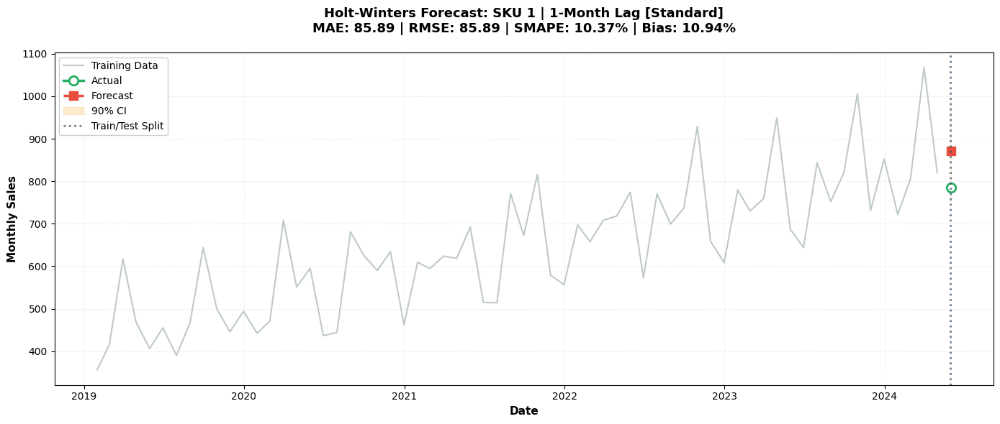

  🔹 SKU 2... ✅ MAE: 45.02 | RMSE: 45.02 | SMAPE: 5.36 | [Standard]


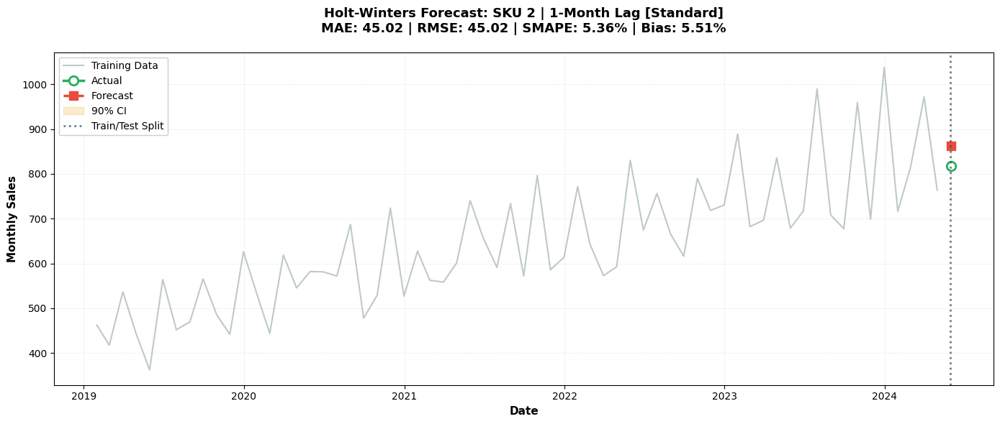

  🔹 SKU 3... ✅ MAE: 62.50 | RMSE: 62.50 | SMAPE: 9.82 | [Standard]


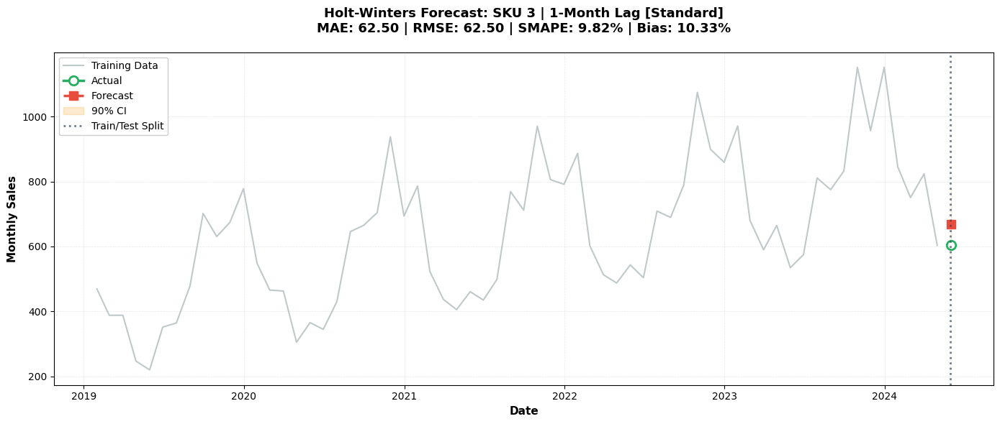

  🔹 SKU 4... ✅ MAE: 76.67 | RMSE: 76.67 | SMAPE: 8.18 | [Standard]


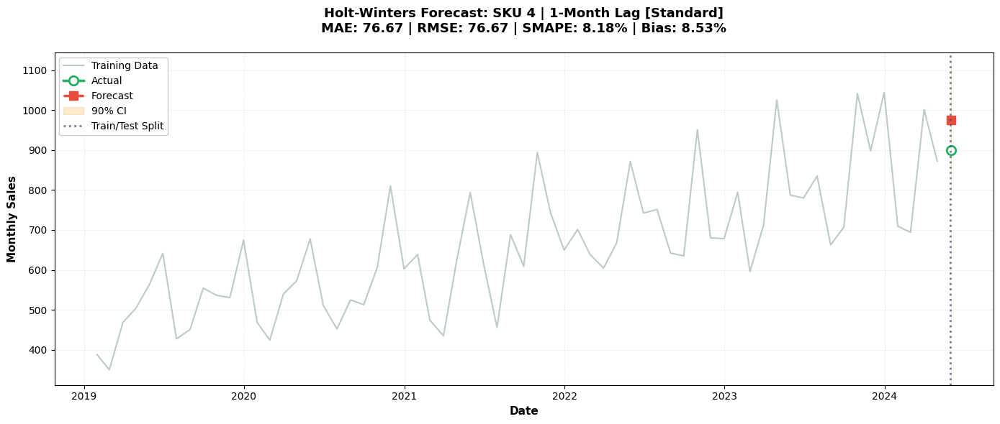

  🔹 SKU 5... ✅ MAE: 104.14 | RMSE: 104.14 | SMAPE: 12.37 | [Standard]


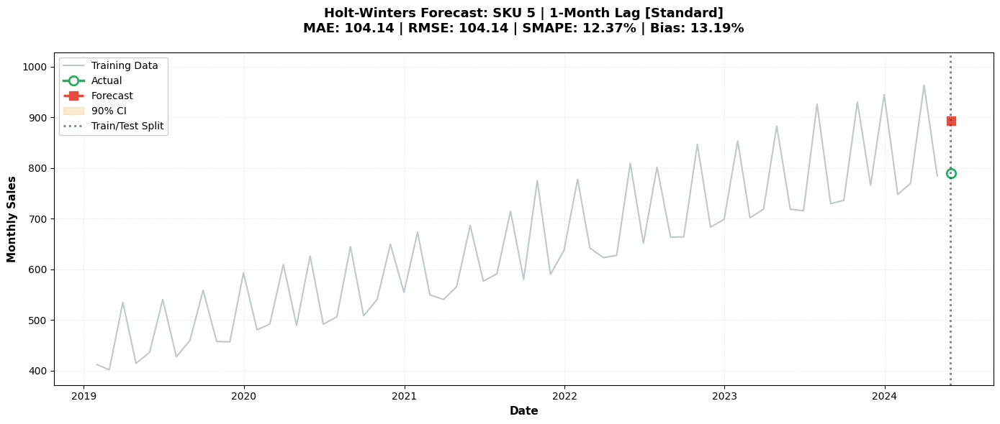

  🔹 SKU 6... ✅ MAE: 0.00 | RMSE: 0.00 | SMAPE: nan | [Damped]


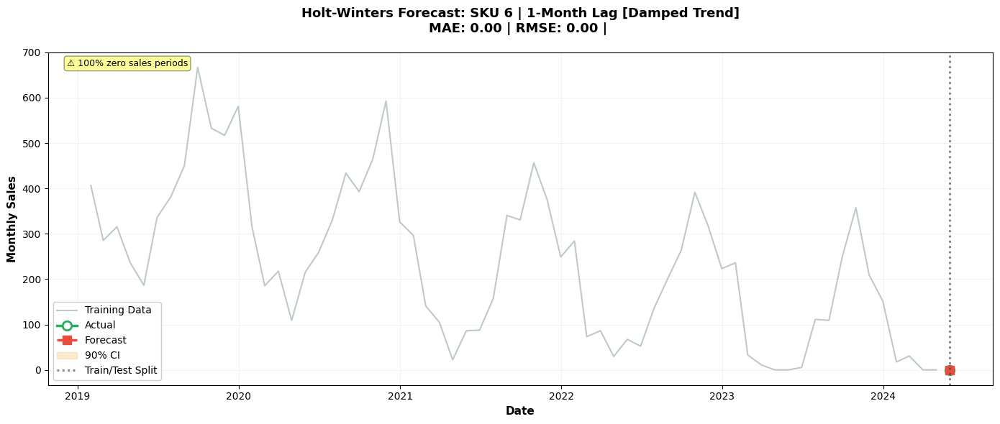

  🔹 SKU 7... ✅ MAE: 0.00 | RMSE: 0.00 | SMAPE: nan | [Damped]


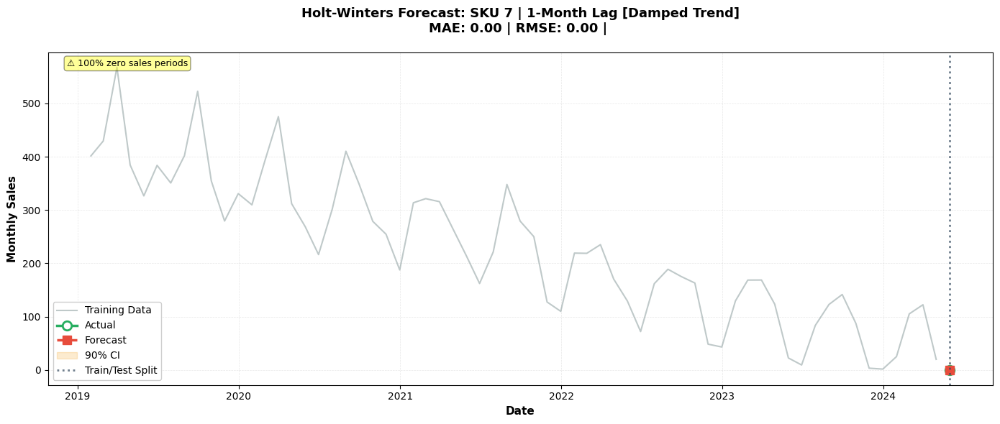

  🔹 SKU 8... ✅ MAE: 134.77 | RMSE: 134.77 | SMAPE: 16.05 | [Standard]


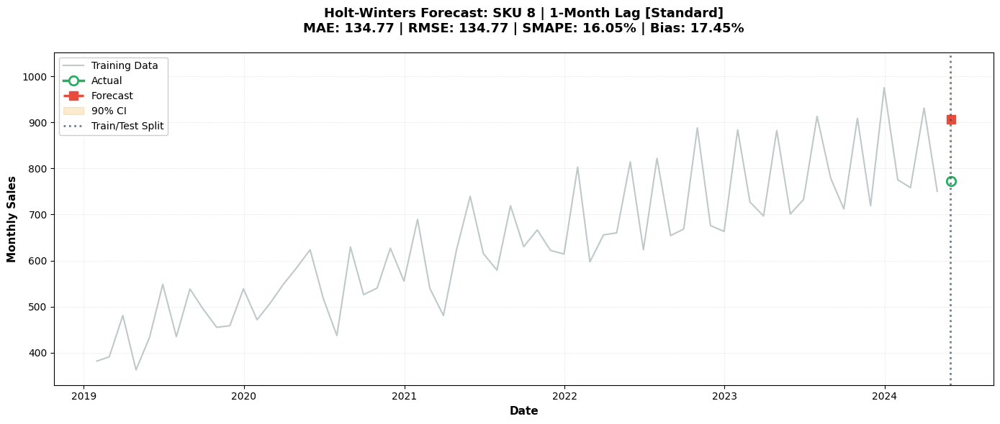

  🔹 SKU 9... ✅ MAE: 112.13 | RMSE: 112.13 | SMAPE: 13.68 | [Standard]


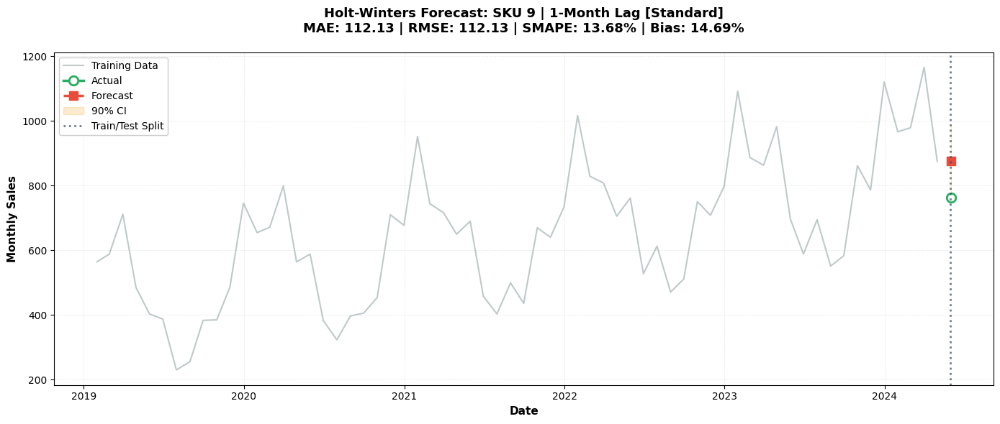

  🔹 SKU 10... ✅ MAE: 8.21 | RMSE: 8.21 | SMAPE: 7.85 | [Standard]


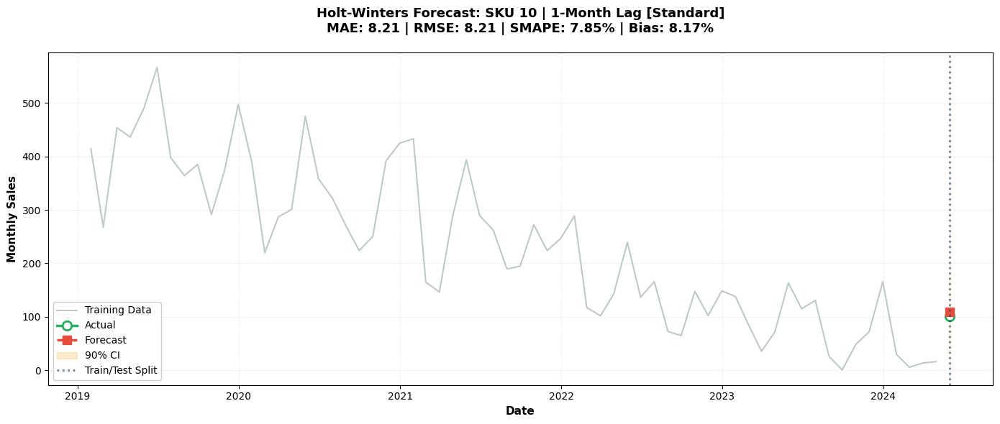


🔍 EVALUATING LAG PERIOD: 3 MONTHS
📚 Training ends: 2024-03
🎯 Forecasting: 2024-04 to 2024-06 (3 months)

  🔹 SKU 1... ✅ MAE: 112.25 | RMSE: 123.87 | SMAPE: 12.35 | [Standard]


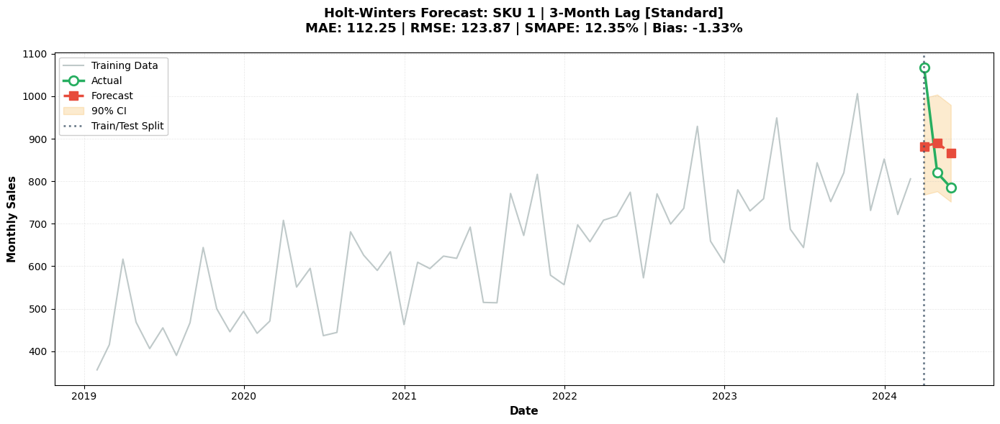

  🔹 SKU 2... ✅ MAE: 85.10 | RMSE: 99.18 | SMAPE: 9.90 | [Standard]


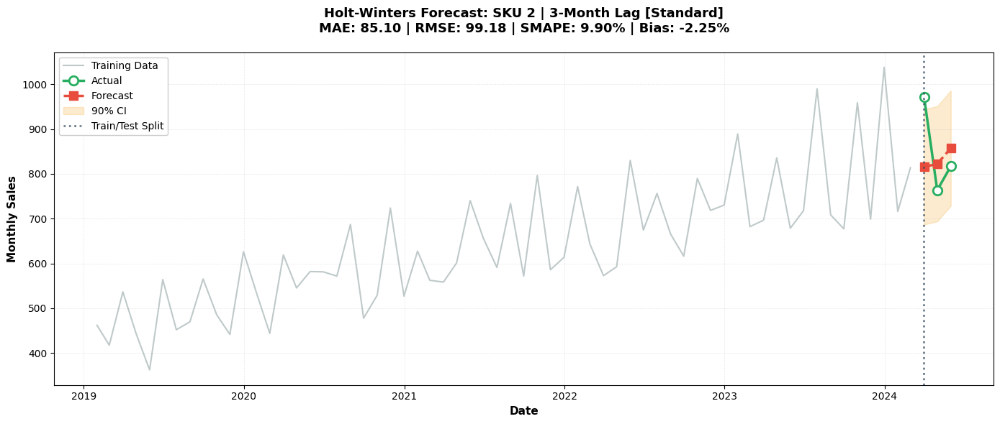

  🔹 SKU 3... ✅ MAE: 74.73 | RMSE: 77.72 | SMAPE: 10.81 | [Standard]


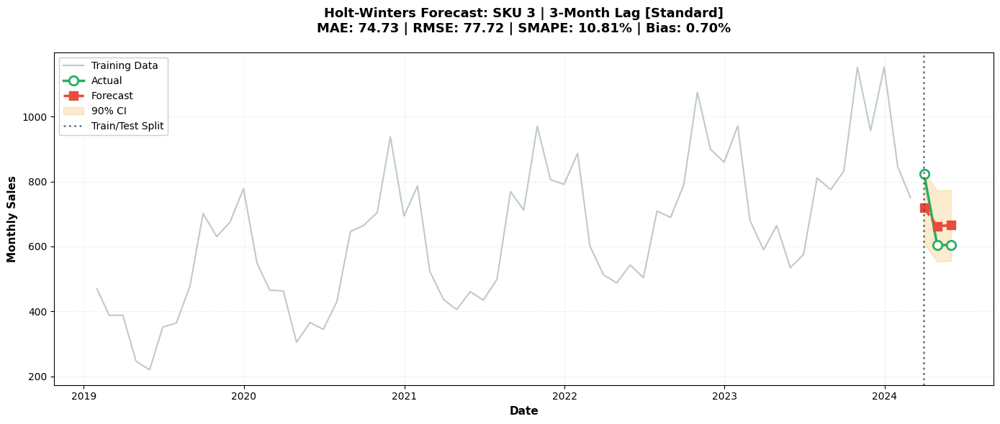

  🔹 SKU 4... ✅ MAE: 107.40 | RMSE: 135.25 | SMAPE: 11.95 | [Standard]


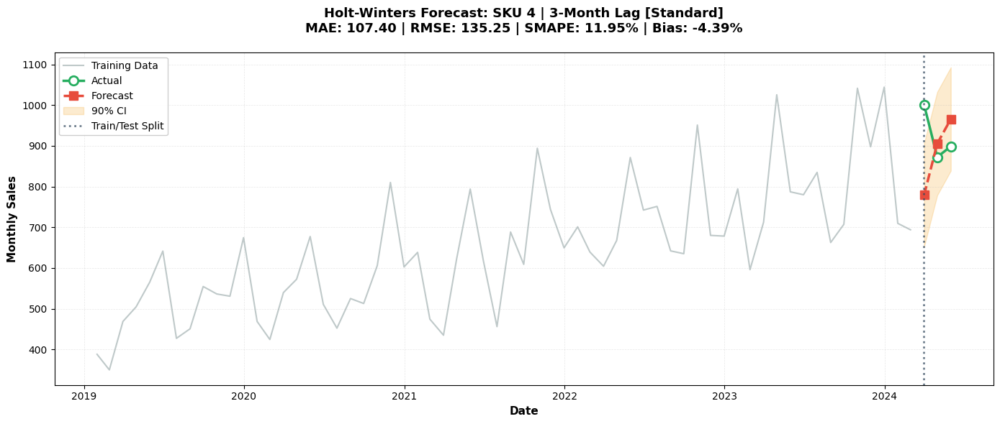

  🔹 SKU 5... ✅ MAE: 89.89 | RMSE: 95.49 | SMAPE: 10.45 | [Standard]


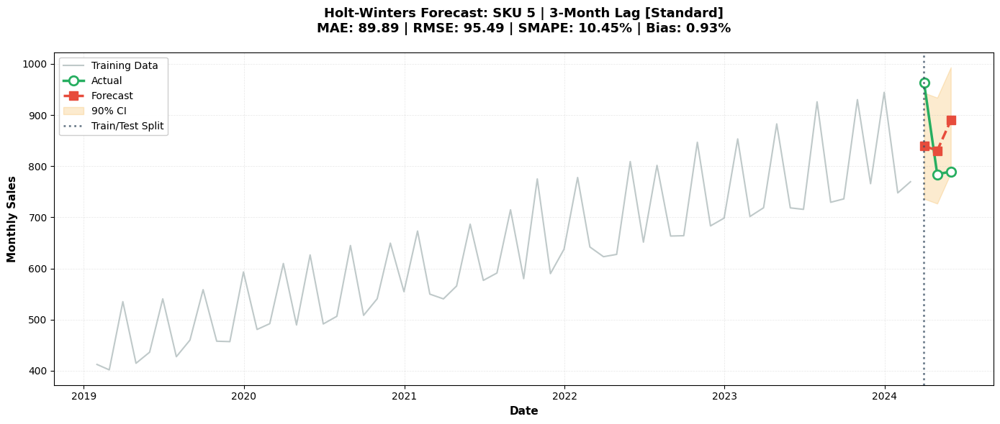

  🔹 SKU 6... ✅ MAE: 0.00 | RMSE: 0.00 | SMAPE: nan | [Damped]


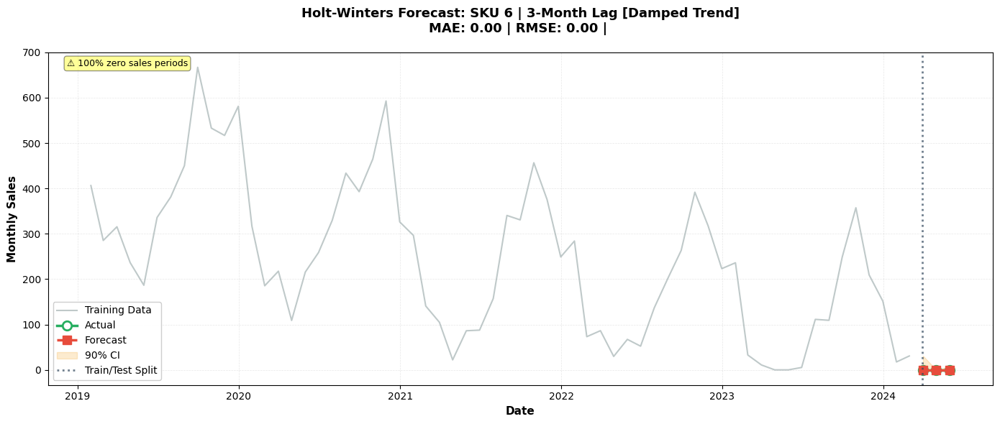

  🔹 SKU 7... ✅ MAE: 8.14 | RMSE: 9.99 | SMAPE: 29.19 | [Damped]


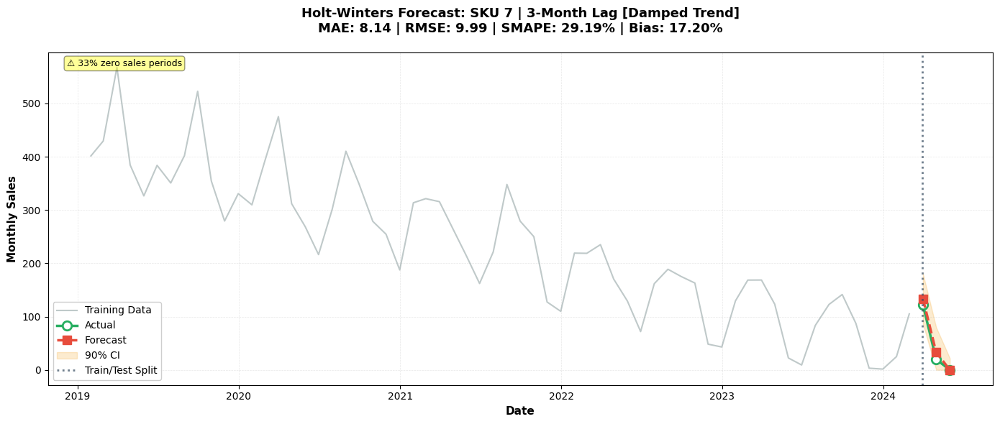

  🔹 SKU 8... ✅ MAE: 121.92 | RMSE: 122.28 | SMAPE: 14.52 | [Standard]


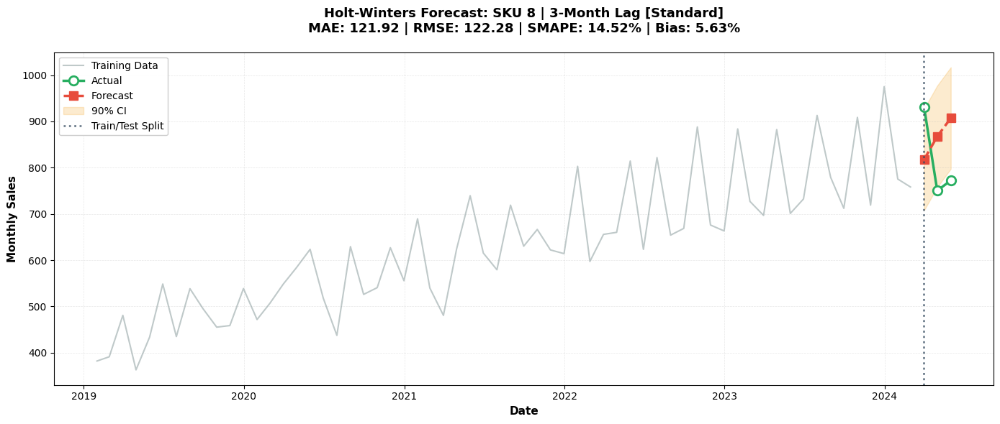

  🔹 SKU 9... ✅ MAE: 98.53 | RMSE: 106.72 | SMAPE: 10.41 | [Standard]


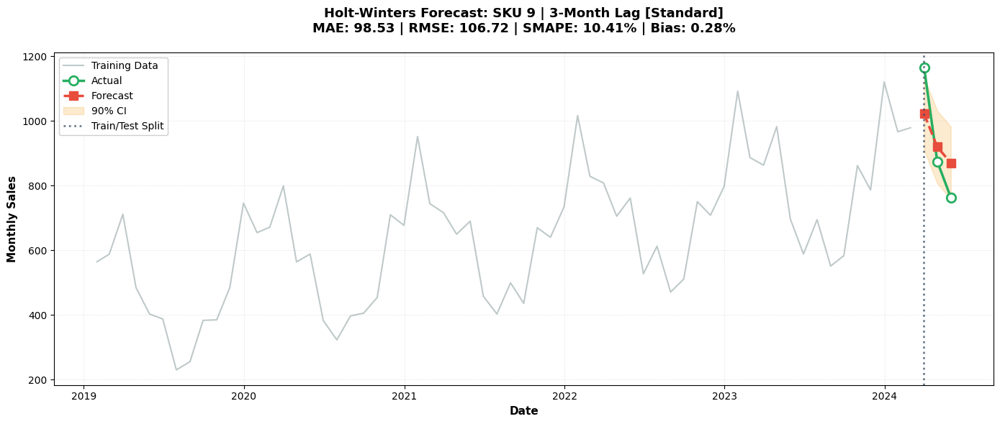

  🔹 SKU 10... ✅ MAE: 11.11 | RMSE: 12.05 | SMAPE: 130.07 | [Standard]


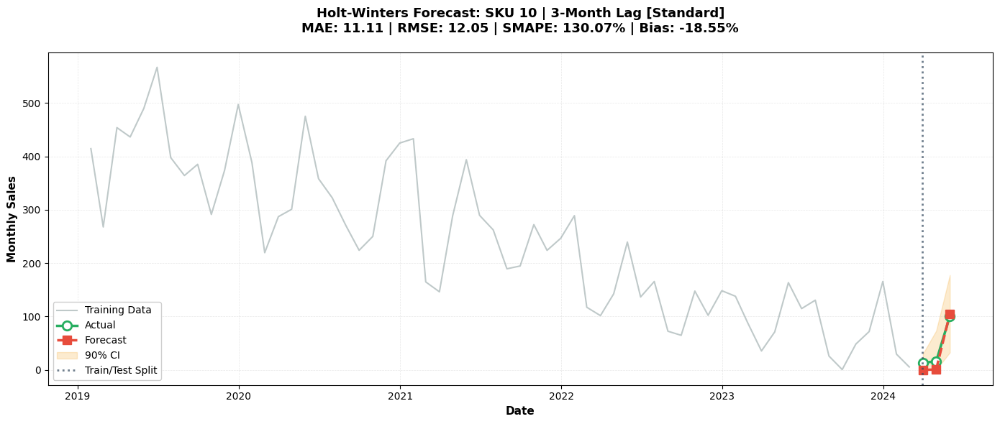


🔍 EVALUATING LAG PERIOD: 6 MONTHS
📚 Training ends: 2023-12
🎯 Forecasting: 2024-01 to 2024-06 (6 months)

  🔹 SKU 1... ✅ MAE: 124.65 | RMSE: 152.31 | SMAPE: 14.45 | [Standard]


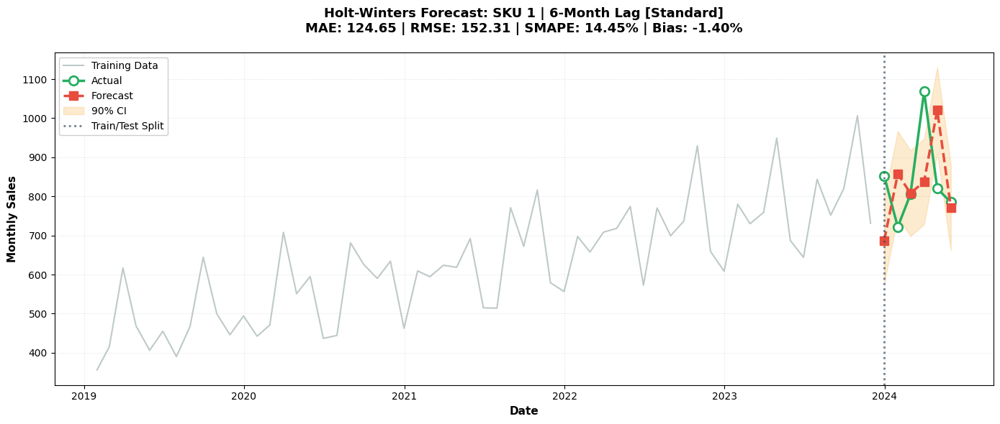

  🔹 SKU 2... ✅ MAE: 114.98 | RMSE: 136.43 | SMAPE: 13.41 | [Standard]


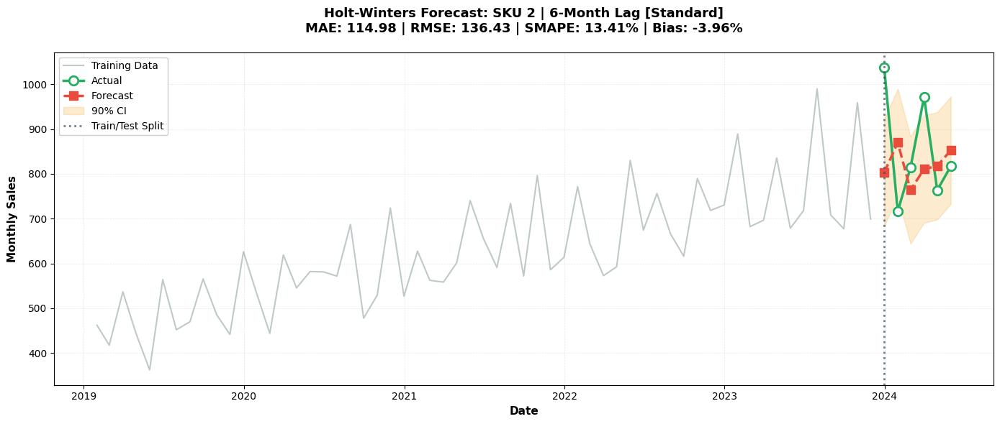

  🔹 SKU 3... ✅ MAE: 91.02 | RMSE: 103.36 | SMAPE: 10.93 | [Standard]


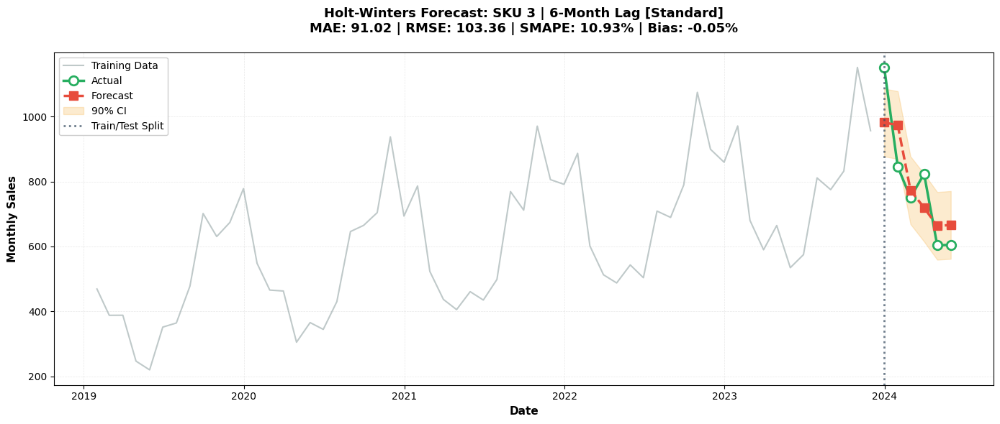

  🔹 SKU 4... ✅ MAE: 111.46 | RMSE: 135.96 | SMAPE: 12.74 | [Standard]


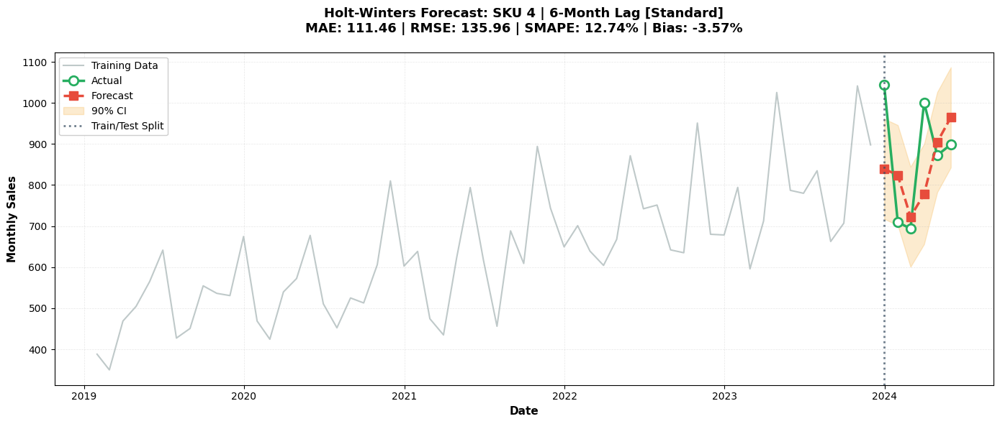

  🔹 SKU 5... ✅ MAE: 92.11 | RMSE: 100.50 | SMAPE: 10.84 | [Standard]


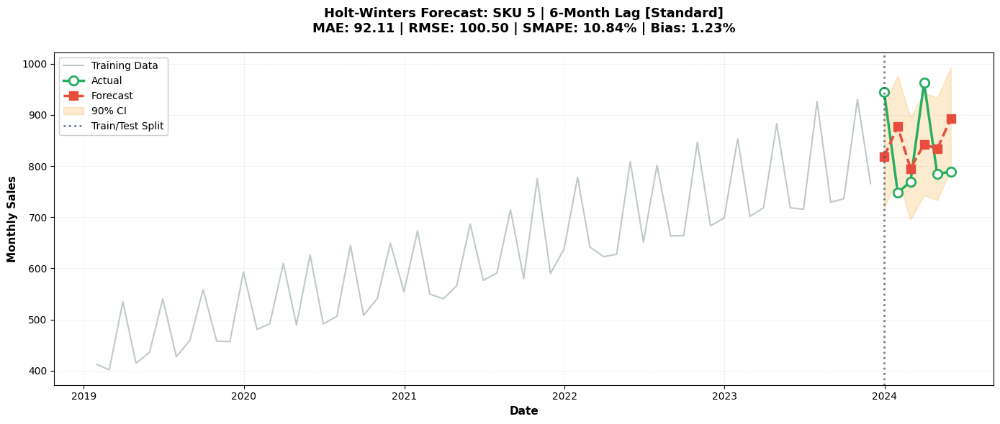

  🔹 SKU 6... ✅ MAE: 25.97 | RMSE: 41.78 | SMAPE: 121.60 | [Damped]


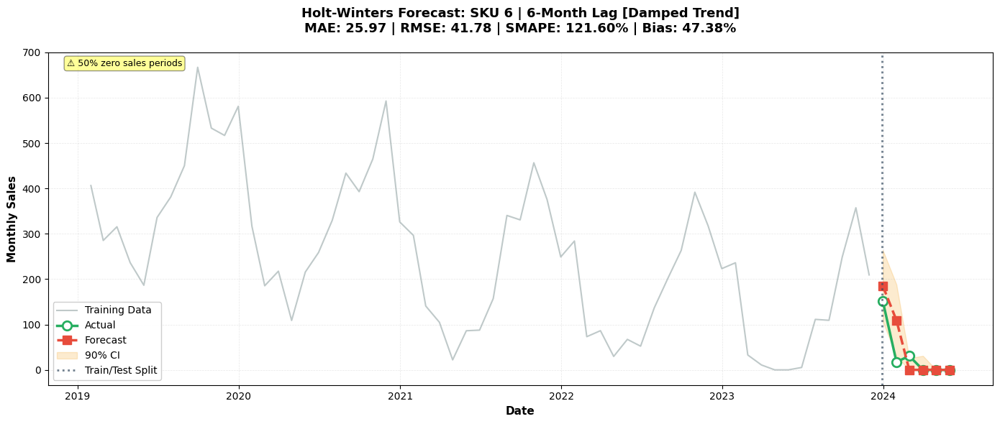

  🔹 SKU 7... ✅ MAE: 11.89 | RMSE: 15.40 | SMAPE: 69.44 | [Damped]


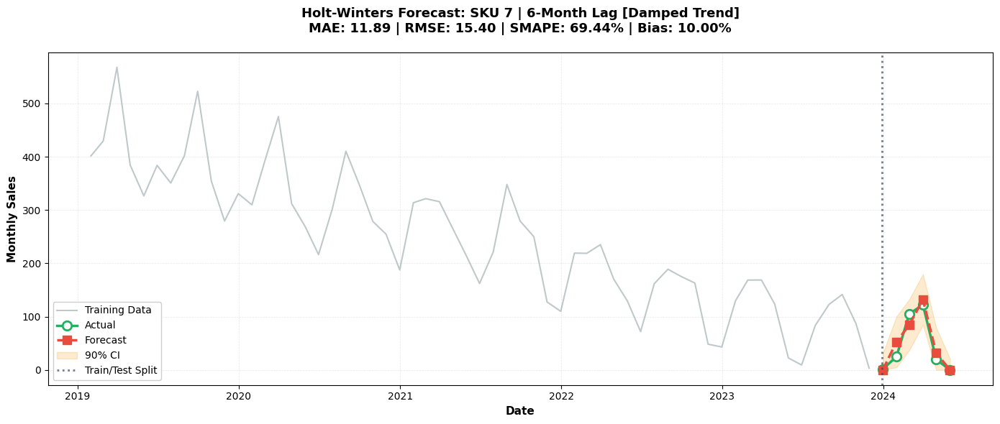

  🔹 SKU 8... ✅ MAE: 116.66 | RMSE: 123.60 | SMAPE: 13.78 | [Standard]


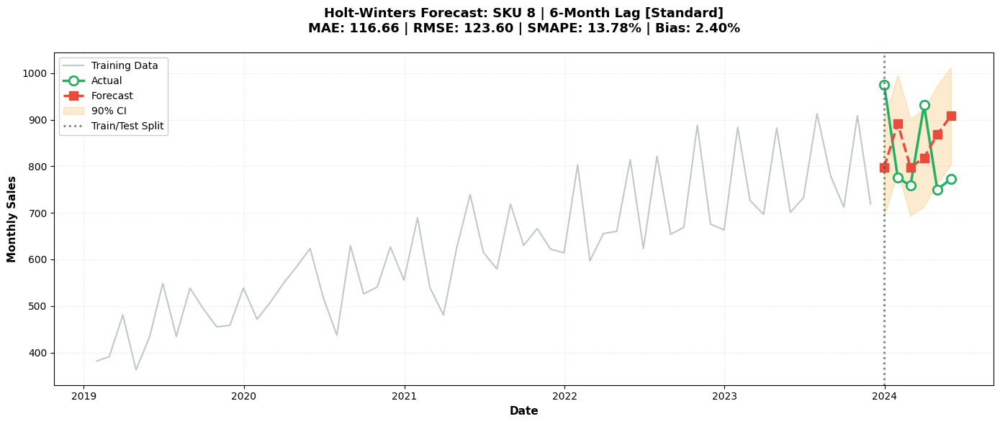

  🔹 SKU 9... ✅ MAE: 105.82 | RMSE: 126.28 | SMAPE: 10.70 | [Standard]


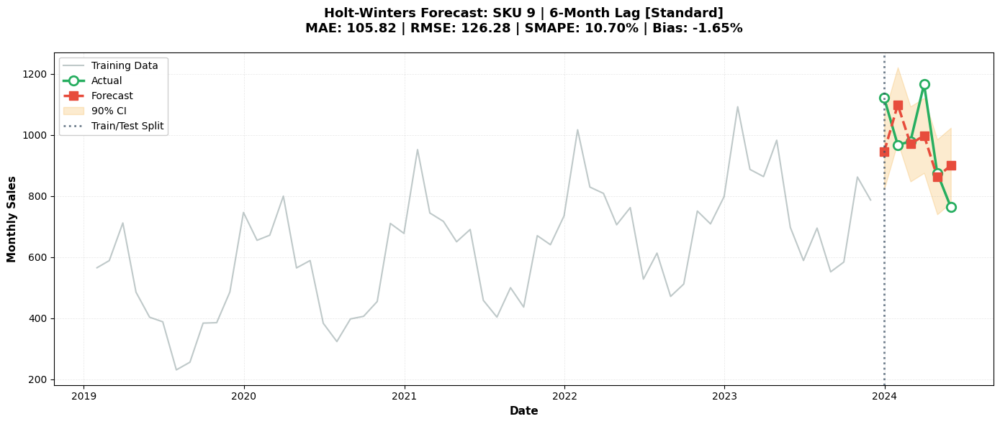

  🔹 SKU 10... ✅ MAE: 22.18 | RMSE: 29.56 | SMAPE: 121.07 | [Standard]


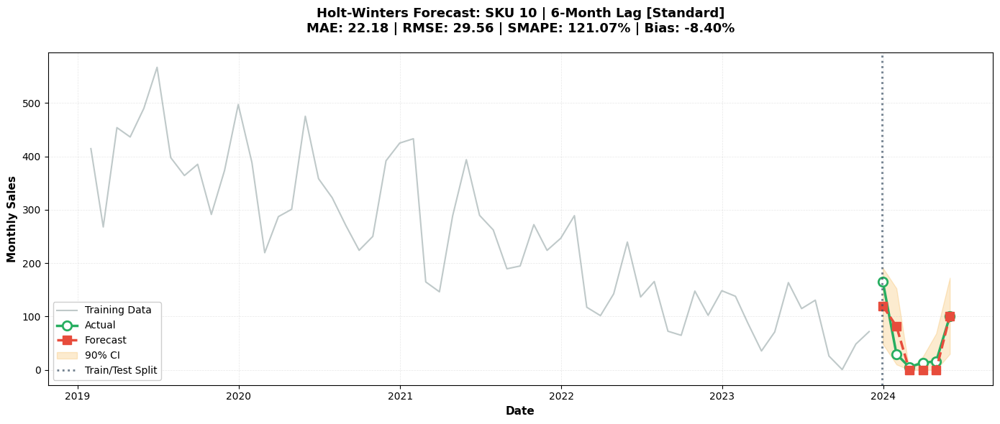


🔍 EVALUATING LAG PERIOD: 12 MONTHS
📚 Training ends: 2023-06
🎯 Forecasting: 2023-07 to 2024-06 (12 months)

  🔹 SKU 1... ✅ MAE: 90.97 | RMSE: 101.21 | SMAPE: 10.82 | [Standard]


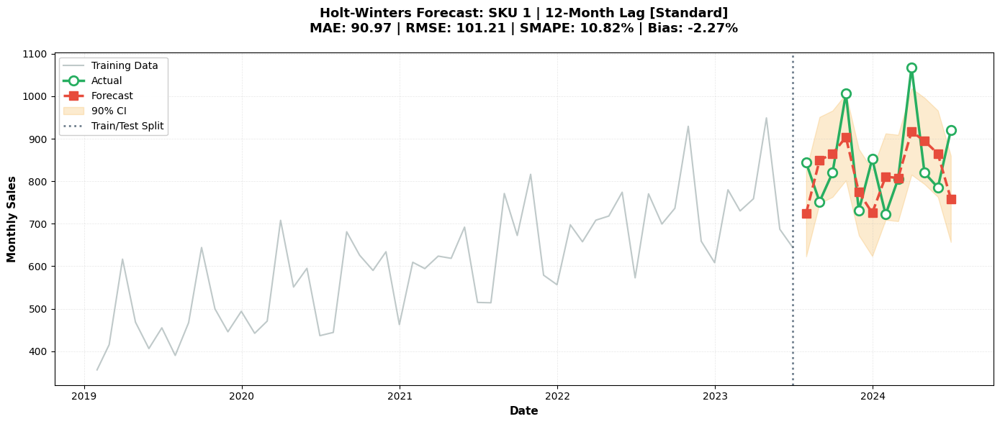

  🔹 SKU 2... ✅ MAE: 114.62 | RMSE: 132.33 | SMAPE: 13.63 | [Standard]


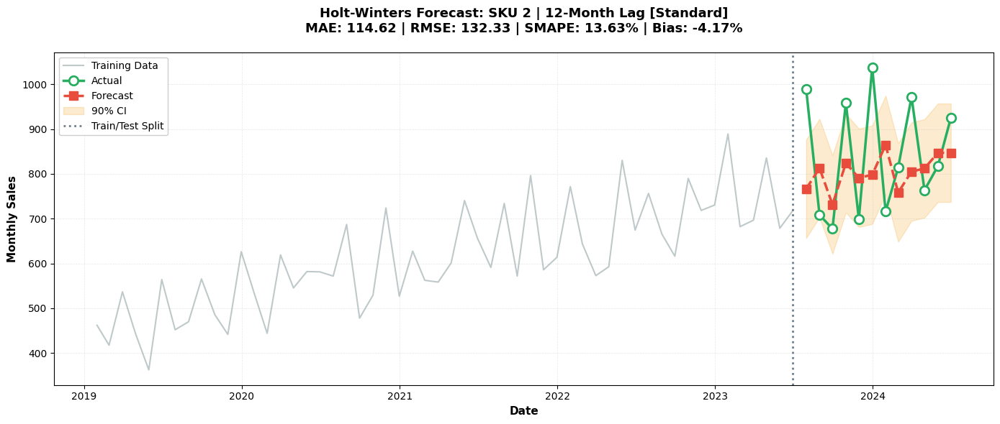

  🔹 SKU 3... ✅ MAE: 93.37 | RMSE: 100.33 | SMAPE: 11.07 | [Standard]


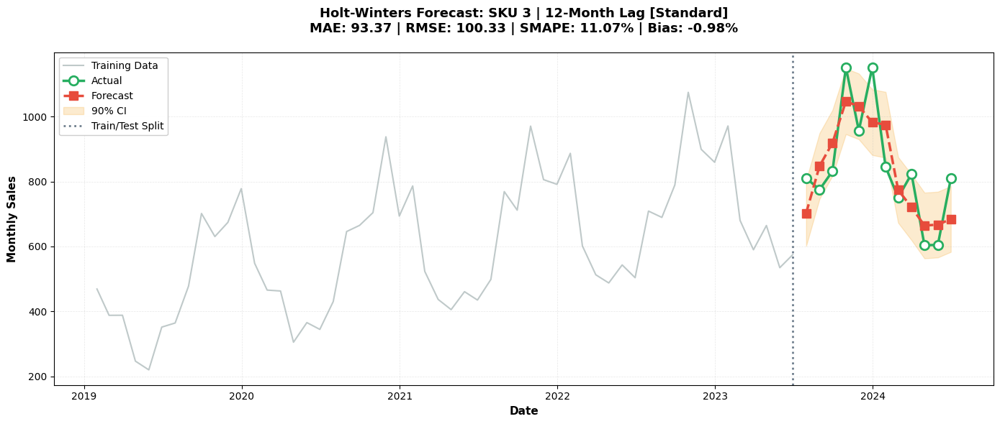

  🔹 SKU 4... ✅ MAE: 96.94 | RMSE: 116.71 | SMAPE: 11.39 | [Standard]


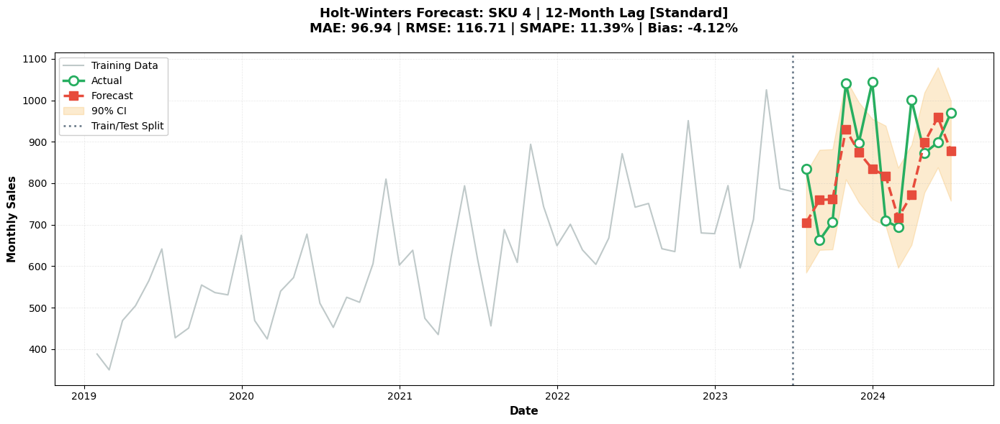

  🔹 SKU 5... ✅ MAE: 91.35 | RMSE: 104.00 | SMAPE: 10.74 | [Standard]


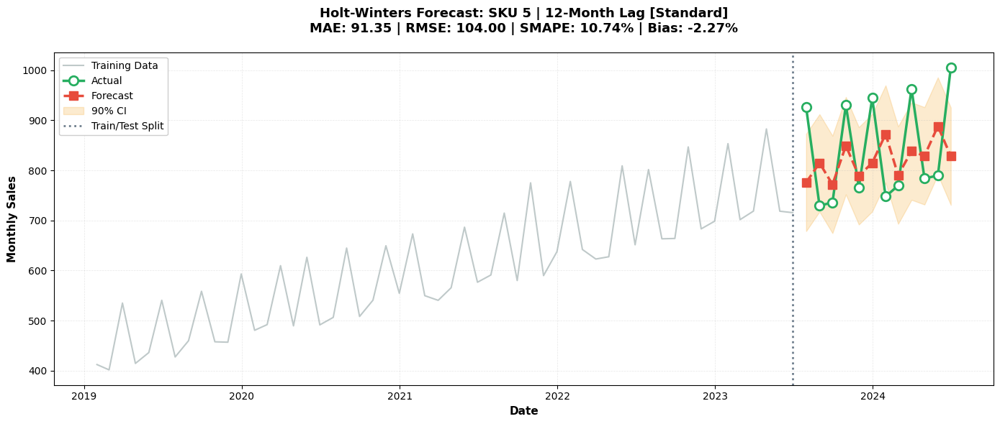

  🔹 SKU 6... ✅ MAE: 37.47 | RMSE: 53.94 | SMAPE: 63.70 | [Damped]


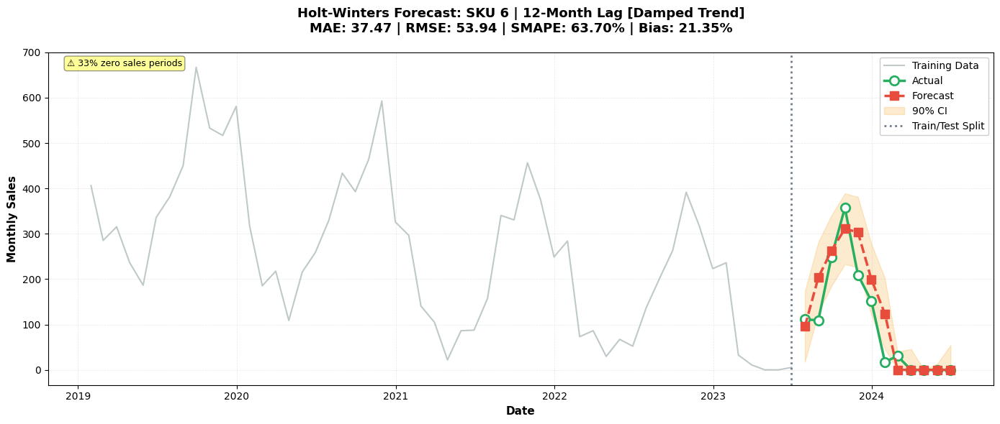

  🔹 SKU 7... ✅ MAE: 10.72 | RMSE: 14.34 | SMAPE: 59.77 | [Damped]


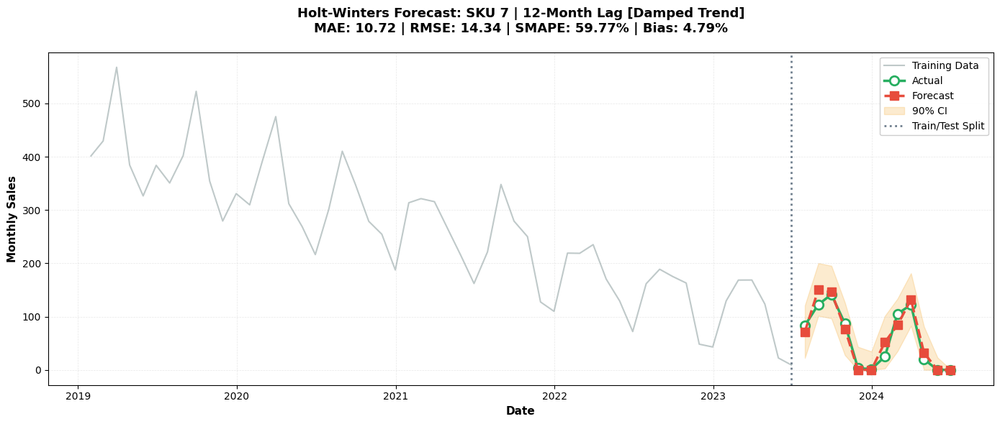

  🔹 SKU 8... ✅ MAE: 108.51 | RMSE: 116.75 | SMAPE: 12.84 | [Standard]


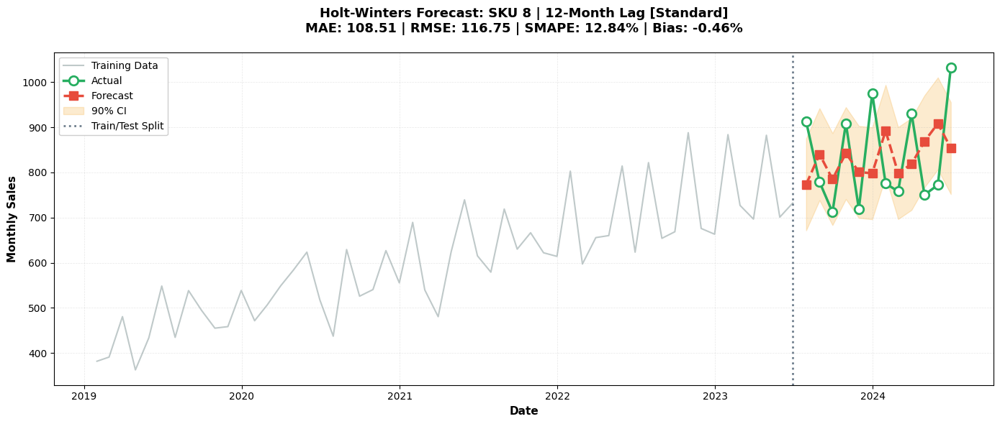

  🔹 SKU 9... ✅ MAE: 91.09 | RMSE: 103.72 | SMAPE: 10.84 | [Standard]


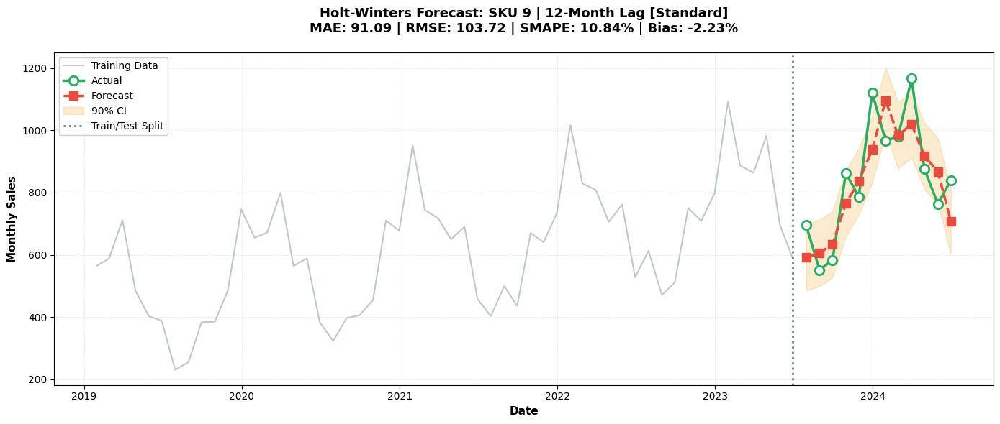

  🔹 SKU 10... ✅ MAE: 25.29 | RMSE: 32.40 | SMAPE: 98.31 | [Standard]


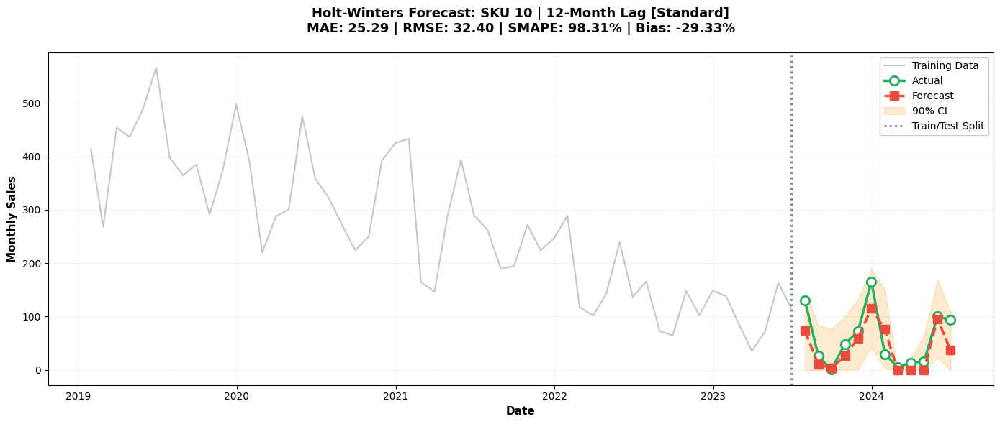


📊 CONSOLIDATING RESULTS
✅ Saved: hw_detailed_forecasts.csv
✅ Saved: hw_kpi_summary.csv

📈 SUMMARY:
   Total forecasts: 40
   SKUs evaluated: 10
   Lag periods: [1, 3, 6, 12]

📊 AVERAGE PERFORMANCE BY LAG:
              MAE   RMSE  SMAPE  Bias_%
Lag_Period                             
1           62.93  62.93  10.46   11.10
3           70.91  78.26  26.63   -0.20
6           81.67  96.52  39.90    4.20
12          76.03  87.57  30.31   -1.97

🏆 TOP 5 BEST FORECASTS (by SMAPE):
 SKU_ID  Lag_Period  SMAPE    MAE   RMSE
      2           1  5.361 45.022 45.022
     10           1  7.849  8.208  8.208
      4           1  8.181 76.667 76.667
      3           1  9.822 62.501 62.501
      2           3  9.902 85.103 99.182

⚠️  TOP 5 WORST FORECASTS (by SMAPE):
 SKU_ID  Lag_Period   SMAPE    MAE   RMSE
     10           3 130.068 11.114 12.049
      6           6 121.596 25.972 41.781
     10           6 121.068 22.175 29.559
     10          12  98.309 25.294 32.397
      7           6  69

In [ ]:
hw_detailed, hw_kpi_summary = evaluate_holt_winters_lags(
    data_monthly=data_monthly,
    lag_periods=[1, 3, 6, 12],
    decline_skus=[6, 7], 
    plot_forecasts=True,
    save_results=True
)

In [168]:
hw_kpi_summary

,SKU_ID,Lag_Period,Model,Damped,Train_Months,Test_Months,Train_End,Forecast_Start,Forecast_End,Total_Periods,Zero_Sales_Count,Zero_Sales_%,Mean_Actual,Mean_Forecast,MAE,RMSE,Bias_%,Service_Level_%,SMAPE,Tracking_Signal
0,1,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,785.16,871.04,85.888,85.888,10.939,100.00,10.372,1.000
1,2,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,817.35,862.37,45.022,45.022,5.508,100.00,5.361,1.000
2,3,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,605.12,667.62,62.501,62.501,10.329,100.00,9.822,1.000
3,4,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,898.77,975.44,76.667,76.667,8.530,100.00,8.181,1.000
4,5,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,789.54,893.68,104.143,104.143,13.190,100.00,12.374,1.000
5,6,1,Holt-Winters,True,64,1,2024-05,2024-05,2024-05,1,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
6,7,1,Holt-Winters,True,64,1,2024-05,2024-05,2024-05,1,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
7,8,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,772.33,907.10,134.773,134.773,17.450,100.00,16.050,1.000
8,9,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,763.40,875.53,112.127,112.127,14.688,100.00,13.683,1.000
9,10,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,0,0.00,100.47,108.68,8.208,8.208,8.170,100.00,7.849,1.000


In [ ]:
def evaluate_arima_lags(
    data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
):
    """
    Evaluate ARIMA model across multiple SKUs and lag periods.
    
    Parameters:
    -----------
    data_monthly : pd.DataFrame
        Must have columns: SKU_ID, Date, Monthly_Sales
    lag_periods : list
        Lag periods to evaluate (months)
    plot_forecasts : bool
        Whether to create plots
    save_results : bool
        Whether to save CSV files
    
    Returns:
    --------
    tuple: (detailed_forecasts_df, kpi_summary_df)
    """
    
    all_detailed_results = []
    all_kpi_summaries = []
    
    # Get max date
    max_date = data_monthly['Date'].max()
    print(f"Maximum Date in Dataset: {max_date.strftime('%Y-%m')}")
    print(f"Total SKUs: {data_monthly['SKU_ID'].nunique()}")
    print(f"Lag Periods: {lag_periods}")
    print("=" * 80)
    
    for lag in lag_periods:
        print(f"\n{'='*80}")
        print(f"EVALUATING LAG PERIOD: {lag} MONTHS")
        print(f"{'='*80}")
        
        # Calculate cutoff dates
        train_end_date = max_date - pd.DateOffset(months=lag)
        forecast_start = train_end_date + pd.DateOffset(months=1)
        
        print(f" Training ends: {train_end_date.strftime('%Y-%m')}")
        print(f"Forecasting: {forecast_start.strftime('%Y-%m')} to {max_date.strftime('%Y-%m')} ({lag} months)")
        print()
        
        for sku in sorted(data_monthly['SKU_ID'].unique()):
            print(f"  🔹 SKU {sku}...", end=" ")
            
            # Filter data for this SKU
            sku_data = data_monthly[data_monthly['SKU_ID'] == sku].copy()
            sku_data = sku_data.sort_values('Date')
            
            # Split train/test
            train_data = sku_data[sku_data['Date'] <= train_end_date]
            test_data = sku_data[sku_data['Date'] > train_end_date]
            
            # Take exactly 'lag' months for test
            test_data = test_data.head(lag)
            
            # Validation
            if len(train_data) < 24:
                print(f"Need 24+ months, have {len(train_data)}")
                continue
            
            if len(test_data) != lag:
                print(f"Expected {lag} test months, have {len(test_data)}")
                continue
            
            # Prepare time series
            train_series = train_data.set_index('Date')['Monthly_Sales']
            test_series = test_data.set_index('Date')['Monthly_Sales']
            
            try:
                # Fit auto ARIMA
                model = auto_arima(
                    train_series,
                    start_p=0, start_q=0,
                    max_p=3, max_q=3,
                    d=1,
                    seasonal=True, m=12,
                    trace=False,
                    error_action='ignore',
                    suppress_warnings=True,
                    stepwise=True
                )
                
                # Forecast exactly 'lag' months with 90% CI
                forecast, conf_int = model.predict(
                    n_periods=lag, 
                    return_conf_int=True, 
                    alpha=0.10  # 90% confidence interval
                )
                
                # Ensure non-negative
                forecast = np.maximum(forecast, 0)
                ci_lower = np.maximum(conf_int[:, 0], 0)
                ci_upper = np.maximum(conf_int[:, 1], 0)
                
                # ============ CALCULATE KPIs ============
                kpis = calculate_forecast_kpis(
                    actual=test_series.values,
                    predicted=forecast
                )
                
                # Store detailed results (month-by-month)
                detailed_df = pd.DataFrame({
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'ARIMA',
                    'Date': test_series.index,
                    'Actual': test_series.values,
                    'Forecast': forecast,
                    'CI_Lower': ci_lower,
                    'CI_Upper': ci_upper,
                    'Error': test_series.values - forecast,
                    'Abs_Error': np.abs(test_series.values - forecast)
                })
                all_detailed_results.append(detailed_df)
                
                # Store KPI summary (one row per SKU-Lag combination)
                kpi_summary = {
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'ARIMA',
                    'ARIMA_Order': str(model.order),
                    'Seasonal_Order': str(model.seasonal_order),
                    'Train_Months': len(train_series),
                    'Test_Months': len(test_series),
                    'Train_End': train_end_date.strftime('%Y-%m'),
                    'Forecast_Start': test_series.index.min().strftime('%Y-%m'),
                    'Forecast_End': test_series.index.max().strftime('%Y-%m'),
                    **kpis  # Unpack all KPI metrics
                }
                all_kpi_summaries.append(kpi_summary)
                
                # Print summary
                print(f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | " +
                      f"SMAPE: {kpis['SMAPE']:.2f} | Order: {model.order}")
                
                # Plot if requested
                if plot_forecasts:
                    plot_arima_forecast(
                        train_series, test_series, forecast,
                        ci_lower, ci_upper, sku, lag, kpis,
                        model.order, train_end_date
                    )
                
            except Exception as e:
                print(f"Error: {str(e)}")
                continue
    
    # ============ CONSOLIDATE RESULTS ============
    print(f"\n{'='*80}")
    print("CONSOLIDATING RESULTS")
    print(f"{'='*80}")
    
    if len(all_detailed_results) == 0:
        print("No successful forecasts!")
        return pd.DataFrame(), pd.DataFrame()
    
    # Create DataFrames
    detailed_df = pd.concat(all_detailed_results, ignore_index=True)
    kpi_summary_df = pd.DataFrame(all_kpi_summaries)
    
    # Save to CSV
    if save_results:
        detailed_df.to_csv('arima_detailed_forecasts.csv', index=False)
        kpi_summary_df.to_csv('arima_kpi_summary.csv', index=False)
        print(f"Saved: arima_detailed_forecasts.csv")
        print(f"Saved: arima_kpi_summary.csv")
    
    # Print summary
    print(f"\n SUMMARY:")
    print(f"   Total forecasts: {len(all_detailed_results)}")
    print(f"   SKUs evaluated: {kpi_summary_df['SKU_ID'].nunique()}")
    print(f"   Lag periods: {sorted(kpi_summary_df['Lag_Period'].unique())}")
    
    # Average performance by lag
    print(f"\n AVERAGE PERFORMANCE BY LAG:")
    avg_by_lag = kpi_summary_df.groupby('Lag_Period')[['MAE', 'RMSE', 'SMAPE', 'Bias_%']].mean()
    print(avg_by_lag.round(2).to_string())
    
    # Best and worst performers
    print(f"\nTOP 5 BEST FORECASTS (by SMAPE):")
    best = kpi_summary_df.nsmallest(5, 'SMAPE')[['SKU_ID', 'Lag_Period', 'SMAPE', 'MAE', 'RMSE']]
    print(best.to_string(index=False))
    
    print(f"\n TOP 5 WORST FORECASTS (by SMAPE):")
    worst = kpi_summary_df.nlargest(5, 'SMAPE')[['SKU_ID', 'Lag_Period', 'SMAPE', 'MAE', 'RMSE']]
    print(worst.to_string(index=False))
    
    return detailed_df, kpi_summary_df


def plot_arima_forecast(train_series, test_series, forecast, ci_lower, ci_upper,
                        sku, lag, kpis, arima_order, train_end_date):
    """
    Create visualization for ARIMA forecast.
    """
    fig, ax = plt.subplots(figsize=(14, 6))
    
    # Plot training data
    ax.plot(train_series.index, train_series.values,
            label='Training Data', color='#95a5a6', linewidth=1.5, alpha=0.6)
    
    # Plot actual test data
    ax.plot(test_series.index, test_series.values,
            label='Actual', color='#27ae60', linewidth=2.5,
            marker='o', markersize=9, markerfacecolor='white', markeredgewidth=2)
    
    # Plot forecast
    ax.plot(test_series.index, forecast,
            label='Forecast', color='#e74c3c', linewidth=2.5,
            linestyle='--', marker='s', markersize=8)
    
    # Plot confidence interval
    ax.fill_between(test_series.index, ci_lower, ci_upper,
                    color='#f39c12', alpha=0.2, label='90% CI')
    
    # Vertical line at split
    ax.axvline(train_end_date, color='#34495e', linestyle=':',
               linewidth=2, alpha=0.7, label='Train/Test Split')
    
    # Title with KPIs
    title = f"ARIMA Forecast: SKU {sku} | {lag}-Month Lag | Order: {arima_order}\n"
    title += f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | "
    
    smape = kpis['SMAPE']
    if not np.isnan(smape):
        title += f"SMAPE: {smape:.2f}% | "
    
    bias = kpis['Bias_%']
    if not np.isnan(bias):
        title += f"Bias: {bias:.2f}%"
    
    ax.set_title(title, fontsize=13, fontweight='bold', pad=20)
    ax.set_xlabel('Date', fontsize=11, fontweight='bold')
    ax.set_ylabel('Monthly Sales', fontsize=11, fontweight='bold')
    ax.legend(loc='best', framealpha=0.95, fontsize=10)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    
    # Warning for high zero sales
    if kpis['Zero_Sales_%'] > 20:
        warning_text = f" {kpis['Zero_Sales_%']:.0f}% zero sales periods"
        ax.text(0.02, 0.98, warning_text, transform=ax.transAxes,
                fontsize=9, verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.4))
    
    plt.tight_layout()
    plt.show()


'\n# Run ARIMA evaluation\narima_detailed, arima_kpi_summary = evaluate_arima_lags(\n    data_monthly=data_monthly,\n    lag_periods=[1, 3, 6, 12],\n    plot_forecasts=True,\n    save_results=True\n)\n\n# View results\nprint(arima_kpi_summary.head(20))\n\n# Compare with Holt-Winters\n# Combine both model results\nall_models_kpi = pd.concat([hw_kpi_summary, arima_kpi_summary], ignore_index=True)\nall_models_kpi.to_csv(\'all_models_kpi_summary.csv\', index=False)\nprint("✅ Combined KPI summary saved!")\n'

📅 Maximum Date in Dataset: 2024-06
📊 Total SKUs: 10
🔄 Lag Periods: [1, 3, 6, 12]

🔍 EVALUATING LAG PERIOD: 1 MONTHS
📚 Training ends: 2024-05
🎯 Forecasting: 2024-06 to 2024-06 (1 months)

  🔹 SKU 1... ✅ MAE: 71.87 | RMSE: 71.87 | SMAPE: 8.75 | Order: (2, 1, 1)


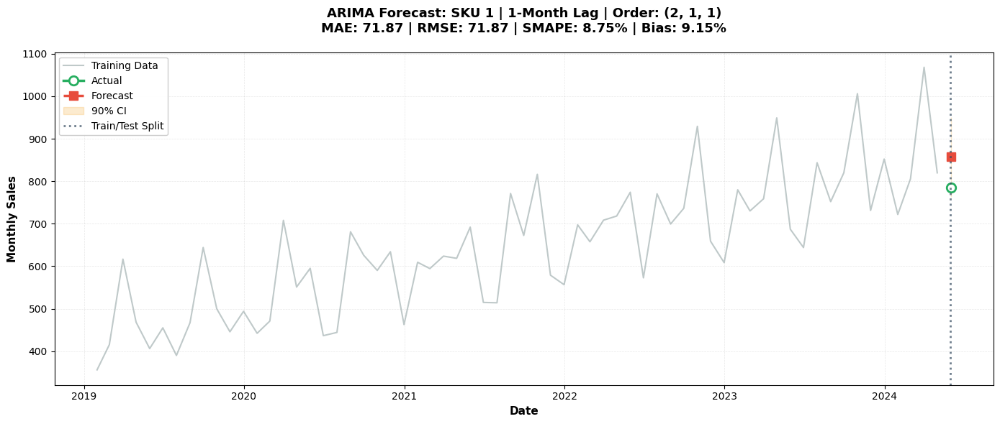

  🔹 SKU 2... ✅ MAE: 19.29 | RMSE: 19.29 | SMAPE: 2.33 | Order: (3, 1, 0)


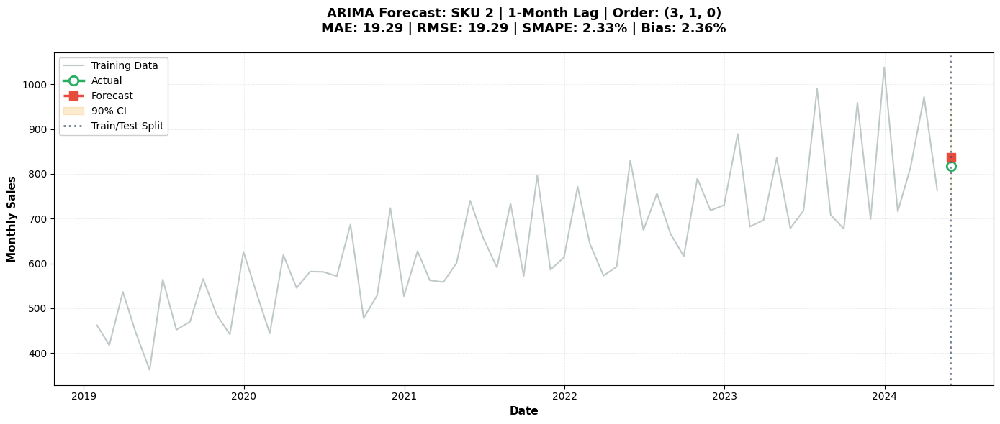

  🔹 SKU 3... ✅ MAE: 47.45 | RMSE: 47.45 | SMAPE: 7.55 | Order: (2, 1, 1)


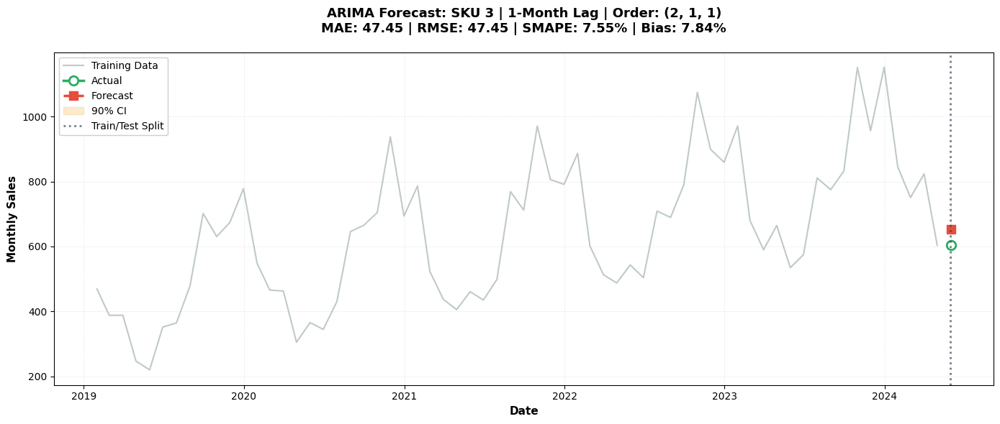

  🔹 SKU 4... ✅ MAE: 3.58 | RMSE: 3.58 | SMAPE: 0.40 | Order: (0, 1, 3)


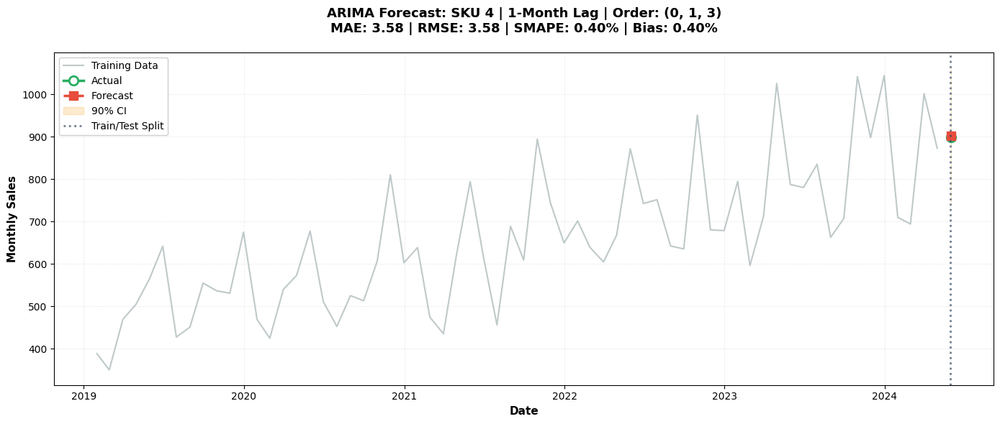

  🔹 SKU 5... ✅ MAE: 28.99 | RMSE: 28.99 | SMAPE: 3.61 | Order: (3, 1, 0)


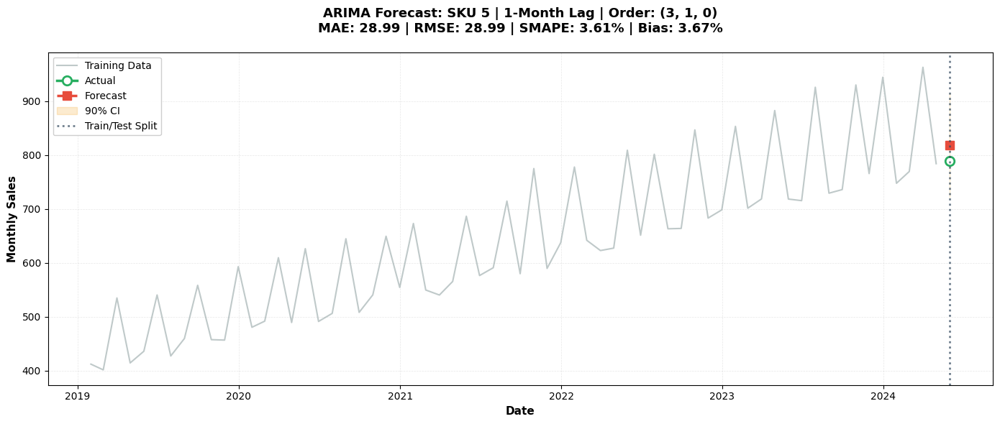

  🔹 SKU 6... ✅ MAE: 0.00 | RMSE: 0.00 | SMAPE: nan | Order: (1, 1, 2)


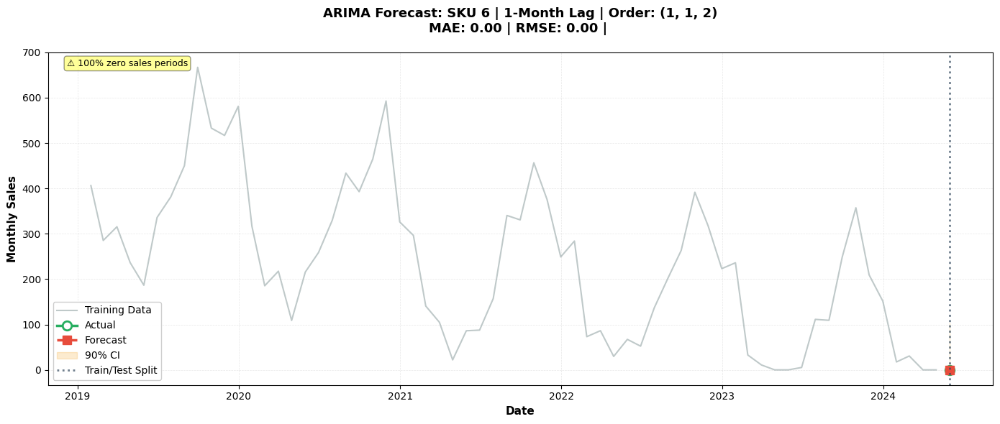

  🔹 SKU 7... ✅ MAE: 0.00 | RMSE: 0.00 | SMAPE: nan | Order: (3, 1, 1)


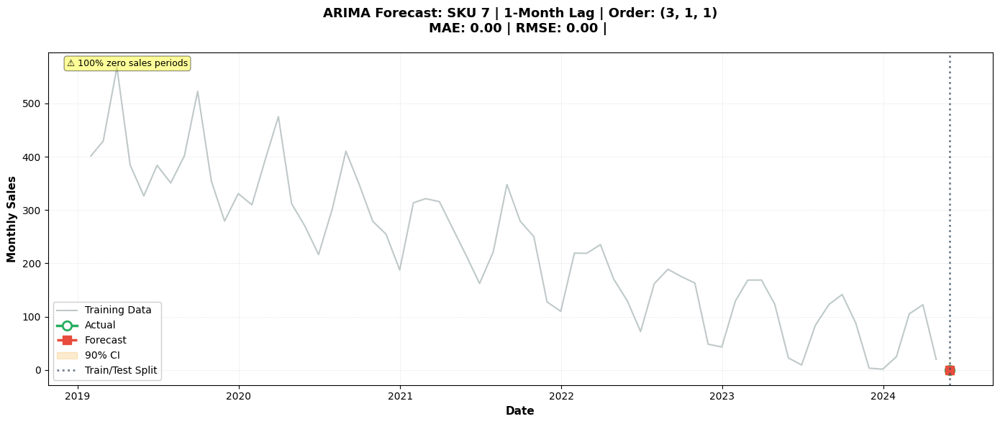

  🔹 SKU 8... ✅ MAE: 51.88 | RMSE: 51.88 | SMAPE: 6.50 | Order: (3, 1, 0)


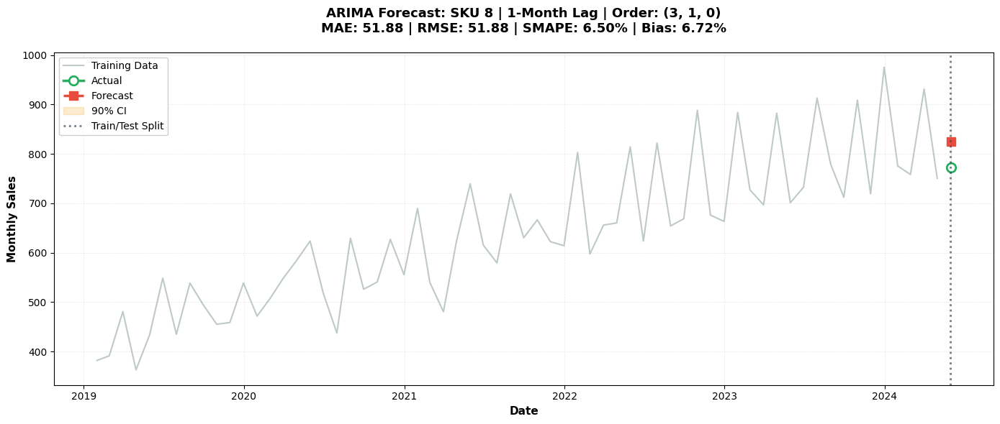

  🔹 SKU 9... ✅ MAE: 60.74 | RMSE: 60.74 | SMAPE: 7.65 | Order: (2, 1, 1)


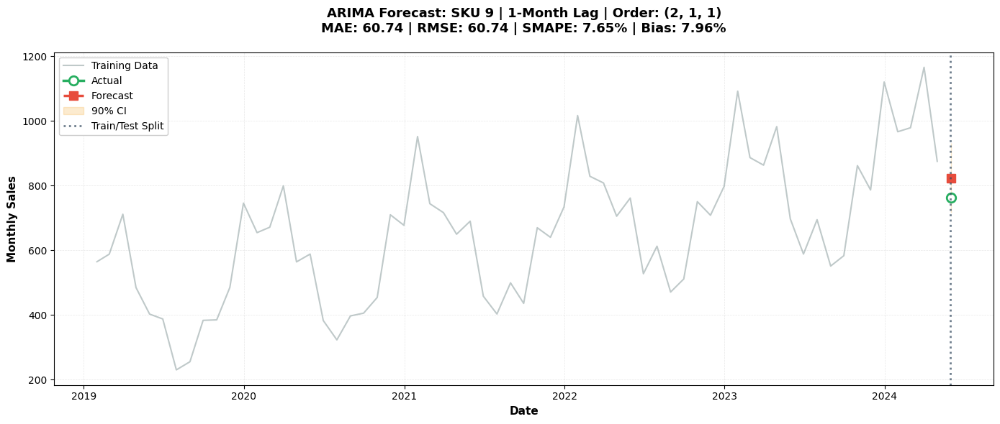

  🔹 SKU 10... ✅ MAE: 10.82 | RMSE: 10.82 | SMAPE: 11.38 | Order: (0, 1, 3)


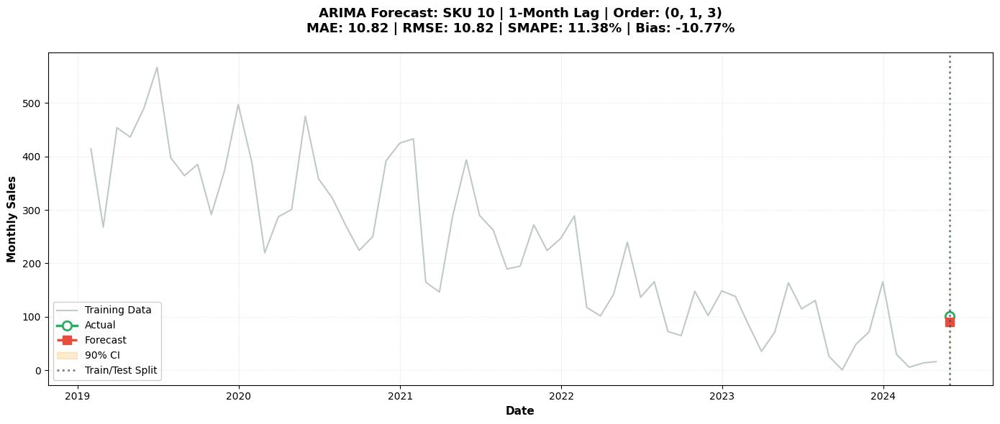


🔍 EVALUATING LAG PERIOD: 3 MONTHS
📚 Training ends: 2024-03
🎯 Forecasting: 2024-04 to 2024-06 (3 months)

  🔹 SKU 1... ✅ MAE: 111.86 | RMSE: 132.47 | SMAPE: 12.04 | Order: (2, 1, 1)


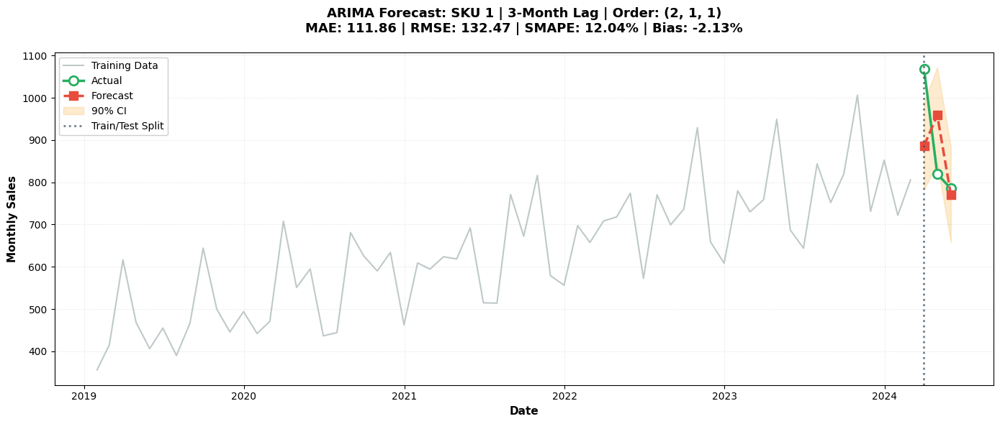

  🔹 SKU 2... ✅ MAE: 54.82 | RMSE: 59.88 | SMAPE: 6.40 | Order: (3, 1, 0)


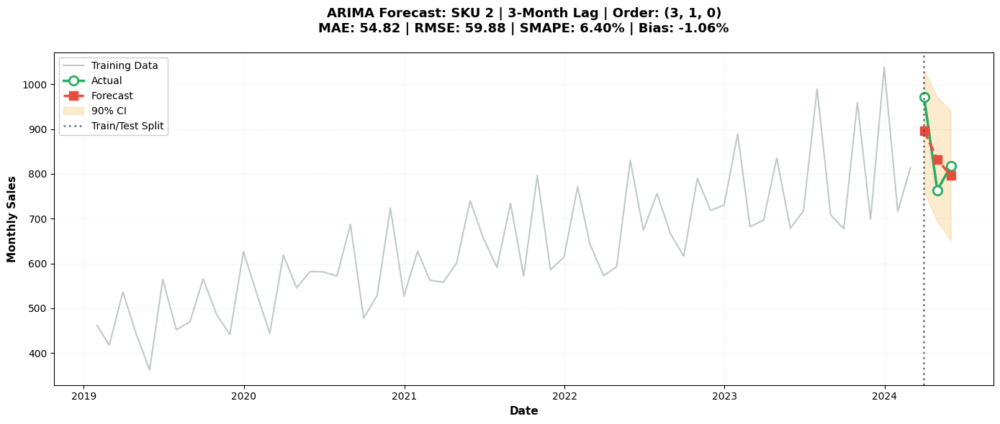

  🔹 SKU 3... ✅ MAE: 27.24 | RMSE: 39.37 | SMAPE: 3.63 | Order: (3, 1, 0)


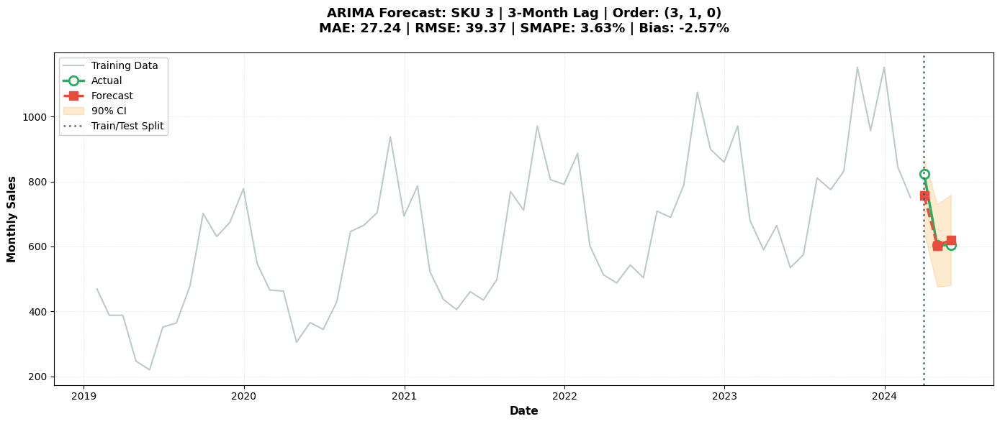

  🔹 SKU 4... ✅ MAE: 59.85 | RMSE: 78.61 | SMAPE: 6.49 | Order: (2, 1, 0)


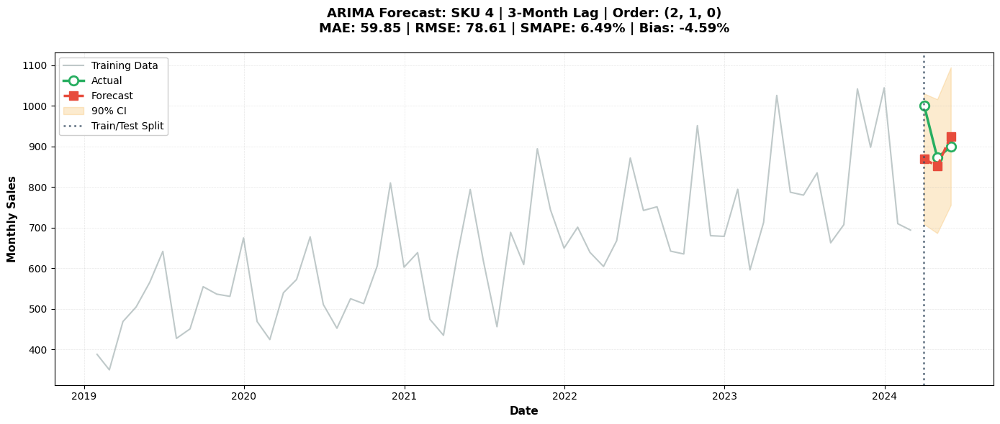

  🔹 SKU 5... ✅ MAE: 30.03 | RMSE: 35.11 | SMAPE: 3.44 | Order: (3, 1, 0)


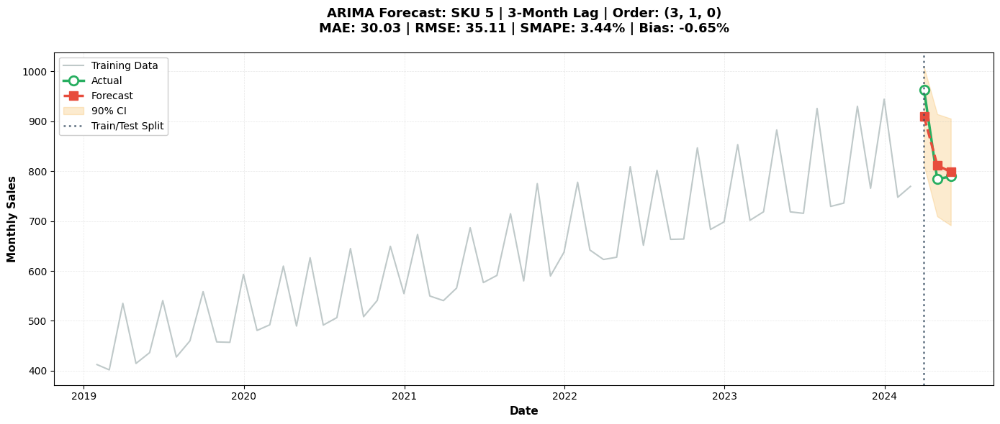

  🔹 SKU 6... ✅ MAE: 7.14 | RMSE: 12.36 | SMAPE: nan | Order: (3, 1, 2)


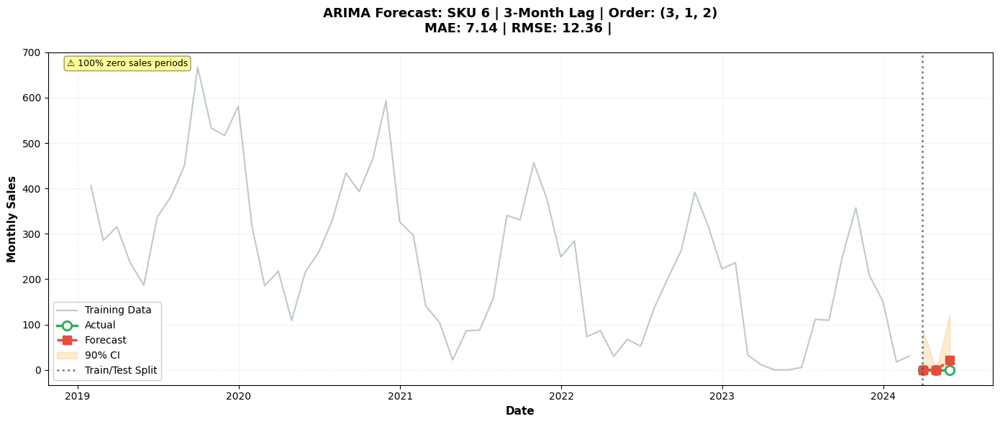

  🔹 SKU 7... ✅ MAE: 3.38 | RMSE: 4.32 | SMAPE: 12.62 | Order: (2, 1, 1)


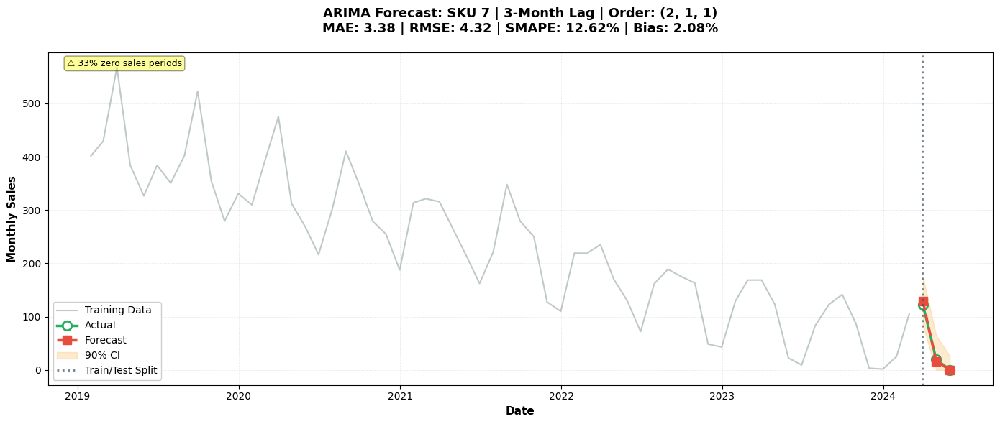

  🔹 SKU 8... ✅ MAE: 45.16 | RMSE: 53.65 | SMAPE: 5.61 | Order: (3, 1, 0)


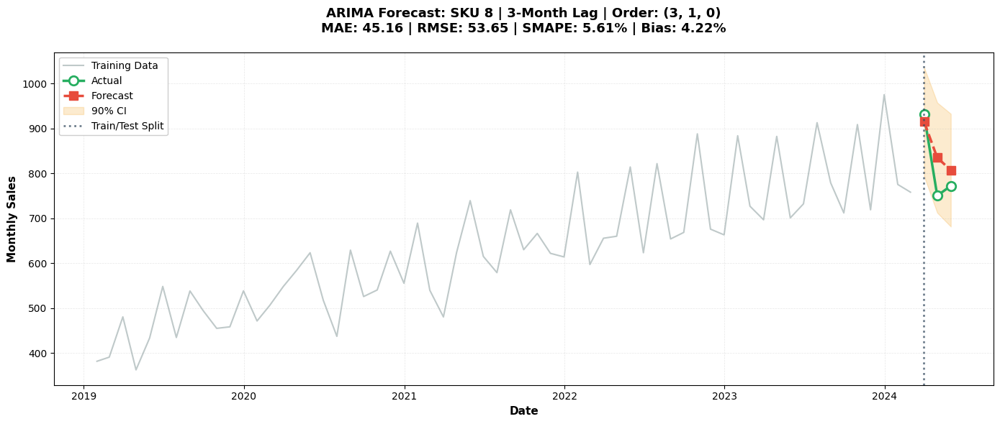

  🔹 SKU 9... ✅ MAE: 92.49 | RMSE: 107.50 | SMAPE: 9.28 | Order: (3, 1, 0)


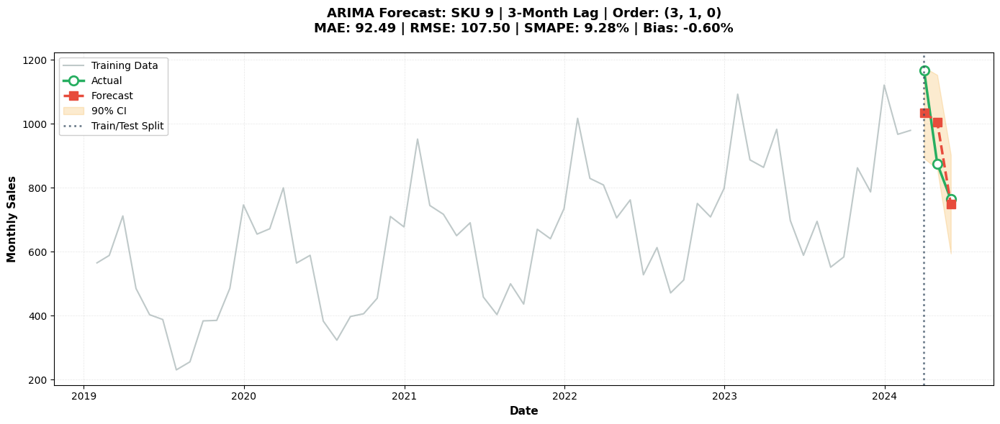

  🔹 SKU 10... ✅ MAE: 10.03 | RMSE: 10.52 | SMAPE: 38.72 | Order: (0, 1, 3)


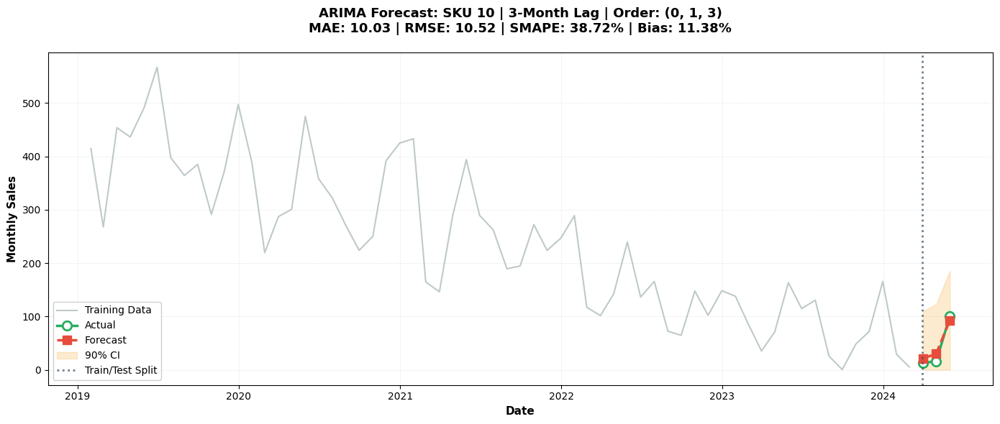


🔍 EVALUATING LAG PERIOD: 6 MONTHS
📚 Training ends: 2023-12
🎯 Forecasting: 2024-01 to 2024-06 (6 months)

  🔹 SKU 1... ✅ MAE: 111.55 | RMSE: 131.41 | SMAPE: 12.96 | Order: (3, 1, 0)


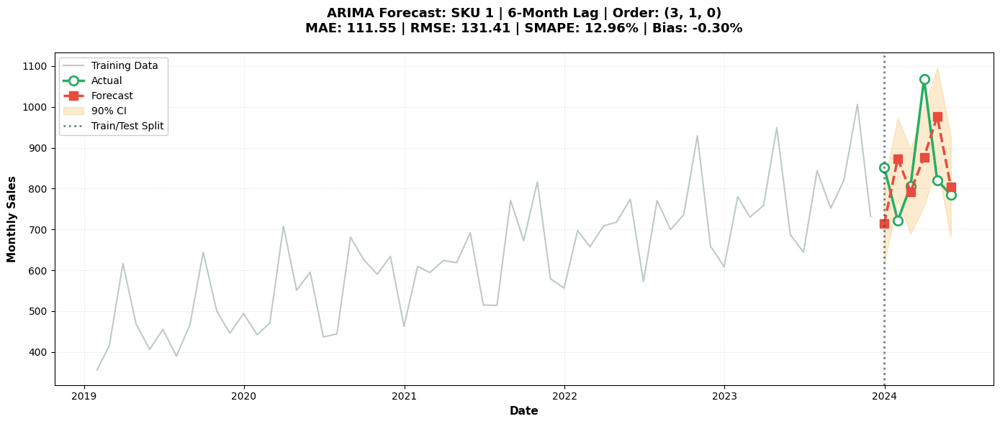

  🔹 SKU 2... ✅ MAE: 129.61 | RMSE: 155.18 | SMAPE: 15.07 | Order: (3, 1, 2)


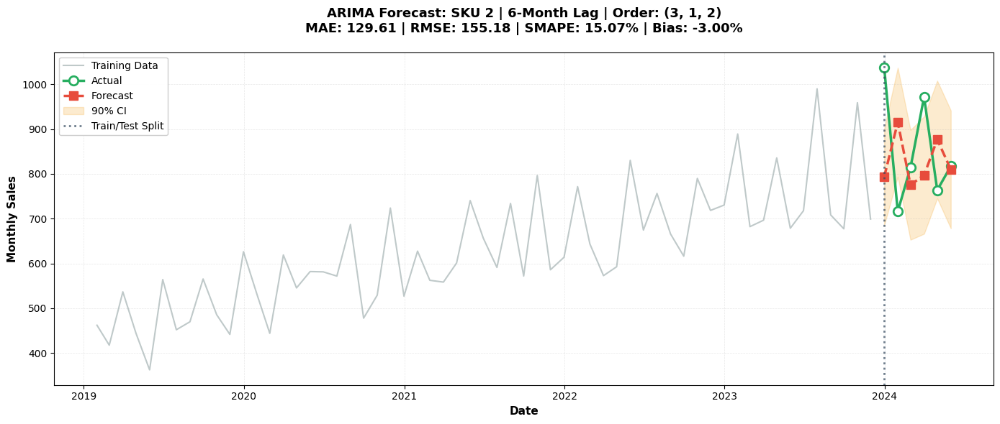

  🔹 SKU 3... ✅ MAE: 125.98 | RMSE: 151.66 | SMAPE: 14.92 | Order: (3, 1, 0)


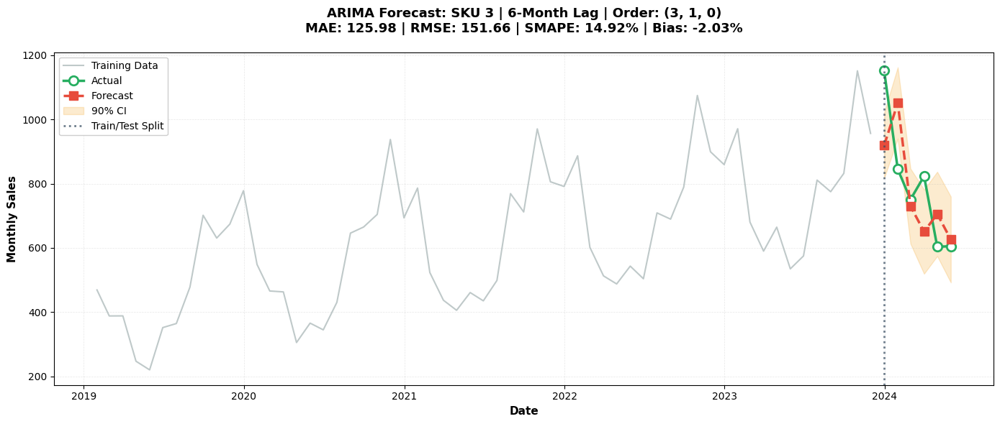

  🔹 SKU 4... ✅ MAE: 138.26 | RMSE: 163.02 | SMAPE: 15.97 | Order: (2, 1, 1)


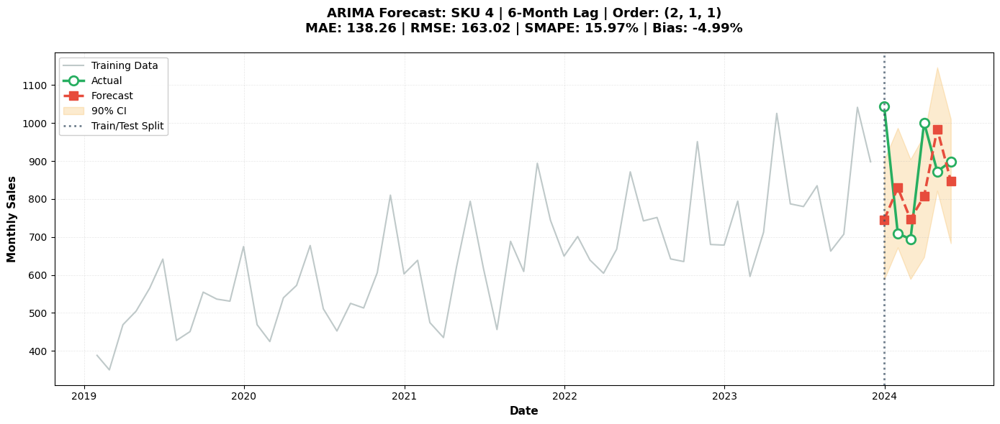

  🔹 SKU 5... ✅ MAE: 111.07 | RMSE: 125.11 | SMAPE: 13.04 | Order: (3, 1, 0)


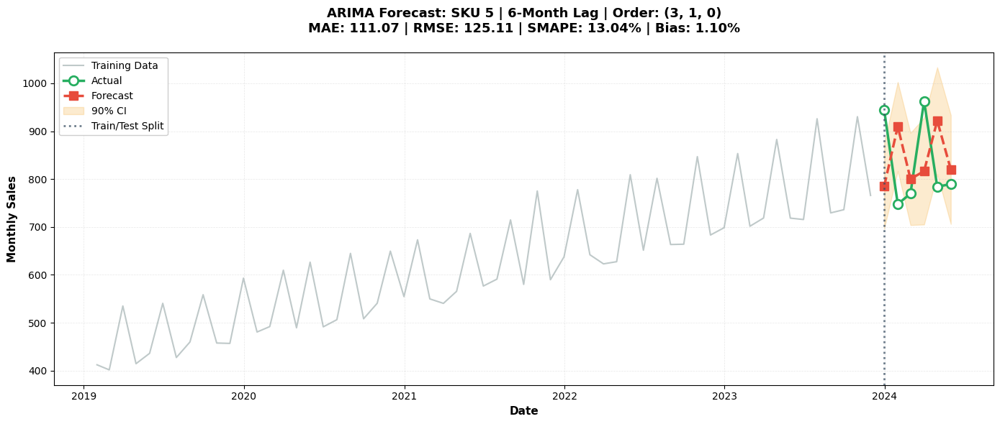

  🔹 SKU 6... ✅ MAE: 40.06 | RMSE: 68.39 | SMAPE: 129.37 | Order: (2, 1, 1)


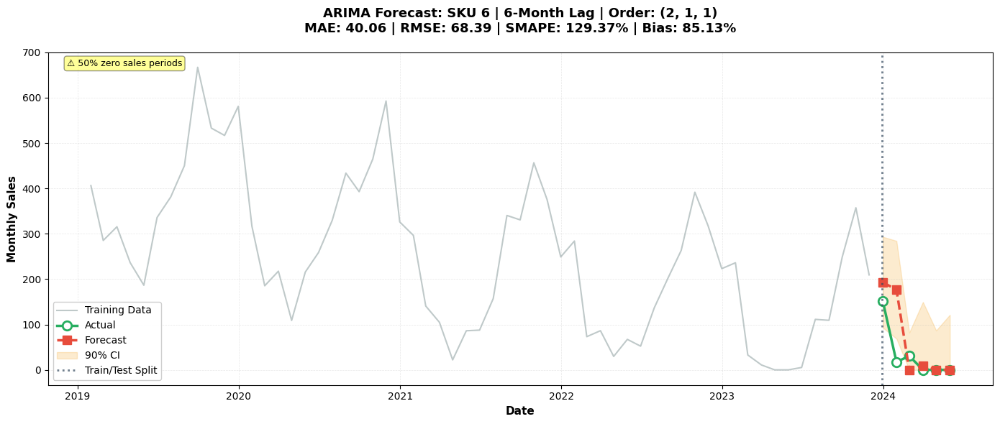

  🔹 SKU 7... ✅ MAE: 17.54 | RMSE: 22.14 | SMAPE: 78.67 | Order: (2, 1, 1)


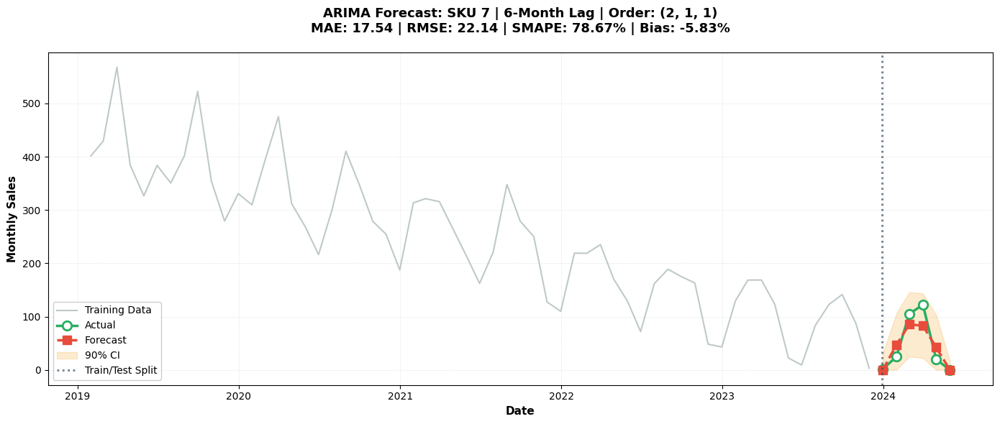

  🔹 SKU 8... ✅ MAE: 100.45 | RMSE: 116.94 | SMAPE: 11.96 | Order: (3, 1, 0)


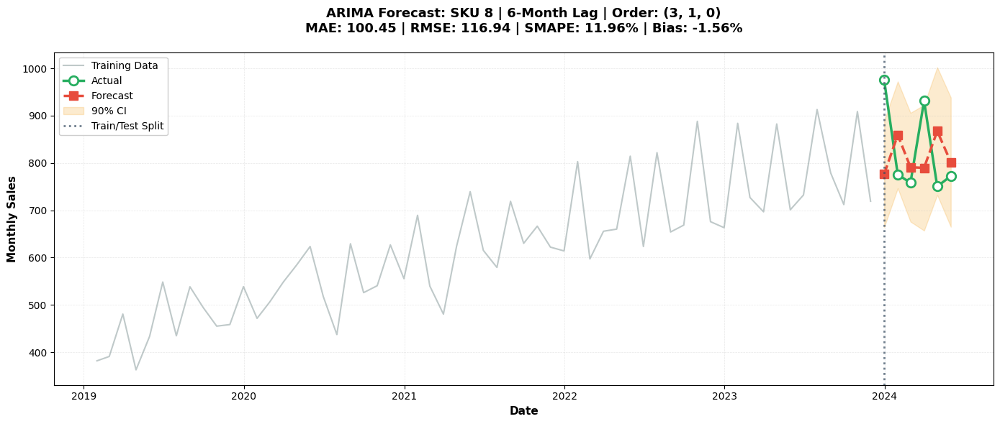

  🔹 SKU 9... ✅ MAE: 156.49 | RMSE: 176.83 | SMAPE: 15.36 | Order: (3, 1, 0)


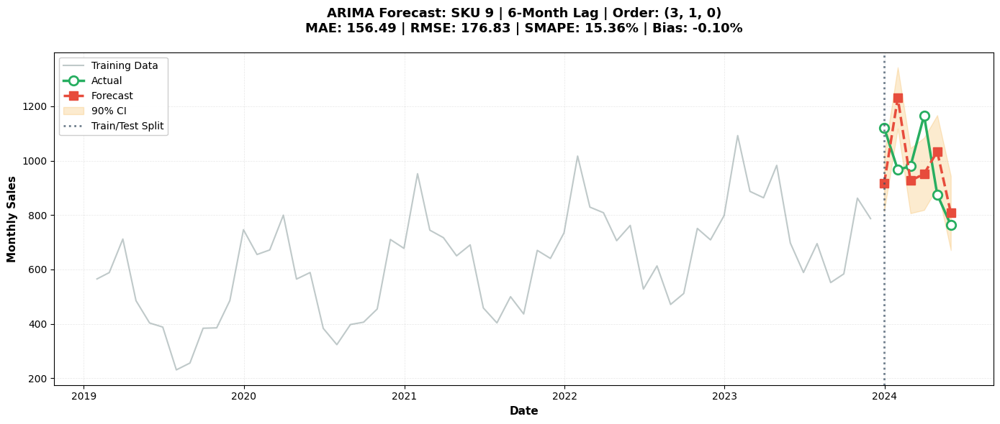

  🔹 SKU 10... ✅ MAE: 31.78 | RMSE: 41.44 | SMAPE: 92.99 | Order: (0, 1, 1)


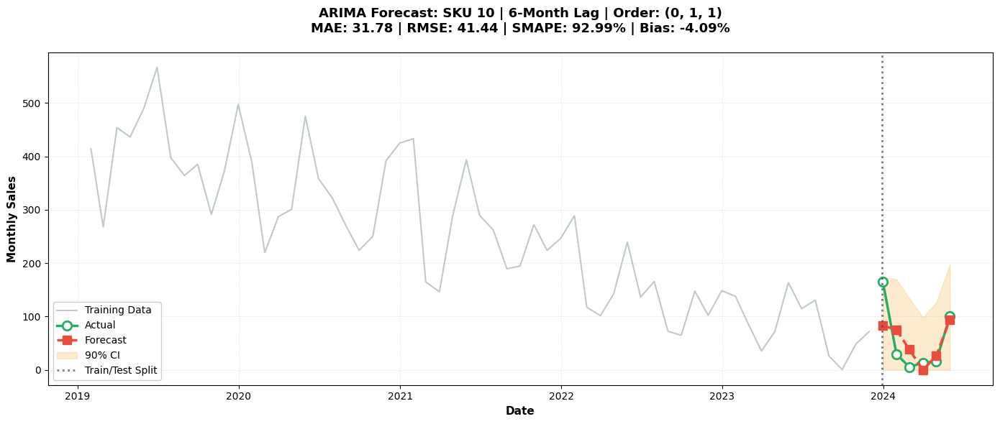


🔍 EVALUATING LAG PERIOD: 12 MONTHS
📚 Training ends: 2023-06
🎯 Forecasting: 2023-07 to 2024-06 (12 months)

  🔹 SKU 1... ✅ MAE: 86.31 | RMSE: 118.24 | SMAPE: 10.15 | Order: (1, 1, 3)


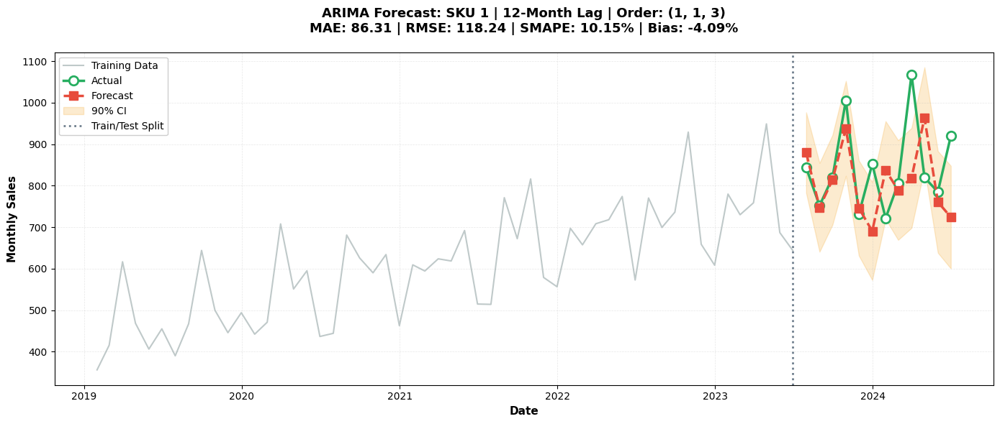

  🔹 SKU 2... ✅ MAE: 104.73 | RMSE: 131.97 | SMAPE: 12.37 | Order: (3, 1, 0)


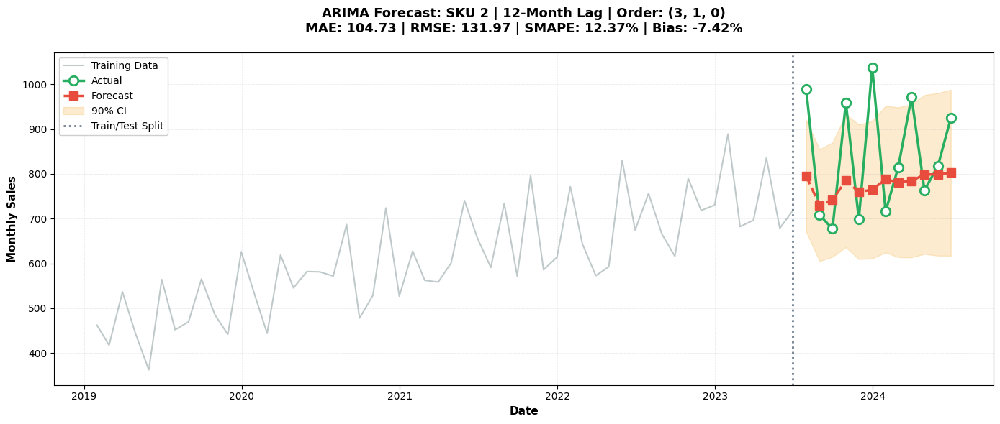

  🔹 SKU 3... ✅ MAE: 79.80 | RMSE: 107.53 | SMAPE: 9.62 | Order: (3, 1, 0)


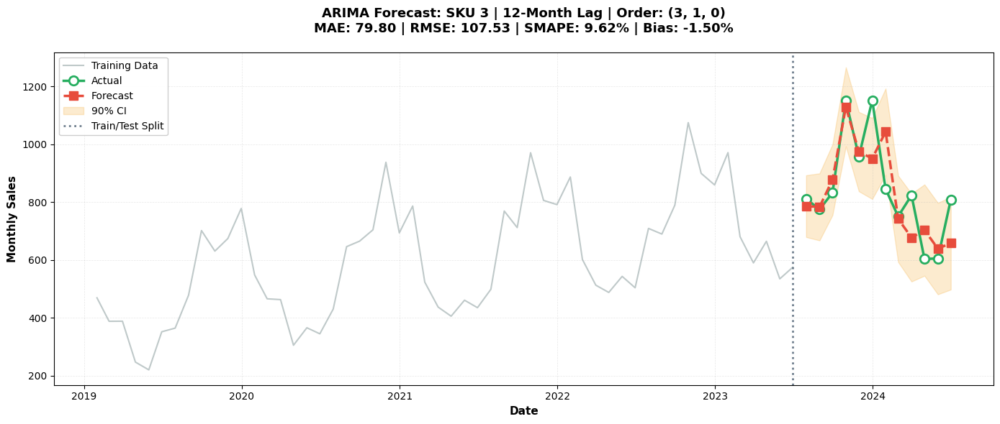

  🔹 SKU 4... ✅ MAE: 116.11 | RMSE: 139.73 | SMAPE: 13.55 | Order: (2, 1, 2)


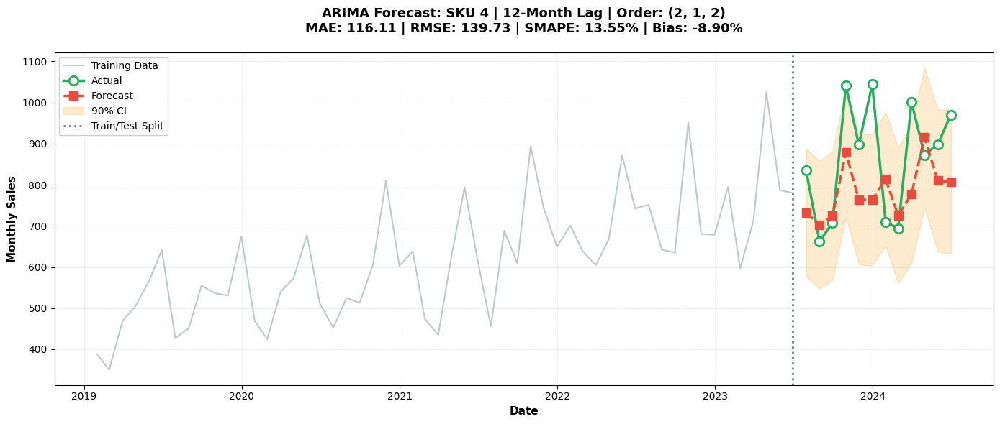

  🔹 SKU 5... ✅ MAE: 72.96 | RMSE: 95.77 | SMAPE: 8.48 | Order: (3, 1, 0)


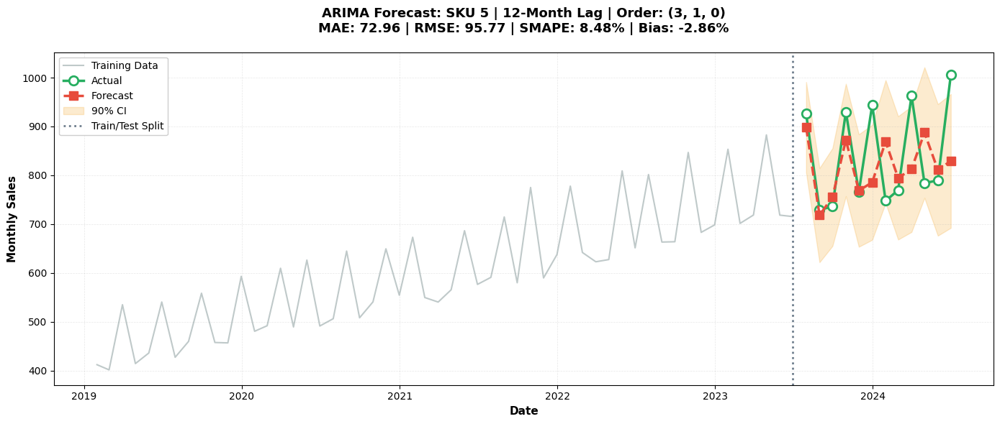

  🔹 SKU 6... ✅ MAE: 31.67 | RMSE: 49.59 | SMAPE: 58.46 | Order: (3, 1, 0)


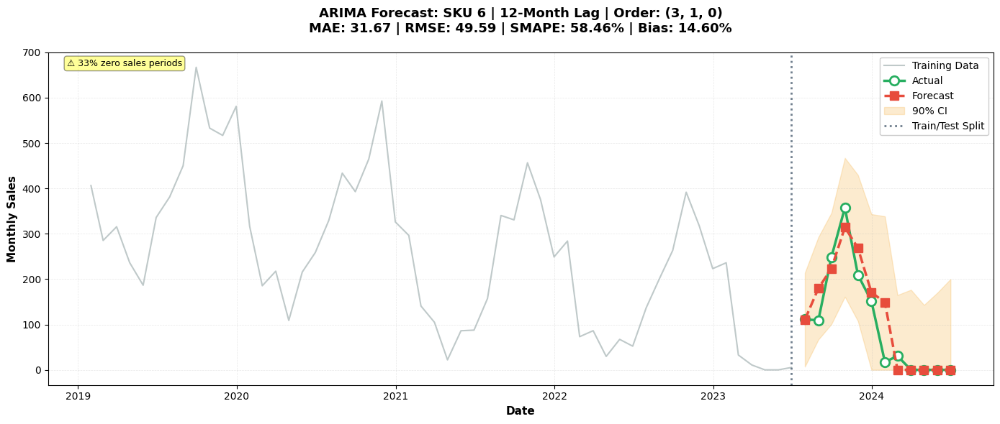

  🔹 SKU 7... ✅ MAE: 14.79 | RMSE: 20.86 | SMAPE: 67.29 | Order: (0, 1, 2)


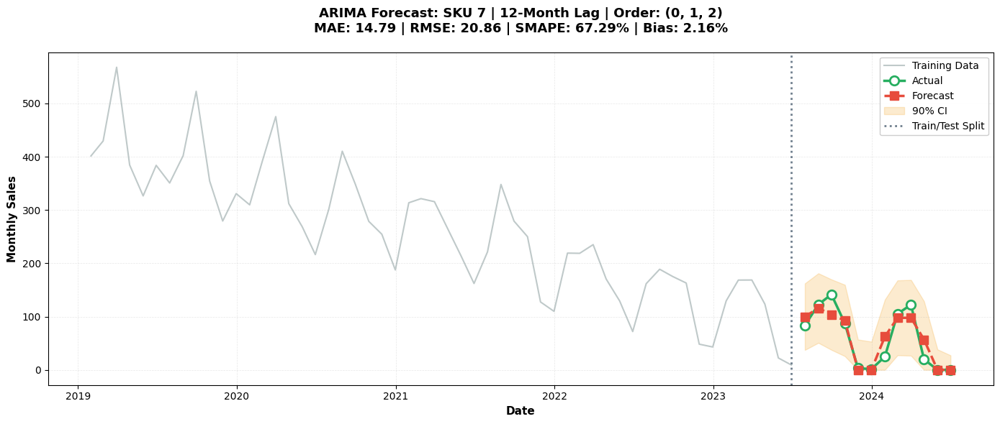

  🔹 SKU 8... ✅ MAE: 89.59 | RMSE: 101.99 | SMAPE: 10.58 | Order: (3, 1, 0)


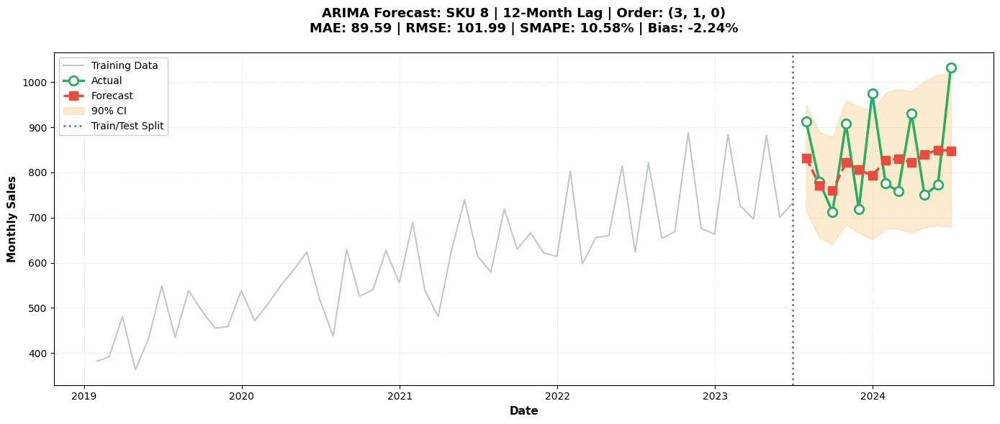

  🔹 SKU 9... ✅ MAE: 99.50 | RMSE: 133.90 | SMAPE: 10.88 | Order: (3, 1, 0)


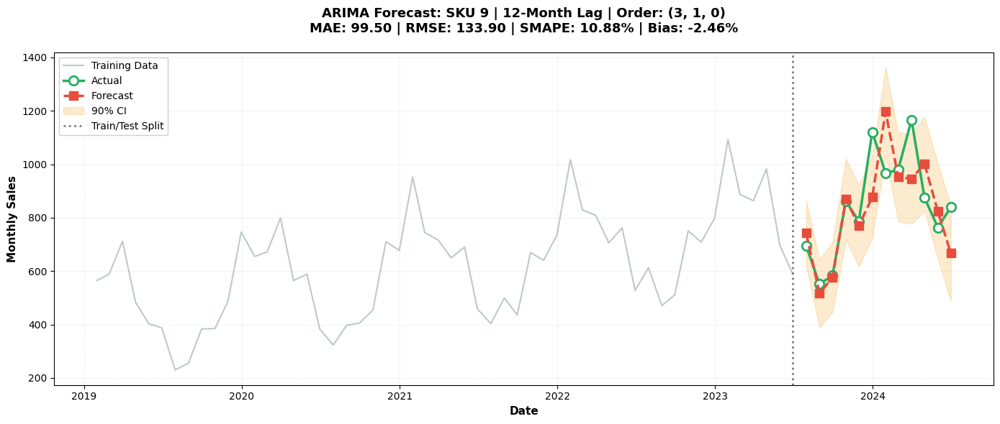

  🔹 SKU 10... ✅ MAE: 28.47 | RMSE: 35.09 | SMAPE: 68.88 | Order: (0, 1, 1)


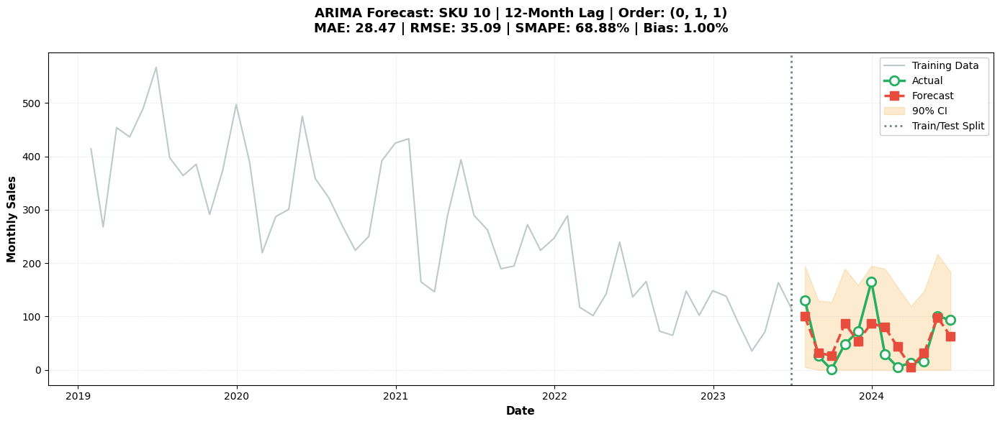


📊 CONSOLIDATING RESULTS
✅ Saved: arima_detailed_forecasts.csv
✅ Saved: arima_kpi_summary.csv

📈 SUMMARY:
   Total forecasts: 40
   SKUs evaluated: 10
   Lag periods: [1, 3, 6, 12]

📊 AVERAGE PERFORMANCE BY LAG:
              MAE    RMSE  SMAPE  Bias_%
Lag_Period                              
1           29.46   29.46   6.02    3.42
3           44.20   53.38  10.92    0.68
6           96.28  115.21  40.03    6.43
12          72.39   93.47  27.03   -1.17

🏆 TOP 5 BEST FORECASTS (by SMAPE):
 SKU_ID  Lag_Period  SMAPE    MAE   RMSE
      4           1  0.398  3.582  3.582
      2           1  2.332 19.289 19.289
      5           3  3.436 30.033 35.112
      5           1  3.606 28.991 28.991
      3           3  3.633 27.241 39.373

⚠️  TOP 5 WORST FORECASTS (by SMAPE):
 SKU_ID  Lag_Period   SMAPE    MAE   RMSE
      6           6 129.369 40.056 68.385
     10           6  92.986 31.780 41.442
      7           6  78.670 17.538 22.144
     10          12  68.884 28.474 35.089
      7    

In [170]:
arima_detailed, arima_kpi_summary = evaluate_arima_lags(
    data_monthly=data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
)

In [175]:
def evaluate_xgboost_lags(
    data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
):
    from xgboost import XGBRegressor
    
    all_detailed_results = []
    all_kpi_summaries = []
    
    max_date = data_monthly['Date'].max()
    
    # Add features to ENTIRE dataset first
    data_with_features = add_features(data_monthly).dropna()
    
    feature_cols = ['lag_1', 'lag_2', 'lag_3', 'rolling_mean_3', 'rolling_std_3', 
                    'month', 'month_sin', 'month_cos']
    
    for lag in lag_periods:
        print(f"Evaluating Lag Period: {lag} months")
        
        train_end_date = max_date - pd.DateOffset(months=lag)
        
        # Split AFTER adding features
        train_ml = data_with_features[data_with_features['Date'] <= train_end_date].copy()
        test_ml = data_with_features[data_with_features['Date'] > train_end_date].copy()
        
        for sku in sorted(data_monthly['SKU_ID'].unique()):
            print(f"  SKU {sku}...", end=" ")
            
            train_sku = train_ml[train_ml['SKU_ID'] == sku]
            test_sku = test_ml[test_ml['SKU_ID'] == sku]
            
            test_sku = test_sku.head(lag)
            
            if len(train_sku) < 24 or len(test_sku) != lag:
                print(f"Skip (train: {len(train_sku)}, test: {len(test_sku)})")
                continue
            
            X_train = train_sku[feature_cols]
            y_train = train_sku['Monthly_Sales']
            X_test = test_sku[feature_cols]
            y_test = test_sku['Monthly_Sales']
            
            try:
                model = XGBRegressor(
                    n_estimators=400,
                    learning_rate=0.05,
                    max_depth=5,
                    subsample=0.8,
                    colsample_bytree=0.8,
                    random_state=42,
                    verbosity=0
                )
                model.fit(X_train, y_train)
                preds = model.predict(X_test)
                preds = np.maximum(preds, 0)
                
                kpis = calculate_forecast_kpis(
                    actual=y_test.values,
                    predicted=preds
                )
                
                detailed_df = pd.DataFrame({
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'XGBoost',
                    'Date': test_sku['Date'].values,
                    'Actual': y_test.values,
                    'Forecast': preds,
                    'Error': y_test.values - preds,
                    'Abs_Error': np.abs(y_test.values - preds)
                })
                all_detailed_results.append(detailed_df)
                
                kpi_summary = {
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'XGBoost',
                    'Train_Months': len(train_sku),
                    'Test_Months': len(test_sku),
                    'Train_End': train_end_date.strftime('%Y-%m'),
                    'Forecast_Start': test_sku['Date'].min().strftime('%Y-%m'),
                    'Forecast_End': test_sku['Date'].max().strftime('%Y-%m'),
                    **kpis
                }
                all_kpi_summaries.append(kpi_summary)
                
                print(f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | SMAPE: {kpis['SMAPE']:.2f}")
                
                if plot_forecasts:
                    plt.figure(figsize=(14, 6))
                    plt.plot(train_sku['Date'], train_sku['Monthly_Sales'], 
                            label='Train', color='gray', alpha=0.6)
                    plt.plot(test_sku['Date'], y_test.values, 
                            label='Actual', color='green', linewidth=2.5, marker='o')
                    plt.plot(test_sku['Date'], preds, 
                            label='Forecast', color='red', linewidth=2.5, linestyle='--', marker='s')
                    plt.axvline(train_end_date, color='blue', linestyle=':', linewidth=2)
                    plt.title(f"XGBoost: SKU {sku} | {lag}-Month Lag | MAE: {kpis['MAE']:.2f}")
                    plt.legend()
                    plt.grid(alpha=0.3)
                    plt.tight_layout()
                    plt.show()
                    
            except Exception as e:
                print(f"Error: {e}")
                continue
    
    if len(all_detailed_results) == 0:
        return pd.DataFrame(), pd.DataFrame()
    
    detailed_df = pd.concat(all_detailed_results, ignore_index=True)
    kpi_summary_df = pd.DataFrame(all_kpi_summaries)
    
    if save_results:
        detailed_df.to_csv('xgboost_detailed_forecasts.csv', index=False)
        kpi_summary_df.to_csv('xgboost_kpi_summary.csv', index=False)
    
    print(f"\nTotal forecasts: {len(all_detailed_results)}")
    print(f"Average performance by lag:")
    print(kpi_summary_df.groupby('Lag_Period')[['MAE', 'RMSE', 'SMAPE']].mean().round(2))
    
    return detailed_df, kpi_summary_df


In [176]:
def evaluate_lightgbm_lags(
    data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
):
    from lightgbm import LGBMRegressor
    
    all_detailed_results = []
    all_kpi_summaries = []
    
    max_date = data_monthly['Date'].max()
    
    # Add features to ENTIRE dataset first
    data_with_features = add_features(data_monthly).dropna()
    
    feature_cols = ['lag_1', 'lag_2', 'lag_3', 'rolling_mean_3', 'rolling_std_3', 
                    'month', 'month_sin', 'month_cos']
    
    for lag in lag_periods:
        print(f"Evaluating Lag Period: {lag} months")
        
        train_end_date = max_date - pd.DateOffset(months=lag)
        
        # Split AFTER adding features
        train_ml = data_with_features[data_with_features['Date'] <= train_end_date].copy()
        test_ml = data_with_features[data_with_features['Date'] > train_end_date].copy()
        
        for sku in sorted(data_monthly['SKU_ID'].unique()):
            print(f"  SKU {sku}...", end=" ")
            
            train_sku = train_ml[train_ml['SKU_ID'] == sku]
            test_sku = test_ml[test_ml['SKU_ID'] == sku]
            
            test_sku = test_sku.head(lag)
            
            if len(train_sku) < 24 or len(test_sku) != lag:
                print(f"Skip (train: {len(train_sku)}, test: {len(test_sku)})")
                continue
            
            X_train = train_sku[feature_cols]
            y_train = train_sku['Monthly_Sales']
            X_test = test_sku[feature_cols]
            y_test = test_sku['Monthly_Sales']
            
            try:
                model = LGBMRegressor(
                    n_estimators=400,
                    learning_rate=0.05,
                    max_depth=-1,
                    num_leaves=31,
                    subsample=0.8,
                    colsample_bytree=0.8,
                    random_state=42,
                    verbosity=-1
                )
                model.fit(X_train, y_train)
                preds = model.predict(X_test)
                preds = np.maximum(preds, 0)
                
                kpis = calculate_forecast_kpis(
                    actual=y_test.values,
                    predicted=preds
                )
                
                detailed_df = pd.DataFrame({
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'LightGBM',
                    'Date': test_sku['Date'].values,
                    'Actual': y_test.values,
                    'Forecast': preds,
                    'Error': y_test.values - preds,
                    'Abs_Error': np.abs(y_test.values - preds)
                })
                all_detailed_results.append(detailed_df)
                
                kpi_summary = {
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'LightGBM',
                    'Train_Months': len(train_sku),
                    'Test_Months': len(test_sku),
                    'Train_End': train_end_date.strftime('%Y-%m'),
                    'Forecast_Start': test_sku['Date'].min().strftime('%Y-%m'),
                    'Forecast_End': test_sku['Date'].max().strftime('%Y-%m'),
                    **kpis
                }
                all_kpi_summaries.append(kpi_summary)
                
                print(f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | SMAPE: {kpis['SMAPE']:.2f}")
                
                if plot_forecasts:
                    plt.figure(figsize=(14, 6))
                    plt.plot(train_sku['Date'], train_sku['Monthly_Sales'], 
                            label='Train', color='gray', alpha=0.6)
                    plt.plot(test_sku['Date'], y_test.values, 
                            label='Actual', color='green', linewidth=2.5, marker='o')
                    plt.plot(test_sku['Date'], preds, 
                            label='Forecast', color='red', linewidth=2.5, linestyle='--', marker='s')
                    plt.axvline(train_end_date, color='blue', linestyle=':', linewidth=2)
                    plt.title(f"LightGBM: SKU {sku} | {lag}-Month Lag | MAE: {kpis['MAE']:.2f}")
                    plt.legend()
                    plt.grid(alpha=0.3)
                    plt.tight_layout()
                    plt.show()
                    
            except Exception as e:
                print(f"Error: {e}")
                continue
    
    if len(all_detailed_results) == 0:
        return pd.DataFrame(), pd.DataFrame()
    
    detailed_df = pd.concat(all_detailed_results, ignore_index=True)
    kpi_summary_df = pd.DataFrame(all_kpi_summaries)
    
    if save_results:
        detailed_df.to_csv('lightgbm_detailed_forecasts.csv', index=False)
        kpi_summary_df.to_csv('lightgbm_kpi_summary.csv', index=False)
    
    print(f"\nTotal forecasts: {len(all_detailed_results)}")
    print(f"Average performance by lag:")
    print(kpi_summary_df.groupby('Lag_Period')[['MAE', 'RMSE', 'SMAPE']].mean().round(2))
    
    return detailed_df, kpi_summary_df

Evaluating Lag Period: 1 months
  SKU 1... MAE: 120.92 | RMSE: 120.92 | SMAPE: 14.30


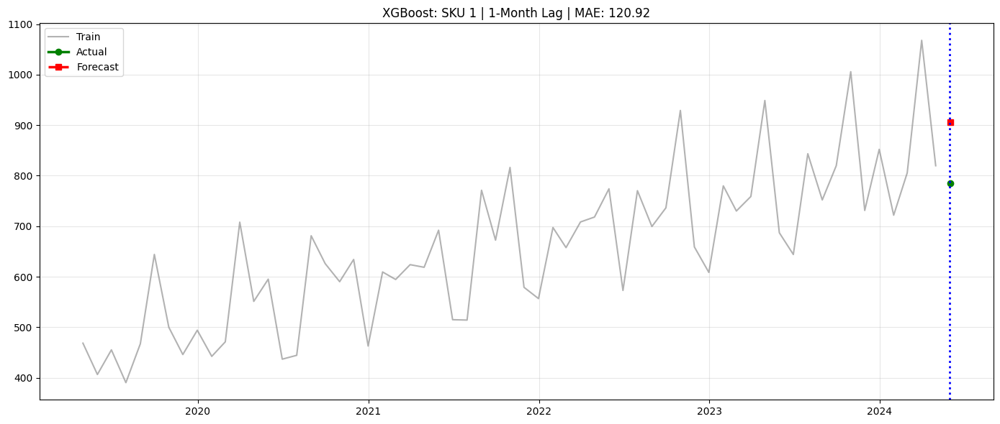

  SKU 2... MAE: 81.41 | RMSE: 81.41 | SMAPE: 9.49


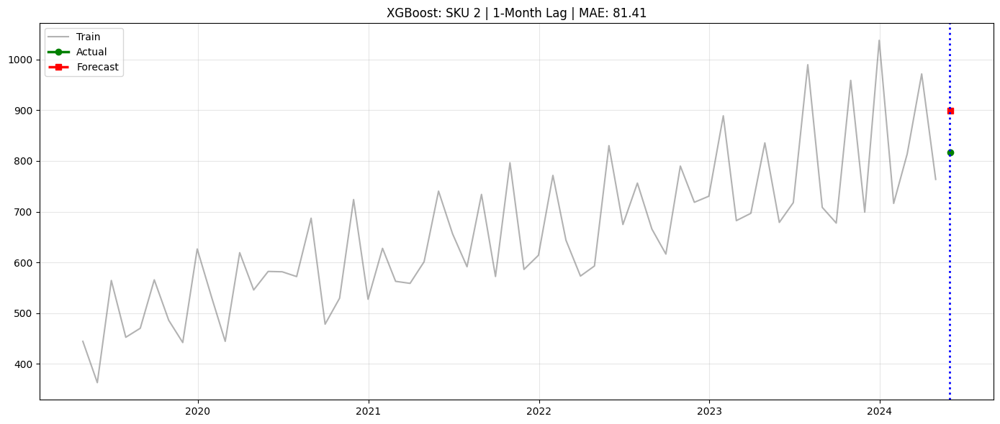

  SKU 3... MAE: 19.76 | RMSE: 19.76 | SMAPE: 3.21


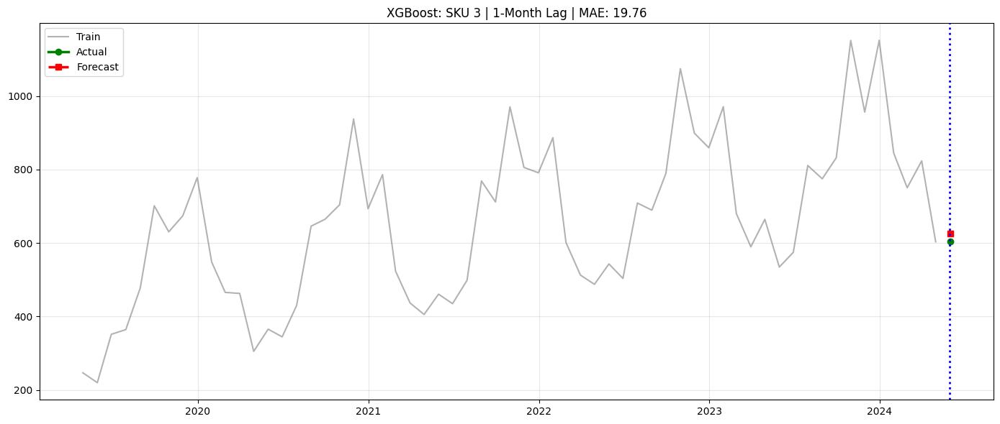

  SKU 4... MAE: 106.97 | RMSE: 106.97 | SMAPE: 12.65


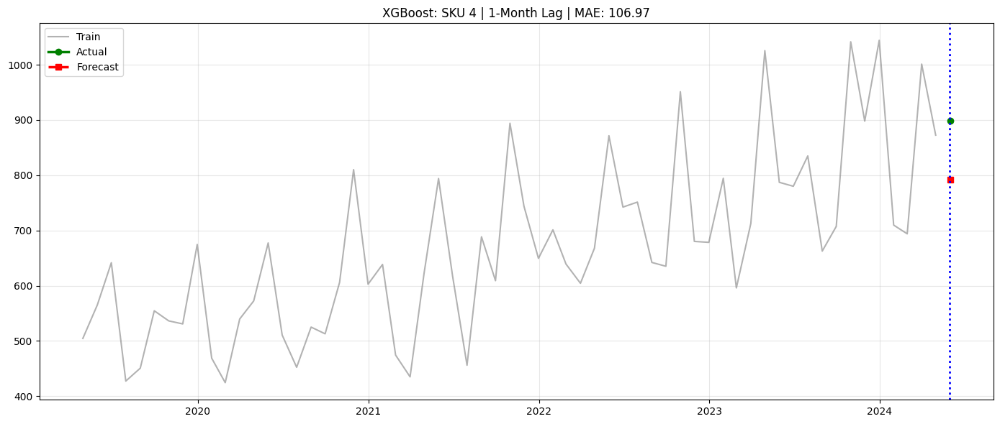

  SKU 5... MAE: 39.57 | RMSE: 39.57 | SMAPE: 5.14


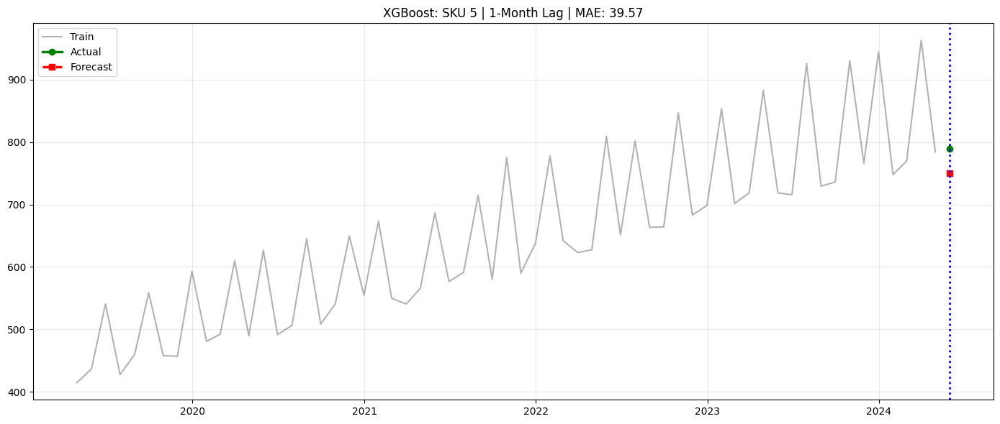

  SKU 6... MAE: 0.00 | RMSE: 0.00 | SMAPE: nan


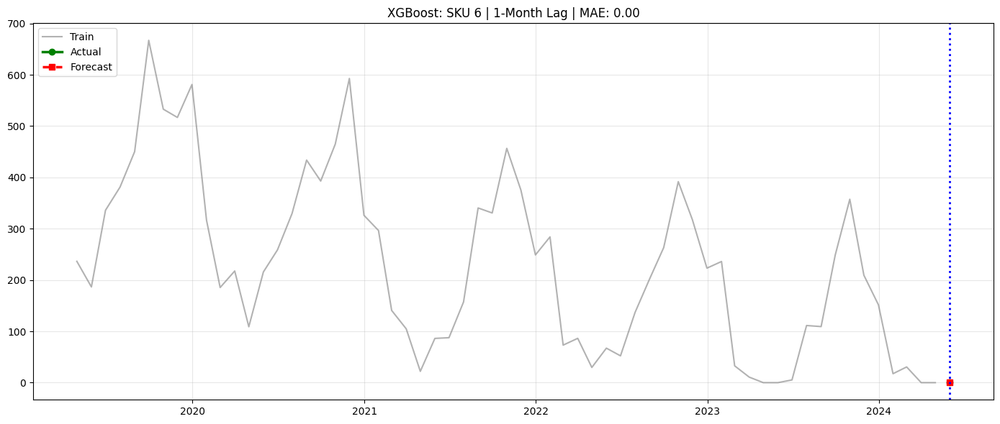

  SKU 7... MAE: 5.15 | RMSE: 5.15 | SMAPE: nan


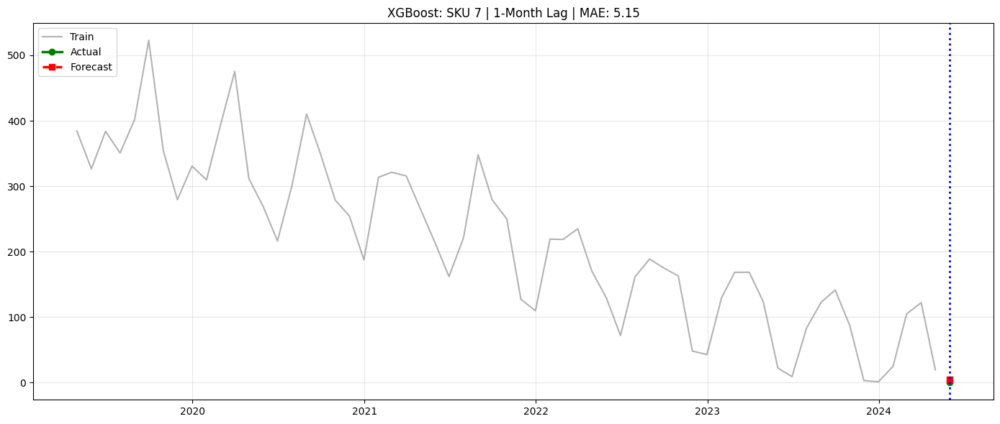

  SKU 8... MAE: 30.11 | RMSE: 30.11 | SMAPE: 3.82


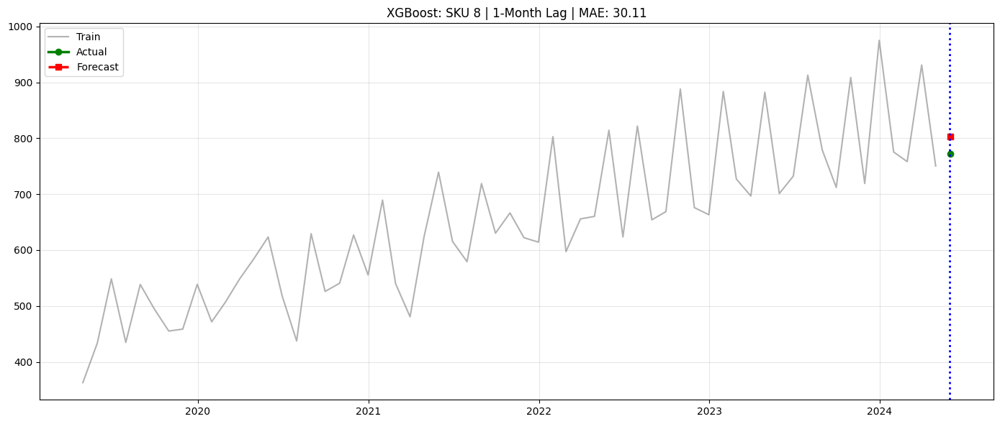

  SKU 9... MAE: 91.83 | RMSE: 91.83 | SMAPE: 11.35


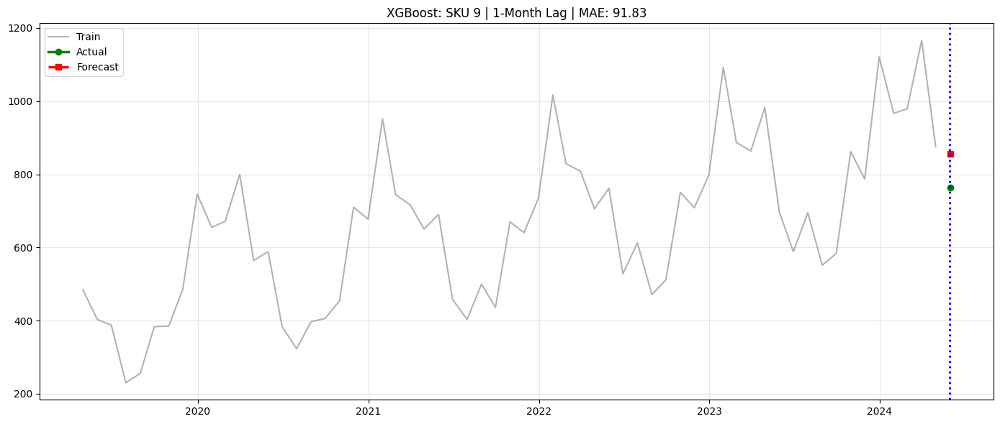

  SKU 10... MAE: 19.88 | RMSE: 19.88 | SMAPE: 21.96


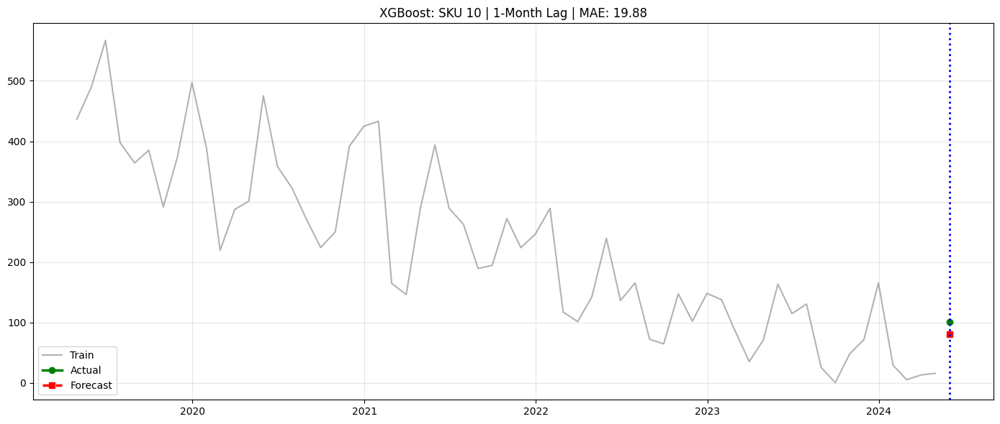

Evaluating Lag Period: 3 months
  SKU 1... MAE: 101.62 | RMSE: 111.89 | SMAPE: 11.58


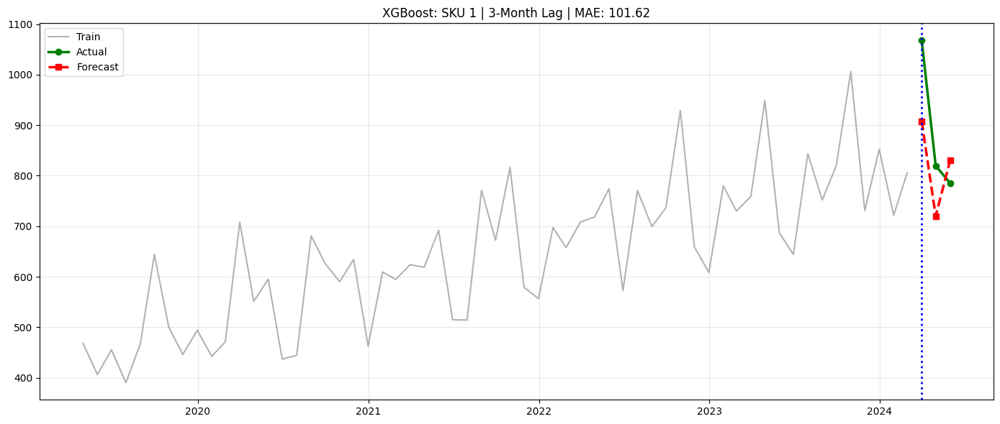

  SKU 2... MAE: 144.40 | RMSE: 165.92 | SMAPE: 17.99


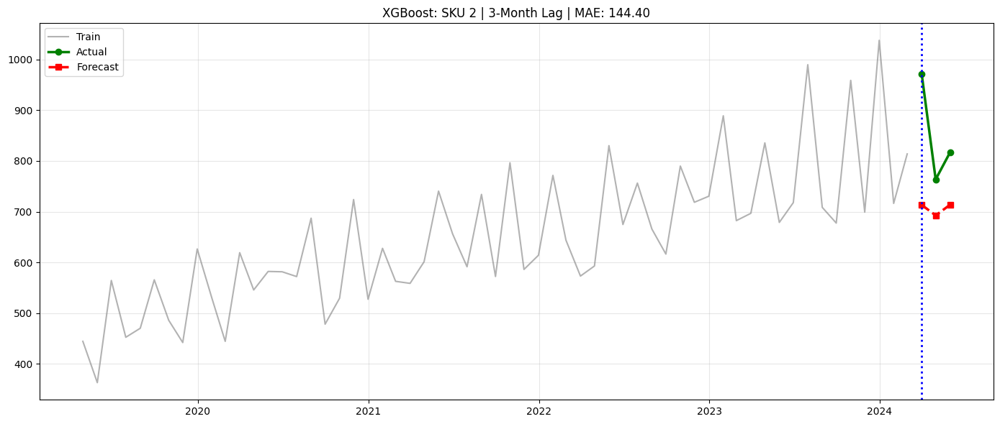

  SKU 3... MAE: 37.24 | RMSE: 39.65 | SMAPE: 5.36


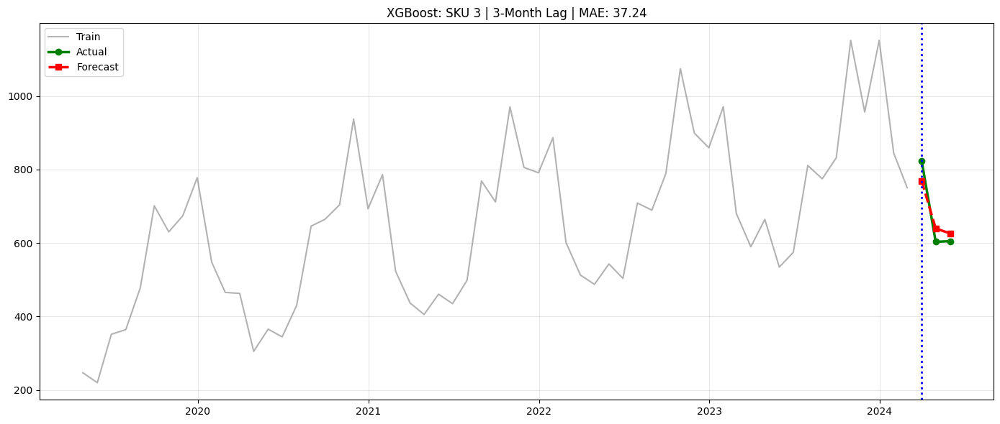

  SKU 4... MAE: 96.42 | RMSE: 111.73 | SMAPE: 10.85


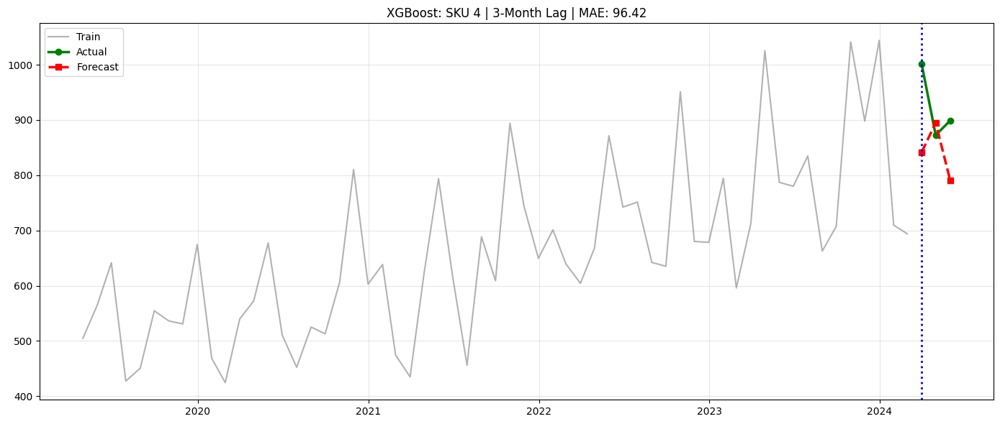

  SKU 5... MAE: 75.10 | RMSE: 87.12 | SMAPE: 9.00


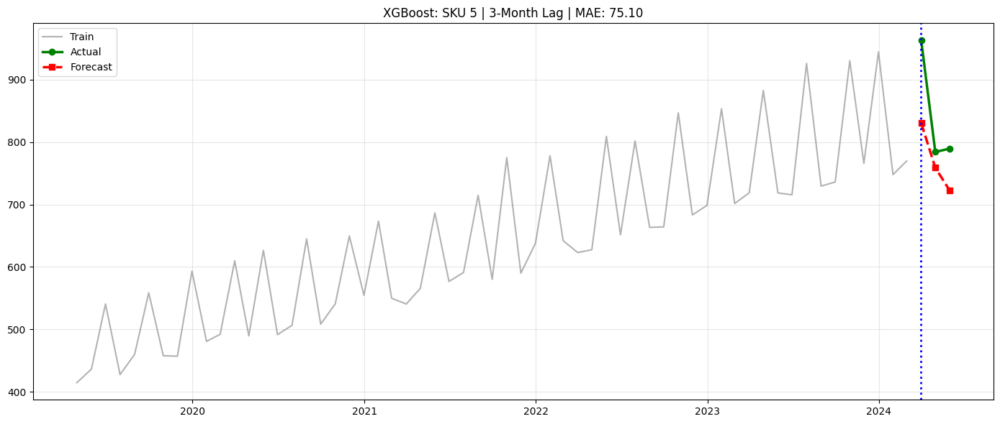

  SKU 6... MAE: 5.77 | RMSE: 8.98 | SMAPE: nan


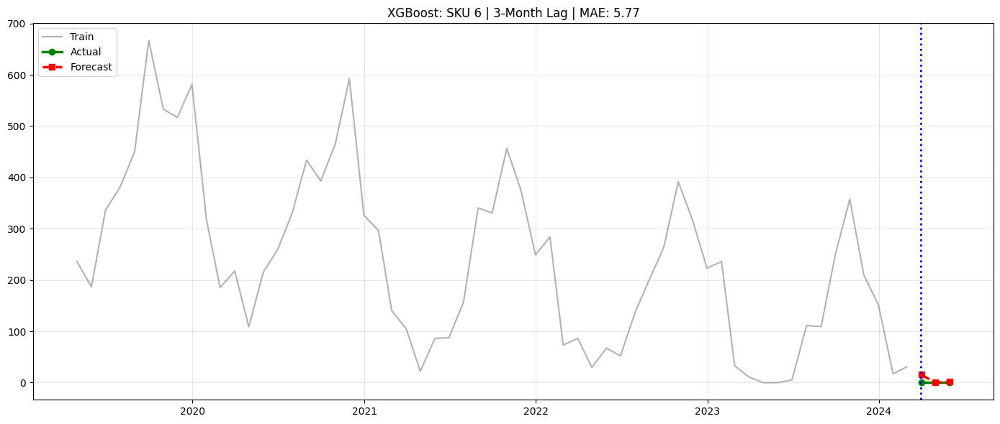

  SKU 7... MAE: 30.08 | RMSE: 38.21 | SMAPE: 69.41


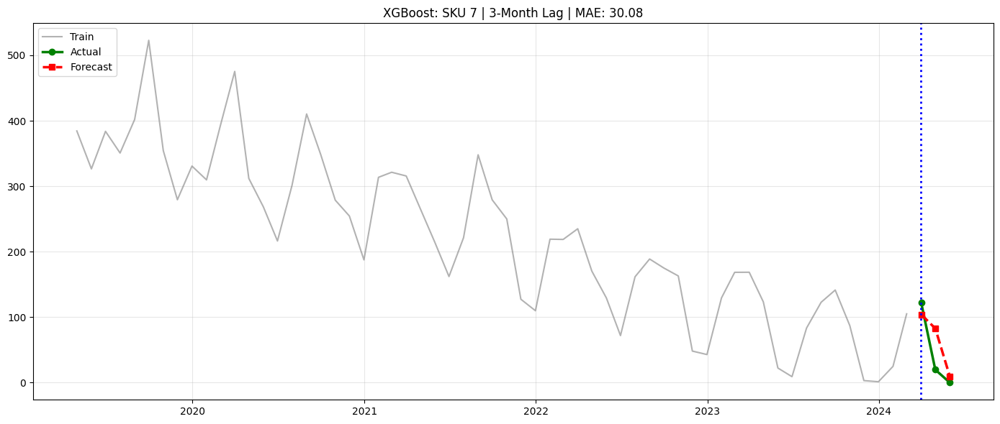

  SKU 8... MAE: 60.99 | RMSE: 84.79 | SMAPE: 7.32


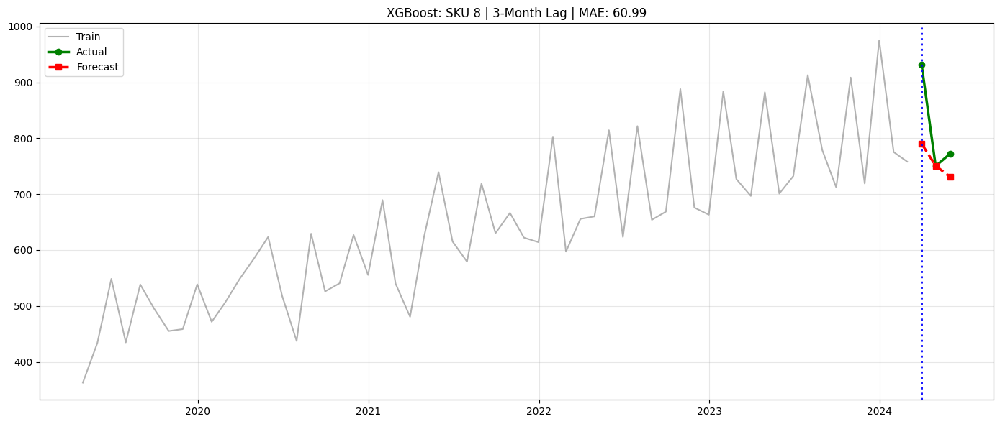

  SKU 9... MAE: 163.43 | RMSE: 202.17 | SMAPE: 17.38


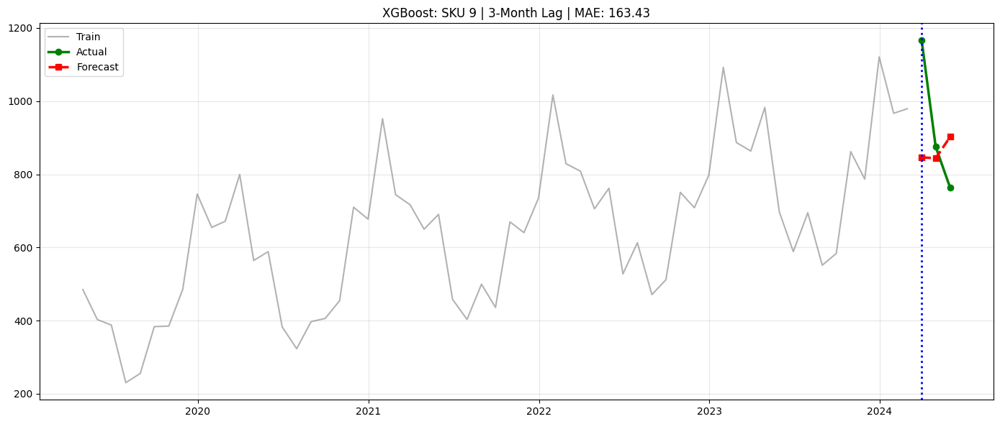

  SKU 10... MAE: 45.11 | RMSE: 49.55 | SMAPE: 94.20


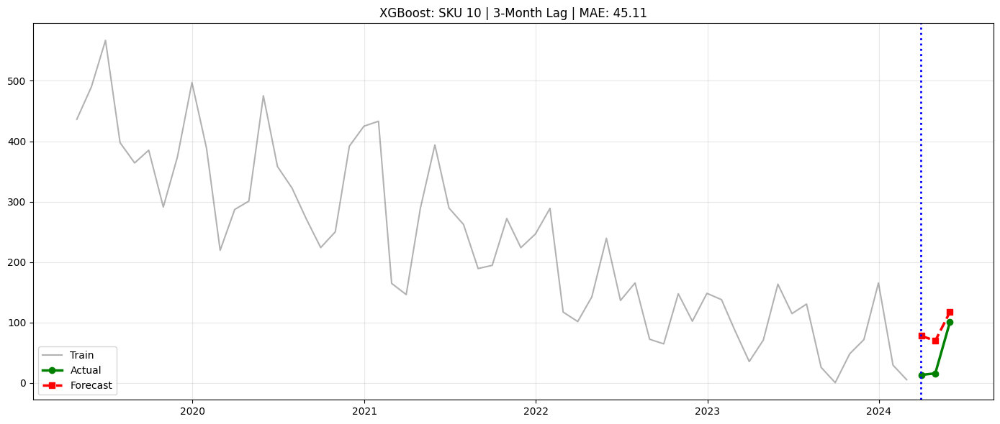

Evaluating Lag Period: 6 months
  SKU 1... MAE: 84.79 | RMSE: 95.52 | SMAPE: 9.96


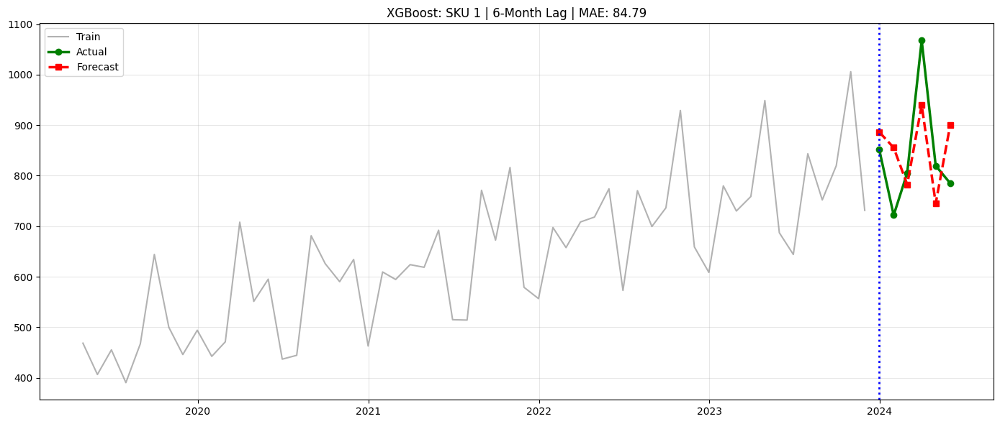

  SKU 2... MAE: 127.25 | RMSE: 151.12 | SMAPE: 15.22


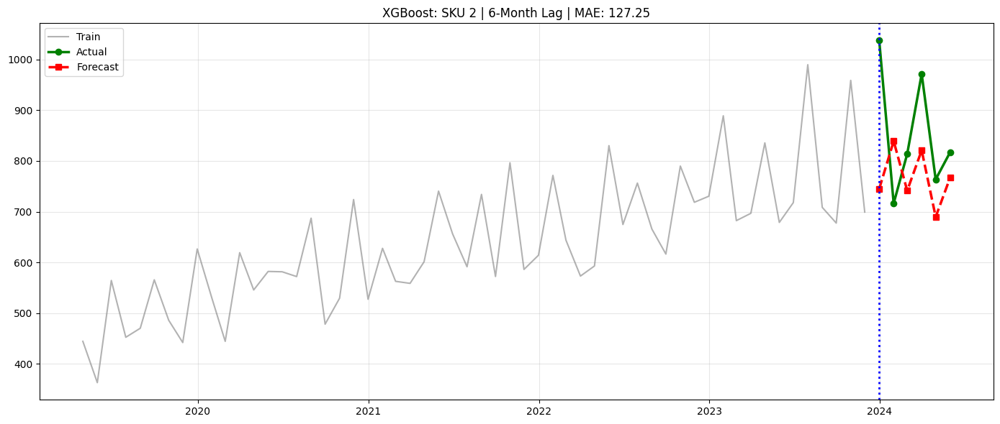

  SKU 3... MAE: 119.06 | RMSE: 159.93 | SMAPE: 13.68


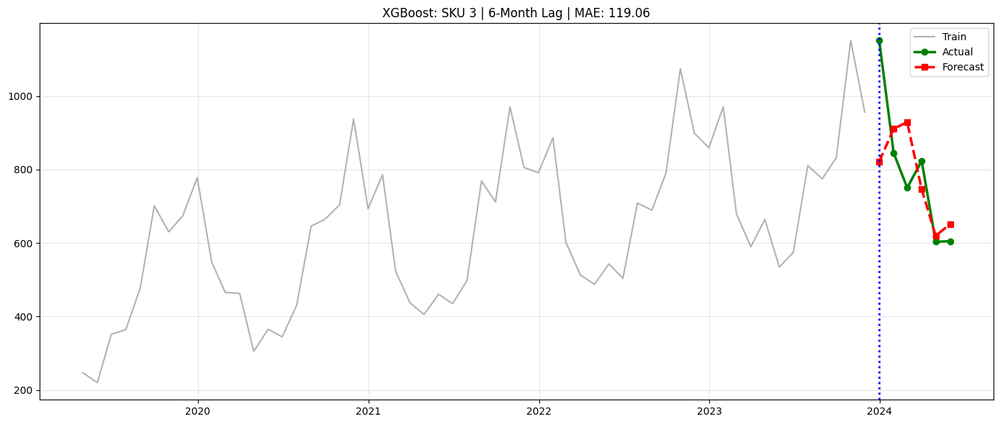

  SKU 4... MAE: 158.10 | RMSE: 187.52 | SMAPE: 18.72


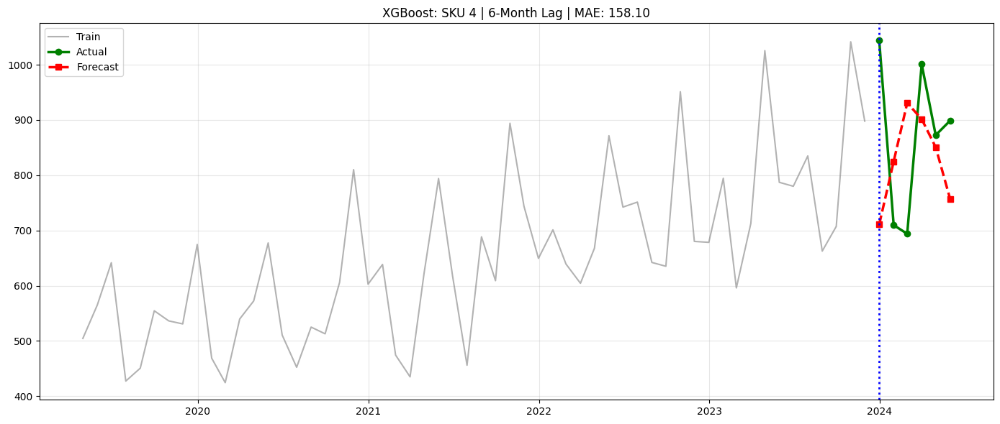

  SKU 5... MAE: 73.89 | RMSE: 99.60 | SMAPE: 8.91


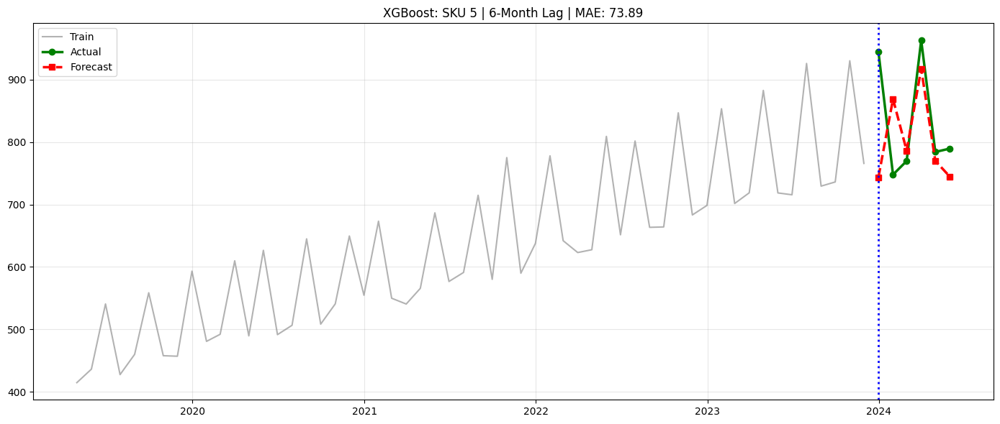

  SKU 6... MAE: 31.13 | RMSE: 46.52 | SMAPE: 70.79


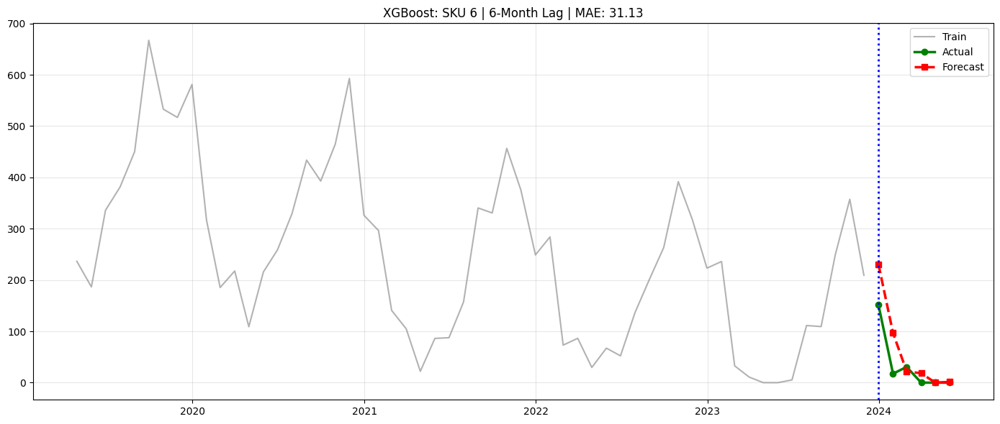

  SKU 7... MAE: 51.09 | RMSE: 60.92 | SMAPE: 97.62


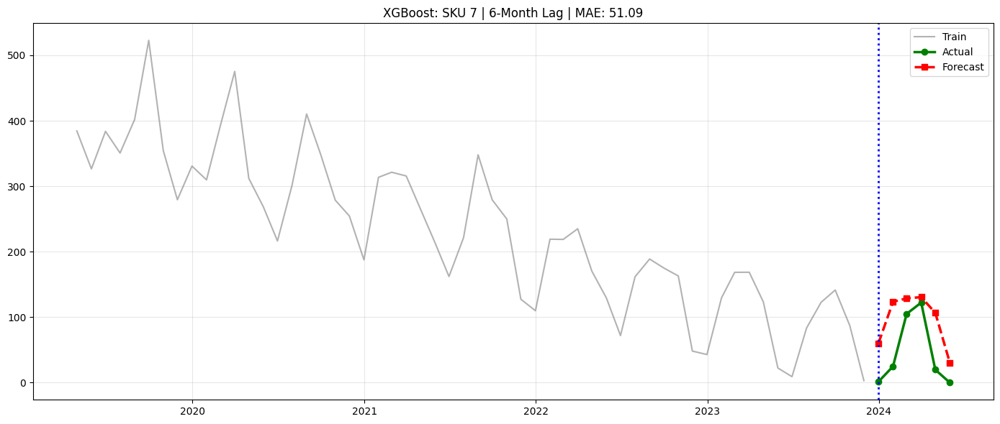

  SKU 8... MAE: 88.45 | RMSE: 124.49 | SMAPE: 10.74


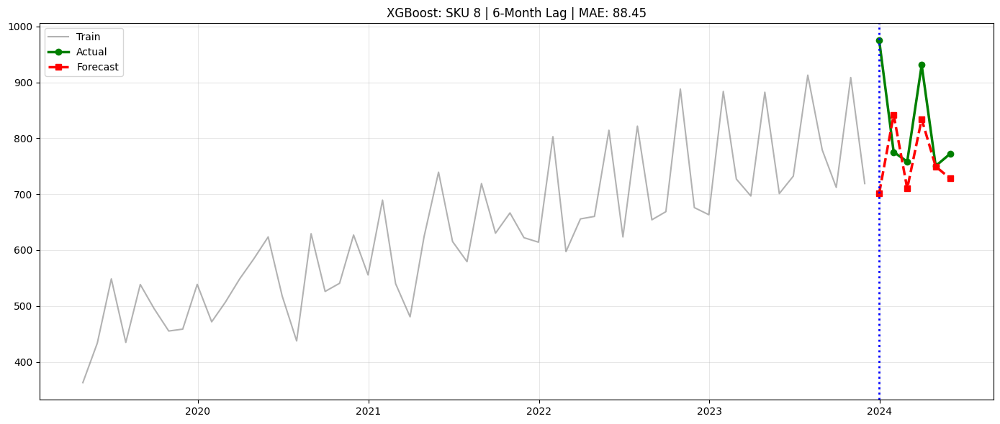

  SKU 9... MAE: 131.15 | RMSE: 159.99 | SMAPE: 13.64


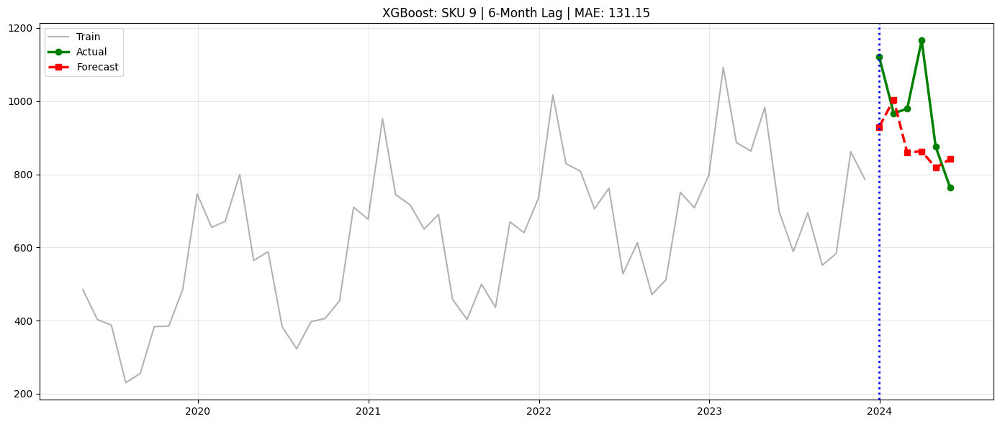

  SKU 10... MAE: 49.61 | RMSE: 55.04 | SMAPE: 96.88


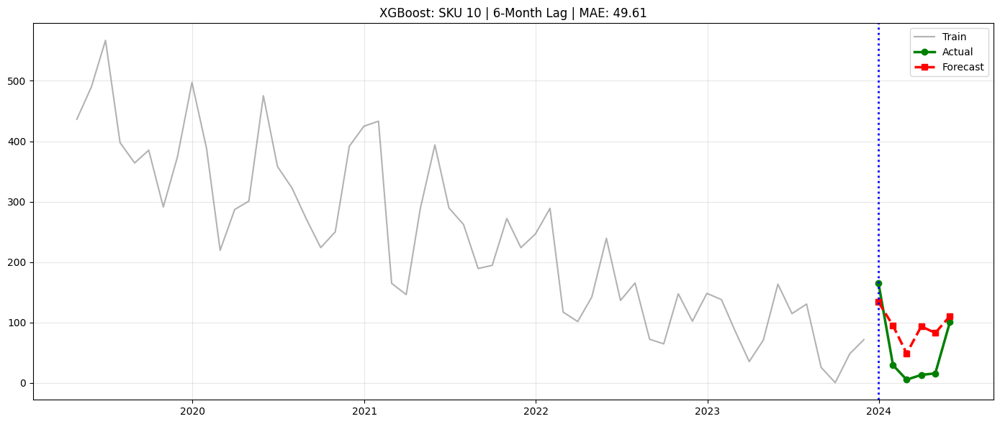

Evaluating Lag Period: 12 months
  SKU 1... MAE: 80.48 | RMSE: 116.89 | SMAPE: 9.47


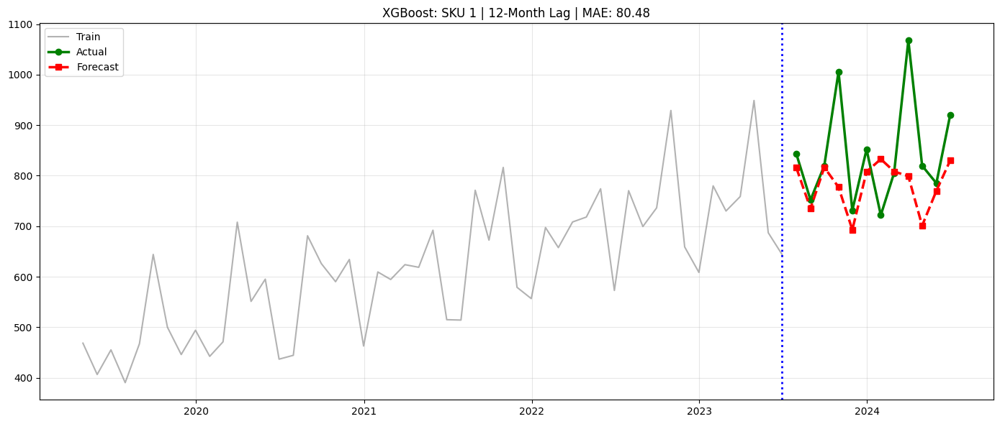

  SKU 2... MAE: 97.08 | RMSE: 119.75 | SMAPE: 11.50


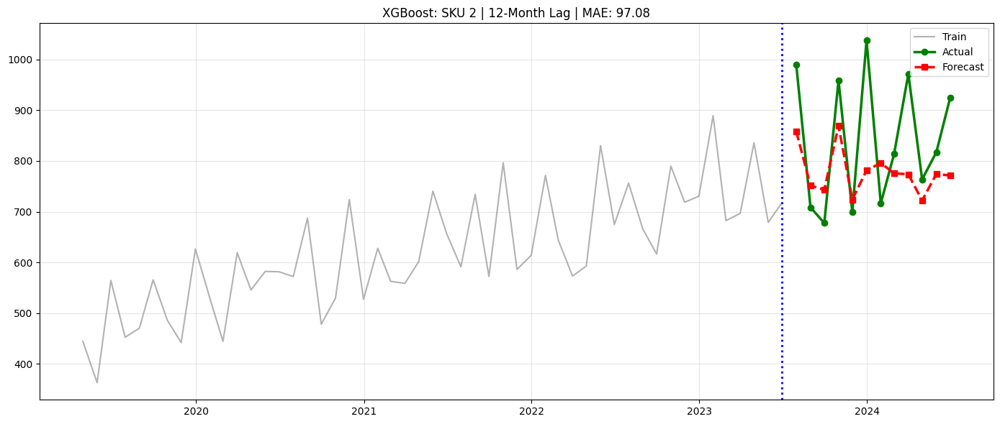

  SKU 3... MAE: 92.55 | RMSE: 135.10 | SMAPE: 10.82


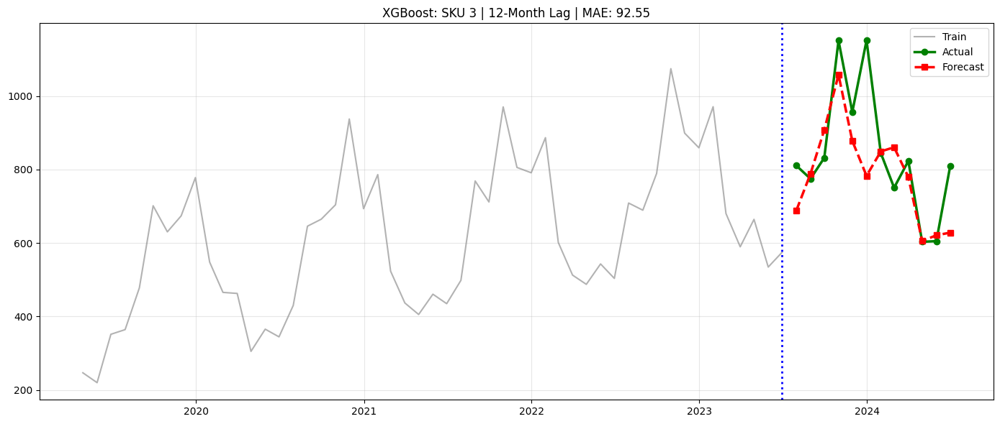

  SKU 4... MAE: 144.38 | RMSE: 168.96 | SMAPE: 17.33


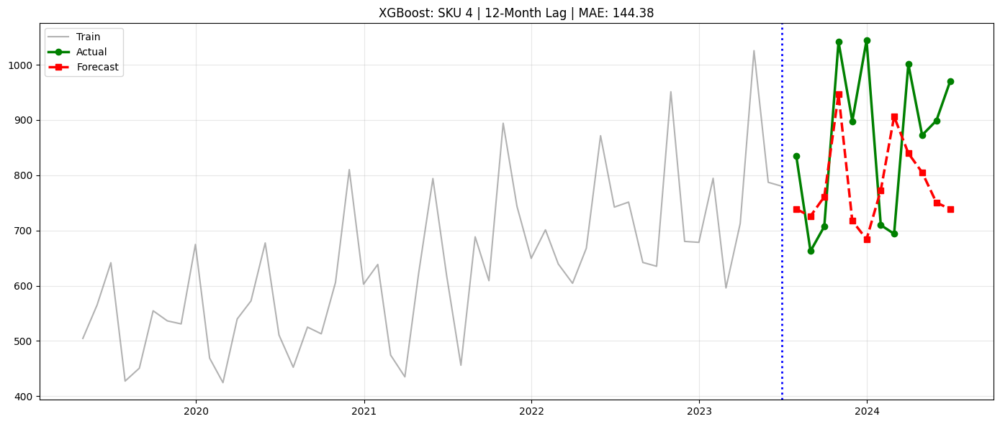

  SKU 5... MAE: 89.48 | RMSE: 118.04 | SMAPE: 10.77


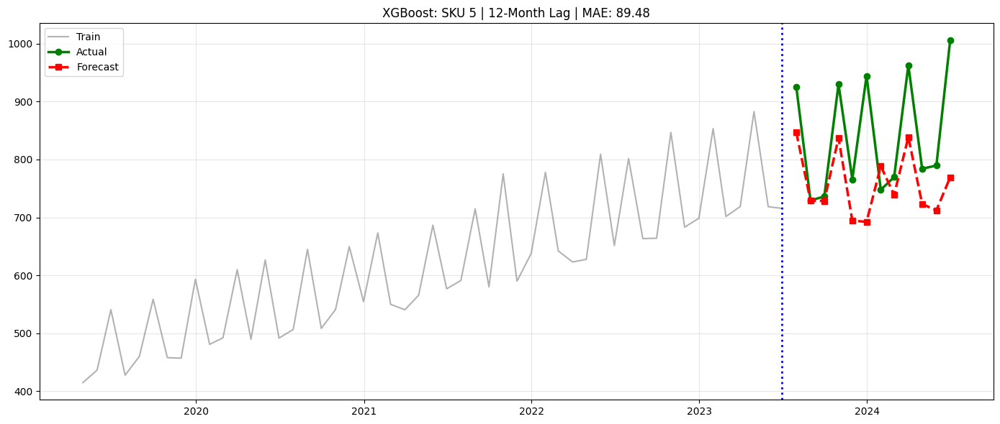

  SKU 6... MAE: 43.86 | RMSE: 57.95 | SMAPE: 55.68


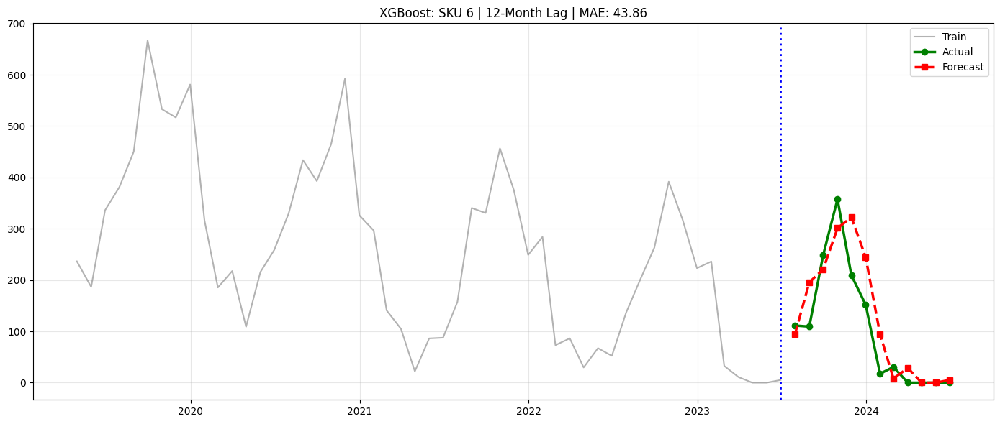

  SKU 7... MAE: 49.77 | RMSE: 58.44 | SMAPE: 78.72


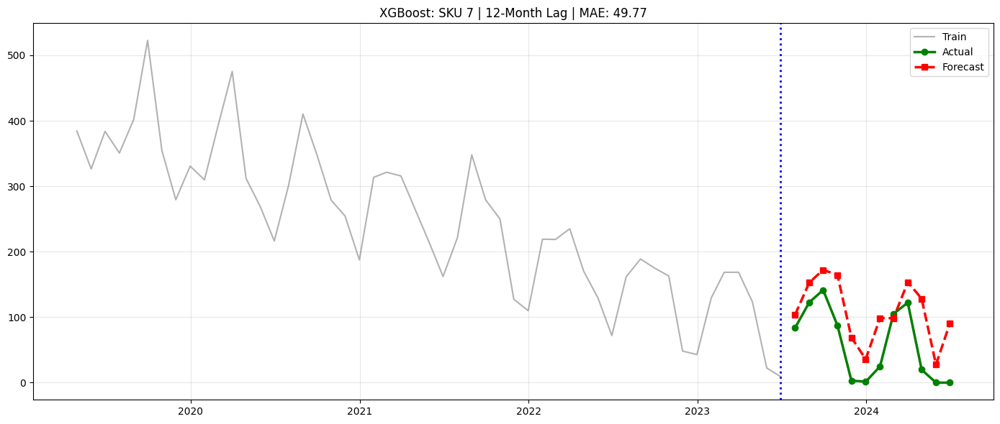

  SKU 8... MAE: 107.09 | RMSE: 134.02 | SMAPE: 13.09


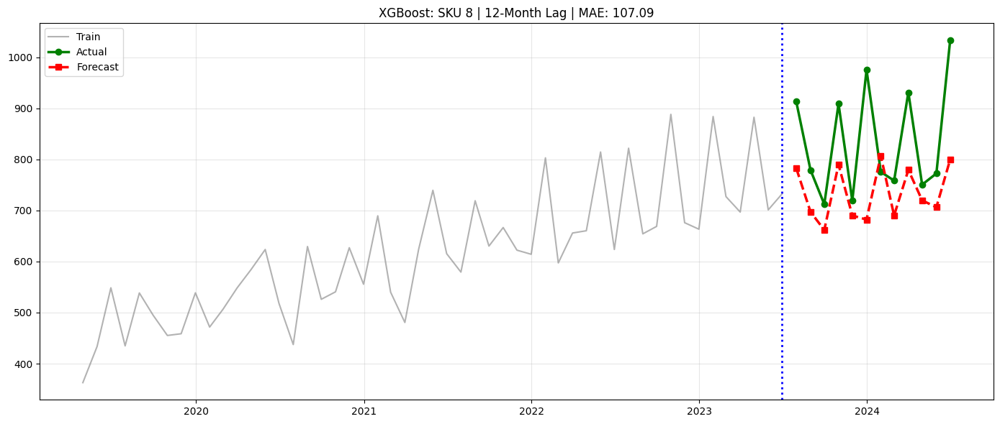

  SKU 9... MAE: 111.54 | RMSE: 140.88 | SMAPE: 13.64


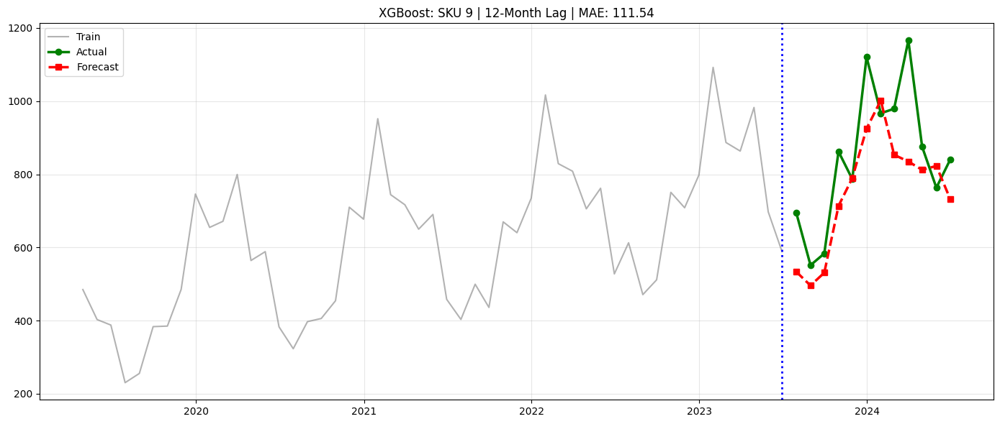

  SKU 10... MAE: 68.82 | RMSE: 76.89 | SMAPE: 96.75


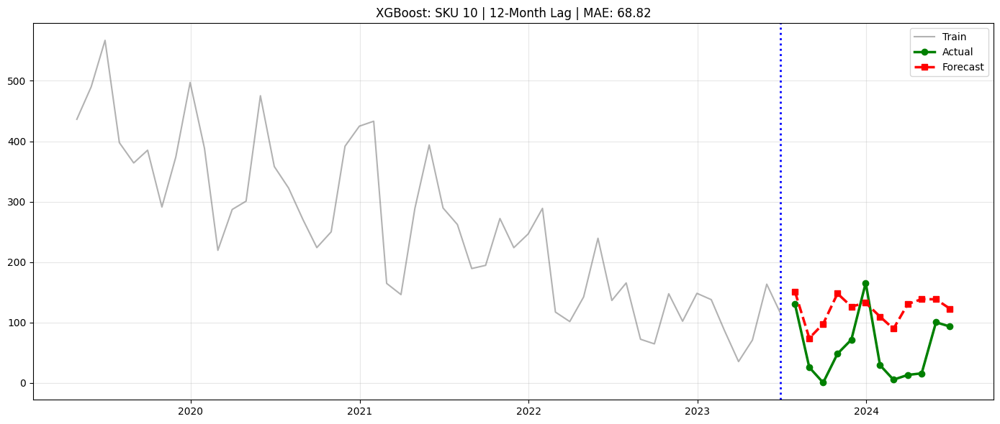


Total forecasts: 40
Average performance by lag:
              MAE    RMSE  SMAPE
Lag_Period                      
1           51.56   51.56  10.24
3           76.02   90.00  27.01
6           91.45  114.07  35.62
12          88.50  112.69  31.78


In [177]:
xgb_detailed, xgb_kpi_summary = evaluate_xgboost_lags(
    data_monthly=data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
)

Evaluating Lag Period: 1 months
  SKU 1... MAE: 12.55 | RMSE: 12.55 | SMAPE: 1.61


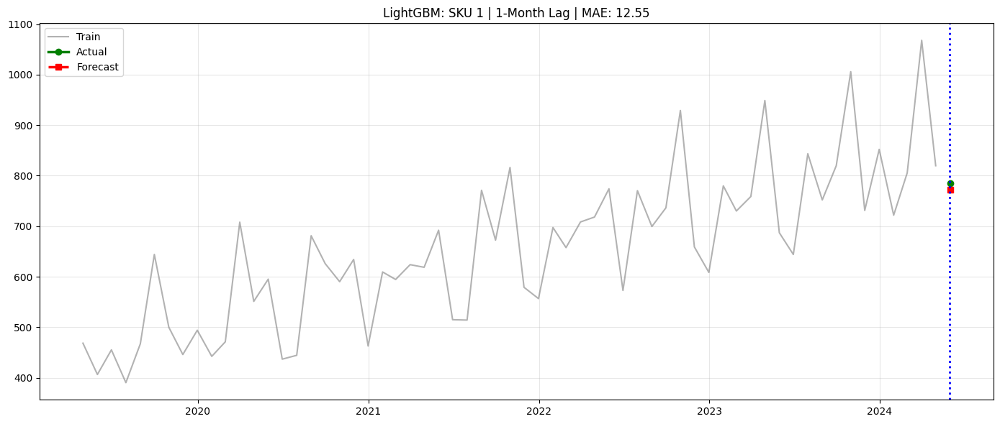

  SKU 2... MAE: 21.26 | RMSE: 21.26 | SMAPE: 2.64


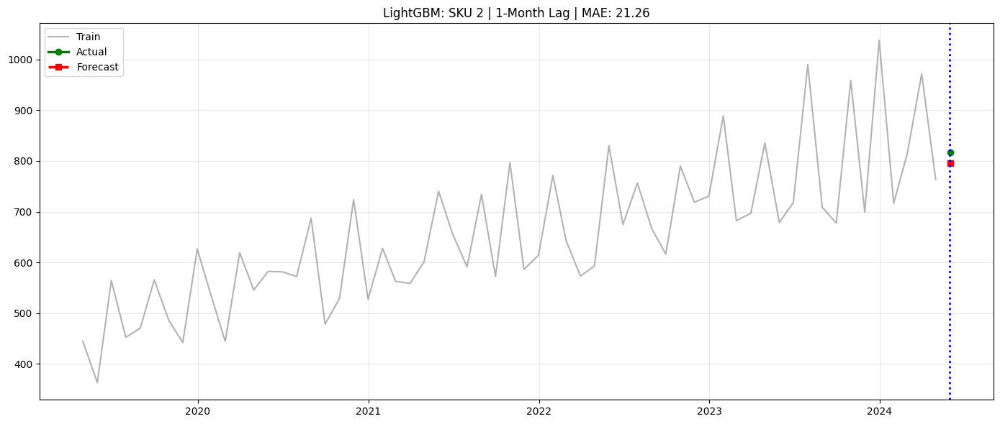

  SKU 3... MAE: 6.16 | RMSE: 6.16 | SMAPE: 1.02


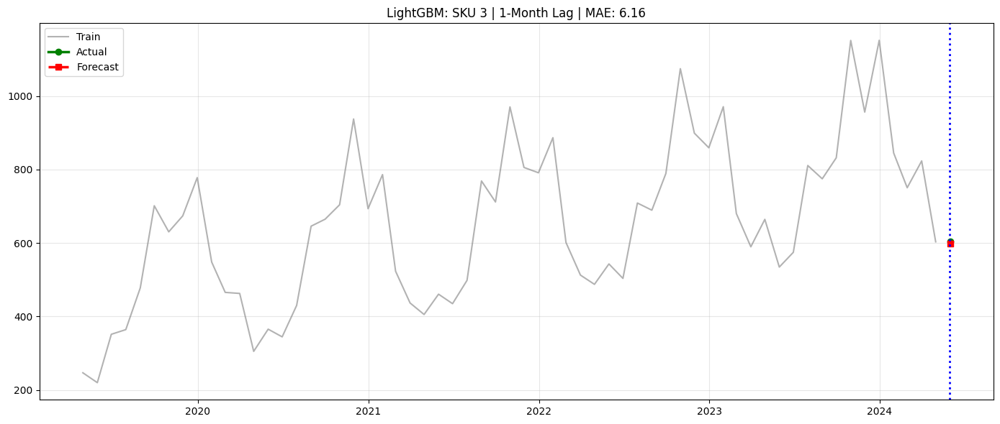

  SKU 4... MAE: 108.01 | RMSE: 108.01 | SMAPE: 12.79


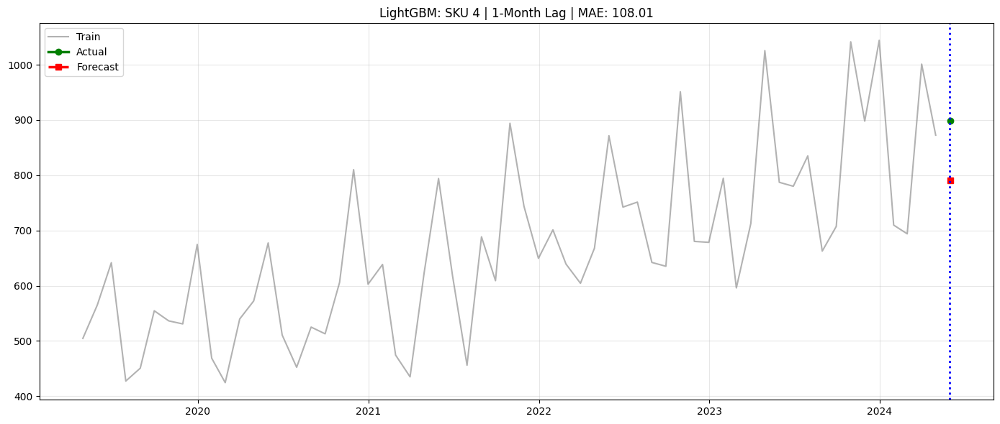

  SKU 5... MAE: 8.15 | RMSE: 8.15 | SMAPE: 1.03


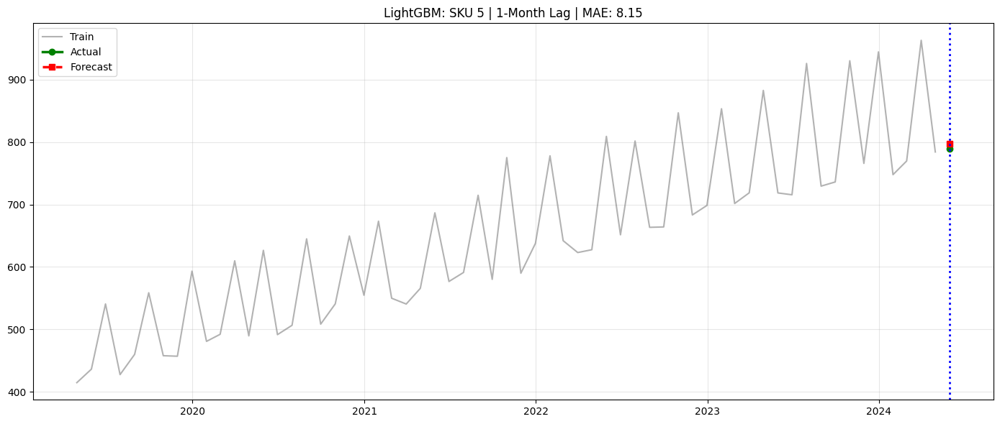

  SKU 6... MAE: 41.45 | RMSE: 41.45 | SMAPE: nan


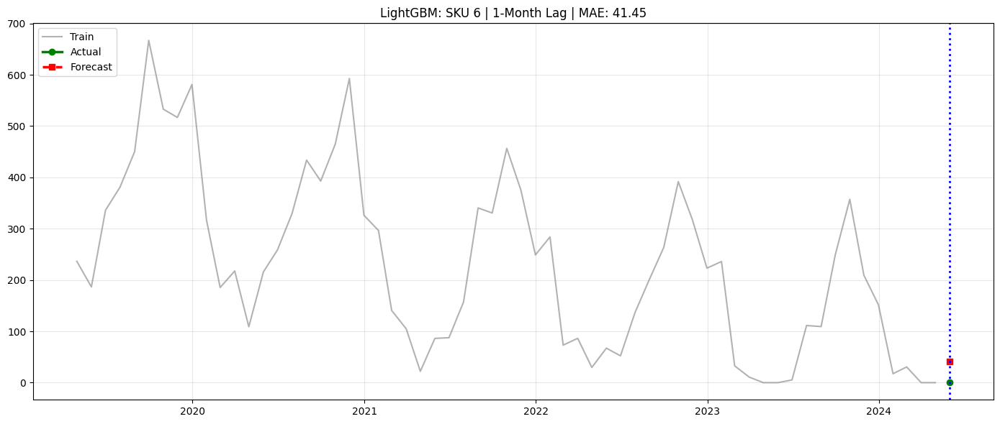

  SKU 7... MAE: 74.58 | RMSE: 74.58 | SMAPE: nan


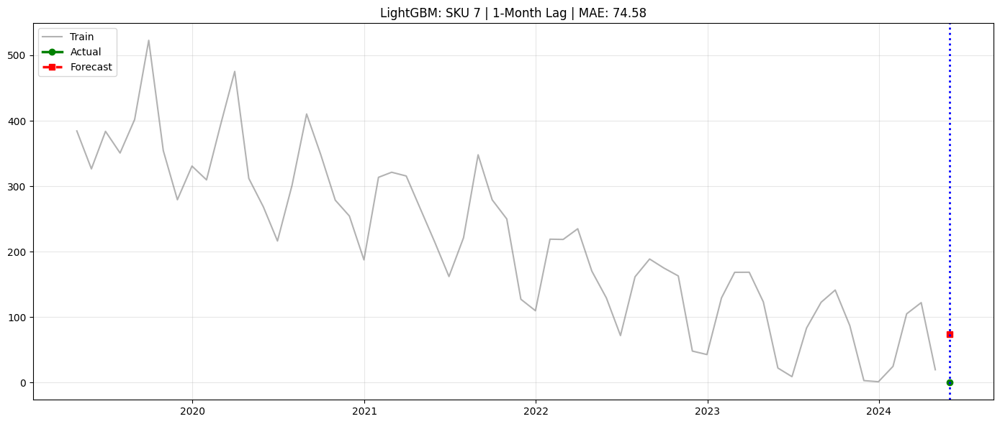

  SKU 8... MAE: 30.88 | RMSE: 30.88 | SMAPE: 3.92


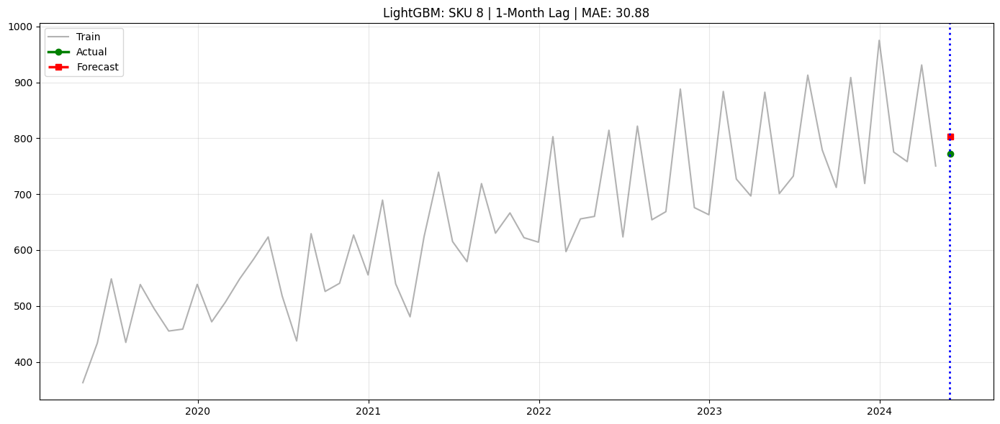

  SKU 9... MAE: 38.38 | RMSE: 38.38 | SMAPE: 5.16


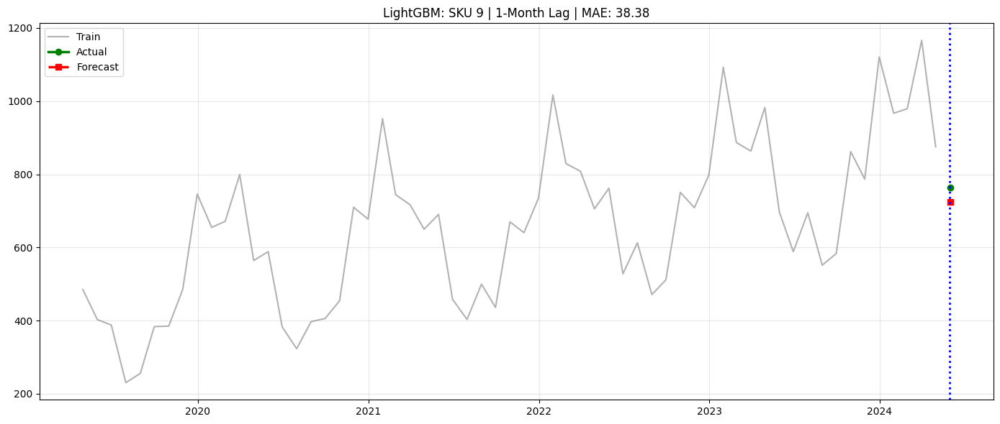

  SKU 10... MAE: 23.62 | RMSE: 23.62 | SMAPE: 21.04


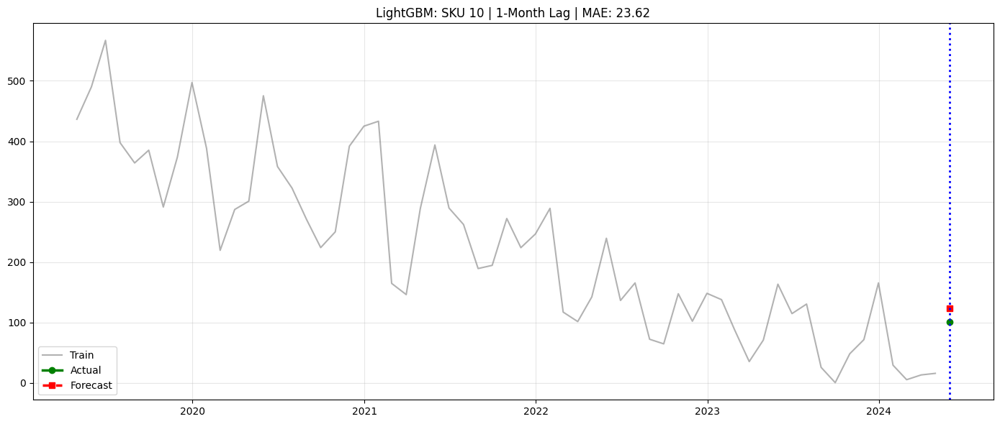

Evaluating Lag Period: 3 months
  SKU 1... MAE: 83.95 | RMSE: 138.55 | SMAPE: 8.93


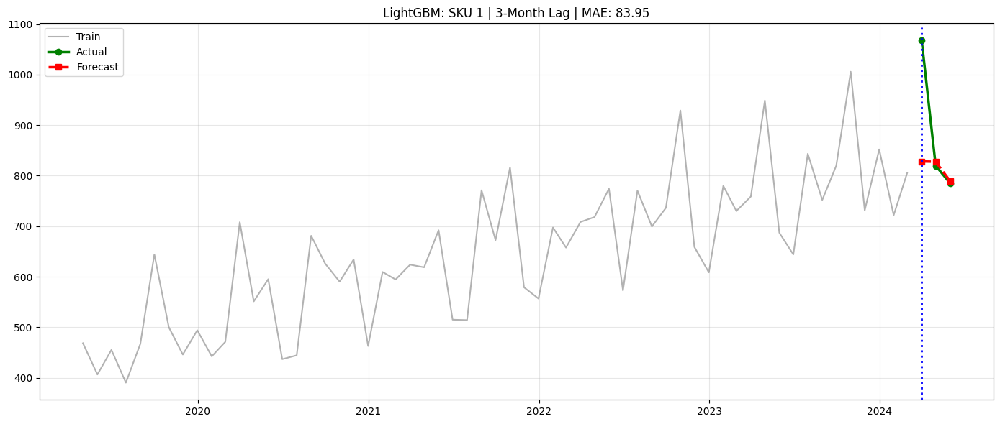

  SKU 2... MAE: 84.39 | RMSE: 118.17 | SMAPE: 9.89


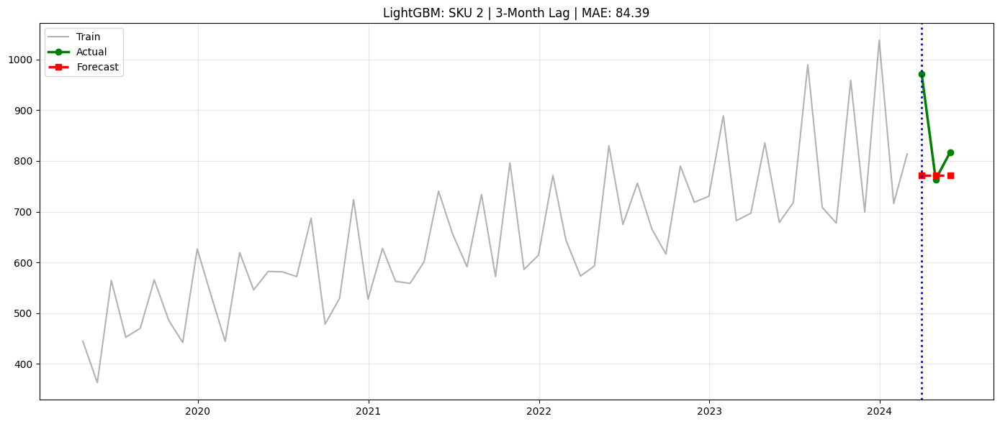

  SKU 3... MAE: 50.16 | RMSE: 54.52 | SMAPE: 7.27


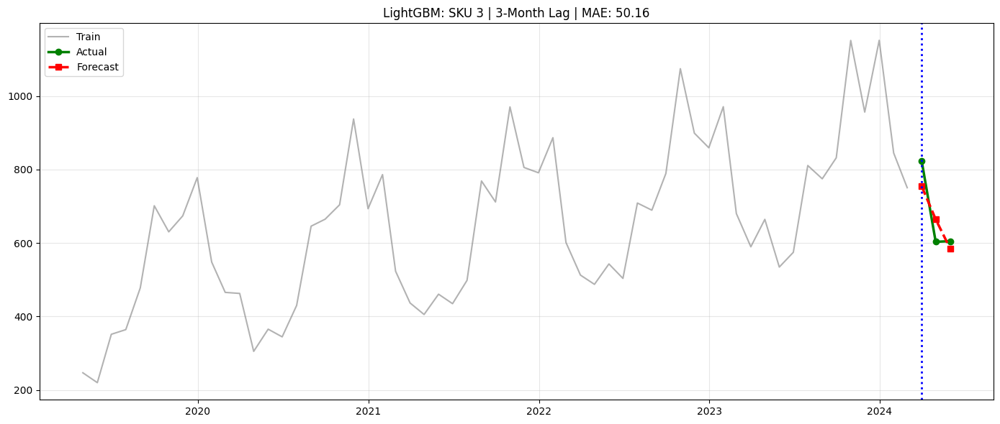

  SKU 4... MAE: 139.76 | RMSE: 150.86 | SMAPE: 16.17


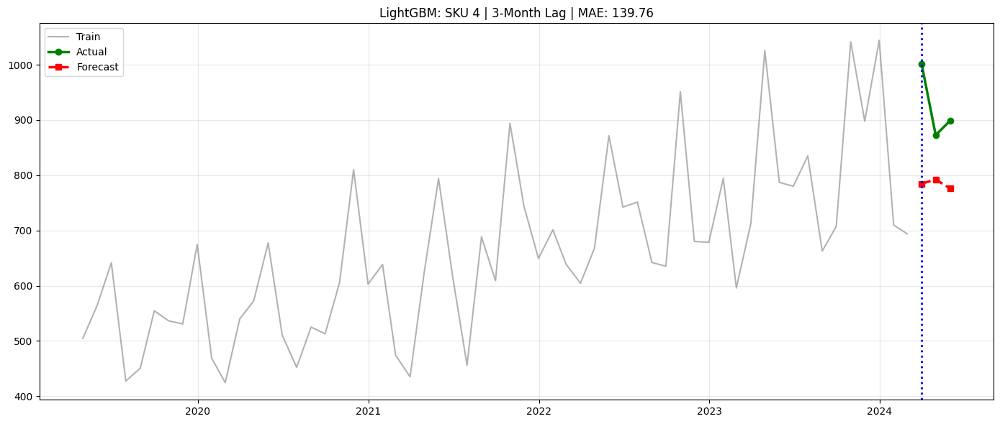

  SKU 5... MAE: 61.19 | RMSE: 102.88 | SMAPE: 7.03


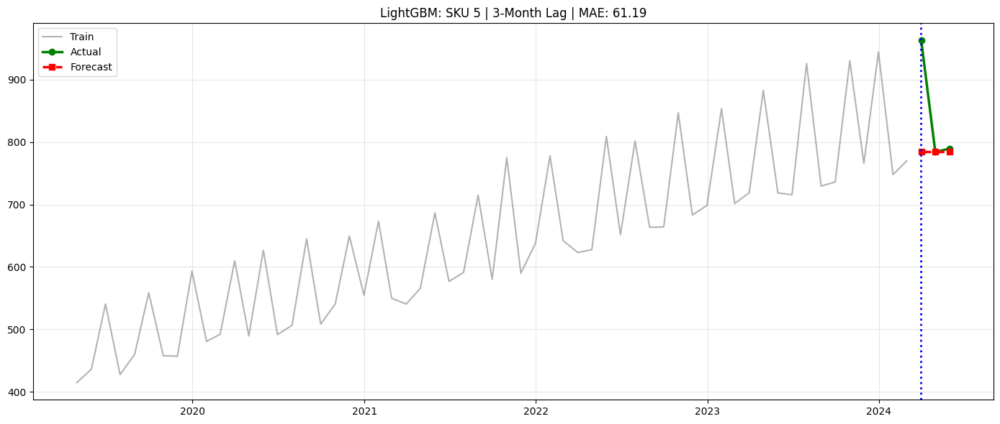

  SKU 6... MAE: 23.76 | RMSE: 26.21 | SMAPE: nan


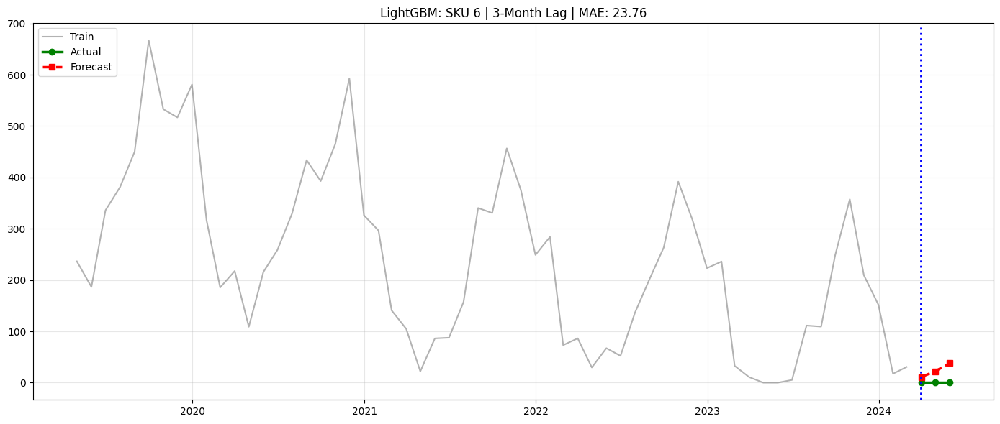

  SKU 7... MAE: 54.30 | RMSE: 62.53 | SMAPE: 66.33


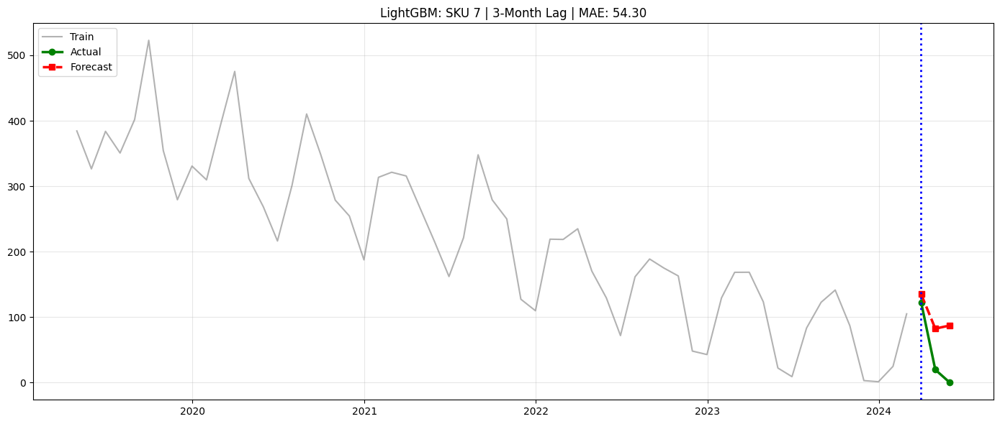

  SKU 8... MAE: 63.01 | RMSE: 94.78 | SMAPE: 7.53


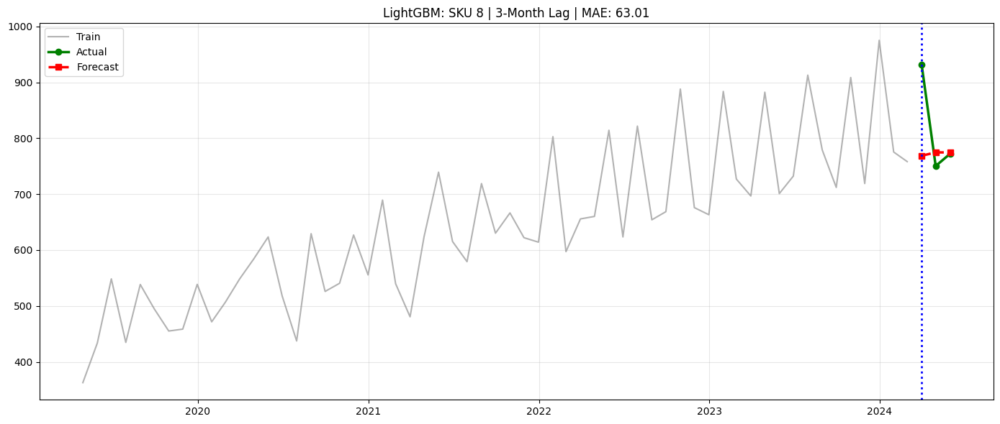

  SKU 9... MAE: 143.90 | RMSE: 191.39 | SMAPE: 15.21


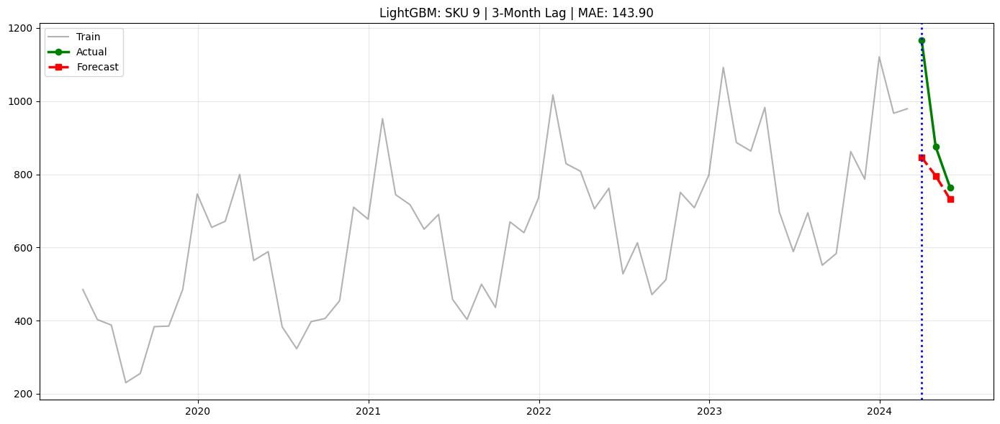

  SKU 10... MAE: 81.20 | RMSE: 88.07 | SMAPE: 113.90


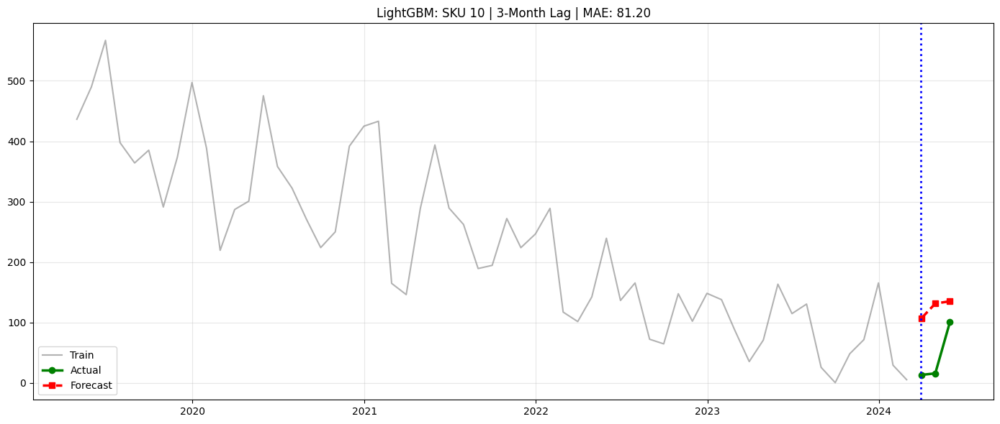

Evaluating Lag Period: 6 months
  SKU 1... MAE: 83.28 | RMSE: 122.95 | SMAPE: 9.78


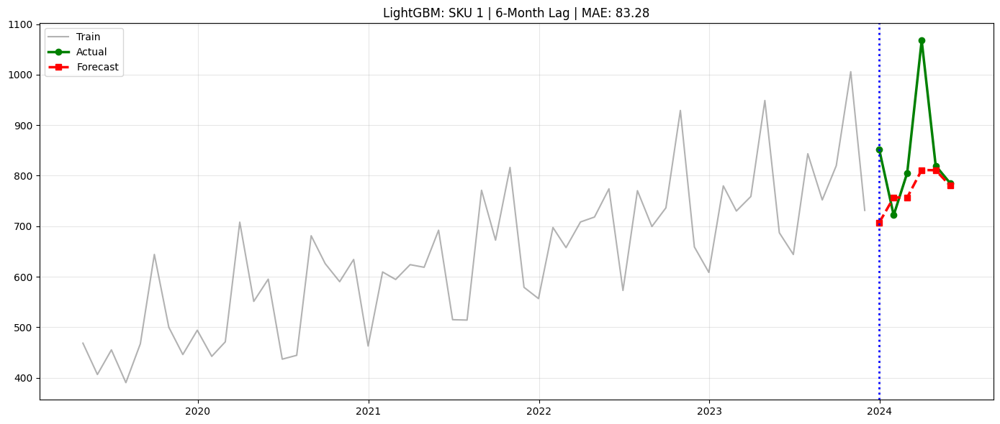

  SKU 2... MAE: 106.22 | RMSE: 145.09 | SMAPE: 12.41


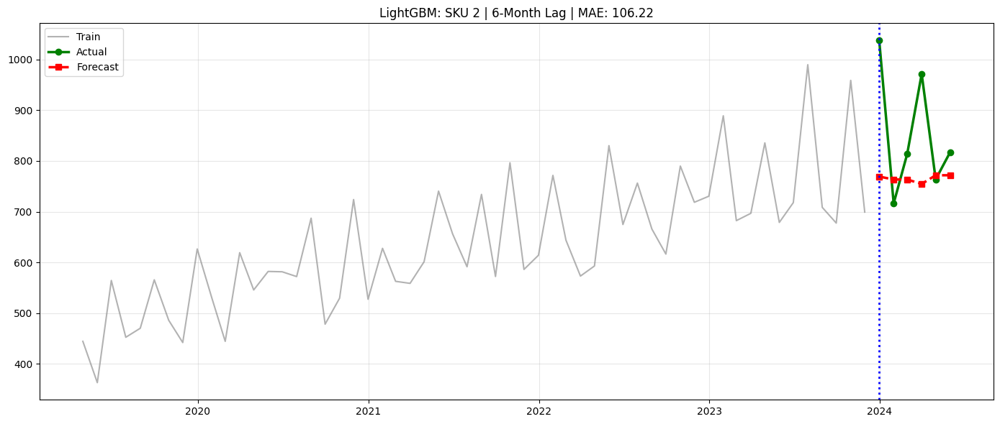

  SKU 3... MAE: 116.33 | RMSE: 156.19 | SMAPE: 14.00


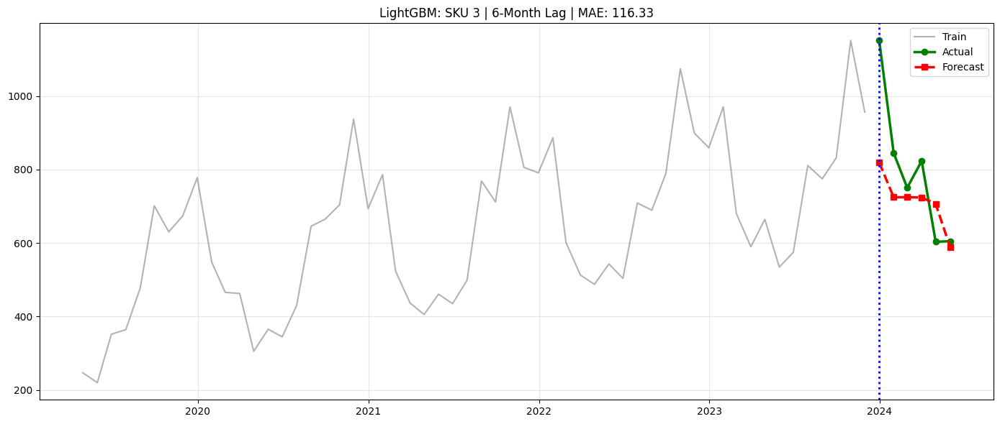

  SKU 4... MAE: 153.06 | RMSE: 171.49 | SMAPE: 18.12


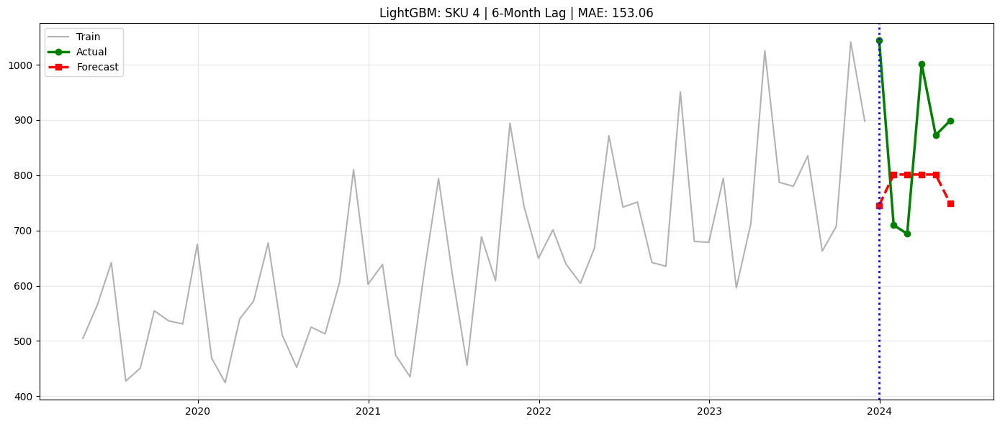

  SKU 5... MAE: 72.27 | RMSE: 107.94 | SMAPE: 8.54


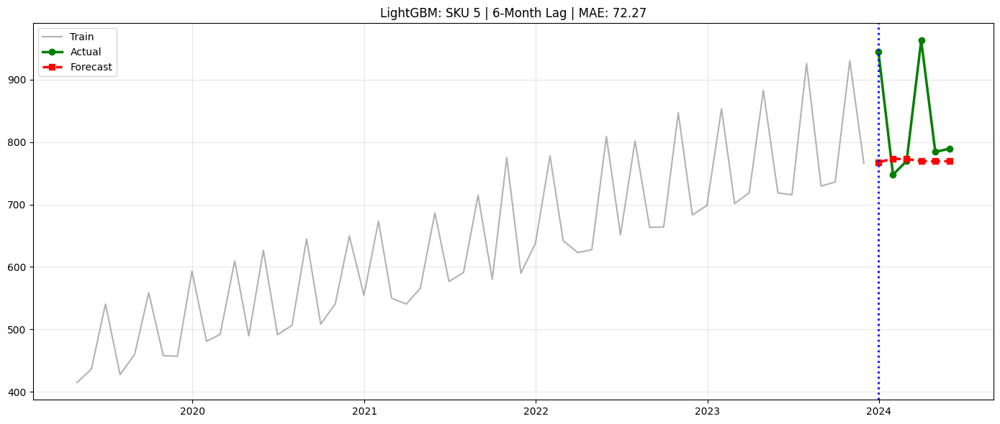

  SKU 6... MAE: 43.56 | RMSE: 51.24 | SMAPE: 123.85


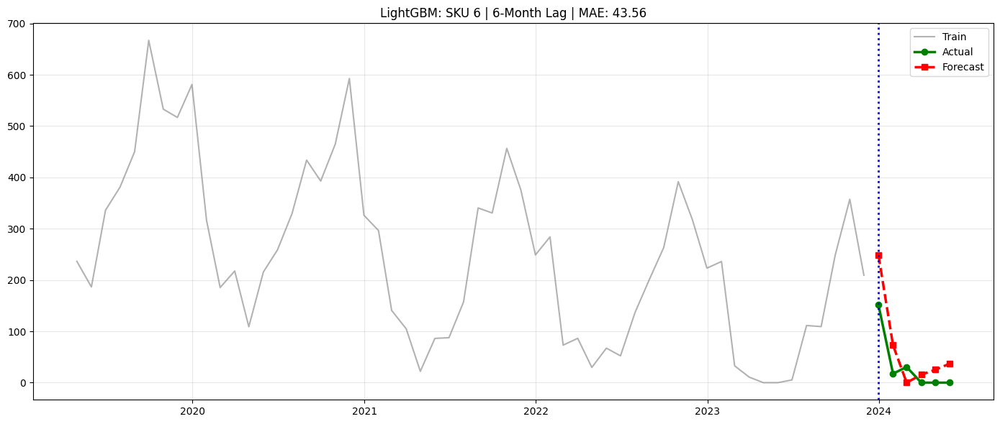

  SKU 7... MAE: 65.14 | RMSE: 75.58 | SMAPE: 95.36


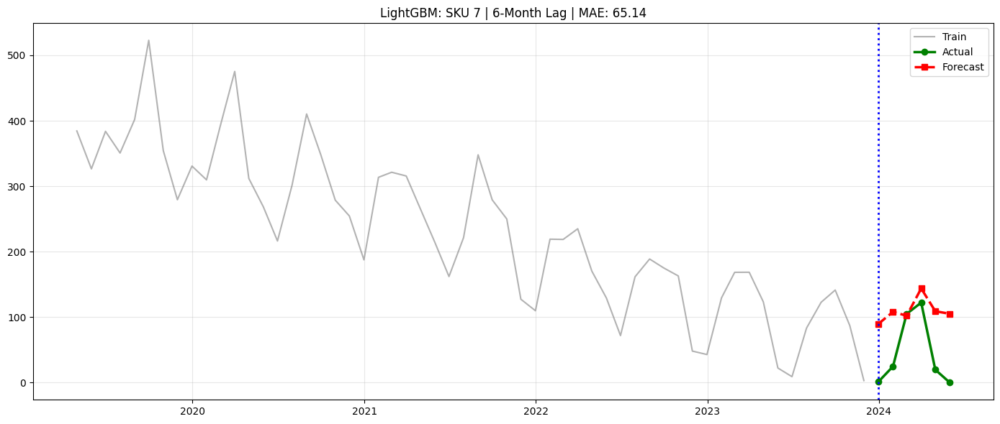

  SKU 8... MAE: 70.45 | RMSE: 111.37 | SMAPE: 8.30


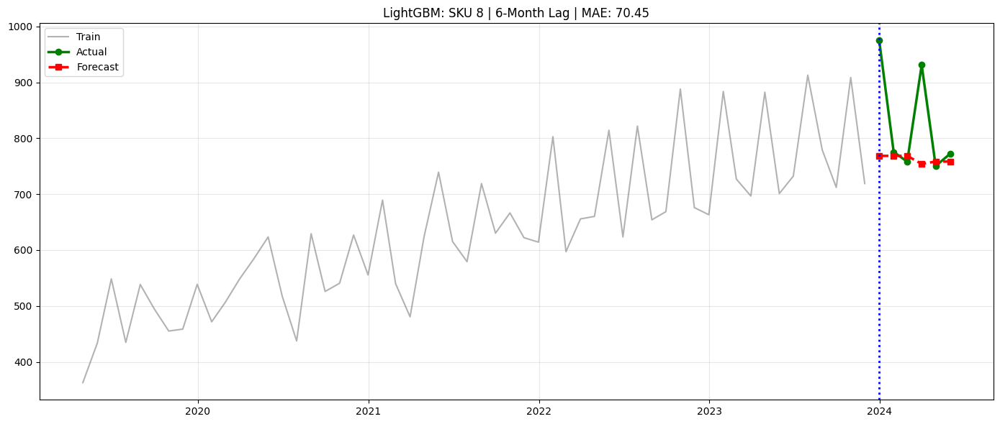

  SKU 9... MAE: 147.22 | RMSE: 184.16 | SMAPE: 15.56


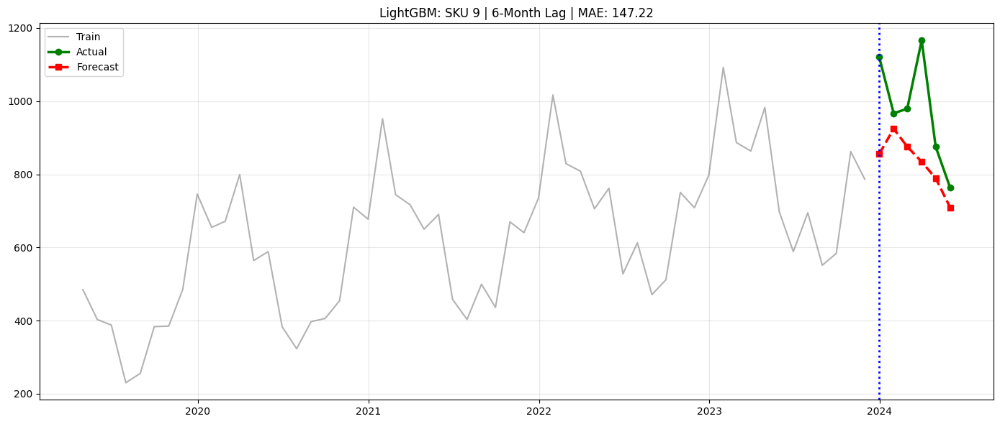

  SKU 10... MAE: 77.56 | RMSE: 83.21 | SMAPE: 111.73


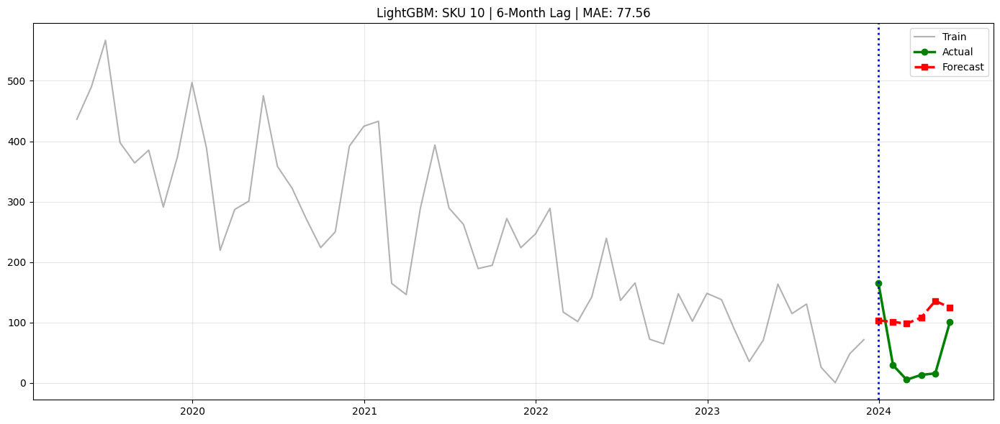

Evaluating Lag Period: 12 months
  SKU 1... MAE: 123.10 | RMSE: 160.71 | SMAPE: 15.14


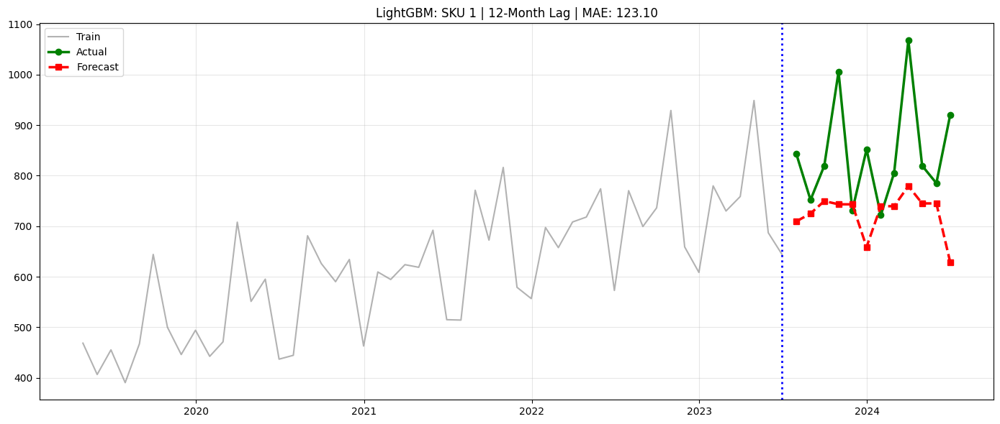

  SKU 2... MAE: 131.96 | RMSE: 174.63 | SMAPE: 15.91


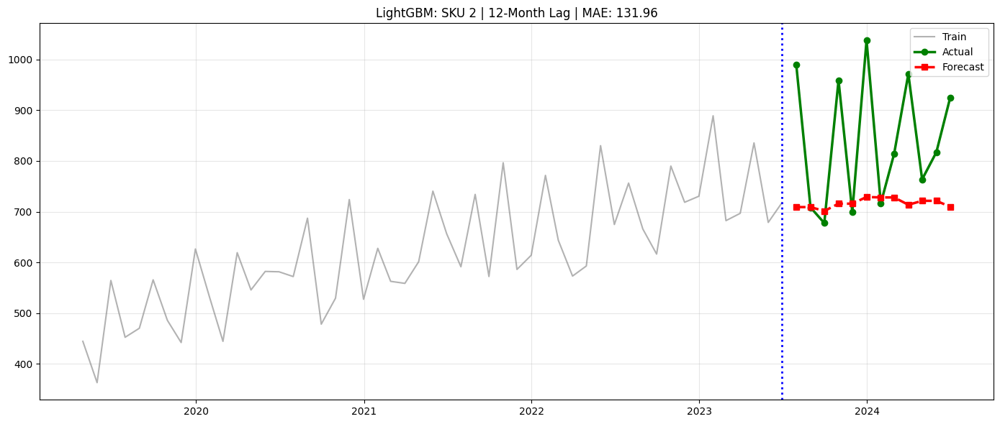

  SKU 3... MAE: 136.66 | RMSE: 167.43 | SMAPE: 16.74


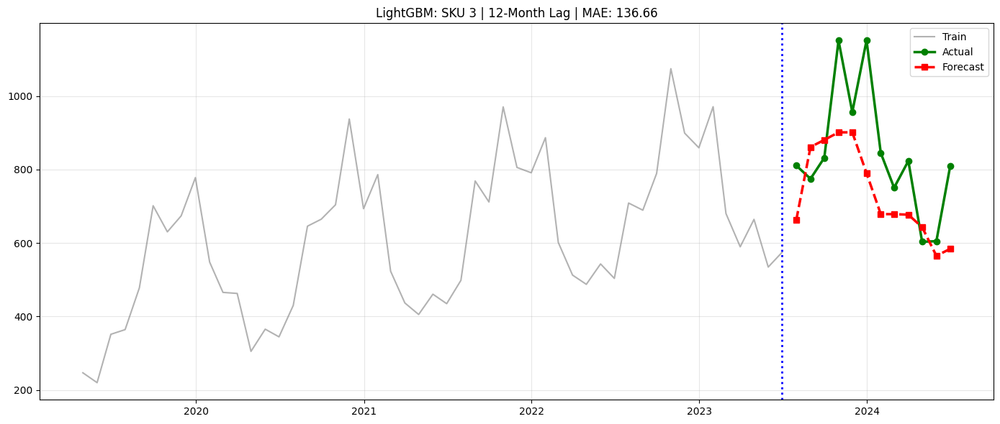

  SKU 4... MAE: 157.54 | RMSE: 190.48 | SMAPE: 18.89


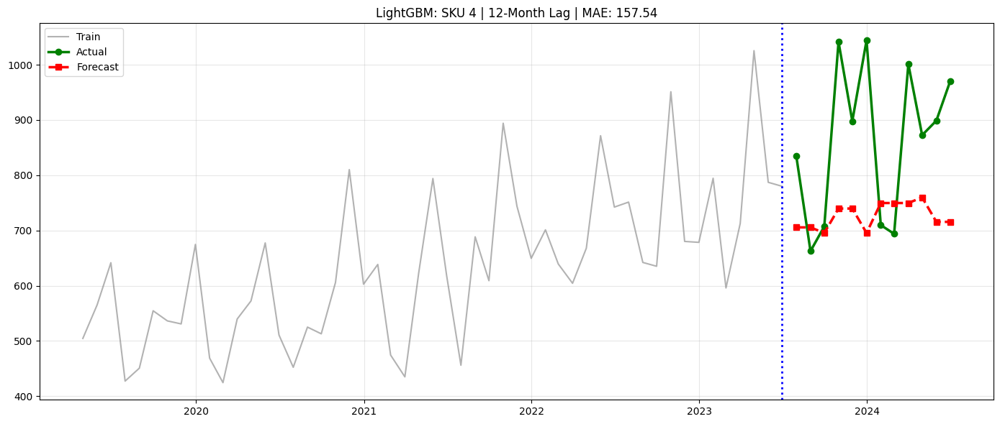

  SKU 5... MAE: 113.07 | RMSE: 150.97 | SMAPE: 13.70


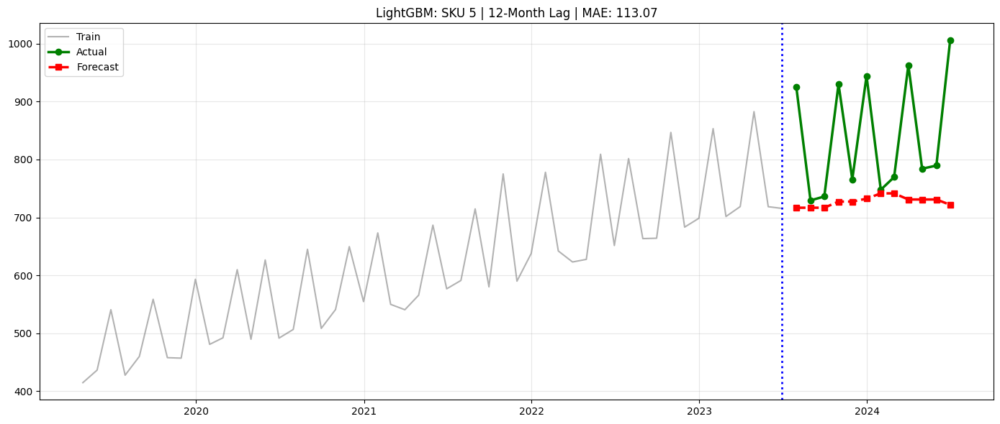

  SKU 6... MAE: 68.85 | RMSE: 81.17 | SMAPE: 54.34


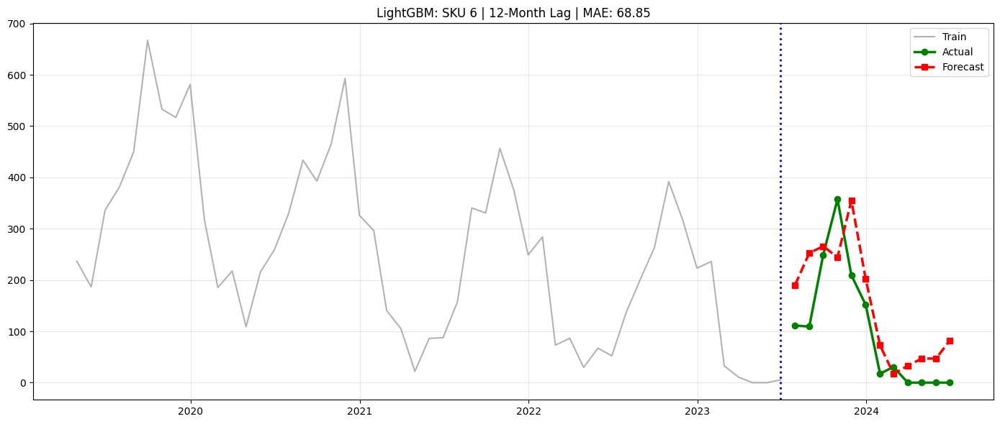

  SKU 7... MAE: 73.82 | RMSE: 84.84 | SMAPE: 83.66


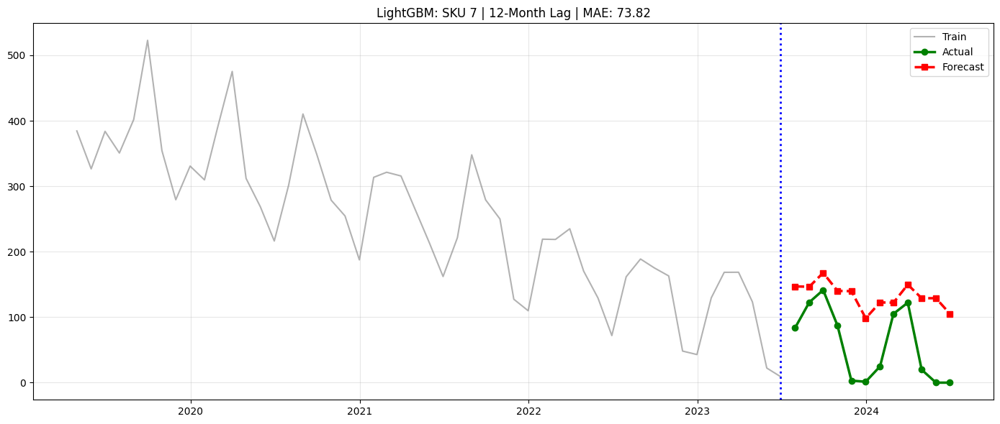

  SKU 8... MAE: 107.50 | RMSE: 152.37 | SMAPE: 12.95


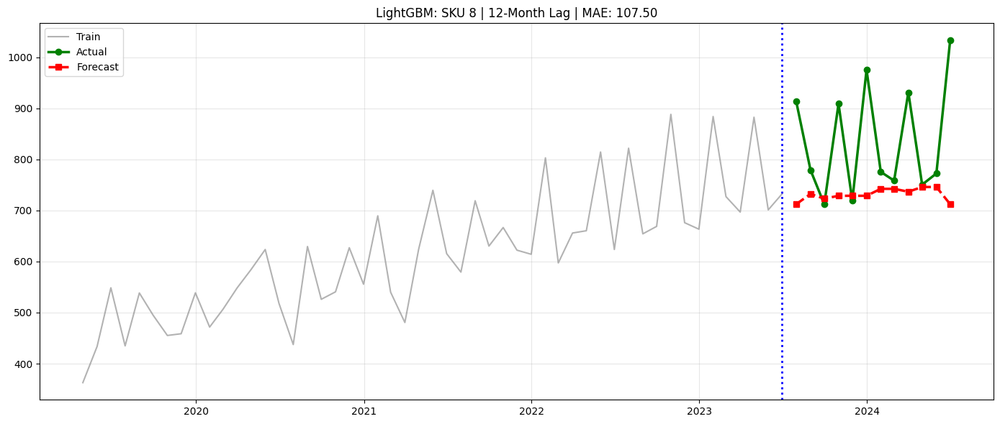

  SKU 9... MAE: 124.39 | RMSE: 157.97 | SMAPE: 15.14


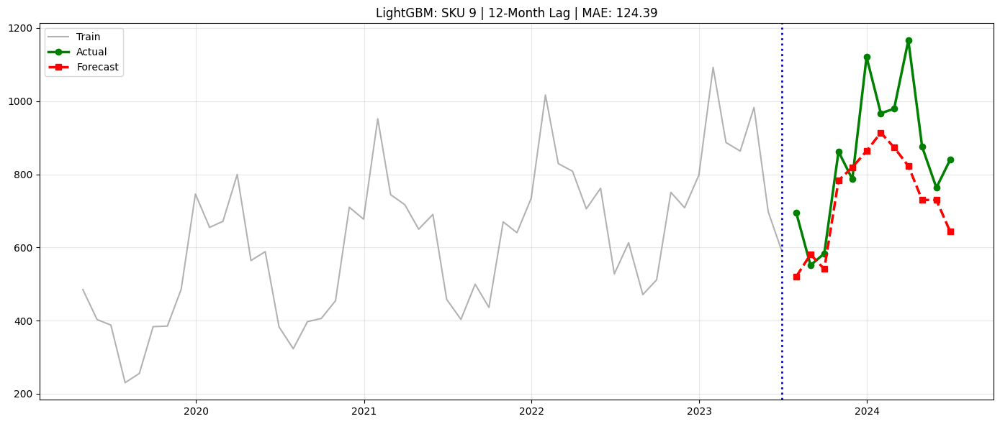

  SKU 10... MAE: 80.35 | RMSE: 92.10 | SMAPE: 100.38


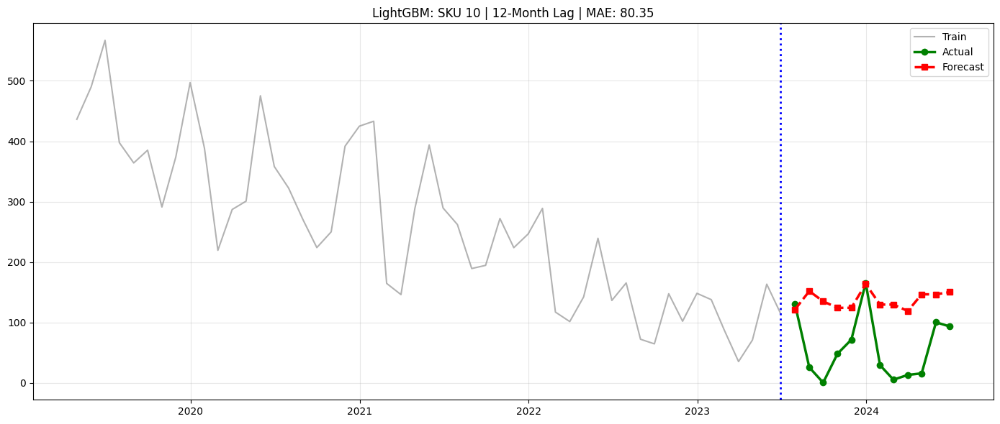


Total forecasts: 40
Average performance by lag:
               MAE    RMSE  SMAPE
Lag_Period                       
1            36.51   36.51   6.15
3            78.56  102.80  28.03
6            93.51  120.92  41.76
12          111.72  141.27  34.68


In [179]:
lgb_detailed, lgb_kpi_summary = evaluate_lightgbm_lags(
    data_monthly=data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
)

In [180]:
#lightgbm is bad

In [184]:
def evaluate_prophet_lags(
    data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
):
    from prophet import Prophet
    
    all_detailed_results = []
    all_kpi_summaries = []
    
    max_date = data_monthly['Date'].max()
    
    for lag in lag_periods:
        print(f"Evaluating Lag Period: {lag} months")
        
        train_end_date = max_date - pd.DateOffset(months=lag)
        
        train_data = data_monthly[data_monthly['Date'] <= train_end_date].copy()
        test_data = data_monthly[data_monthly['Date'] > train_end_date].copy()
        
        for sku in sorted(data_monthly['SKU_ID'].unique()):
            print(f"  SKU {sku}...", end=" ")
            
            train_sku = train_data[train_data['SKU_ID'] == sku].copy()
            test_sku = test_data[test_data['SKU_ID'] == sku].copy()
            
            test_sku = test_sku.head(lag)
            
            if len(train_sku) < 24 or len(test_sku) != lag:
                print(f"Skip (train: {len(train_sku)}, test: {len(test_sku)})")
                continue
            
            train_prophet = train_sku[['Date', 'Monthly_Sales']].rename(columns={'Date':'ds', 'Monthly_Sales':'y'})
            test_prophet = test_sku[['Date', 'Monthly_Sales']].rename(columns={'Date':'ds', 'Monthly_Sales':'y'})
            
            try:
                m = Prophet(
                    yearly_seasonality=True,
                    weekly_seasonality=False,
                    daily_seasonality=False,
                    seasonality_mode='additive',
                    changepoint_prior_scale=0.1
                )
                m.fit(train_prophet)
                
                future = m.make_future_dataframe(periods=lag, freq='M')
                forecast = m.predict(future)
                
                forecast_test = pd.merge(
                    test_prophet[['ds', 'y']],
                    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']],
                    on='ds', how='inner'
                )
                preds = forecast_test['yhat'].values
                y_true = forecast_test['y'].values
                
                kpis = calculate_forecast_kpis(
                    actual=y_true,
                    predicted=preds
                )
                
                detailed_df = pd.DataFrame({
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'Prophet',
                    'Date': test_prophet['ds'].values,
                    'Actual': y_true,
                    'Forecast': preds,
                    'CI_Lower': forecast_test['yhat_lower'].values,
                    'CI_Upper': forecast_test['yhat_upper'].values,
                    'Error': y_true - preds,
                    'Abs_Error': np.abs(y_true - preds)
                })
                all_detailed_results.append(detailed_df)
                
                kpi_summary = {
                    'SKU_ID': sku,
                    'Lag_Period': lag,
                    'Model': 'Prophet',
                    'Train_Months': len(train_sku),
                    'Test_Months': len(test_sku),
                    'Train_End': train_end_date.strftime('%Y-%m'),
                    'Forecast_Start': test_sku['Date'].min().strftime('%Y-%m'),
                    'Forecast_End': test_sku['Date'].max().strftime('%Y-%m'),
                    **kpis
                }
                all_kpi_summaries.append(kpi_summary)
                
                print(f"MAE: {kpis['MAE']:.2f} | RMSE: {kpis['RMSE']:.2f} | SMAPE: {kpis['SMAPE']:.2f}")
                
                if plot_forecasts:
                    plt.figure(figsize=(14, 6))
                    plt.plot(train_prophet['ds'], train_prophet['y'], 
                            label='Train', color='gray', alpha=0.6)
                    plt.plot(test_prophet['ds'], y_true, 
                            label='Actual', color='green', linewidth=2.5, marker='o')
                    plt.plot(test_prophet['ds'], preds, 
                            label='Forecast', color='red', linewidth=2.5, linestyle='--', marker='s')
                    plt.fill_between(test_prophet['ds'], 
                                   forecast_test['yhat_lower'].values,
                                   forecast_test['yhat_upper'].values,
                                   color='orange', alpha=0.2, label='CI')
                    plt.axvline(train_end_date, color='blue', linestyle=':', linewidth=2)
                    plt.title(f"Prophet: SKU {sku} | {lag}-Month Lag | MAE: {kpis['MAE']:.2f}")
                    plt.legend()
                    plt.grid(alpha=0.3)
                    plt.tight_layout()
                    plt.show()
                    
            except Exception as e:
                print(f"Error: {e}")
                continue
    
    if len(all_detailed_results) == 0:
        return pd.DataFrame(), pd.DataFrame()
    
    detailed_df = pd.concat(all_detailed_results, ignore_index=True)
    kpi_summary_df = pd.DataFrame(all_kpi_summaries)
    
    if save_results:
        detailed_df.to_csv('prophet_detailed_forecasts.csv', index=False)
        kpi_summary_df.to_csv('prophet_kpi_summary.csv', index=False)
    
    print(f"\nTotal forecasts: {len(all_detailed_results)}")
    print(f"Average performance by lag:")
    print(kpi_summary_df.groupby('Lag_Period')[['MAE', 'RMSE', 'SMAPE']].mean().round(2))
    
    return detailed_df, kpi_summary_df


00:07:55 - cmdstanpy - INFO - Chain [1] start processing
00:07:55 - cmdstanpy - INFO - Chain [1] done processing


Evaluating Lag Period: 1 months
  SKU 1... MAE: 155.77 | RMSE: 155.77 | SMAPE: 18.05


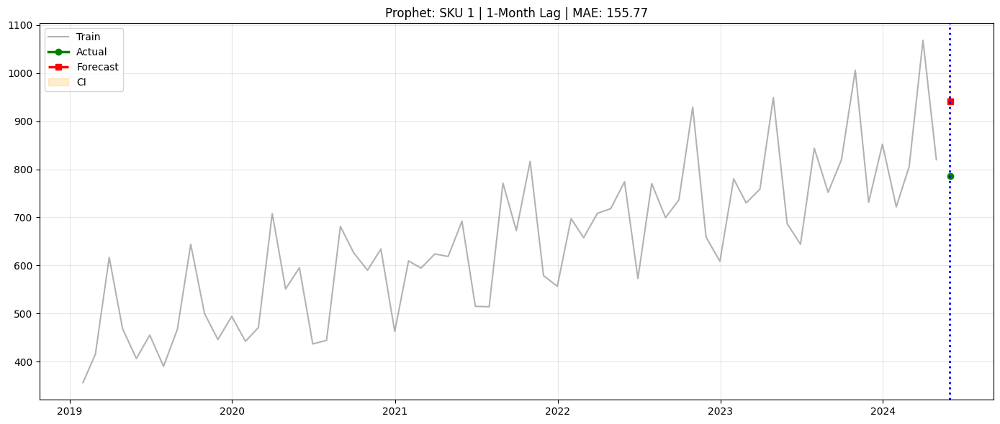

00:07:55 - cmdstanpy - INFO - Chain [1] start processing
00:07:55 - cmdstanpy - INFO - Chain [1] done processing


  SKU 2... MAE: 105.34 | RMSE: 105.34 | SMAPE: 12.11


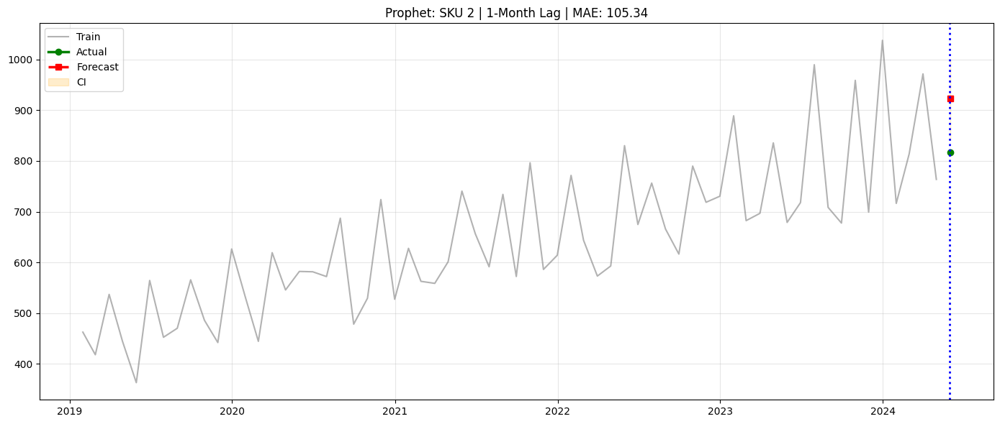

00:07:55 - cmdstanpy - INFO - Chain [1] start processing
00:07:55 - cmdstanpy - INFO - Chain [1] done processing


  SKU 3... MAE: 108.19 | RMSE: 108.19 | SMAPE: 16.41


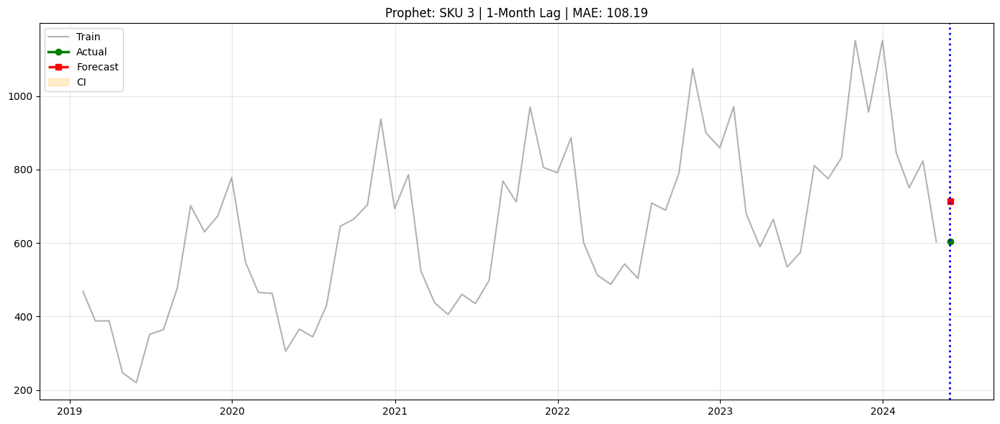

00:07:56 - cmdstanpy - INFO - Chain [1] start processing
00:07:56 - cmdstanpy - INFO - Chain [1] done processing


  SKU 4... MAE: 154.64 | RMSE: 154.64 | SMAPE: 15.84


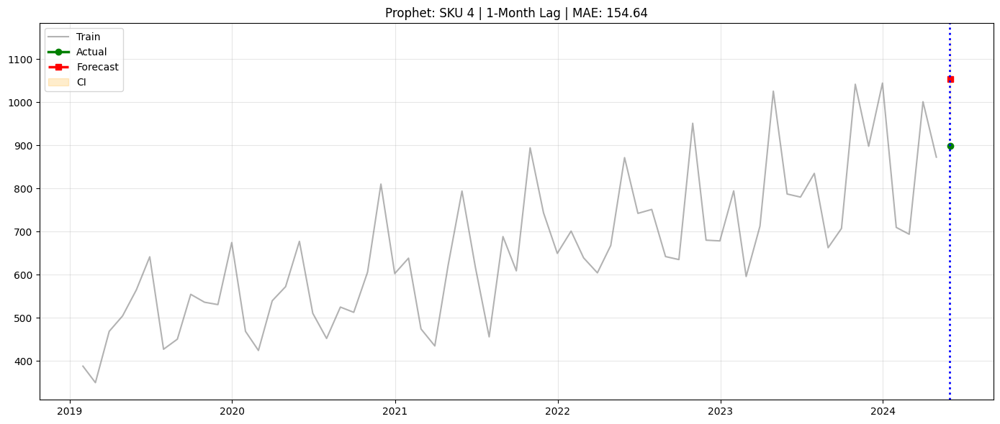

00:07:56 - cmdstanpy - INFO - Chain [1] start processing
00:07:56 - cmdstanpy - INFO - Chain [1] done processing


  SKU 5... MAE: 175.05 | RMSE: 175.05 | SMAPE: 19.96


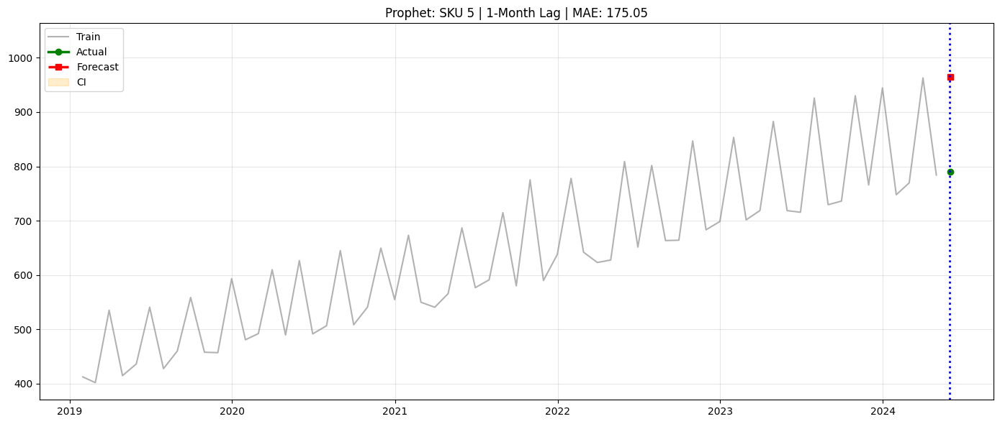

00:07:56 - cmdstanpy - INFO - Chain [1] start processing


  SKU 6... 

00:07:56 - cmdstanpy - INFO - Chain [1] done processing


MAE: 55.80 | RMSE: 55.80 | SMAPE: nan


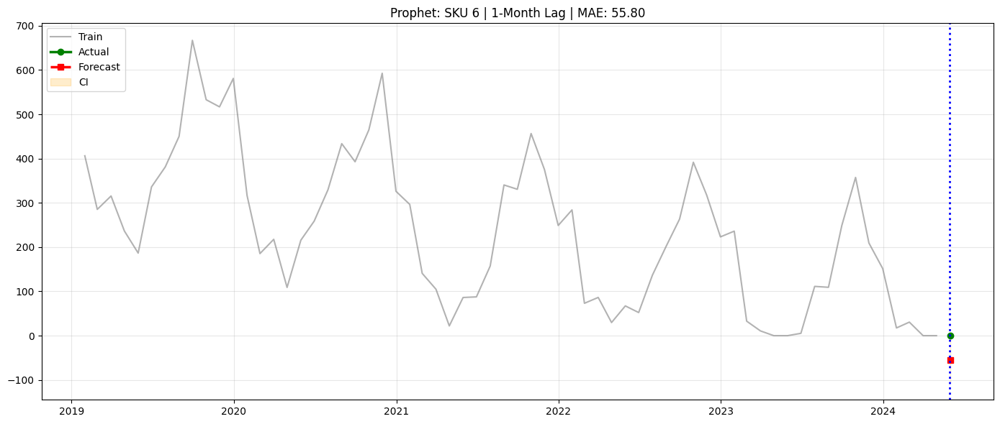

00:07:56 - cmdstanpy - INFO - Chain [1] start processing


  SKU 7... 

00:07:57 - cmdstanpy - INFO - Chain [1] done processing


MAE: 24.35 | RMSE: 24.35 | SMAPE: nan


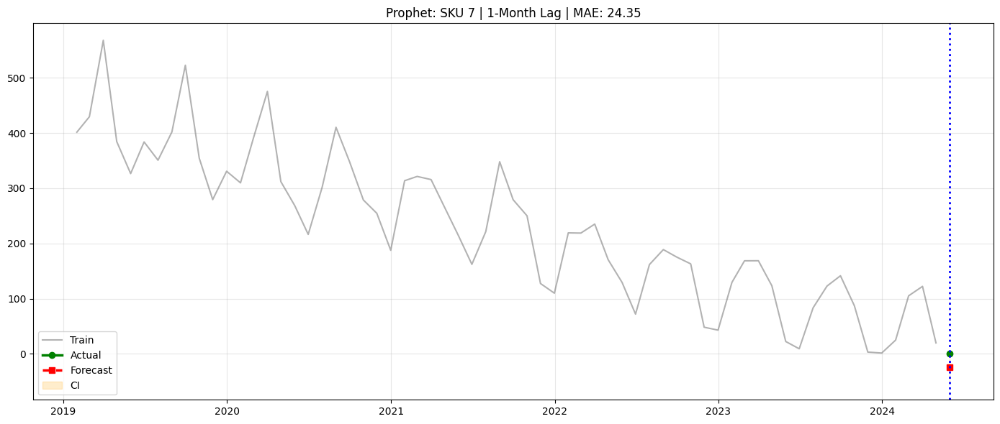

00:07:57 - cmdstanpy - INFO - Chain [1] start processing
00:07:57 - cmdstanpy - INFO - Chain [1] done processing


  SKU 8... MAE: 218.46 | RMSE: 218.46 | SMAPE: 24.78


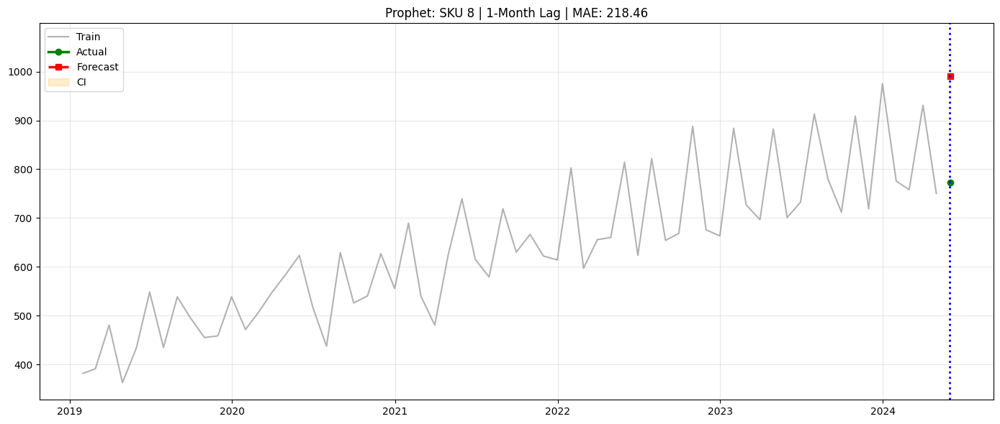

00:07:57 - cmdstanpy - INFO - Chain [1] start processing
00:07:57 - cmdstanpy - INFO - Chain [1] done processing


  SKU 9... MAE: 174.72 | RMSE: 174.72 | SMAPE: 20.54


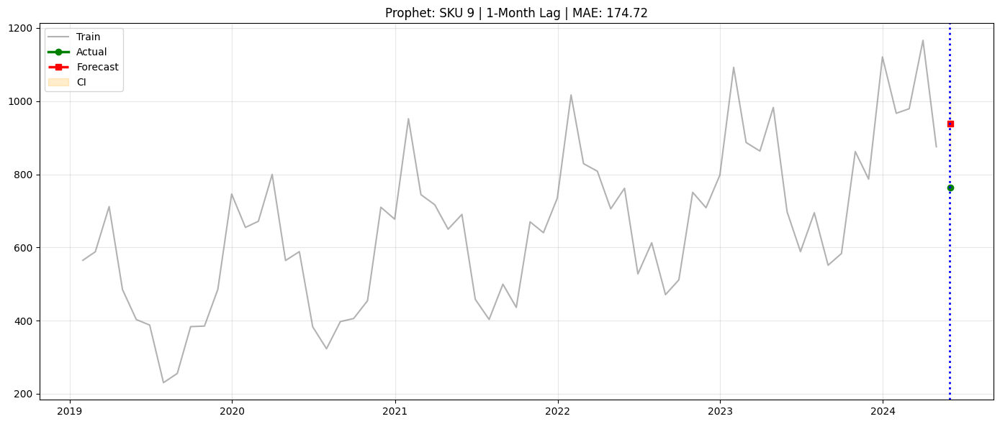

00:07:58 - cmdstanpy - INFO - Chain [1] start processing


  SKU 10... 

00:07:58 - cmdstanpy - INFO - Chain [1] done processing


MAE: 69.81 | RMSE: 69.81 | SMAPE: 51.57


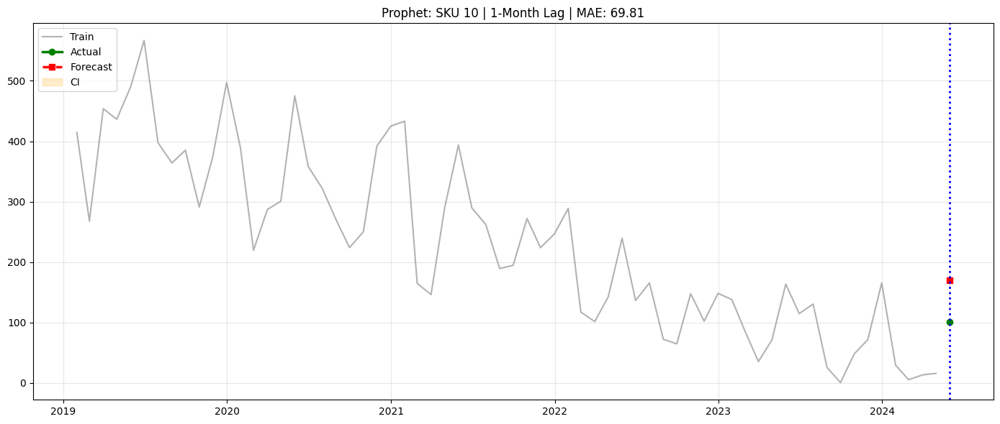

00:07:58 - cmdstanpy - INFO - Chain [1] start processing


Evaluating Lag Period: 3 months
  SKU 1... 

00:07:58 - cmdstanpy - INFO - Chain [1] done processing


MAE: 97.40 | RMSE: 115.42 | SMAPE: 10.62


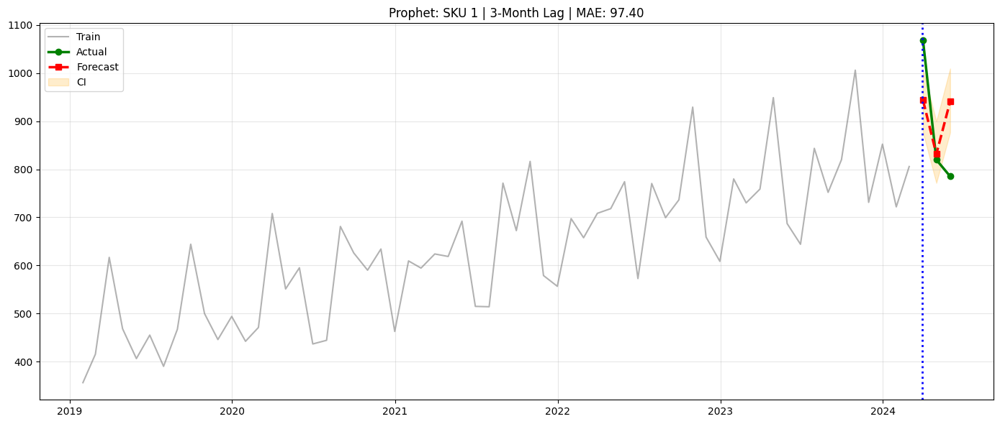

00:07:58 - cmdstanpy - INFO - Chain [1] start processing


  SKU 2... 

00:07:58 - cmdstanpy - INFO - Chain [1] done processing


MAE: 89.99 | RMSE: 105.66 | SMAPE: 10.24


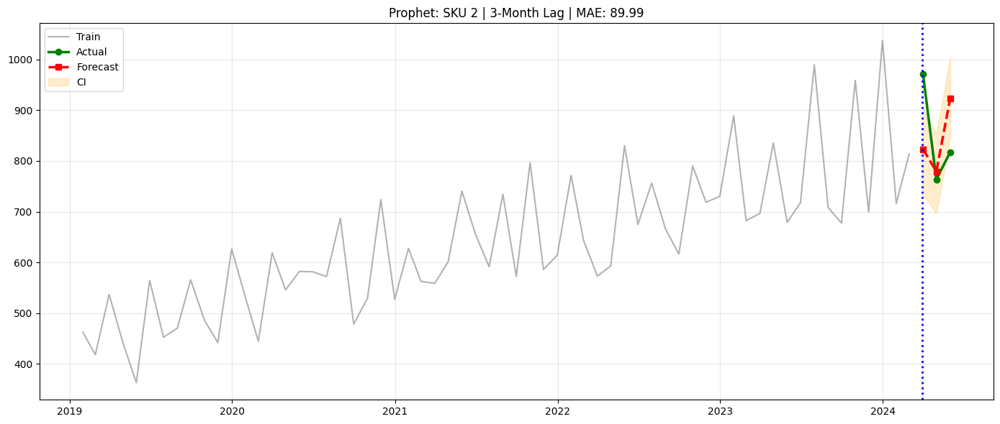

00:07:58 - cmdstanpy - INFO - Chain [1] start processing


  SKU 3... 

00:07:59 - cmdstanpy - INFO - Chain [1] done processing


MAE: 73.10 | RMSE: 85.06 | SMAPE: 10.39


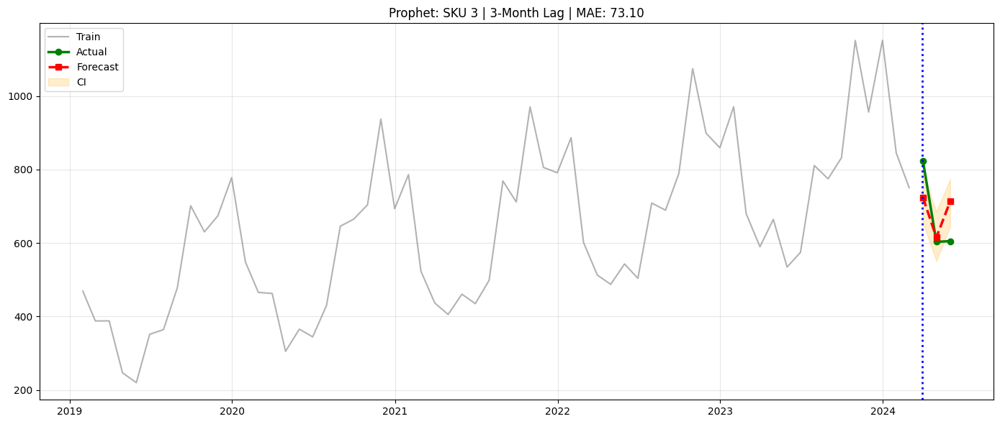

00:07:59 - cmdstanpy - INFO - Chain [1] start processing


  SKU 4... 

00:07:59 - cmdstanpy - INFO - Chain [1] done processing


MAE: 132.98 | RMSE: 158.11 | SMAPE: 14.46


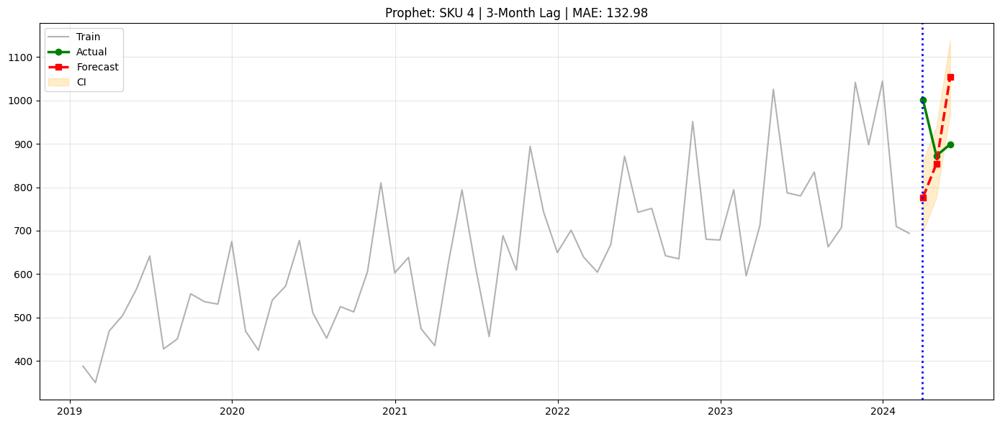

00:07:59 - cmdstanpy - INFO - Chain [1] start processing


  SKU 5... 

00:07:59 - cmdstanpy - INFO - Chain [1] done processing


MAE: 102.16 | RMSE: 122.68 | SMAPE: 11.57


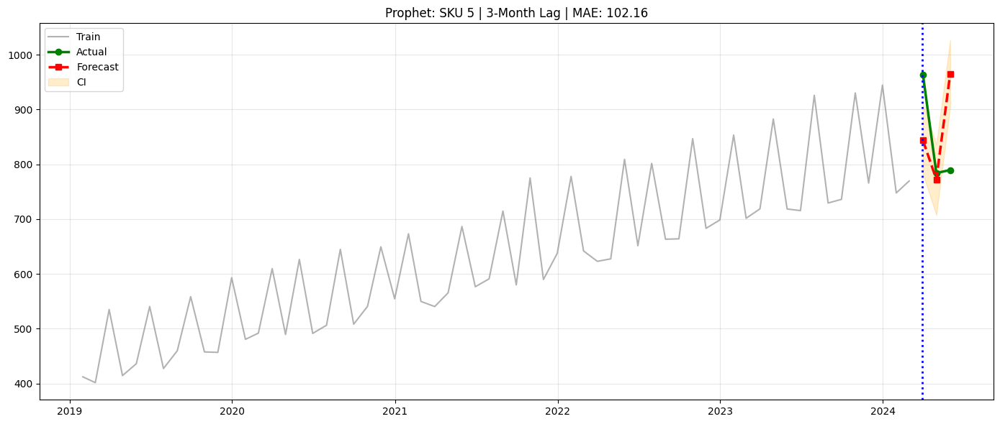

00:07:59 - cmdstanpy - INFO - Chain [1] start processing


  SKU 6... 

00:08:00 - cmdstanpy - INFO - Chain [1] done processing


MAE: 103.47 | RMSE: 115.33 | SMAPE: nan


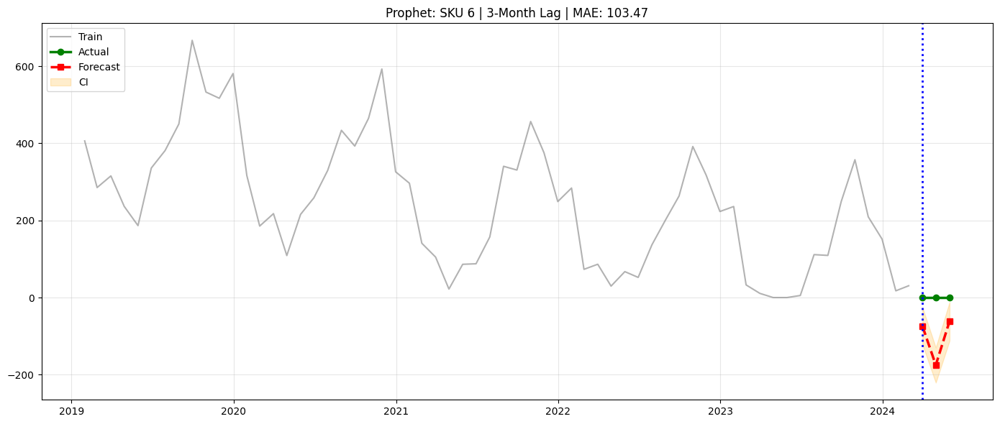

00:08:00 - cmdstanpy - INFO - Chain [1] start processing


  SKU 7... 

00:08:00 - cmdstanpy - INFO - Chain [1] done processing


MAE: 13.82 | RMSE: 16.61 | SMAPE: 44.92


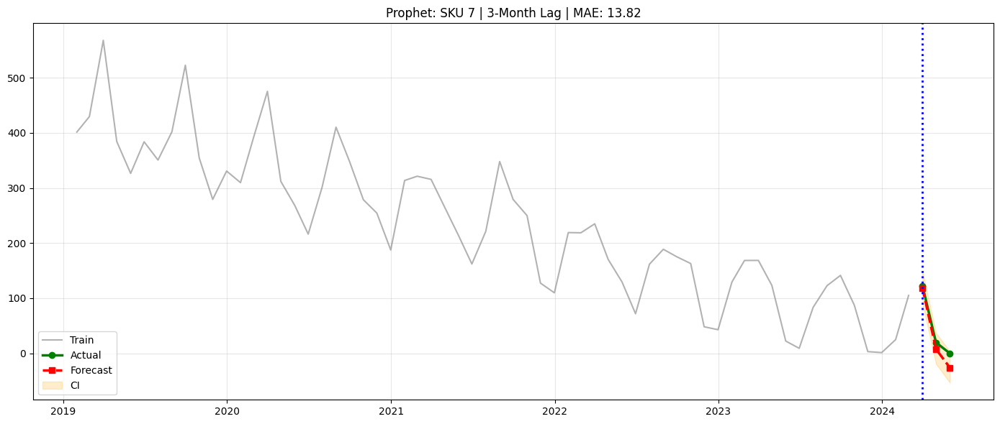

00:08:00 - cmdstanpy - INFO - Chain [1] start processing


  SKU 8... 

00:08:00 - cmdstanpy - INFO - Chain [1] done processing


MAE: 159.79 | RMSE: 165.17 | SMAPE: 18.68


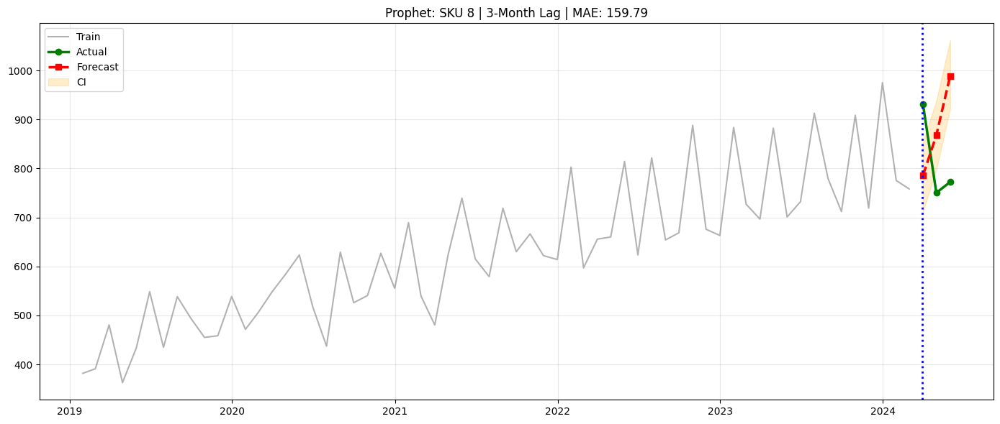

00:08:00 - cmdstanpy - INFO - Chain [1] start processing


  SKU 9... 

00:08:01 - cmdstanpy - INFO - Chain [1] done processing


MAE: 114.52 | RMSE: 129.95 | SMAPE: 12.23


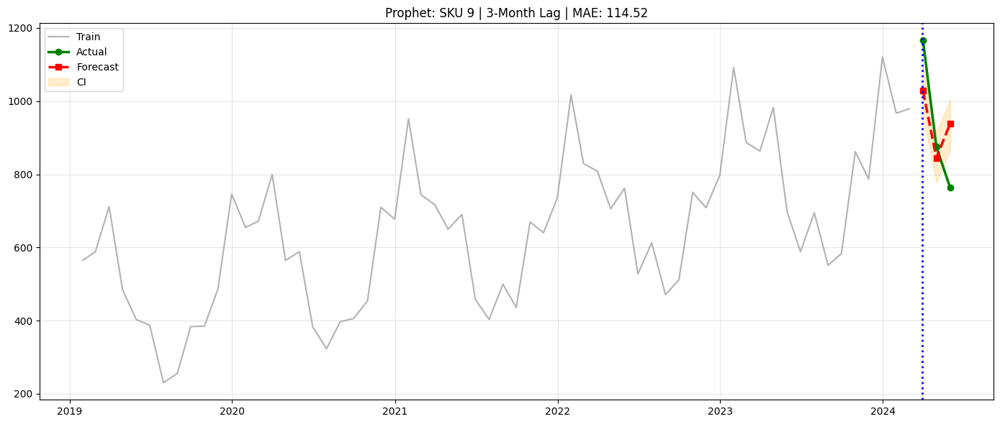

00:08:01 - cmdstanpy - INFO - Chain [1] start processing


  SKU 10... 

00:08:01 - cmdstanpy - INFO - Chain [1] done processing


MAE: 62.30 | RMSE: 70.58 | SMAPE: 149.11


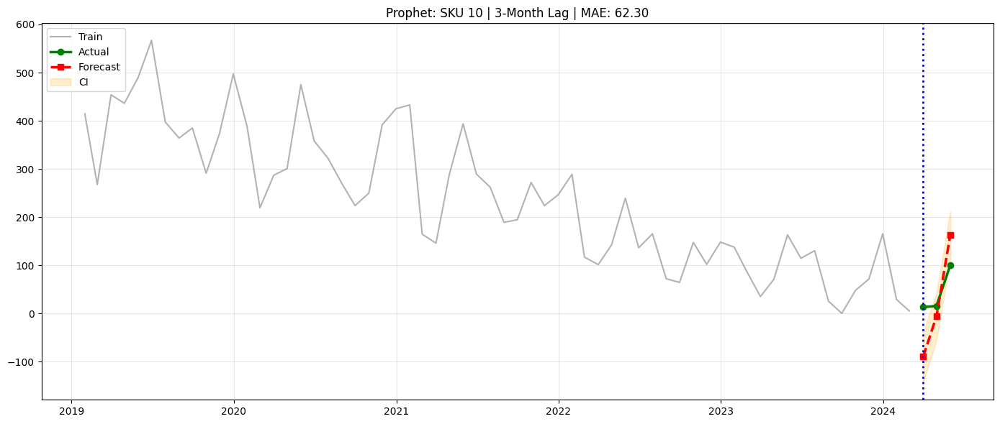

00:08:01 - cmdstanpy - INFO - Chain [1] start processing


Evaluating Lag Period: 6 months
  SKU 1... 

00:08:01 - cmdstanpy - INFO - Chain [1] done processing


MAE: 72.52 | RMSE: 89.79 | SMAPE: 8.34


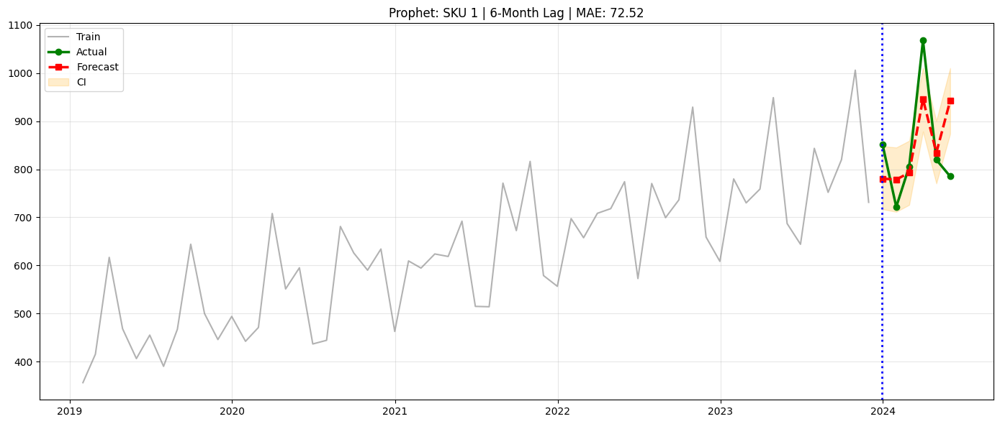

00:08:01 - cmdstanpy - INFO - Chain [1] start processing


  SKU 2... 

00:08:02 - cmdstanpy - INFO - Chain [1] done processing


MAE: 105.53 | RMSE: 116.23 | SMAPE: 12.22


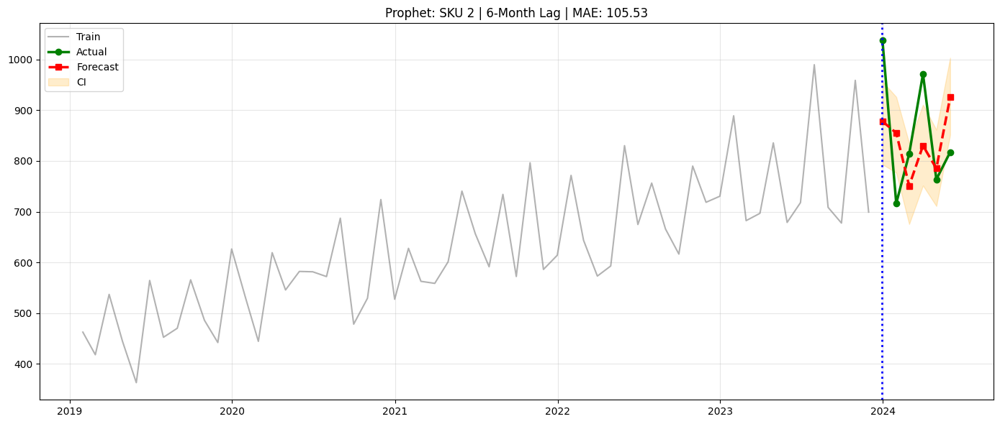

00:08:02 - cmdstanpy - INFO - Chain [1] start processing


  SKU 3... 

00:08:02 - cmdstanpy - INFO - Chain [1] done processing


MAE: 63.39 | RMSE: 74.19 | SMAPE: 7.99


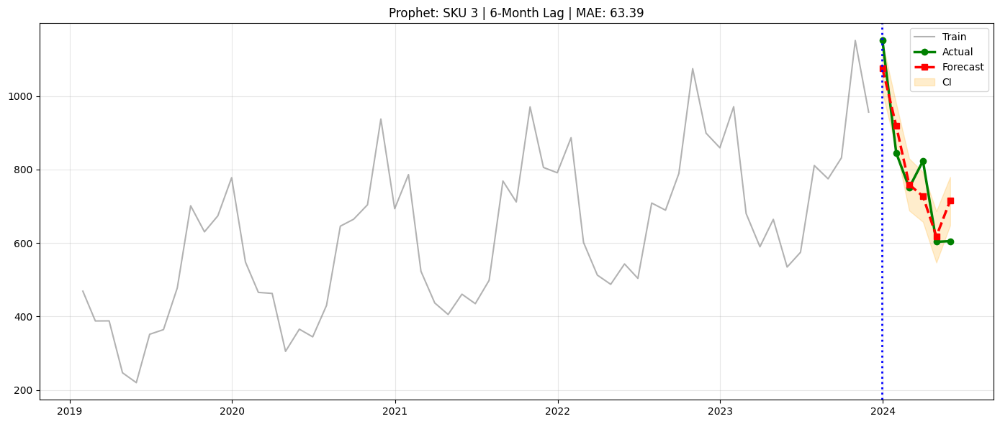

00:08:02 - cmdstanpy - INFO - Chain [1] start processing


  SKU 4... 

00:08:02 - cmdstanpy - INFO - Chain [1] done processing


MAE: 108.09 | RMSE: 129.08 | SMAPE: 12.15


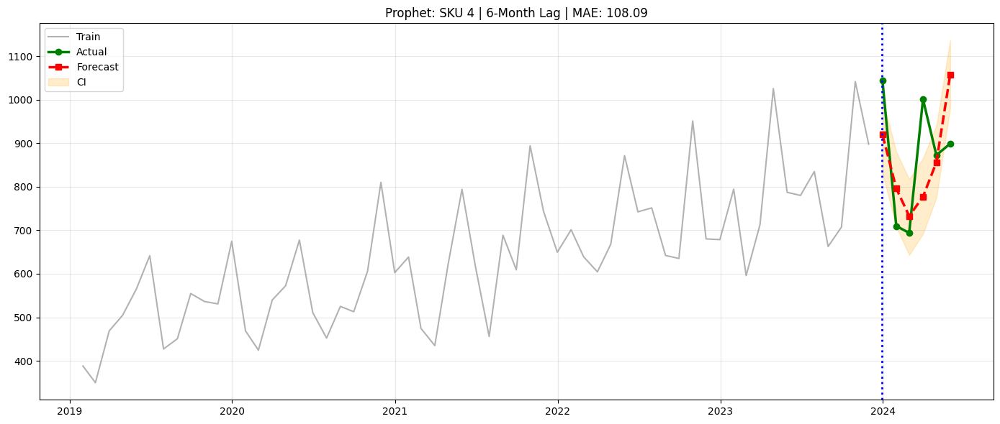

  SKU 5... 

00:08:03 - cmdstanpy - INFO - Chain [1] start processing
00:08:03 - cmdstanpy - INFO - Chain [1] done processing


MAE: 78.56 | RMSE: 97.59 | SMAPE: 9.08


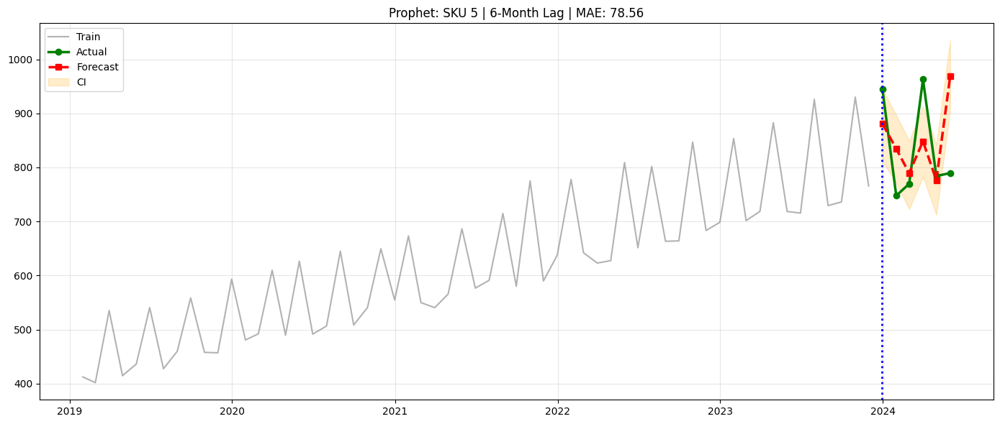

00:08:03 - cmdstanpy - INFO - Chain [1] start processing


  SKU 6... 

00:08:03 - cmdstanpy - INFO - Chain [1] done processing


MAE: 86.27 | RMSE: 95.03 | SMAPE: 123.75


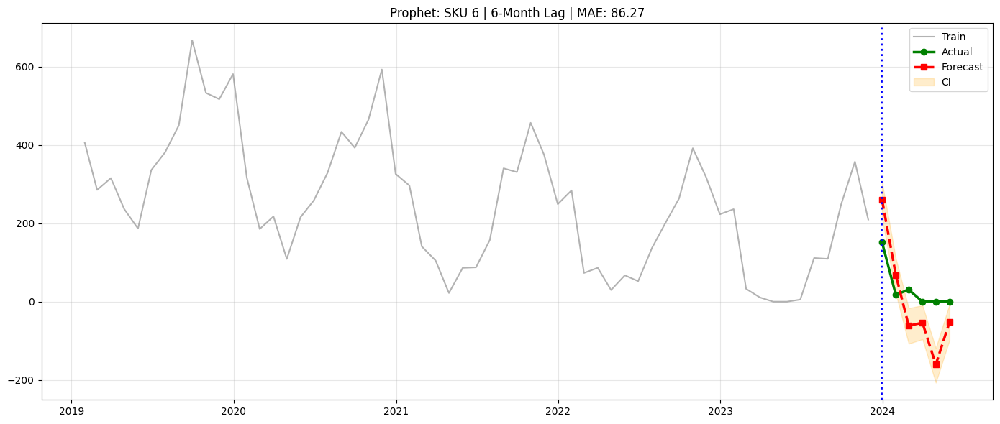

00:08:03 - cmdstanpy - INFO - Chain [1] start processing


  SKU 7... 

00:08:03 - cmdstanpy - INFO - Chain [1] done processing


MAE: 17.17 | RMSE: 19.68 | SMAPE: 77.03


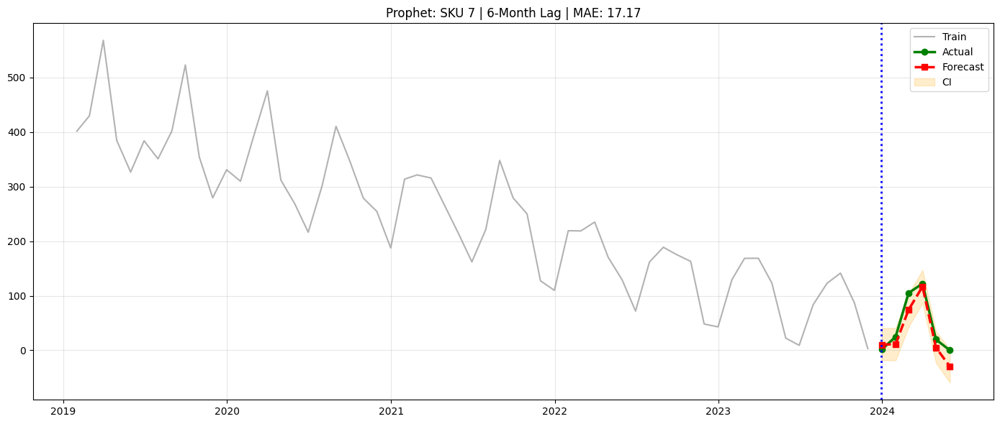

  SKU 8... 

00:08:04 - cmdstanpy - INFO - Chain [1] start processing
00:08:04 - cmdstanpy - INFO - Chain [1] done processing


MAE: 118.23 | RMSE: 133.27 | SMAPE: 13.78


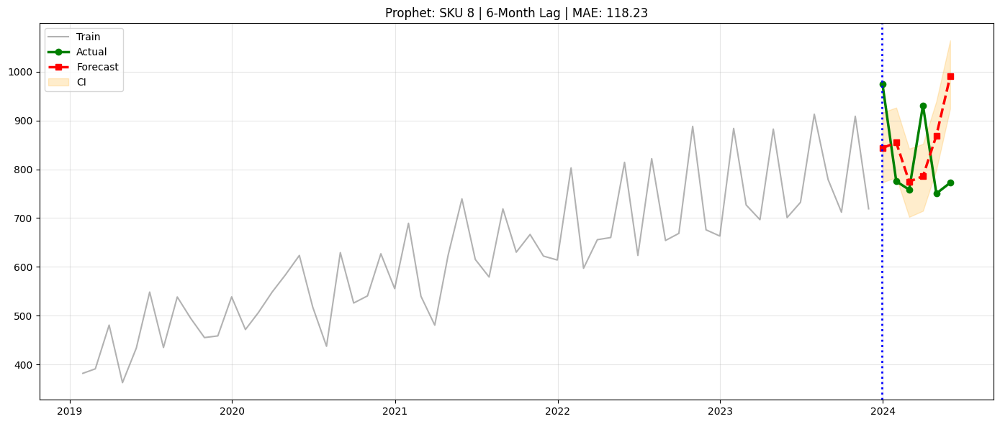

00:08:04 - cmdstanpy - INFO - Chain [1] start processing


  SKU 9... 

00:08:04 - cmdstanpy - INFO - Chain [1] done processing


MAE: 84.58 | RMSE: 102.12 | SMAPE: 8.75


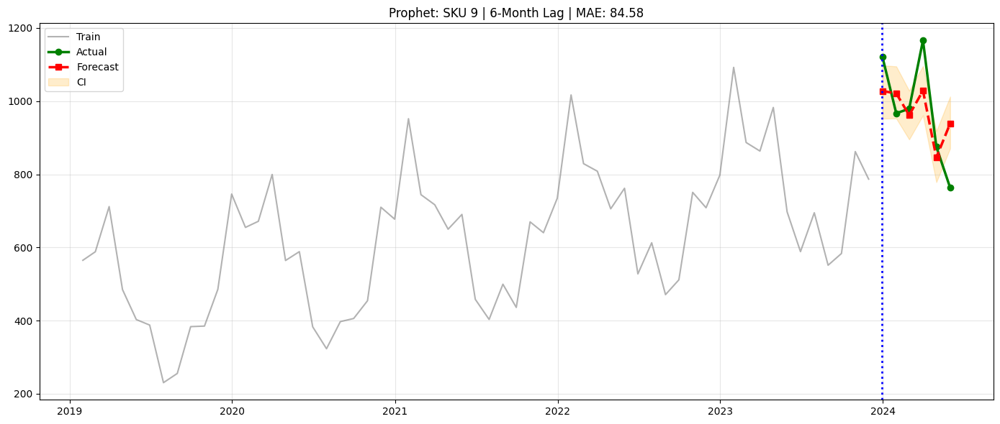

  SKU 10... 

00:08:04 - cmdstanpy - INFO - Chain [1] start processing
00:08:04 - cmdstanpy - INFO - Chain [1] done processing


MAE: 56.52 | RMSE: 72.06 | SMAPE: 111.30


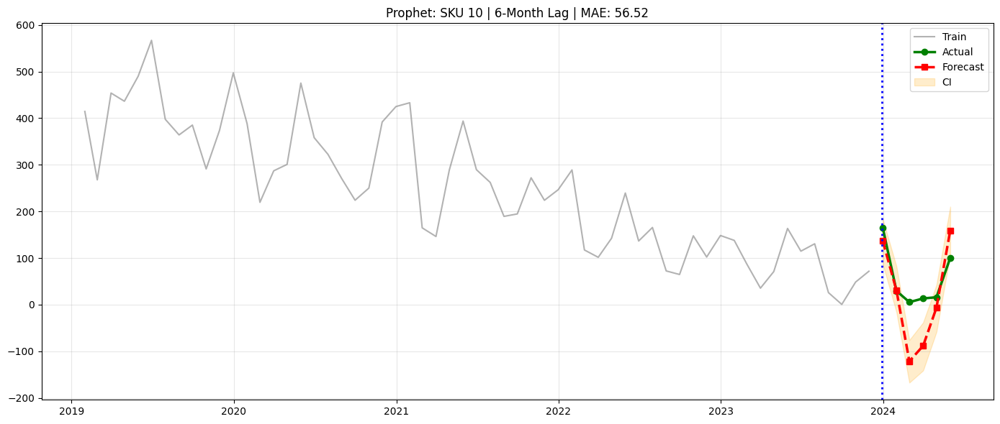

00:08:05 - cmdstanpy - INFO - Chain [1] start processing
00:08:05 - cmdstanpy - INFO - Chain [1] done processing


Evaluating Lag Period: 12 months
  SKU 1... MAE: 75.70 | RMSE: 95.00 | SMAPE: 8.81


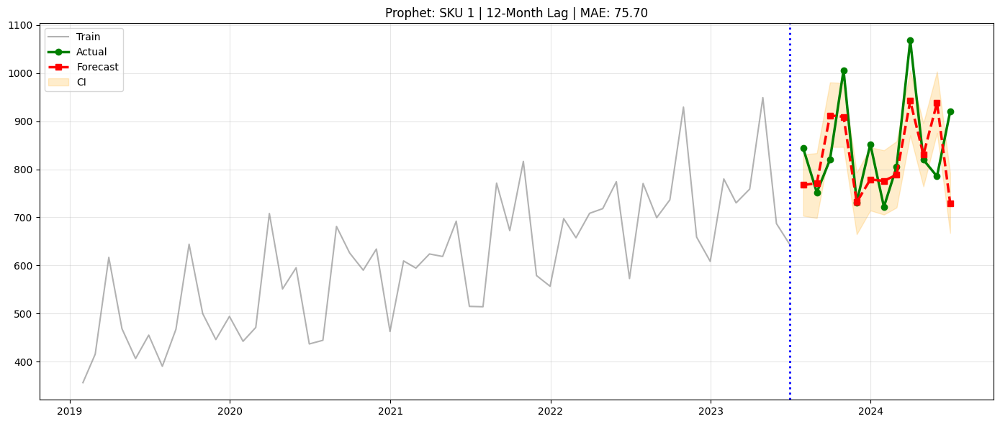

00:08:05 - cmdstanpy - INFO - Chain [1] start processing
00:08:05 - cmdstanpy - INFO - Chain [1] done processing


  SKU 2... MAE: 103.20 | RMSE: 119.13 | SMAPE: 12.14


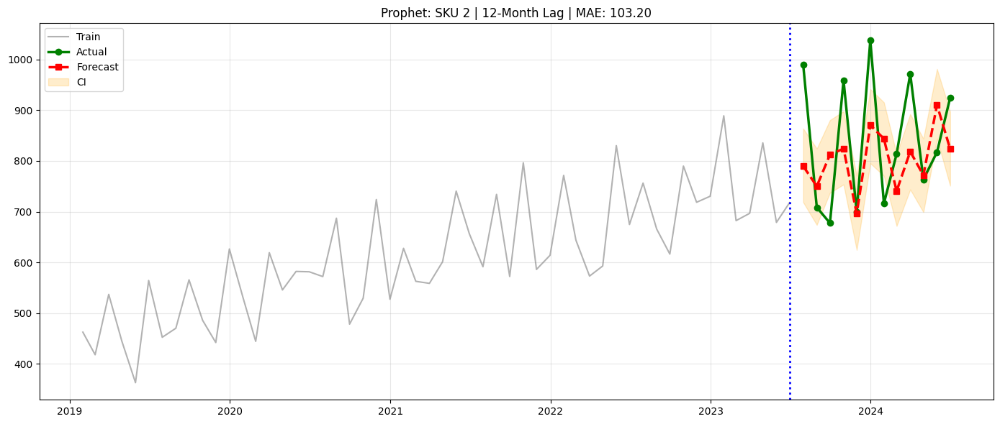

00:08:05 - cmdstanpy - INFO - Chain [1] start processing


  SKU 3... 

00:08:06 - cmdstanpy - INFO - Chain [1] done processing


MAE: 70.71 | RMSE: 86.54 | SMAPE: 8.59


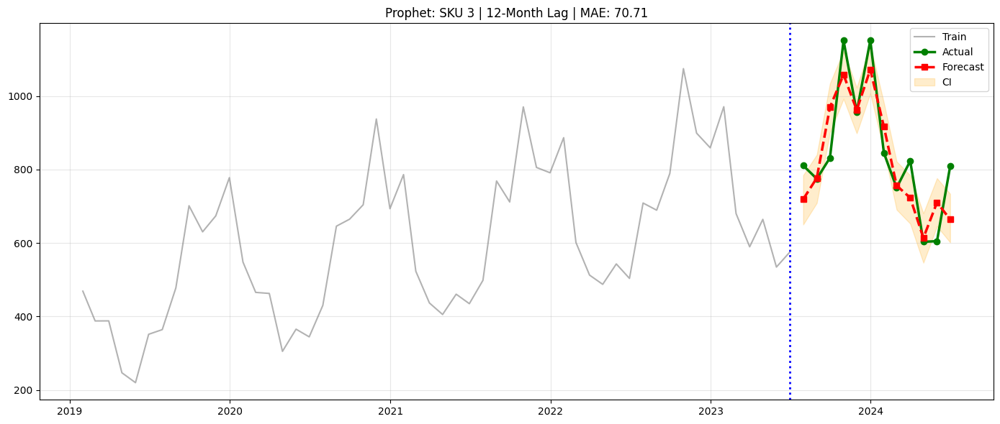

00:08:06 - cmdstanpy - INFO - Chain [1] start processing
00:08:06 - cmdstanpy - INFO - Chain [1] done processing


  SKU 4... MAE: 104.02 | RMSE: 117.30 | SMAPE: 12.09


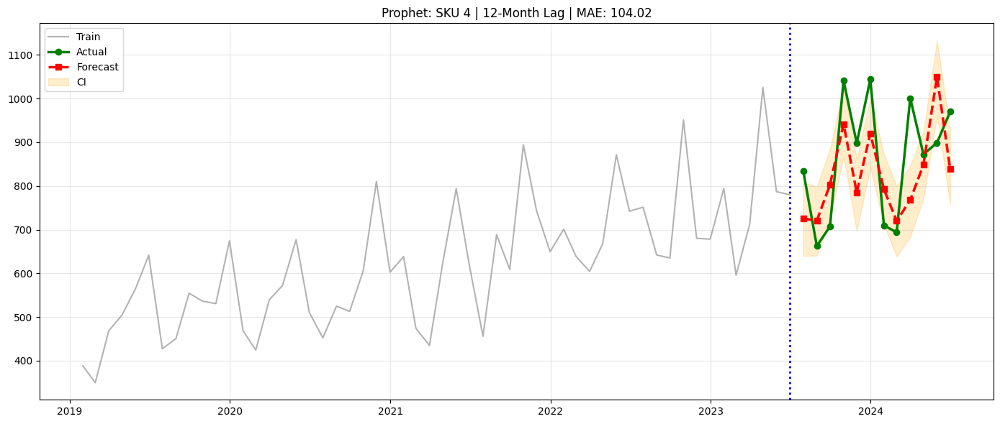

00:08:06 - cmdstanpy - INFO - Chain [1] start processing
00:08:06 - cmdstanpy - INFO - Chain [1] done processing


  SKU 5... MAE: 85.81 | RMSE: 106.40 | SMAPE: 9.99


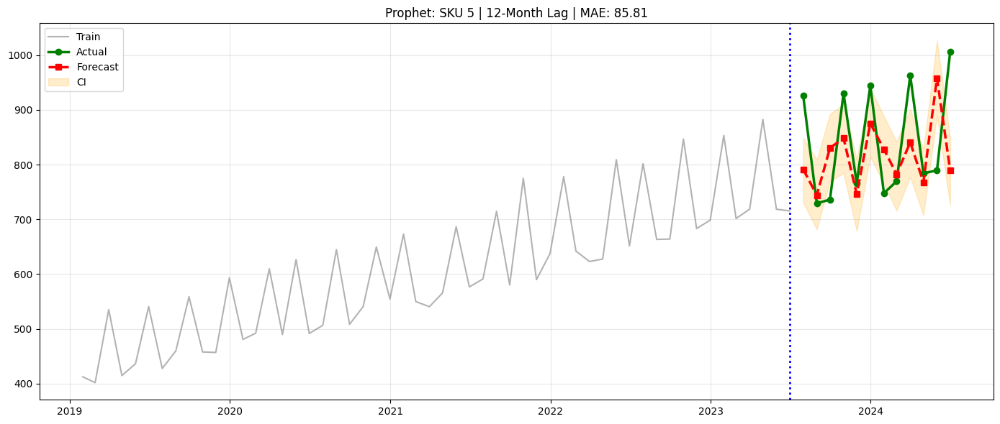

00:08:07 - cmdstanpy - INFO - Chain [1] start processing
00:08:07 - cmdstanpy - INFO - Chain [1] done processing


  SKU 6... MAE: 64.51 | RMSE: 75.28 | SMAPE: 62.92


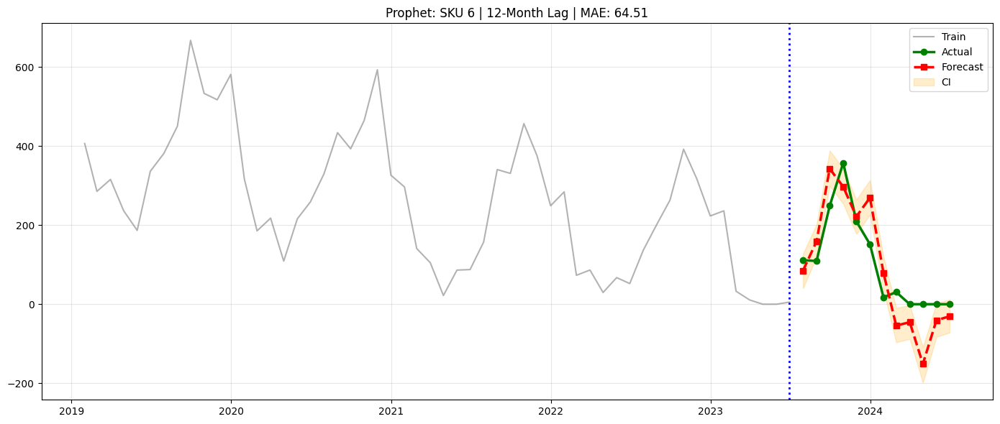

00:08:07 - cmdstanpy - INFO - Chain [1] start processing
00:08:07 - cmdstanpy - INFO - Chain [1] done processing


  SKU 7... MAE: 36.36 | RMSE: 44.30 | SMAPE: 87.20


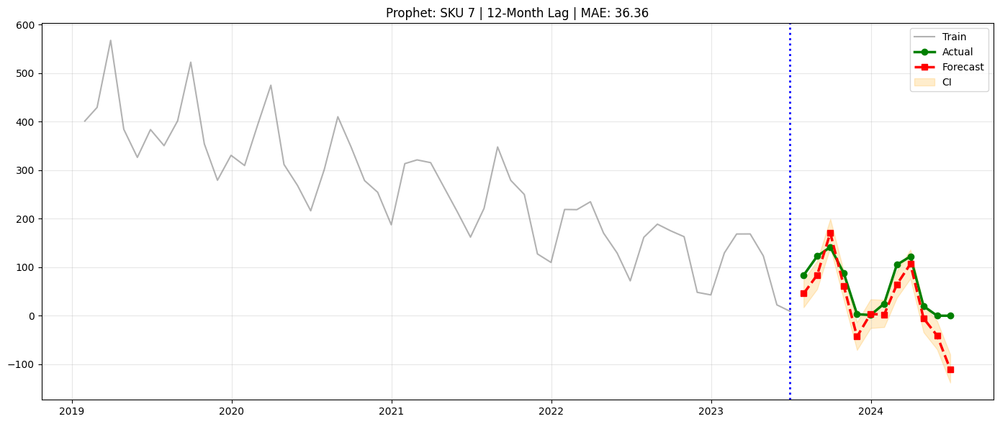

00:08:07 - cmdstanpy - INFO - Chain [1] start processing
00:08:07 - cmdstanpy - INFO - Chain [1] done processing


  SKU 8... MAE: 99.37 | RMSE: 117.39 | SMAPE: 11.60


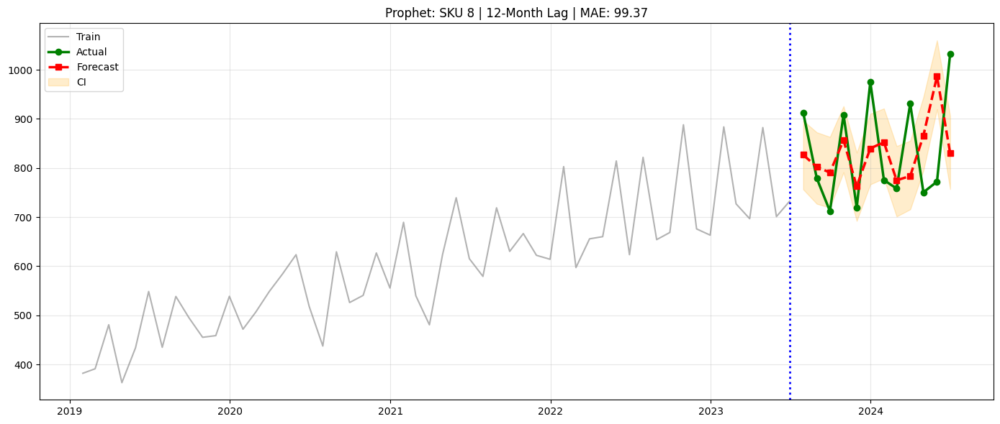

00:08:08 - cmdstanpy - INFO - Chain [1] start processing


  SKU 9... 

00:08:08 - cmdstanpy - INFO - Chain [1] done processing


MAE: 79.87 | RMSE: 96.79 | SMAPE: 9.59


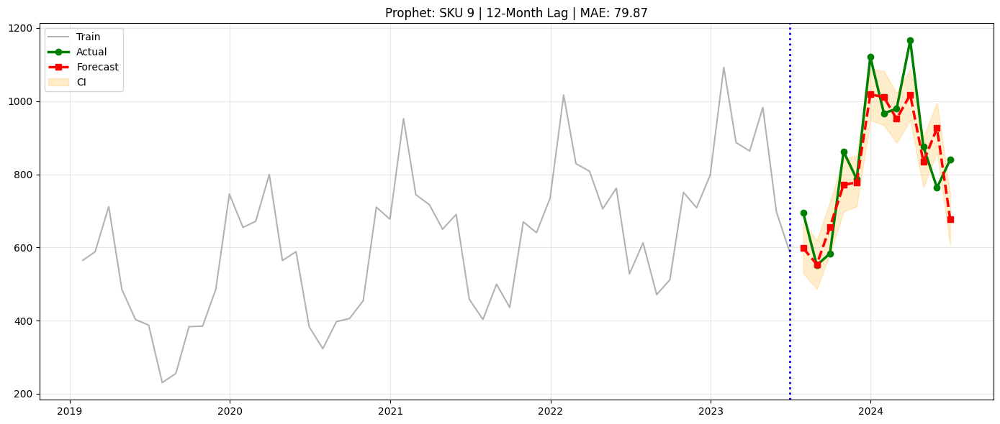

00:08:08 - cmdstanpy - INFO - Chain [1] start processing


  SKU 10... 

00:08:08 - cmdstanpy - INFO - Chain [1] done processing


MAE: 59.60 | RMSE: 70.83 | SMAPE: 136.40


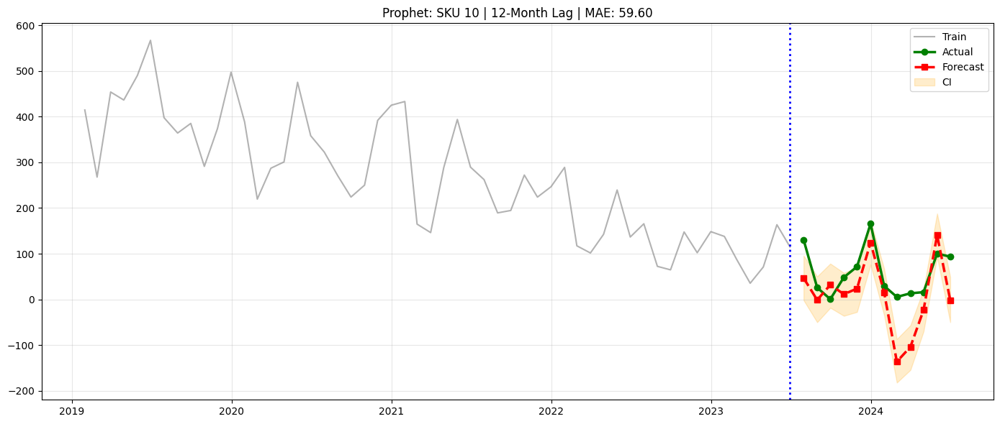


Total forecasts: 40
Average performance by lag:
               MAE    RMSE  SMAPE
Lag_Period                       
1           124.21  124.21  22.41
3            94.95  108.46  31.36
6            79.09   92.90  38.44
12           77.91   92.90  35.93


In [185]:
prophet_detailed, prophet_kpi_summary = evaluate_prophet_lags(
    data_monthly=data_monthly,
    lag_periods=[1, 3, 6, 12],
    plot_forecasts=True,
    save_results=True
)

In [189]:
arima_kpi_summary

,SKU_ID,Lag_Period,Model,ARIMA_Order,Seasonal_Order,Train_Months,Test_Months,Train_End,Forecast_Start,Forecast_End,...,Zero_Sales_Count,Zero_Sales_%,Mean_Actual,Mean_Forecast,MAE,RMSE,Bias_%,Service_Level_%,SMAPE,Tracking_Signal
0,1,1,ARIMA,"(2, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,785.16,857.02,71.868,71.868,9.153,100.00,8.753,1.000
1,2,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,817.35,836.64,19.289,19.289,2.360,100.00,2.332,1.000
2,3,1,ARIMA,"(2, 1, 1)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,605.12,652.57,47.453,47.453,7.842,100.00,7.546,1.000
3,4,1,ARIMA,"(0, 1, 3)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,898.77,902.35,3.582,3.582,0.399,100.00,0.398,1.000
4,5,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,789.54,818.53,28.991,28.991,3.672,100.00,3.606,1.000
5,6,1,ARIMA,"(1, 1, 2)","(1, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
6,7,1,ARIMA,"(3, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
7,8,1,ARIMA,"(3, 1, 0)","(0, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,772.33,824.21,51.881,51.881,6.718,100.00,6.499,1.000
8,9,1,ARIMA,"(2, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,763.40,824.14,60.740,60.740,7.956,100.00,7.652,1.000
9,10,1,ARIMA,"(0, 1, 3)","(1, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,100.47,89.65,10.817,10.817,-10.767,0.00,11.380,-1.000


In [190]:
data.shape

(2870, 6)

# KPI research and how it helps and can be useful for demand player on the given simple data

# 1. MAE (Mean Absolute Error):
Definition: Average of absolute differences between forecast and actual values.
- Most interpretable metric - directly shows average forecast error in units (e.g., if MAE = 50, we're off by 50 units on average)
- Not skewed by percentage calculations like MAPE
- Handles zero sales gracefully (SKUs 6, 7 in our case)
- Optimizes for the median demand, making it robust to outliers

## Example interpretation: 
- SKU 1, Lag 3, ARIMA shows MAE = 111.86 units

Tells demand planner: "On average, we're missing demand by ~112 units per month"
This is actionable for safety stock calculations

- For SKU 6 (zero sales): MAE = 7.14 at Lag 3

Even with zero actual sales, MAE shows we're forecasting small positive values
Helps avoid unnecessary inventory buildup.

MAE increases from 71.87 (1-month lag) → 111.86 (3-month lag) → 86.31 (12-month lag)
Shows that older data (3-month lag) creates more error than fresher data

# 2. RMSE (Root Mean Squared Error) :

 Definition: Square root of average squared errors - penalizes large errors heavily
Why We Use It:

- Gives disproportionate weight to large forecast misses
- More sensitive to outliers than MAE
- Optimizes for mean demand (unbiased forecasts)
- Preferred when large errors are particularly costly


Example from data: SKU 4, Lag 3, ARIMA shows RMSE = 78.61 vs MAE = 59.85

RMSE being 32% higher than MAE indicates some large individual forecast errors
Tells planner: occasional big misses need attention, not just average performance


For growing demand SKUs (1-5, 8-9): RMSE helps catch periods where we significantly under/over-forecast during demand surges

Data Recency Impact:

SKU 2: RMSE = 19.29 (1-month) → 59.88 (3-month) → 131.97 (12-month)
Clear deterioration with older data - 6.8x worse at 12-month lag
Justifies more frequent model updates

# 3. SMAPE (Symmetric Mean Absolute Percentage Error)
Definition: Percentage error that treats over-forecasting and under-forecasting equally


- Scale-independent: Can compare across SKUs with different demand volumes
- Symmetric: Over-forecasting by 100 units treated same as under-forecasting by 100 units
- Ranges 0-200% (lower is better)
- Industry standard for forecast accuracy benchmarking


Example from data: SKU 4, Lag 1, ARIMA shows SMAPE = 0.398%

Excellent forecast - less than 0.4% error
SKU 10, Lag 6, ARIMA shows SMAPE = 92.986%
Poor forecast - nearly 93% off


Comparing across SKUs:

High-volume SKU 1 (Mean = 891): SMAPE = 12.04% at Lag 3
Low-volume SKU 10 (Mean = 43): SMAPE = 38.72% at Lag 3
Shows low-volume items are harder to forecast accurately



Data Recency Impact:

SKU 5: SMAPE = 3.61% (1-month) → 3.44% (3-month) → 8.48% (12-month)
Demonstrates accuracy degradation with data staleness

Limitation Handled:

For SKU 6, 7 with 100% zero sales: SMAPE returns NaN (undefined)
This is why we also use MAE - it still works


# 4. Bias_%
Definition: Systematic tendency to over-forecast (positive bias) or under-forecast (negative bias)

- Detects systematic errors - not just random misses
- Critical for inventory planning: persistent under-forecasting causes stockouts, over-forecasting causes excess inventory
- Calculated only on non-zero periods to avoid division by zero


Example from data: SKU 4, Lag 12, ARIMA shows Bias = -8.90%

Consistently under-forecasting by ~9%
Planner should increase safety stock to compensate


SKU 1, Lag 3: Bias = -2.13%

Slight under-forecasting tendency
May cause minor stockout risk



Data Recency Impact:

SKU 2: Bias = 2.36% (1-month) → -1.06% (3-month) → -7.42% (12-month)
Older data causes worse systematic errors
Fresh data maintains forecast balance


# 5. Service Level_%
Definition: Percentage of periods where forecast ≥ actual demand

- Direct measure of stockout risk
- Easy for business stakeholders to understand
- Target-oriented: aim for 95%+ service level
- Complements other metrics by showing "how often we meet demand"


Example from data: SKU 1, Lag 3, ARIMA shows Service Level = 33.33%

Only meeting demand 1 out of 3 months
High stockout risk - need to adjust forecast upward or increase safety stock


SKU 8, Lag 3: Service Level = 66.67%

Meeting demand 2 out of 3 months
Better but still below industry standard of 90-95%



Data Recency Impact:

SKU 1: Service Level = 100% (1-month) → 33.33% (3-month) → 33.33% (12-month)
Fresh data provides safer forecasts
Older data increases stockout risk


# 6. Tracking Signal
Definition: Cumulative Forecast Error ÷ Mean Absolute Deviation

- Detects forecast drift over time
- Values between -4 and +4 indicate forecast is "in control"
- Values outside this range suggest model needs recalibration
- Acts as an early warning system


Example from data: SKU 6, Lag 6, ARIMA shows Tracking Signal = 4.47

Model is drifting - consistently over-forecasting
Signals need for model update or parameter tuning


SKU 1, Lag 12: Tracking Signal = -4.80

Persistent under-forecasting trend
Model has lost relevance - needs retraining



Data Recency Impact:

SKU 2: Tracking Signal = 1.0 (1-month) → -0.50 (3-month) → -7.14 (12-month)
Fresh data keeps model "in control"
Old data causes model to drift significantly


# Context Metrics (Supporting Information)

# 7. Zero_Sales_% & Zero_Sales_Count

- Identifies intermittent demand patterns
- Explains why some KPIs return NaN
- Helps select appropriate forecasting methods

Example from Our Data:

SKU 6: 100% zero sales at Lag 1, 50% at Lag 6
SKU 7: 100% zero at Lag 1, 33.33% at Lag 3, 16.67% at Lag 6
Indicates these SKUs need specialized intermittent demand forecasting


# 8. Mean_Actual & Mean_Forecast

- Provides scale context for other metrics
- Quick sanity check for forecast reasonableness

SKU 1, Lag 3: Mean Actual = 891, Mean Forecast = 872
Close alignment suggests model is capturing demand level correctly
The 19-unit difference (2.1%) is relatively small



- MAE provides an absolute error in units, which is helpful when you want to understand the actual deviation from the forecast in terms of quantity, but it doesn’t give a percentage to compare across different products.
- MAPE is often preferred because it expresses errors as a percentage, making it easier to interpret and compare across different product categories, regardless of their volume. However, MAPE can be less reliable when actual demand is close to zero, as it will produce disproportionately large errors. As SKU's 6,7 had problem with this 
- RMSE used when large forecast errors need attention, maybe a high valuye or low profit margin product

In [192]:
arima_kpi_summary

,SKU_ID,Lag_Period,Model,ARIMA_Order,Seasonal_Order,Train_Months,Test_Months,Train_End,Forecast_Start,Forecast_End,...,Zero_Sales_Count,Zero_Sales_%,Mean_Actual,Mean_Forecast,MAE,RMSE,Bias_%,Service_Level_%,SMAPE,Tracking_Signal
0,1,1,ARIMA,"(2, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,785.16,857.02,71.868,71.868,9.153,100.00,8.753,1.000
1,2,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,817.35,836.64,19.289,19.289,2.360,100.00,2.332,1.000
2,3,1,ARIMA,"(2, 1, 1)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,605.12,652.57,47.453,47.453,7.842,100.00,7.546,1.000
3,4,1,ARIMA,"(0, 1, 3)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,898.77,902.35,3.582,3.582,0.399,100.00,0.398,1.000
4,5,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,789.54,818.53,28.991,28.991,3.672,100.00,3.606,1.000
5,6,1,ARIMA,"(1, 1, 2)","(1, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
6,7,1,ARIMA,"(3, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,1,100.00,0.00,0.00,0.000,0.000,NaN,100.00,NaN,NaN
7,8,1,ARIMA,"(3, 1, 0)","(0, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,772.33,824.21,51.881,51.881,6.718,100.00,6.499,1.000
8,9,1,ARIMA,"(2, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,763.40,824.14,60.740,60.740,7.956,100.00,7.652,1.000
9,10,1,ARIMA,"(0, 1, 3)","(1, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.00,100.47,89.65,10.817,10.817,-10.767,0.00,11.380,-1.000


- so if a product/SKU has high error and is very high runner, its good to have high safety stock
- if it is low running SKU, and error is high, we dont need to have high safety stock to compensate for error. As it is low running product its better to cap the safety stock.
- The law of large numbers follow in statistics well

In [193]:
arima_kpi = pd.read_csv('arima_kpi_summary.csv')

# Basic cleanup if needed
arima_kpi['Lag_Period'] = arima_kpi['Lag_Period'].astype(int)
arima_kpi['SKU_ID'] = arima_kpi['SKU_ID'].astype(int)

arima_kpi.head()

,SKU_ID,Lag_Period,Model,ARIMA_Order,Seasonal_Order,Train_Months,Test_Months,Train_End,Forecast_Start,Forecast_End,...,Zero_Sales_Count,Zero_Sales_%,Mean_Actual,Mean_Forecast,MAE,RMSE,Bias_%,Service_Level_%,SMAPE,Tracking_Signal
0,1,1,ARIMA,"(2, 1, 1)","(1, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.0,785.16,857.02,71.868,71.868,9.153,100.0,8.753,1.0
1,2,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.0,817.35,836.64,19.289,19.289,2.360,100.0,2.332,1.0
2,3,1,ARIMA,"(2, 1, 1)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.0,605.12,652.57,47.453,47.453,7.842,100.0,7.546,1.0
3,4,1,ARIMA,"(0, 1, 3)","(2, 0, 0, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.0,898.77,902.35,3.582,3.582,0.399,100.0,0.398,1.0
4,5,1,ARIMA,"(3, 1, 0)","(0, 0, 1, 12)",64,1,2024-05,2024-05,2024-05,...,0,0.0,789.54,818.53,28.991,28.991,3.672,100.0,3.606,1.0


# Checking and using validation window i.e. different lags for effect on performance across vaired KPIs used by us

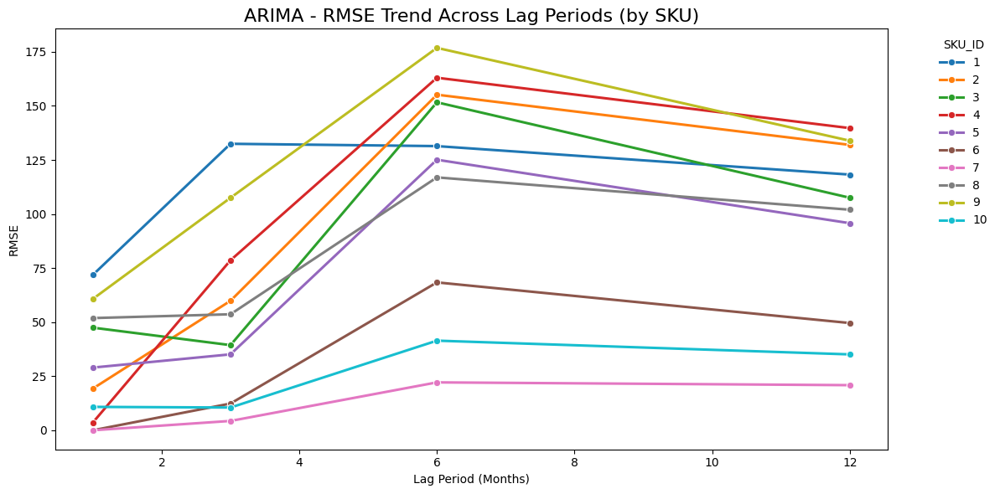

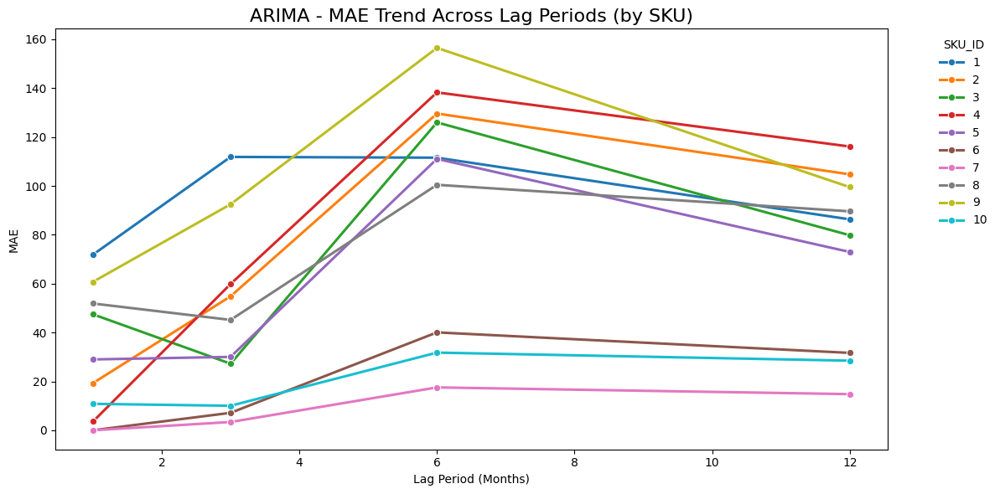

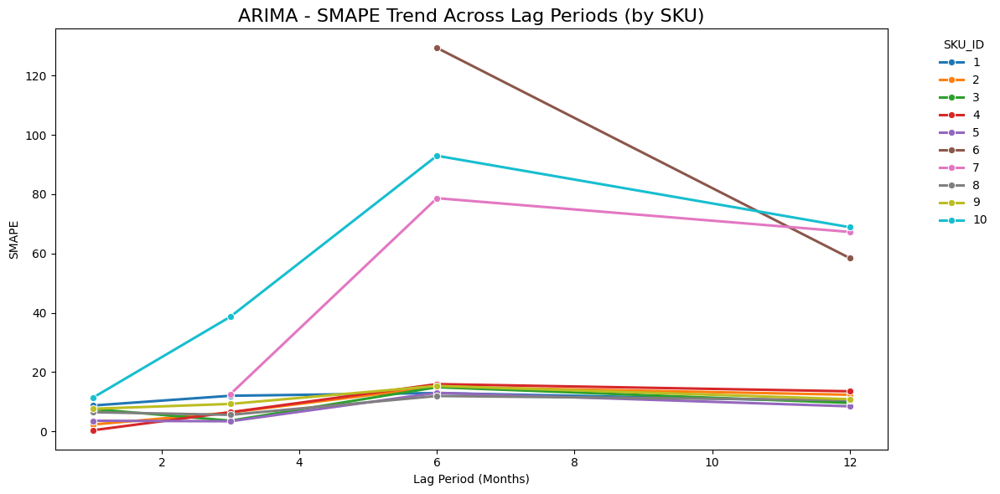

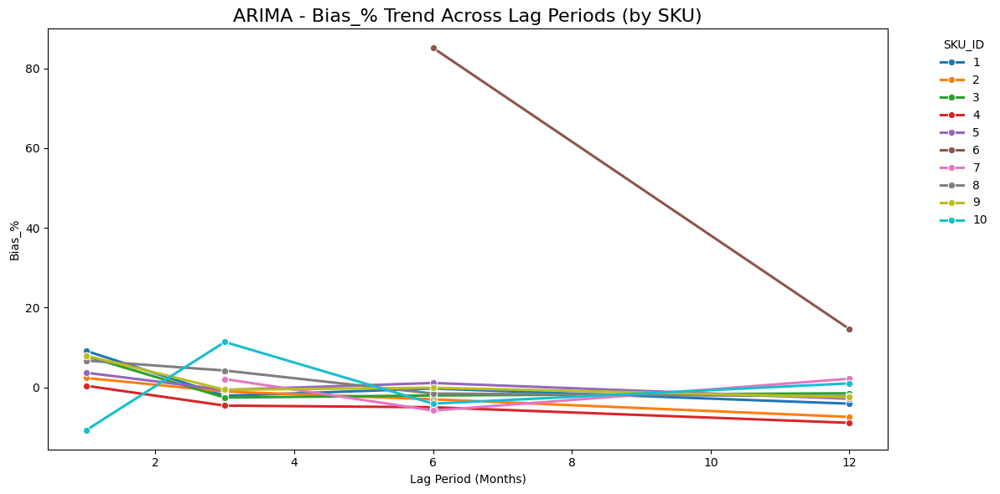

In [203]:
metrics = ['RMSE', 'MAE', 'SMAPE', 'Bias_%']

for metric in metrics:
    plt.figure(figsize=(12, 6))
    sns.lineplot(
        data=arima_kpi,
        x='Lag_Period',
        y=metric,
        hue='SKU_ID',
        marker='o',
        linewidth=2.2,
        palette= "tab10"
    )
    plt.title(f"ARIMA - {metric} Trend Across Lag Periods (by SKU)", fontsize=16)
    plt.xlabel("Lag Period (Months)")
    plt.ylabel(metric)
    plt.legend(title='SKU_ID', bbox_to_anchor=(1.05, 1), loc='upper left', frameon=False)
    plt.tight_layout()
    plt.show()


In [198]:
print(sorted(arima_kpi['SKU_ID'].unique()))


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


In [199]:
sku_lag_counts = arima_kpi.groupby('SKU_ID')['Lag_Period'].nunique().reset_index()
sku_lag_counts.columns = ['SKU_ID', 'Available_Lags']
print(sku_lag_counts)

   SKU_ID  Available_Lags
0       1               4
1       2               4
2       3               4
3       4               4
4       5               4
5       6               4
6       7               4
7       8               4
8       9               4
9      10               4


## we see that effect of lag depends on different time series models. For our KPIs, RMSE and MAE, it is low for 1 month lag, overall slightly increases of lag period of 3, and more on lag period of 6 months. For increasing growth SKUs (except 6,7 and 10), we see the SMAPE is slightlky increases from 1 to 3 to 6 month lags. but when it is increases to 12 months it decreases gradually. 
## First half follows that more training data, less errors. But as it moves beyond that, the model is better capturing the underlying forecasting, understanding the seasonality and allowing room for forecasting. This tells that 12 months lag is good selection and even 3m and 1 month. What a demand planner should see accordingly is to evelaute between different lags.

The trend-growing SKUs (1–5, 8, 9) show a gradual increase in errors from 1 to 6 months followed by a moderate decrease at 12 months, confirming that longer-term seasonality benefits these SKUs.
Conversely, the declining-trend SKUs (6, 7, 10) exhibit relatively stable or improving accuracy at longer lags, since their downward sales trajectory is more predictable and less sensitive to recent fluctuations.

This contrast emphasizes that the optimal lag period depends on the SKU’s underlying trend behavior—shorter lags for rapidly changing or growing items, and longer lags for stable or declining ones. 

The SMAPE metric mirrors the RMSE/MAE pattern, with mild increases up to 6-month lags and a steady decline by 12 months, reinforcing the idea that extended lags help generalize periodic behavior. The Bias% remains near zero for most SKUs, indicating balanced over- and under-forecasting. However, SKU 6 shows a higher bias at intermediate lags, suggesting model overfit or sales error.
These results imply that forecast update frequency directly affects performance, and there is no one-size-fits-all lag setting. For most products, 1- to 3-month updates ensure responsiveness to market changes, while 12-month training windows stabilize forecasts for seasonal or mature SKUs.
A demand planner should use the dashboard to compare KPI trends across lags and select the optimal update frequency that balances accuracy with computational efficiency.

Similar to industry practices where planners evaluate accuracy at multiple lag points (e.g., 6-month and 12-month horizons), the results from this analysis suggest adopting a dynamic lag framework.

Shorter lags (1–3 months) capture recent market dynamics and should be prioritized for fast-moving or growing SKUs (e.g., SKUs 1–5, 8, and 9).

Longer lags (6–12 months), on the other hand, provide a more stable representation of slow-moving or declining SKUs (e.g., SKUs 6, 7, and 10), where sales are less affected by short-term fluctuations.

The ARIMA results show that as lag increases (1 → 3 → 6 months), error metrics like RMSE and MAE rise — confirming that less recent data reduces accuracy. However, at 12 months, the slight drop in error suggests the model may be learning broader seasonal patterns despite the older data, which aligns with longer historical seasonality rather than real-time responsiveness.
 

## Overall 
As lag increases, forecast accuracy declines due to less recent training data. Shorter lags (1–3 months) best capture current trends, while longer lags (12 months) highlight general seasonality but risk losing real-time accuracy.

Now 

- combining all kPI summaries for different models, across different lags and different SKUs -> IT can be selected in dashboard, saving results for fast dashboard
- would probably make a live real-time forecasting dashbaord for dynamic need, making a pipeline to retrain models every week or month

In [210]:
hw_kpi = pd.read_csv('hw_kpi_summary.csv')
arima_kpi = pd.read_csv('arima_kpi_summary.csv')
xgb_kpi = pd.read_csv('xgboost_kpi_summary.csv')
lgb_kpi = pd.read_csv('lightgbm_kpi_summary.csv')
prophet_kpi = pd.read_csv('prophet_kpi_summary.csv')

In [215]:
hw_kpi.shape


(40, 20)

In [211]:
hw_detailed = pd.read_csv('hw_detailed_forecasts.csv')
arima_detailed = pd.read_csv('arima_detailed_forecasts.csv')
xgb_detailed = pd.read_csv('xgboost_detailed_forecasts.csv')
lgb_detailed = pd.read_csv('lightgbm_detailed_forecasts.csv')
prophet_detailed = pd.read_csv('prophet_detailed_forecasts.csv')


In [218]:
hw_detailed

,SKU_ID,Lag_Period,Model,Date,Actual,Forecast,CI_Lower,CI_Upper,Error,Abs_Error
0,1,1,Holt-Winters,2024-05-31,785.156106,871.044195,752.070678,990.017712,-85.888089,85.888089
1,2,1,Holt-Winters,2024-05-31,817.351766,862.373963,732.060895,992.687031,-45.022197,45.022197
2,3,1,Holt-Winters,2024-05-31,605.121396,667.622804,557.518122,777.727486,-62.501408,62.501408
3,4,1,Holt-Winters,2024-05-31,898.770042,975.436932,843.791427,1107.082438,-76.666890,76.666890
4,5,1,Holt-Winters,2024-05-31,789.539991,893.682592,788.802418,998.562766,-104.142601,104.142601
...,...,...,...,...,...,...,...,...,...,...
215,10,12,Holt-Winters,2024-02-29,5.453175,0.000000,0.000000,0.000000,5.453175,5.453175
216,10,12,Holt-Winters,2024-03-31,13.362990,0.000000,0.000000,21.673036,13.362990,13.362990
217,10,12,Holt-Winters,2024-04-30,15.935134,0.000000,0.000000,64.759178,15.935134,15.935134
218,10,12,Holt-Winters,2024-05-31,100.467238,95.785615,22.229779,169.341450,4.681623,4.681623


In [219]:
xgb_detailed.shape

(220, 8)

In [212]:
kpi_summary_all = pd.concat([hw_kpi, arima_kpi, xgb_kpi, lgb_kpi, prophet_kpi], ignore_index=True)


In [213]:
kpi_summary_all

,SKU_ID,Lag_Period,Model,Damped,Train_Months,Test_Months,Train_End,Forecast_Start,Forecast_End,Total_Periods,...,Mean_Actual,Mean_Forecast,MAE,RMSE,Bias_%,Service_Level_%,SMAPE,Tracking_Signal,ARIMA_Order,Seasonal_Order
0,1,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,...,785.16,871.04,85.888,85.888,10.939,100.00,10.372,1.000,NaN,NaN
1,2,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,...,817.35,862.37,45.022,45.022,5.508,100.00,5.361,1.000,NaN,NaN
2,3,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,...,605.12,667.62,62.501,62.501,10.329,100.00,9.822,1.000,NaN,NaN
3,4,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,...,898.77,975.44,76.667,76.667,8.530,100.00,8.181,1.000,NaN,NaN
4,5,1,Holt-Winters,False,64,1,2024-05,2024-05,2024-05,1,...,789.54,893.68,104.143,104.143,13.190,100.00,12.374,1.000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,6,12,Prophet,NaN,54,12,2023-06,2023-07,2024-06,12,...,102.97,94.29,64.507,75.277,13.223,41.67,62.916,-1.615,NaN,NaN
196,7,12,Prophet,NaN,54,12,2023-06,2023-07,2024-06,12,...,59.27,28.15,36.358,44.296,-31.221,16.67,87.200,-10.272,NaN,NaN
197,8,12,Prophet,NaN,54,12,2023-06,2023-07,2024-06,12,...,835.60,831.08,99.366,117.387,-0.540,58.33,11.602,-0.545,NaN,NaN
198,9,12,Prophet,NaN,54,12,2023-06,2023-07,2024-06,12,...,849.24,816.16,79.867,96.788,-3.895,33.33,9.591,-4.970,NaN,NaN


In [216]:
detailed_forecasts_all = pd.concat([hw_detailed, arima_detailed, xgb_detailed, lgb_detailed, prophet_detailed], ignore_index=True)


In [217]:
detailed_forecasts_all.shape

(1100, 10)

In [220]:
kpi_summary_all.to_csv('kpi_summary_all.csv', index=False)
detailed_forecasts_all.to_csv('detailed_forecasts_all.csv', index=False)


### gathering our data df for monthly aggreagration to be used later in dashboard

In [223]:
data_monthly.to_csv("monthly_data.csv", index=False)

## Now I have analysed all the models, tracked KPIs, made certain findings and its time for .py script for streamlit dashboard